In [1]:
import pandas as pd
import numpy as np
import os
import glob
import datetime

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
import tensorflow

# from tensorflow.compat.v1.keras.backend import get_session
# tensorflow.compat.v1.disable_v2_behavior()
# import shap

import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout
from sklearn import preprocessing

import tensorflow as tf

import numpy as np
import os
import pandas as pd
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

import matplotlib.pyplot as plt
#plt.ion()
%matplotlib widget

#import mpld3
#mpld3.enable_notebook()
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

# Only using years 2010, 2011, 2012, 2013, and 2014 because of the auroral boundary database used only has those dates

In [2]:
file_load_df_cumulative = '../ParticlePrecipitation/ML_DB_subsamp_ext_full_dfCumulative_complexHemisphereCombine.csv'
DMSP_DATA_DIR=''
df_cumulative = pd.read_csv(os.path.join(DMSP_DATA_DIR,file_load_df_cumulative))
df_cumulative = df_cumulative.sort_values(by=['ID_SC', 'Datetimes'])
df_cumulative = df_cumulative.set_index('Datetimes')
df_cumulative.index = pd.to_datetime(df_cumulative.index)

cols_to_drop_validation = [c for c in df_cumulative.columns if ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]
# cols_to_drop_validation = [c for c in df.columns if ('1min' in c) | ('3min' in c) | ('4min' in c) | ('5min' in c) | ('15min' in c) | ('newell' in c) | ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]

df_cumulative = df_cumulative.drop(columns=cols_to_drop_validation)

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['ID_SC'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])

mask_for_2010_to_2014 = [(df_train.index.year == 2010) | (df_train.index.year == 2011)
                         | (df_train.index.year == 2012) |(df_train.index.year == 2013)
                         | (df_train.index.year == 2014)]
df_train = df_train[mask_for_2010_to_2014[0]]
df_train = df_train.sort_values(by=['ID_SC', 'Datetimes'])
df_val = df_val.sort_values(by=['ID_SC', 'Datetimes'])

KeyboardInterrupt: 

In [ ]:
# Construct X and y
feature_cols = [c for c in df_train.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)



        
indices_list = ['AE','AL','AU','Bx','By','Bz','SymH','PC','vx','vsw','psw','F107','newell','borovsky']
print(len(indices_list))
indices_list_times = ['', '_5min','_10min','_15min','_30min','_45min','_1hr','_3hr','_5hr','_6hr',]
non_time_input_cols = ['SC_AACGM_LAT','ID_SC', 'sin_ut',
                        'cos_ut', 'sin_doy','cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME']


df_val_cnn = np.zeros((df_val.values.shape[0],15,10))
df_val_cnn[:,0,:8]=np.array(df_val[non_time_input_cols].values)
print(non_time_input_cols)
for i in range(0,len(indices_list)):
    temp_columns_list = []
    for j in range(0,len(indices_list_times)):
        temp_columns_list.append(indices_list[i]+indices_list_times[j])
    df_val_cnn[:,i+1,:]=np.array(df_val[temp_columns_list].values)
    print(temp_columns_list)

df_train_cnn = np.zeros((df_train.values.shape[0],15,10))
df_train_cnn[:,0,:8]=np.array(df_train[non_time_input_cols].values)
for i in range(0,len(indices_list)):
    temp_columns_list = []
    for j in range(0,len(indices_list_times)):
        temp_columns_list.append(indices_list[i]+indices_list_times[j])
    df_train_cnn[:,i+1,:]=np.array(df_train[temp_columns_list].values)
    
# for i in range(0,148):
#  print(i, feature_cols[i])

# for i in range(0,148):
#  if ('AE' in feature_cols[i]):
#         print(i, feature_cols[i])

In [ ]:
# X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
# X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)

df_train_cnn_reshaped = np.reshape(df_train_cnn, (df_train_cnn.shape[0],df_train_cnn.shape[1]*df_train_cnn.shape[2]))
df_val_cnn_reshaped = np.reshape(df_val_cnn, (df_val_cnn.shape[0],df_val_cnn.shape[1]*df_val_cnn.shape[2]))


scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(df_train_cnn_reshaped)
X_train_scaled = np.reshape( scaler_X.transform(df_train_cnn_reshaped),
                          (df_train_cnn.shape[0],df_train_cnn.shape[1],df_train_cnn.shape[2]) ) 
X_val_scaled = np.reshape(scaler_X.transform(df_val_cnn_reshaped), 
                            (df_val_cnn.shape[0],df_val_cnn.shape[1],df_val_cnn.shape[2]) )

# numFeatures = len(X_train.columns.to_list())
# feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

In [5]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse','mae'])

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

Epoch 1/500
705/705 [==============================] - 4s 5ms/step - loss: 13.1119 - mse: 13.1119 - mae: 2.0468 - val_loss: 2.3694 - val_mse: 2.3694 - val_mae: 1.3973
Epoch 2/500
705/705 [==============================] - 3s 5ms/step - loss: 2.0416 - mse: 2.0416 - mae: 1.1509 - val_loss: 2.3463 - val_mse: 2.3463 - val_mae: 1.3913
Epoch 3/500
705/705 [==============================] - 3s 5ms/step - loss: 1.8003 - mse: 1.8003 - mae: 1.1037 - val_loss: 2.3434 - val_mse: 2.3434 - val_mae: 1.3913
Epoch 4/500
705/705 [==============================] - 4s 5ms/step - loss: 1.6895 - mse: 1.6895 - mae: 1.0804 - val_loss: 2.3489 - val_mse: 2.3489 - val_mae: 1.3928
Epoch 5/500
705/705 [==============================] - 4s 5ms/step - loss: 1.6524 - mse: 1.6524 - mae: 1.0737 - val_loss: 2.3545 - val_mse: 2.3545 - val_mae: 1.3973
Epoch 6/500
705/705 [==============================] - 3s 5ms/step - loss: 1.6467 - mse: 1.6467 - mae: 1.0732 - val_loss: 2.3678 - val_mse: 2.3678 - val_mae: 1.4025
Epoch 7/

KeyboardInterrupt: 

In [6]:
results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

ValueError: Must pass 2-d input

In [6]:
X = np.reshape(np.array(X_train_scaled, dtype=np.float32),
               (X_train_scaled.shape[0],X_train_scaled.shape[1],X_train_scaled.shape[2],1) )
X_test = np.reshape(np.array(X_val_scaled, dtype=np.float32),
                      (X_val_scaled.shape[0],X_val_scaled.shape[1],X_val_scaled.shape[2],1) )

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 15, 1, 32)         352       
_________________________________________________________________
dropout (Dropout)            (None, 15, 1, 32)         0         
_________________________________________________________________
flatten (Flatten)            (None, 480)               0         
_________________________________________________________________
dense (Dense)                (None, 128)               61568     
_________________________________________________________________
dense_1 (Dense)              (None, 16)                2064      
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 68        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                

705/705 [==============================] - 2s 3ms/step - loss: 0.5736 - mse: 0.5736 - val_loss: 0.8211 - val_mse: 0.8211
Epoch 114/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5738 - mse: 0.5738 - val_loss: 0.7973 - val_mse: 0.7973
Epoch 115/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5727 - mse: 0.5727 - val_loss: 0.7940 - val_mse: 0.7940
Epoch 116/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5734 - mse: 0.5734 - val_loss: 0.8357 - val_mse: 0.8357
Epoch 117/500
705/705 [==============================] - 2s 2ms/step - loss: 0.5724 - mse: 0.5724 - val_loss: 0.7445 - val_mse: 0.7445
Epoch 118/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5707 - mse: 0.5707 - val_loss: 0.8051 - val_mse: 0.8051
Epoch 119/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5718 - mse: 0.5718 - val_loss: 0.7698 - val_mse: 0.7698
Epoch 120/500
705/705 [==============================] - 2s 3ms/step 

Epoch 174/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5568 - mse: 0.5568 - val_loss: 0.8099 - val_mse: 0.8099
Epoch 175/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5578 - mse: 0.5578 - val_loss: 0.8644 - val_mse: 0.8644
Epoch 176/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5573 - mse: 0.5573 - val_loss: 0.8688 - val_mse: 0.8688
Epoch 177/500
705/705 [==============================] - 4s 6ms/step - loss: 0.5558 - mse: 0.5558 - val_loss: 0.8543 - val_mse: 0.8543
Epoch 178/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5560 - mse: 0.5560 - val_loss: 0.8472 - val_mse: 0.8472
Epoch 179/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5561 - mse: 0.5561 - val_loss: 0.8470 - val_mse: 0.8470
Epoch 180/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5547 - mse: 0.5547 - val_loss: 0.8261 - val_mse: 0.8261
Epoch 181/500
705/705 [==============================] 

Epoch 295/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5371 - mse: 0.5371 - val_loss: 1.1593 - val_mse: 1.1593
Epoch 296/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5381 - mse: 0.5381 - val_loss: 1.0909 - val_mse: 1.0909
Epoch 297/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5364 - mse: 0.5364 - val_loss: 1.1803 - val_mse: 1.1803
Epoch 298/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5370 - mse: 0.5370 - val_loss: 1.2321 - val_mse: 1.2321
Epoch 299/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5373 - mse: 0.5373 - val_loss: 1.1587 - val_mse: 1.1587
Epoch 300/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5370 - mse: 0.5370 - val_loss: 1.1024 - val_mse: 1.1024
Epoch 301/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5375 - mse: 0.5375 - val_loss: 1.1576 - val_mse: 1.1576
Epoch 302/500
705/705 [==============================] 

Epoch 416/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5248 - mse: 0.5248 - val_loss: 1.3819 - val_mse: 1.3819
Epoch 417/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5244 - mse: 0.5244 - val_loss: 1.2399 - val_mse: 1.2399
Epoch 418/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5259 - mse: 0.5259 - val_loss: 1.2317 - val_mse: 1.2317
Epoch 419/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5253 - mse: 0.5253 - val_loss: 1.2984 - val_mse: 1.2984
Epoch 420/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5254 - mse: 0.5254 - val_loss: 1.2842 - val_mse: 1.2842
Epoch 421/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5255 - mse: 0.5255 - val_loss: 1.3218 - val_mse: 1.3218
Epoch 422/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5258 - mse: 0.5258 - val_loss: 1.2230 - val_mse: 1.2230
Epoch 423/500
705/705 [==============================] 

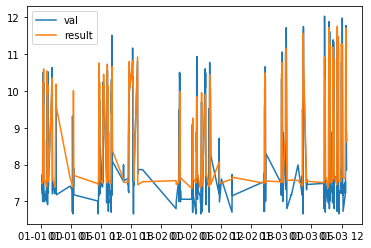

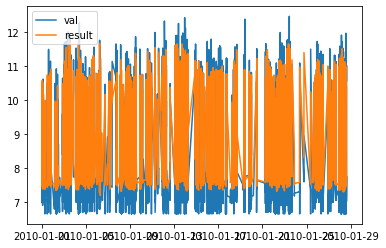

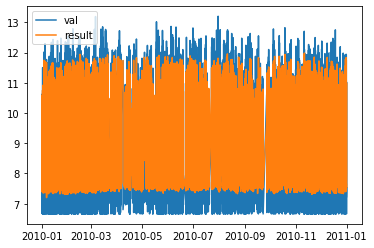

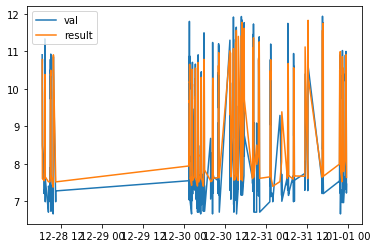

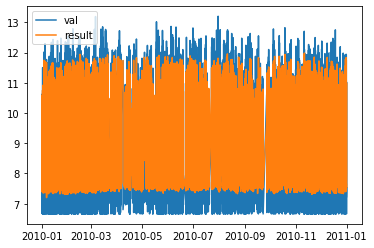

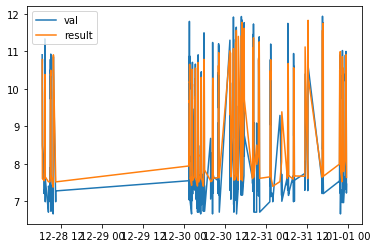

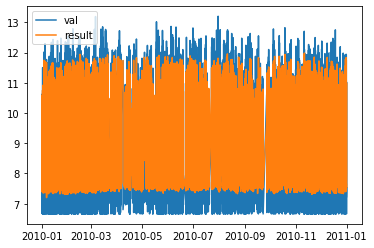

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [7]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(32, kernel_size=(1,10), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget
plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()
%matplotlib inline

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 1, 10, 32)         512       
_________________________________________________________________
dropout_1 (Dropout)          (None, 1, 10, 32)         0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 320)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 128)               41088     
_________________________________________________________________
dense_5 (Dense)              (None, 16)                2064      
_________________________________________________________________
dense_6 (Dense)              (None, 4)                 68        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                

705/705 [==============================] - 2s 3ms/step - loss: 0.5200 - mse: 0.5200 - val_loss: 0.7783 - val_mse: 0.7783
Epoch 114/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5210 - mse: 0.5210 - val_loss: 0.7510 - val_mse: 0.7510
Epoch 115/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5203 - mse: 0.5203 - val_loss: 0.7672 - val_mse: 0.7672
Epoch 116/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5200 - mse: 0.5200 - val_loss: 0.7643 - val_mse: 0.7643
Epoch 117/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5206 - mse: 0.5206 - val_loss: 0.7569 - val_mse: 0.7569
Epoch 118/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5197 - mse: 0.5197 - val_loss: 0.8057 - val_mse: 0.8057
Epoch 119/500
705/705 [==============================] - 2s 4ms/step - loss: 0.5192 - mse: 0.5192 - val_loss: 0.7639 - val_mse: 0.7639
Epoch 120/500
705/705 [==============================] - 3s 4ms/step 

Epoch 174/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5105 - mse: 0.5105 - val_loss: 0.7666 - val_mse: 0.7666
Epoch 175/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5093 - mse: 0.5093 - val_loss: 0.7786 - val_mse: 0.7786
Epoch 176/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5090 - mse: 0.5090 - val_loss: 0.7589 - val_mse: 0.7589
Epoch 177/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5086 - mse: 0.5086 - val_loss: 0.7818 - val_mse: 0.7818
Epoch 178/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5087 - mse: 0.5087 - val_loss: 0.7435 - val_mse: 0.7435
Epoch 179/500
705/705 [==============================] - 2s 4ms/step - loss: 0.5084 - mse: 0.5084 - val_loss: 0.7492 - val_mse: 0.7492
Epoch 180/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5080 - mse: 0.5080 - val_loss: 0.7788 - val_mse: 0.7788
Epoch 181/500
705/705 [==============================] 

Epoch 295/500
705/705 [==============================] - 2s 4ms/step - loss: 0.4979 - mse: 0.4979 - val_loss: 0.7575 - val_mse: 0.7575
Epoch 296/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4972 - mse: 0.4972 - val_loss: 0.7517 - val_mse: 0.7517
Epoch 297/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4978 - mse: 0.4978 - val_loss: 0.7276 - val_mse: 0.7276
Epoch 298/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4979 - mse: 0.4979 - val_loss: 0.7813 - val_mse: 0.7813
Epoch 299/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4978 - mse: 0.4978 - val_loss: 0.7355 - val_mse: 0.7355
Epoch 300/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4967 - mse: 0.4967 - val_loss: 0.8051 - val_mse: 0.8051
Epoch 301/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4979 - mse: 0.4979 - val_loss: 0.7071 - val_mse: 0.7071
Epoch 302/500
705/705 [==============================] 

Epoch 416/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4908 - mse: 0.4908 - val_loss: 0.7716 - val_mse: 0.7716
Epoch 417/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4912 - mse: 0.4912 - val_loss: 0.8033 - val_mse: 0.8033
Epoch 418/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4914 - mse: 0.4914 - val_loss: 0.7795 - val_mse: 0.7795
Epoch 419/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4913 - mse: 0.4913 - val_loss: 0.7371 - val_mse: 0.7371
Epoch 420/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4919 - mse: 0.4919 - val_loss: 0.7948 - val_mse: 0.7948
Epoch 421/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4918 - mse: 0.4918 - val_loss: 0.7614 - val_mse: 0.7614
Epoch 422/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4903 - mse: 0.4903 - val_loss: 0.7854 - val_mse: 0.7854
Epoch 423/500
705/705 [==============================] 

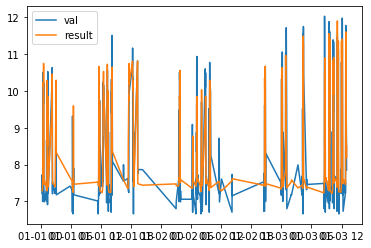

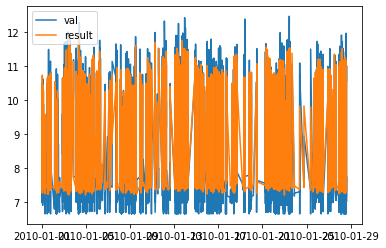

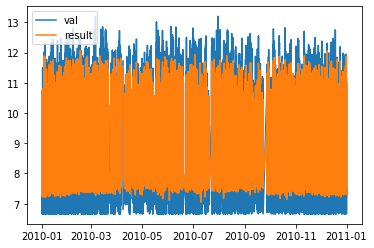

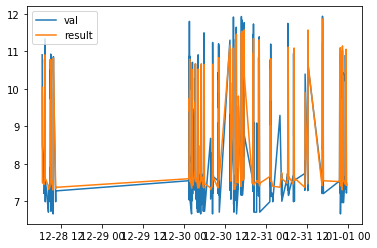

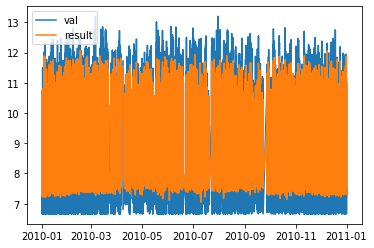

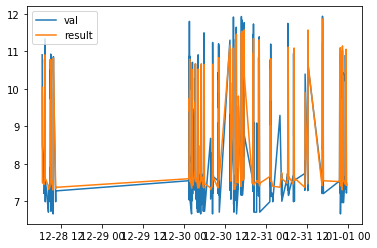

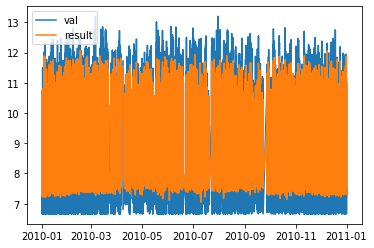

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [8]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(32, kernel_size=(15,1), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 1, 1, 256)         38656     
_________________________________________________________________
dropout_2 (Dropout)          (None, 1, 1, 256)         0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 256)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_9 (Dense)              (None, 16)                2064      
_________________________________________________________________
dense_10 (Dense)             (None, 4)                 68        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                

705/705 [==============================] - 4s 6ms/step - loss: 0.4563 - mse: 0.4563 - val_loss: 0.5967 - val_mse: 0.5967
Epoch 114/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4577 - mse: 0.4577 - val_loss: 0.6122 - val_mse: 0.6122
Epoch 115/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4563 - mse: 0.4563 - val_loss: 0.6453 - val_mse: 0.6453
Epoch 116/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4559 - mse: 0.4559 - val_loss: 0.6100 - val_mse: 0.6100
Epoch 117/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4556 - mse: 0.4556 - val_loss: 0.6153 - val_mse: 0.6153
Epoch 118/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4552 - mse: 0.4552 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 119/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4545 - mse: 0.4545 - val_loss: 0.6067 - val_mse: 0.6067
Epoch 120/500
705/705 [==============================] - 4s 6ms/step 

Epoch 174/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4459 - mse: 0.4459 - val_loss: 0.6294 - val_mse: 0.6294
Epoch 175/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4456 - mse: 0.4456 - val_loss: 0.6350 - val_mse: 0.6350
Epoch 176/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4452 - mse: 0.4452 - val_loss: 0.6464 - val_mse: 0.6464
Epoch 177/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4451 - mse: 0.4451 - val_loss: 0.6425 - val_mse: 0.6425
Epoch 178/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4447 - mse: 0.4447 - val_loss: 0.6174 - val_mse: 0.6174
Epoch 179/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4449 - mse: 0.4449 - val_loss: 0.6401 - val_mse: 0.6401
Epoch 180/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4436 - mse: 0.4436 - val_loss: 0.6298 - val_mse: 0.6298
Epoch 181/500
705/705 [==============================] 

Epoch 295/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4343 - mse: 0.4343 - val_loss: 0.6159 - val_mse: 0.6159
Epoch 296/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4335 - mse: 0.4335 - val_loss: 0.6214 - val_mse: 0.6214
Epoch 297/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4337 - mse: 0.4337 - val_loss: 0.6154 - val_mse: 0.6154
Epoch 298/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4348 - mse: 0.4348 - val_loss: 0.6251 - val_mse: 0.6251
Epoch 299/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4336 - mse: 0.4336 - val_loss: 0.6306 - val_mse: 0.6306
Epoch 300/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4335 - mse: 0.4335 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 301/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4340 - mse: 0.4340 - val_loss: 0.6103 - val_mse: 0.6103
Epoch 302/500
705/705 [==============================] 

Epoch 416/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4280 - mse: 0.4280 - val_loss: 0.6168 - val_mse: 0.6168
Epoch 417/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4280 - mse: 0.4280 - val_loss: 0.6293 - val_mse: 0.6293
Epoch 418/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4278 - mse: 0.4278 - val_loss: 0.6328 - val_mse: 0.6328
Epoch 419/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4276 - mse: 0.4276 - val_loss: 0.6347 - val_mse: 0.6347
Epoch 420/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4275 - mse: 0.4275 - val_loss: 0.6232 - val_mse: 0.6232
Epoch 421/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4285 - mse: 0.4285 - val_loss: 0.6083 - val_mse: 0.6083
Epoch 422/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4280 - mse: 0.4280 - val_loss: 0.6149 - val_mse: 0.6149
Epoch 423/500
705/705 [==============================] 

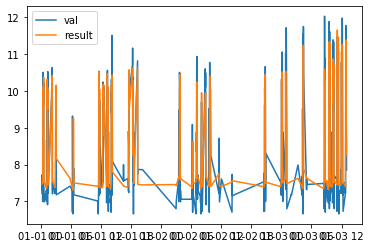

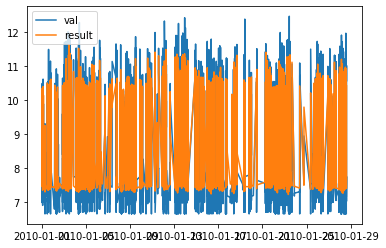

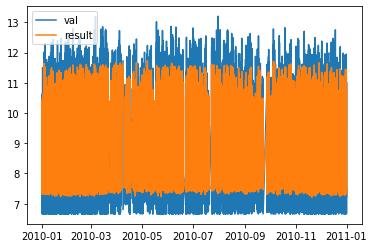

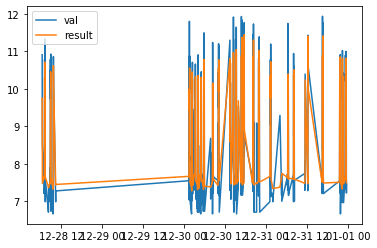

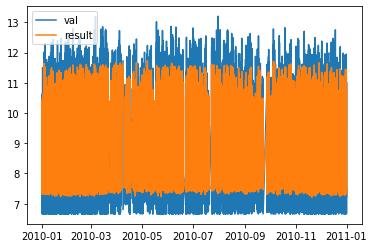

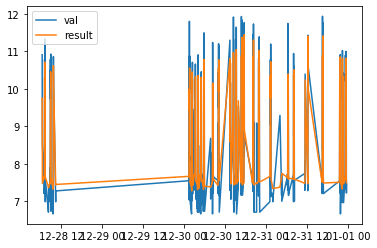

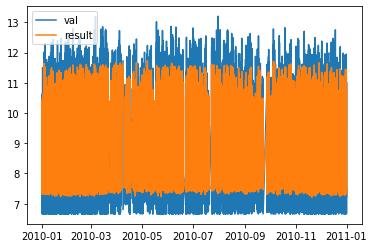

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [9]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(256, kernel_size=(15,10), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 1, 10, 64)         1024      
_________________________________________________________________
dropout_3 (Dropout)          (None, 1, 10, 64)         0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 1, 6, 64)          20544     
_________________________________________________________________
dropout_4 (Dropout)          (None, 1, 6, 64)          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 384)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 128)               49280     
_________________________________________________________________
dense_13 (Dense)             (None, 16)               

705/705 [==============================] - 4s 6ms/step - loss: 0.4959 - mse: 0.4959 - val_loss: 0.6141 - val_mse: 0.6141
Epoch 112/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4969 - mse: 0.4969 - val_loss: 0.6078 - val_mse: 0.6078
Epoch 113/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4963 - mse: 0.4963 - val_loss: 0.6075 - val_mse: 0.6075
Epoch 114/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4960 - mse: 0.4960 - val_loss: 0.6134 - val_mse: 0.6134
Epoch 115/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4942 - mse: 0.4942 - val_loss: 0.6063 - val_mse: 0.6063
Epoch 116/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4950 - mse: 0.4950 - val_loss: 0.6096 - val_mse: 0.6096
Epoch 117/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4939 - mse: 0.4939 - val_loss: 0.6078 - val_mse: 0.6078
Epoch 118/500
705/705 [==============================] - 4s 6ms/step 

Epoch 172/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4845 - mse: 0.4845 - val_loss: 0.6076 - val_mse: 0.6076
Epoch 173/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4839 - mse: 0.4839 - val_loss: 0.6058 - val_mse: 0.6058
Epoch 174/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4831 - mse: 0.4831 - val_loss: 0.5967 - val_mse: 0.5967
Epoch 175/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4820 - mse: 0.4820 - val_loss: 0.6024 - val_mse: 0.6024
Epoch 176/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4834 - mse: 0.4834 - val_loss: 0.6060 - val_mse: 0.6060
Epoch 177/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4829 - mse: 0.4829 - val_loss: 0.6045 - val_mse: 0.6045
Epoch 178/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4833 - mse: 0.4833 - val_loss: 0.6008 - val_mse: 0.6008
Epoch 179/500
705/705 [==============================] 

Epoch 293/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4696 - mse: 0.4696 - val_loss: 0.6021 - val_mse: 0.6021
Epoch 294/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4713 - mse: 0.4713 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 295/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4713 - mse: 0.4713 - val_loss: 0.6030 - val_mse: 0.6030
Epoch 296/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4704 - mse: 0.4704 - val_loss: 0.6095 - val_mse: 0.6095
Epoch 297/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4702 - mse: 0.4702 - val_loss: 0.6020 - val_mse: 0.6020
Epoch 298/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4709 - mse: 0.4709 - val_loss: 0.6072 - val_mse: 0.6072
Epoch 299/500
705/705 [==============================] - 4s 6ms/step - loss: 0.4706 - mse: 0.4706 - val_loss: 0.6008 - val_mse: 0.6008
Epoch 300/500
705/705 [==============================] 

Epoch 414/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4662 - mse: 0.4662 - val_loss: 0.6001 - val_mse: 0.6001
Epoch 415/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4660 - mse: 0.4660 - val_loss: 0.6023 - val_mse: 0.6023
Epoch 416/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4662 - mse: 0.4662 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 417/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4662 - mse: 0.4662 - val_loss: 0.5997 - val_mse: 0.5997
Epoch 418/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4657 - mse: 0.4657 - val_loss: 0.6027 - val_mse: 0.6027
Epoch 419/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4667 - mse: 0.4667 - val_loss: 0.5965 - val_mse: 0.5965
Epoch 420/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4661 - mse: 0.4661 - val_loss: 0.6033 - val_mse: 0.6033
Epoch 421/500
705/705 [==============================] 

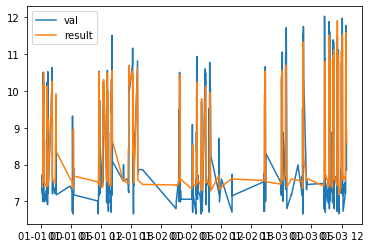

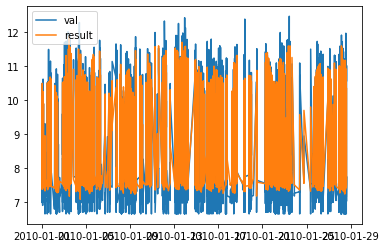

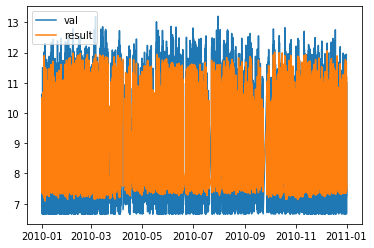

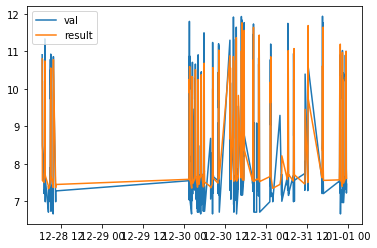

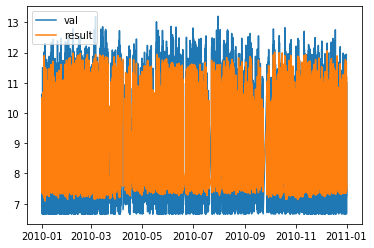

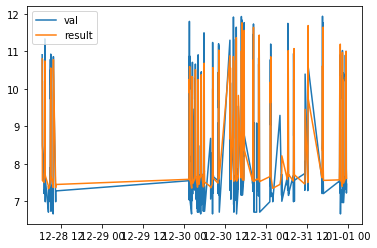

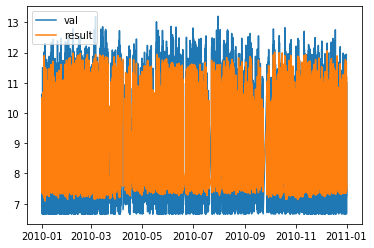

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [10]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(64, kernel_size=(15,1), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Conv2D(64, kernel_size=(1,5), activation='relu'))

model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 15, 1, 64)         704       
_________________________________________________________________
dropout (Dropout)            (None, 15, 1, 64)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 11, 1, 64)         20544     
_________________________________________________________________
dropout_1 (Dropout)          (None, 11, 1, 64)         0         
_________________________________________________________________
flatten (Flatten)            (None, 704)               0         
_________________________________________________________________
dense (Dense)                (None, 128)               90240     
_________________________________________________________________
dense_1 (Dense)              (None, 16)               

705/705 [==============================] - 3s 4ms/step - loss: 0.5246 - mse: 0.5246 - val_loss: 0.6308 - val_mse: 0.6308
Epoch 112/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5238 - mse: 0.5238 - val_loss: 0.6255 - val_mse: 0.6255
Epoch 113/500
705/705 [==============================] - 3s 4ms/step - loss: 0.6194 - mse: 0.6194 - val_loss: 0.6322 - val_mse: 0.6322
Epoch 114/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5247 - mse: 0.5247 - val_loss: 0.6382 - val_mse: 0.6382
Epoch 115/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5224 - mse: 0.5224 - val_loss: 0.6474 - val_mse: 0.6474
Epoch 116/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5238 - mse: 0.5238 - val_loss: 0.6243 - val_mse: 0.6243
Epoch 117/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5220 - mse: 0.5220 - val_loss: 0.6321 - val_mse: 0.6321
Epoch 118/500
705/705 [==============================] - 3s 4ms/step 

Epoch 172/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5079 - mse: 0.5079 - val_loss: 0.6239 - val_mse: 0.6239
Epoch 173/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5069 - mse: 0.5069 - val_loss: 0.6216 - val_mse: 0.6216
Epoch 174/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5073 - mse: 0.5073 - val_loss: 0.6200 - val_mse: 0.6200
Epoch 175/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5085 - mse: 0.5085 - val_loss: 0.6184 - val_mse: 0.6184
Epoch 176/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5066 - mse: 0.5066 - val_loss: 0.6280 - val_mse: 0.6280
Epoch 177/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5076 - mse: 0.5076 - val_loss: 0.6172 - val_mse: 0.6172
Epoch 178/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5057 - mse: 0.5057 - val_loss: 0.6219 - val_mse: 0.6219
Epoch 179/500
705/705 [==============================] 

Epoch 293/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4928 - mse: 0.4928 - val_loss: 0.6180 - val_mse: 0.6180
Epoch 294/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4926 - mse: 0.4926 - val_loss: 0.6177 - val_mse: 0.6177
Epoch 295/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4920 - mse: 0.4920 - val_loss: 0.6164 - val_mse: 0.6164
Epoch 296/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4913 - mse: 0.4913 - val_loss: 0.6180 - val_mse: 0.6180
Epoch 297/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4921 - mse: 0.4921 - val_loss: 0.6203 - val_mse: 0.6203
Epoch 298/500
705/705 [==============================] - 3s 5ms/step - loss: 0.4924 - mse: 0.4924 - val_loss: 0.6193 - val_mse: 0.6193
Epoch 299/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4917 - mse: 0.4917 - val_loss: 0.6230 - val_mse: 0.6230
Epoch 300/500
705/705 [==============================] 

Epoch 414/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4839 - mse: 0.4839 - val_loss: 0.6179 - val_mse: 0.6179
Epoch 415/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4858 - mse: 0.4858 - val_loss: 0.6217 - val_mse: 0.6217
Epoch 416/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4834 - mse: 0.4834 - val_loss: 0.6308 - val_mse: 0.6308
Epoch 417/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4841 - mse: 0.4841 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 418/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4838 - mse: 0.4838 - val_loss: 0.6291 - val_mse: 0.6291
Epoch 419/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4831 - mse: 0.4831 - val_loss: 0.6188 - val_mse: 0.6188
Epoch 420/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4834 - mse: 0.4834 - val_loss: 0.6167 - val_mse: 0.6167
Epoch 421/500
705/705 [==============================] 

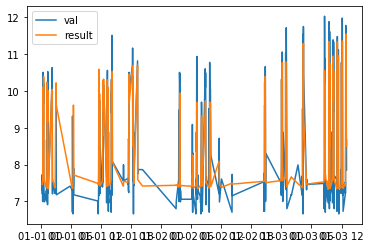

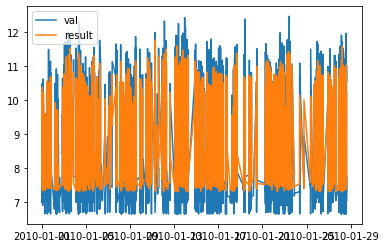

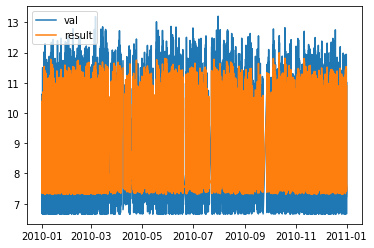

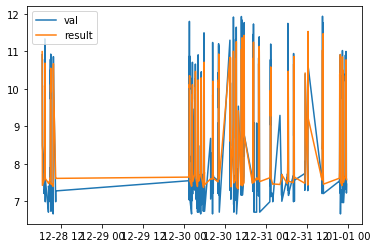

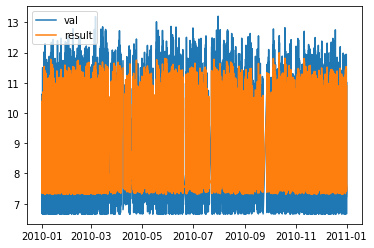

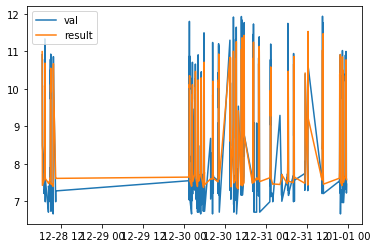

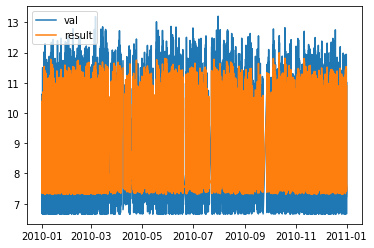

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [6]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(64, kernel_size=(1,10), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Conv2D(64, kernel_size=(5,1), activation='relu'))

model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 1, 10, 64)         1024      
_________________________________________________________________
dropout_2 (Dropout)          (None, 1, 10, 64)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 1, 1, 64)          41024     
_________________________________________________________________
dropout_3 (Dropout)          (None, 1, 1, 64)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 64)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 128)               8320      
_________________________________________________________________
dense_5 (Dense)              (None, 16)               

705/705 [==============================] - 2s 3ms/step - loss: 0.5185 - mse: 0.5185 - val_loss: 0.6109 - val_mse: 0.6109
Epoch 112/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5180 - mse: 0.5180 - val_loss: 0.6071 - val_mse: 0.6071
Epoch 113/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5180 - mse: 0.5180 - val_loss: 0.6178 - val_mse: 0.6178
Epoch 114/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5182 - mse: 0.5182 - val_loss: 0.6228 - val_mse: 0.6228
Epoch 115/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 0.6186 - val_mse: 0.6186
Epoch 116/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5182 - mse: 0.5182 - val_loss: 0.6093 - val_mse: 0.6093
Epoch 117/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5189 - mse: 0.5189 - val_loss: 0.6336 - val_mse: 0.6336
Epoch 118/500
705/705 [==============================] - 2s 3ms/step 

Epoch 172/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5129 - mse: 0.5129 - val_loss: 0.6166 - val_mse: 0.6166
Epoch 173/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5123 - mse: 0.5123 - val_loss: 0.6098 - val_mse: 0.6098
Epoch 174/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 0.6159 - val_mse: 0.6159
Epoch 175/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5120 - mse: 0.5120 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 176/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5130 - mse: 0.5130 - val_loss: 0.6073 - val_mse: 0.6073
Epoch 177/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5115 - mse: 0.5115 - val_loss: 0.6113 - val_mse: 0.6113
Epoch 178/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 0.6097 - val_mse: 0.6097
Epoch 179/500
705/705 [==============================] 

Epoch 293/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5073 - mse: 0.5073 - val_loss: 0.6152 - val_mse: 0.6152
Epoch 294/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5053 - mse: 0.5053 - val_loss: 0.6045 - val_mse: 0.6045
Epoch 295/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5062 - mse: 0.5062 - val_loss: 0.6078 - val_mse: 0.6078
Epoch 296/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5067 - mse: 0.5067 - val_loss: 0.6066 - val_mse: 0.6066
Epoch 297/500
705/705 [==============================] - 3s 4ms/step - loss: 0.5078 - mse: 0.5078 - val_loss: 0.6157 - val_mse: 0.6157
Epoch 298/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5057 - mse: 0.5057 - val_loss: 0.6062 - val_mse: 0.6062
Epoch 299/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5072 - mse: 0.5072 - val_loss: 0.6157 - val_mse: 0.6157
Epoch 300/500
705/705 [==============================] 

Epoch 414/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5026 - mse: 0.5026 - val_loss: 0.6138 - val_mse: 0.6138
Epoch 415/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5026 - mse: 0.5026 - val_loss: 0.6056 - val_mse: 0.6056
Epoch 416/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5027 - mse: 0.5027 - val_loss: 0.6045 - val_mse: 0.6045
Epoch 417/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5018 - mse: 0.5018 - val_loss: 0.6005 - val_mse: 0.6005
Epoch 418/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5023 - mse: 0.5023 - val_loss: 0.6191 - val_mse: 0.6191
Epoch 419/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5017 - mse: 0.5017 - val_loss: 0.6070 - val_mse: 0.6070
Epoch 420/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5033 - mse: 0.5033 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 421/500
705/705 [==============================] 

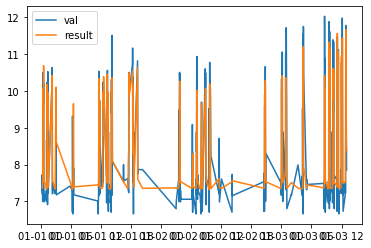

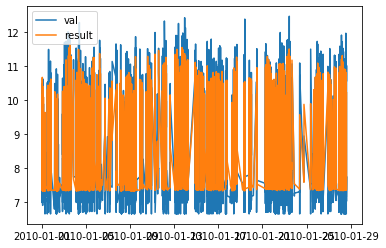

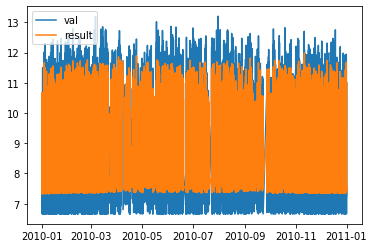

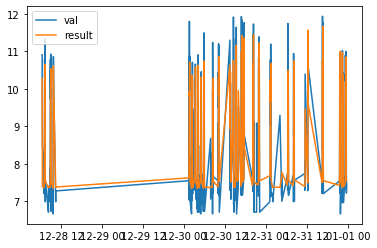

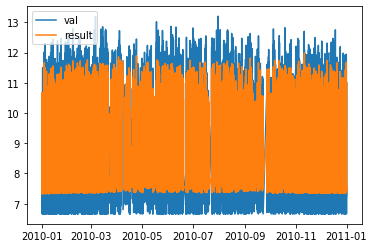

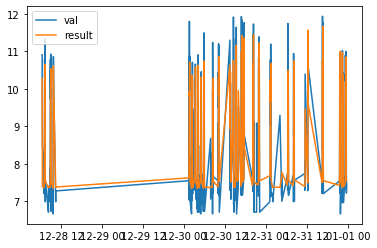

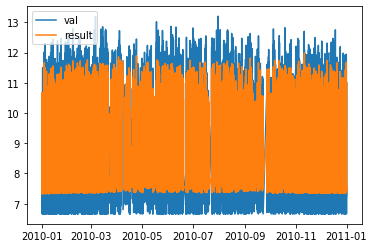

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [7]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(64, kernel_size=(15,1), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Conv2D(64, kernel_size=(1,10), activation='relu'))

model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 1, 1, 256)         38656     
_________________________________________________________________
dropout_4 (Dropout)          (None, 1, 1, 256)         0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 256)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_9 (Dense)              (None, 16)                2064      
_________________________________________________________________
dense_10 (Dense)             (None, 4)                 68        
_________________________________________________________________
dense_11 (Dense)             (None, 1)                

705/705 [==============================] - 2s 3ms/step - loss: 0.4589 - mse: 0.4589 - val_loss: 0.6473 - val_mse: 0.6473
Epoch 114/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4593 - mse: 0.4593 - val_loss: 0.6438 - val_mse: 0.6438
Epoch 115/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4590 - mse: 0.4590 - val_loss: 0.6472 - val_mse: 0.6472
Epoch 116/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4592 - mse: 0.4592 - val_loss: 0.6366 - val_mse: 0.6366
Epoch 117/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4584 - mse: 0.4584 - val_loss: 0.6618 - val_mse: 0.6618
Epoch 118/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4580 - mse: 0.4580 - val_loss: 0.6298 - val_mse: 0.6298
Epoch 119/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4587 - mse: 0.4587 - val_loss: 0.6592 - val_mse: 0.6592
Epoch 120/500
705/705 [==============================] - 2s 3ms/step 

Epoch 174/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4473 - mse: 0.4473 - val_loss: 0.6324 - val_mse: 0.6324
Epoch 175/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4466 - mse: 0.4466 - val_loss: 0.6388 - val_mse: 0.6388
Epoch 176/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4462 - mse: 0.4462 - val_loss: 0.6536 - val_mse: 0.6536
Epoch 177/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4474 - mse: 0.4474 - val_loss: 0.6337 - val_mse: 0.6337
Epoch 178/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4464 - mse: 0.4464 - val_loss: 0.6190 - val_mse: 0.6190
Epoch 179/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4460 - mse: 0.4460 - val_loss: 0.6487 - val_mse: 0.6487
Epoch 180/500
705/705 [==============================] - 3s 4ms/step - loss: 0.4457 - mse: 0.4457 - val_loss: 0.6312 - val_mse: 0.6312
Epoch 181/500
705/705 [==============================] 

Epoch 295/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4350 - mse: 0.4350 - val_loss: 0.6342 - val_mse: 0.6342
Epoch 296/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4351 - mse: 0.4351 - val_loss: 0.6671 - val_mse: 0.6671
Epoch 297/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4338 - mse: 0.4338 - val_loss: 0.6631 - val_mse: 0.6631
Epoch 298/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4344 - mse: 0.4344 - val_loss: 0.6446 - val_mse: 0.6446
Epoch 299/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4356 - mse: 0.4356 - val_loss: 0.6468 - val_mse: 0.6468
Epoch 300/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4345 - mse: 0.4345 - val_loss: 0.6495 - val_mse: 0.6495
Epoch 301/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4347 - mse: 0.4347 - val_loss: 0.6544 - val_mse: 0.6544
Epoch 302/500
705/705 [==============================] 

Epoch 416/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4283 - mse: 0.4283 - val_loss: 0.6479 - val_mse: 0.6479
Epoch 417/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.6430 - val_mse: 0.6430
Epoch 418/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4276 - mse: 0.4276 - val_loss: 0.6360 - val_mse: 0.6360
Epoch 419/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4281 - mse: 0.4281 - val_loss: 0.6275 - val_mse: 0.6275
Epoch 420/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4283 - mse: 0.4283 - val_loss: 0.6535 - val_mse: 0.6535
Epoch 421/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.6360 - val_mse: 0.6360
Epoch 422/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4285 - mse: 0.4285 - val_loss: 0.6302 - val_mse: 0.6302
Epoch 423/500
705/705 [==============================] 

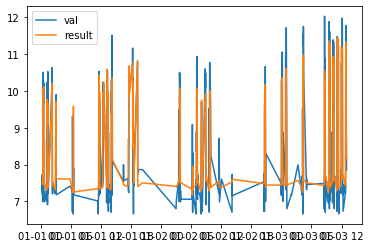

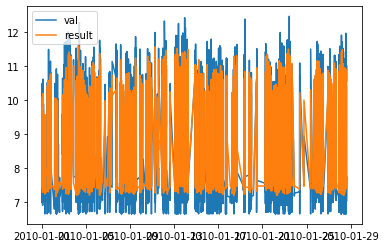

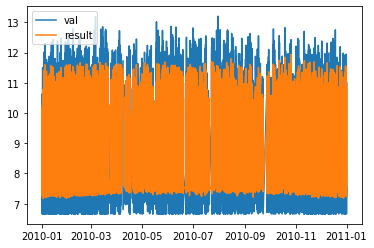

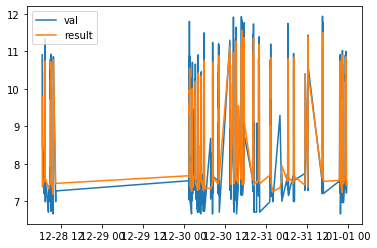

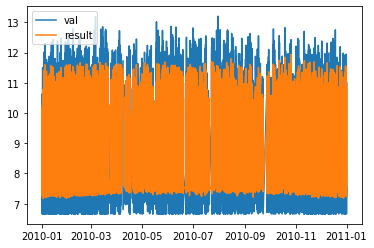

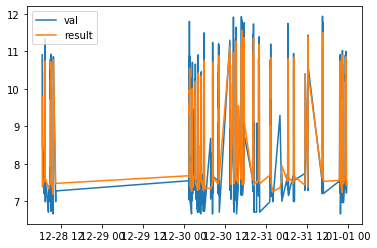

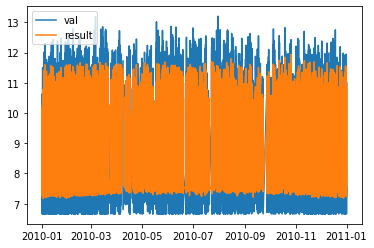

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [8]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(256, kernel_size=(15,10), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

In [9]:
# model = Sequential()
# # model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# # model.add(MaxPooling1D())
# # model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# # model.add(MaxPooling1D())
# model = Sequential()
# model.add(Conv2D(512, kernel_size=(15,10), activation='relu', input_shape=(15,10,1)))
# model.add(Dropout(0.5))
# model.add(Flatten())
# model.add(Dense(256, activation='relu'))
# model.add(Dense(64, activation='relu'))
# model.add(Dense(16, activation='relu'))
# model.add(Dense(4, activation='relu'))
# model.add(Dense(1))
# #compile model using accuracy to measure model performance
# model.compile(loss='mse', optimizer='adam', metrics=['mse'])
# model.summary()

# history = model.fit(X, np.array(y_train_log), 
#     validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

# results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

# df_results = pd.DataFrame(data=results, index = df_val.index)

# plt.figure()
# plt.plot(y_val_log[:500])
# plt.plot(df_results[:500])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# plt.figure()
# plt.plot(y_val_log[:5000])
# plt.plot(df_results[:5000])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# plt.figure()
# plt.plot(y_val_log[:])
# plt.plot(df_results[:])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# plt.figure()
# plt.plot(y_val_log[-500:])
# plt.plot(df_results[-500:])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# plt.figure()
# plt.plot(y_val_log[:])
# plt.plot(df_results[:])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# plt.figure()
# plt.plot(y_val_log[-500:])
# plt.plot(df_results[-500:])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# plt.figure()
# plt.plot(y_val_log[:])
# plt.plot(df_results[:])
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# %matplotlib widget

# plt.figure()
# plt.plot(10**y_val_log[:]*1.6e-6)
# plt.plot(10**df_results[:]*1.6e-6)
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

# %matplotlib inline

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 1, 1, 256)         36096     
_________________________________________________________________
dropout_5 (Dropout)          (None, 1, 1, 256)         0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 256)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_13 (Dense)             (None, 16)                2064      
_________________________________________________________________
dense_14 (Dense)             (None, 4)                 68        
_________________________________________________________________
dense_15 (Dense)             (None, 1)                

705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3740 - val_mse: 2.3740
Epoch 53/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3731 - val_mse: 2.3731
Epoch 54/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6291 - mse: 1.6291 - val_loss: 2.3691 - val_mse: 2.3691
Epoch 55/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3718 - val_mse: 2.3718
Epoch 56/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3722 - val_mse: 2.3722
Epoch 57/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3704 - val_mse: 2.3704
Epoch 58/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3714 - val_mse: 2.3714
Epoch 59/500
705/705 [==============================] - 2s 3ms/step - loss:

Epoch 174/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3740 - val_mse: 2.3740
Epoch 175/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3729 - val_mse: 2.3729
Epoch 176/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3720 - val_mse: 2.3720
Epoch 177/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3719 - val_mse: 2.3719
Epoch 178/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3734 - val_mse: 2.3734
Epoch 179/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3709 - val_mse: 2.3709
Epoch 180/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3725 - val_mse: 2.3725
Epoch 181/500
705/705 [==============================] 

Epoch 295/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3726 - val_mse: 2.3726
Epoch 296/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3716 - val_mse: 2.3716
Epoch 297/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3732 - val_mse: 2.3732
Epoch 298/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3687 - val_mse: 2.3687
Epoch 299/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3725 - val_mse: 2.3725
Epoch 300/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3700 - val_mse: 2.3700
Epoch 301/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3725 - val_mse: 2.3725
Epoch 302/500
705/705 [==============================] 

Epoch 416/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3728 - val_mse: 2.3728
Epoch 417/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3738 - val_mse: 2.3738
Epoch 418/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3741 - val_mse: 2.3741
Epoch 419/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3717 - val_mse: 2.3717
Epoch 420/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6291 - mse: 1.6291 - val_loss: 2.3688 - val_mse: 2.3688
Epoch 421/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3736 - val_mse: 2.3736
Epoch 422/500
705/705 [==============================] - 2s 3ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3722 - val_mse: 2.3722
Epoch 423/500
705/705 [==============================] 

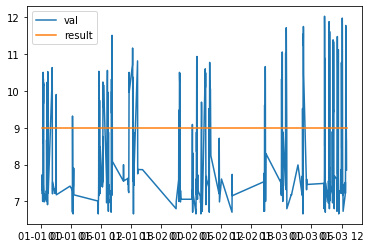

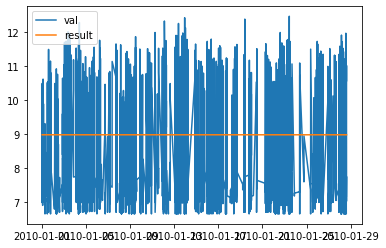

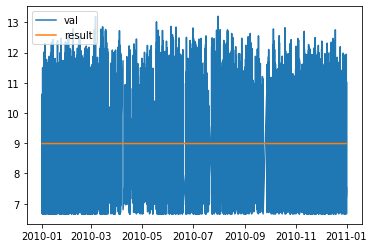

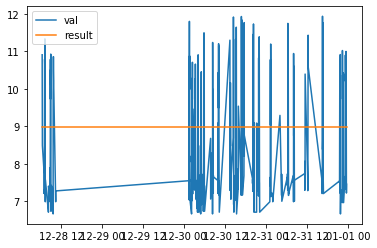

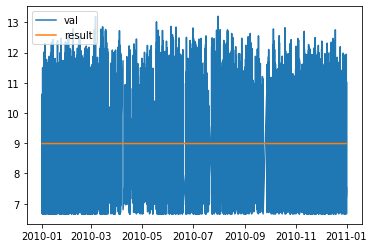

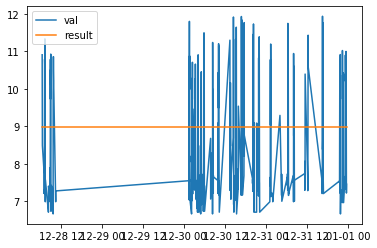

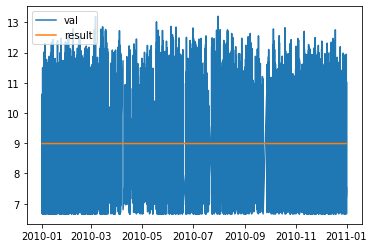

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [10]:
model1 = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(256, kernel_size=(14,10), activation='relu', input_shape=(14,10,1)))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X[:,1:15,:,:], np.array(y_train_log), 
    validation_data=(X_test[:,1:15,:,:], np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test[:,1:15,:,:])#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 1, 1, 256)         36096     
_________________________________________________________________
dropout_6 (Dropout)          (None, 1, 1, 256)         0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 256)               0         
_________________________________________________________________
dense_16 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_17 (Dense)             (None, 16)                2064      
_________________________________________________________________
dense_18 (Dense)             (None, 4)                 68        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                

705/705 [==============================] - 2s 3ms/step - loss: 1.5593 - mse: 1.5593 - val_loss: 2.3487 - val_mse: 2.3487
Epoch 114/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5591 - mse: 1.5591 - val_loss: 2.3388 - val_mse: 2.3388
Epoch 115/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5593 - mse: 1.5593 - val_loss: 2.3407 - val_mse: 2.3407
Epoch 116/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5609 - mse: 1.5609 - val_loss: 2.3413 - val_mse: 2.3413
Epoch 117/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5584 - mse: 1.5584 - val_loss: 2.3377 - val_mse: 2.3377
Epoch 118/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5573 - mse: 1.5573 - val_loss: 2.3318 - val_mse: 2.3318
Epoch 119/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5572 - mse: 1.5572 - val_loss: 2.3466 - val_mse: 2.3466
Epoch 120/500
705/705 [==============================] - 2s 3ms/step 

Epoch 174/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5381 - mse: 1.5381 - val_loss: 2.3525 - val_mse: 2.3525
Epoch 175/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5393 - mse: 1.5393 - val_loss: 2.3628 - val_mse: 2.3628
Epoch 176/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5399 - mse: 1.5399 - val_loss: 2.3559 - val_mse: 2.3559
Epoch 177/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5409 - mse: 1.5409 - val_loss: 2.3478 - val_mse: 2.3478
Epoch 178/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5386 - mse: 1.5386 - val_loss: 2.3532 - val_mse: 2.3532
Epoch 179/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5369 - mse: 1.5369 - val_loss: 2.3611 - val_mse: 2.3611
Epoch 180/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5362 - mse: 1.5362 - val_loss: 2.3538 - val_mse: 2.3538
Epoch 181/500
705/705 [==============================] 

Epoch 295/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5113 - mse: 1.5113 - val_loss: 2.3713 - val_mse: 2.3713
Epoch 296/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5110 - mse: 1.5110 - val_loss: 2.3641 - val_mse: 2.3641
Epoch 297/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5117 - mse: 1.5117 - val_loss: 2.3788 - val_mse: 2.3788
Epoch 298/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5101 - mse: 1.5101 - val_loss: 2.3735 - val_mse: 2.3735
Epoch 299/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5100 - mse: 1.5100 - val_loss: 2.3721 - val_mse: 2.3721
Epoch 300/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5092 - mse: 1.5092 - val_loss: 2.3737 - val_mse: 2.3737
Epoch 301/500
705/705 [==============================] - 2s 3ms/step - loss: 1.5101 - mse: 1.5101 - val_loss: 2.3751 - val_mse: 2.3751
Epoch 302/500
705/705 [==============================] 

Epoch 416/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4951 - mse: 1.4951 - val_loss: 2.3767 - val_mse: 2.3767
Epoch 417/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4985 - mse: 1.4985 - val_loss: 2.3898 - val_mse: 2.3898
Epoch 418/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4971 - mse: 1.4971 - val_loss: 2.3800 - val_mse: 2.3800
Epoch 419/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4948 - mse: 1.4948 - val_loss: 2.3829 - val_mse: 2.3829
Epoch 420/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4987 - mse: 1.4987 - val_loss: 2.3860 - val_mse: 2.3860
Epoch 421/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4951 - mse: 1.4951 - val_loss: 2.3853 - val_mse: 2.3853
Epoch 422/500
705/705 [==============================] - 2s 3ms/step - loss: 1.4951 - mse: 1.4951 - val_loss: 2.3807 - val_mse: 2.3807
Epoch 423/500
705/705 [==============================] 

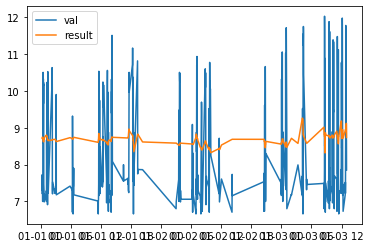

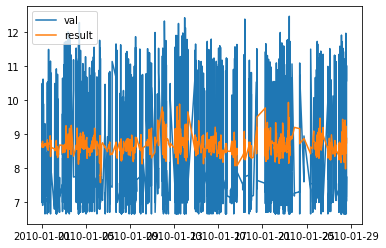

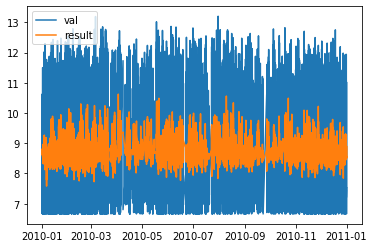

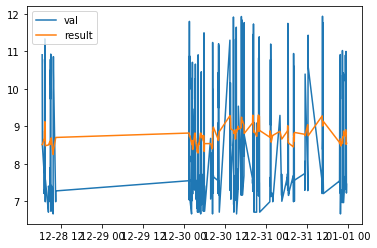

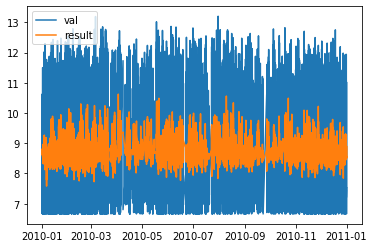

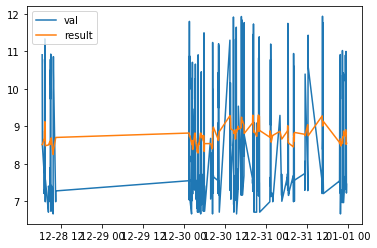

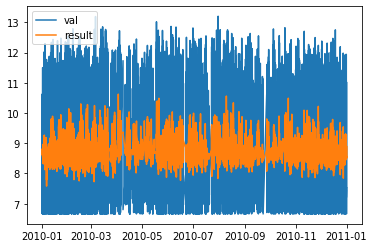

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [11]:
model1 = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(256, kernel_size=(14,10), activation='relu', input_shape=(14,10,1)))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X[:,1:15,:,:], np.array(y_train_log), 
    validation_data=(X_test[:,1:15,:,:], np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test[:,1:15,:,:])#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_7 (Conv2D)               (None, 1, 1, 256)    36096       input_1[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 10)]         0                                            
__________________________________________________________________________________________________
dropout_7 (Dropout)             (None, 1, 1, 256)    0           conv2d_7[0][0]                   
______________________________________________________________________________________________

705/705 [==============================] - 2s 3ms/step - loss: 0.4301 - mse: 0.4301 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 102/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4294 - mse: 0.4294 - val_loss: 0.5891 - val_mse: 0.5891
Epoch 103/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4291 - mse: 0.4291 - val_loss: 0.5878 - val_mse: 0.5878
Epoch 104/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4295 - mse: 0.4295 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 105/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4296 - mse: 0.4296 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 106/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4284 - mse: 0.4284 - val_loss: 0.5950 - val_mse: 0.5950
Epoch 107/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4286 - mse: 0.4286 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 108/500
705/705 [==============================] - 2s 3ms/step 

Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4174 - mse: 0.4174 - val_loss: 0.5895 - val_mse: 0.5895
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4165 - mse: 0.4165 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4174 - mse: 0.4174 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 165/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4164 - mse: 0.4164 - val_loss: 0.5943 - val_mse: 0.5943
Epoch 166/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4164 - mse: 0.4164 - val_loss: 0.5918 - val_mse: 0.5918
Epoch 167/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4165 - mse: 0.4165 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 168/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4162 - mse: 0.4162 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 169/500
705/705 [==============================] 

Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4035 - mse: 0.4035 - val_loss: 0.5862 - val_mse: 0.5862
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4029 - mse: 0.4029 - val_loss: 0.5906 - val_mse: 0.5906
Epoch 286/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4025 - mse: 0.4025 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 287/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4065 - mse: 0.4065 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 288/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4032 - mse: 0.4032 - val_loss: 0.5922 - val_mse: 0.5922
Epoch 289/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4029 - mse: 0.4029 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 290/500
705/705 [==============================] 

Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3957 - mse: 0.3957 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3955 - mse: 0.3955 - val_loss: 0.5939 - val_mse: 0.5939
Epoch 406/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3959 - mse: 0.3959 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 407/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3951 - mse: 0.3951 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 408/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3952 - mse: 0.3952 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 409/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 410/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3958 - mse: 0.3958 - val_loss: 0.5893 - val_mse: 0.5893
Epoch 411/500
705/705 [==============================] 

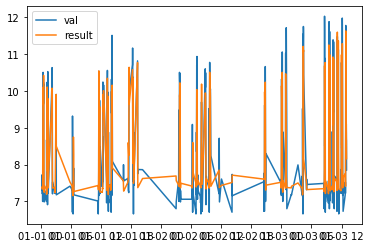

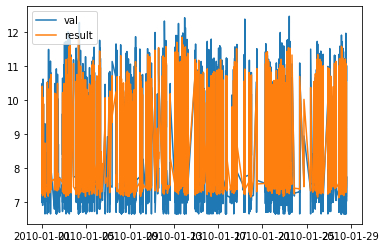

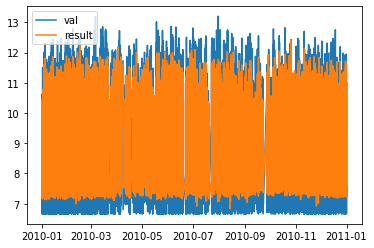

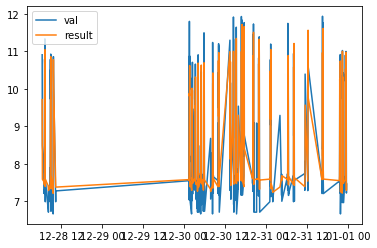

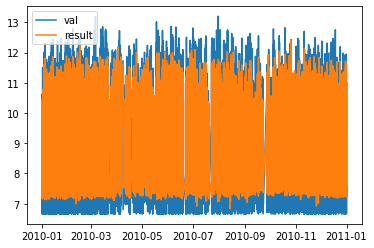

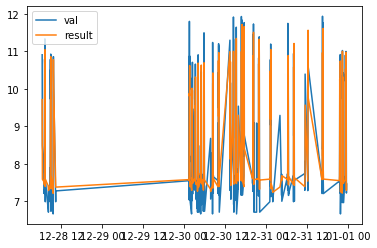

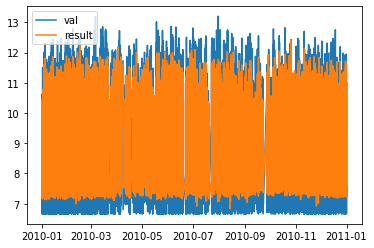

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [12]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(10))

model2 = Dense(32, activation='relu')(input2)
model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_8 (Conv2D)               (None, 1, 1, 256)    36096       input_3[0][0]                    
__________________________________________________________________________________________________
input_4 (InputLayer)            [(None, 150)]        0                                            
__________________________________________________________________________________________________
dropout_8 (Dropout)             (None, 1, 1, 256)    0           conv2d_8[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 2s 3ms/step - loss: 0.4119 - mse: 0.4119 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 102/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4120 - mse: 0.4120 - val_loss: 0.5977 - val_mse: 0.5977
Epoch 103/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4120 - mse: 0.4120 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 104/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5967 - val_mse: 0.5967
Epoch 105/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4116 - mse: 0.4116 - val_loss: 0.6009 - val_mse: 0.6009
Epoch 106/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4100 - mse: 0.4100 - val_loss: 0.5970 - val_mse: 0.5970
Epoch 107/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4100 - mse: 0.4100 - val_loss: 0.5978 - val_mse: 0.5978
Epoch 108/500
705/705 [==============================] - 2s 3ms/step 

Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3941 - mse: 0.3941 - val_loss: 0.5966 - val_mse: 0.5966
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3963 - mse: 0.3963 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3951 - mse: 0.3951 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 165/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3942 - mse: 0.3942 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 166/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3934 - mse: 0.3934 - val_loss: 0.6094 - val_mse: 0.6094
Epoch 167/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3931 - mse: 0.3931 - val_loss: 0.5961 - val_mse: 0.5961
Epoch 168/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3931 - mse: 0.3931 - val_loss: 0.6207 - val_mse: 0.6207
Epoch 169/500
705/705 [==============================] 

Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3764 - mse: 0.3764 - val_loss: 0.6113 - val_mse: 0.6113
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3748 - mse: 0.3748 - val_loss: 0.6106 - val_mse: 0.6106
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3742 - mse: 0.3742 - val_loss: 0.6046 - val_mse: 0.6046
Epoch 286/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3744 - mse: 0.3744 - val_loss: 0.6006 - val_mse: 0.6006
Epoch 287/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3746 - mse: 0.3746 - val_loss: 0.5985 - val_mse: 0.5985
Epoch 288/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3746 - mse: 0.3746 - val_loss: 0.6027 - val_mse: 0.6027
Epoch 289/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3819 - mse: 0.3819 - val_loss: 0.6183 - val_mse: 0.6183
Epoch 290/500
705/705 [==============================] 

Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3645 - mse: 0.3645 - val_loss: 0.6258 - val_mse: 0.6258
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3648 - mse: 0.3648 - val_loss: 0.6239 - val_mse: 0.6239
Epoch 406/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3647 - mse: 0.3647 - val_loss: 0.6145 - val_mse: 0.6145
Epoch 407/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3647 - mse: 0.3647 - val_loss: 0.6039 - val_mse: 0.6039
Epoch 408/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3648 - mse: 0.3648 - val_loss: 0.6074 - val_mse: 0.6074
Epoch 409/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3654 - mse: 0.3654 - val_loss: 0.6168 - val_mse: 0.6168
Epoch 410/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3646 - mse: 0.3646 - val_loss: 0.6083 - val_mse: 0.6083
Epoch 411/500
705/705 [==============================] 

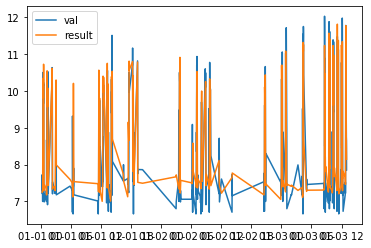

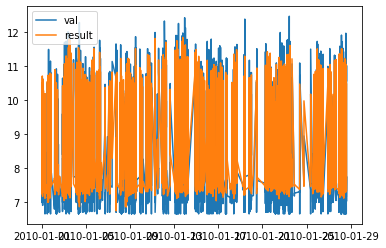

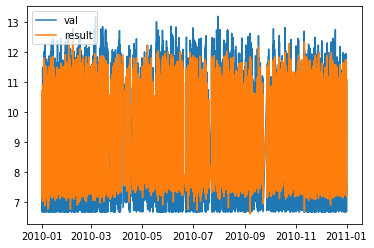

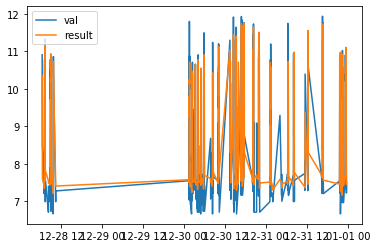

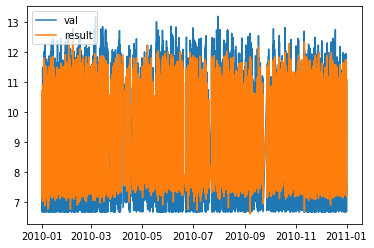

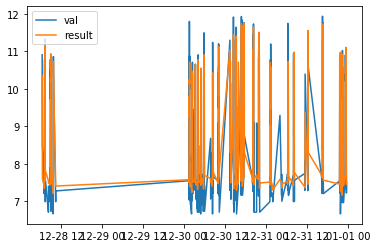

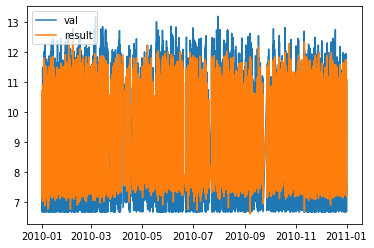

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [13]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(150))

model2 = Dense(256, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(64, activation='relu')(input2)
model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,:14,:,:],np.reshape(X[:,:,:,:],(X.shape[0],150))], np.array(y_train_log), 
    validation_data=([X_test[:,:14,:,:],np.reshape(X_test[:,:,:,:],(X_test.shape[0],150))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,:14,:,:],np.reshape(X_test[:,:,:,:],(X_test.shape[0],150))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_9 (Conv2D)               (None, 1, 1, 256)    36096       input_5[0][0]                    
__________________________________________________________________________________________________
input_6 (InputLayer)            [(None, 10)]         0                                            
__________________________________________________________________________________________________
dropout_10 (Dropout)            (None, 1, 1, 256)    0           conv2d_9[0][0]                   
____________________________________________________________________________________________

Epoch 36/500
705/705 [==============================] - 2s 3ms/step - loss: 0.6336 - mse: 0.6336 - val_loss: 0.8278 - val_mse: 0.8278
Epoch 37/500
705/705 [==============================] - 2s 3ms/step - loss: 0.6336 - mse: 0.6336 - val_loss: 0.8785 - val_mse: 0.8785
Epoch 38/500
705/705 [==============================] - 2s 3ms/step - loss: 0.6302 - mse: 0.6302 - val_loss: 0.8398 - val_mse: 0.8398
Epoch 39/500
705/705 [==============================] - 2s 3ms/step - loss: 0.6064 - mse: 0.6064 - val_loss: 0.8213 - val_mse: 0.8213
Epoch 40/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5847 - mse: 0.5847 - val_loss: 0.7993 - val_mse: 0.7993
Epoch 41/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5750 - mse: 0.5750 - val_loss: 0.8141 - val_mse: 0.8141
Epoch 42/500
705/705 [==============================] - 2s 4ms/step - loss: 0.5685 - mse: 0.5685 - val_loss: 0.7510 - val_mse: 0.7510
Epoch 43/500
705/705 [==============================] - 2s 3ms

Epoch 158/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5046 - mse: 0.5046 - val_loss: 0.8238 - val_mse: 0.8238
Epoch 159/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5052 - mse: 0.5052 - val_loss: 0.8303 - val_mse: 0.8303
Epoch 160/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5045 - mse: 0.5045 - val_loss: 0.8367 - val_mse: 0.8367
Epoch 161/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5046 - mse: 0.5046 - val_loss: 0.8565 - val_mse: 0.8565
Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5045 - mse: 0.5045 - val_loss: 0.8434 - val_mse: 0.8434
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5044 - mse: 0.5044 - val_loss: 0.8100 - val_mse: 0.8100
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5043 - mse: 0.5043 - val_loss: 0.8415 - val_mse: 0.8415
Epoch 165/500
705/705 [==============================] 

Epoch 279/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4863 - mse: 0.4863 - val_loss: 1.0537 - val_mse: 1.0537
Epoch 280/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 0.9630 - val_mse: 0.9630
Epoch 281/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 0.9780 - val_mse: 0.9780
Epoch 282/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4858 - mse: 0.4858 - val_loss: 0.9841 - val_mse: 0.9841
Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4863 - mse: 0.4863 - val_loss: 1.0134 - val_mse: 1.0134
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4850 - mse: 0.4850 - val_loss: 1.0572 - val_mse: 1.0572
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4860 - mse: 0.4860 - val_loss: 0.9683 - val_mse: 0.9683
Epoch 286/500
705/705 [==============================] 

Epoch 400/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4792 - mse: 0.4792 - val_loss: 0.9625 - val_mse: 0.9625
Epoch 401/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4797 - mse: 0.4797 - val_loss: 0.9505 - val_mse: 0.9505
Epoch 402/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4793 - mse: 0.4793 - val_loss: 0.9795 - val_mse: 0.9795
Epoch 403/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4793 - mse: 0.4793 - val_loss: 1.0011 - val_mse: 1.0011
Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4794 - mse: 0.4794 - val_loss: 0.9477 - val_mse: 0.9477
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 1.0299 - val_mse: 1.0299
Epoch 406/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4790 - mse: 0.4790 - val_loss: 0.9919 - val_mse: 0.9919
Epoch 407/500
705/705 [==============================] 

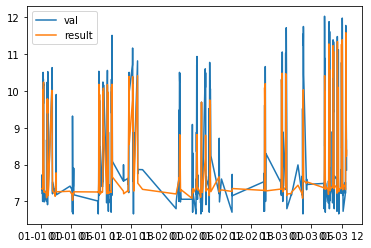

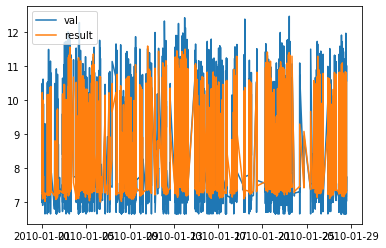

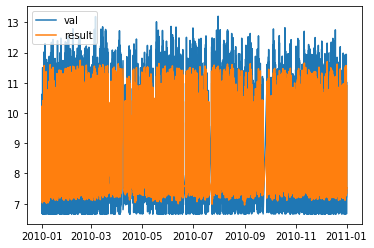

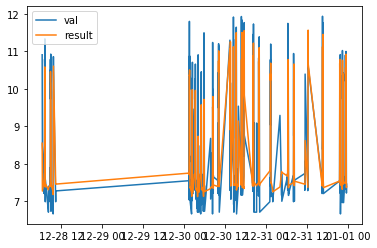

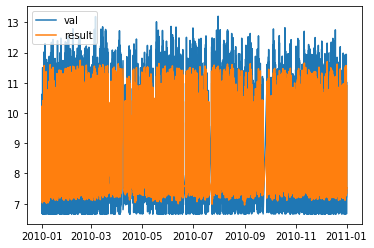

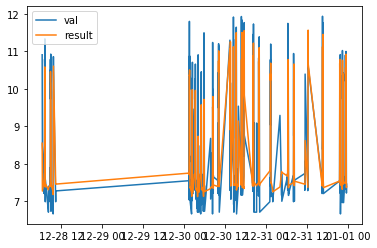

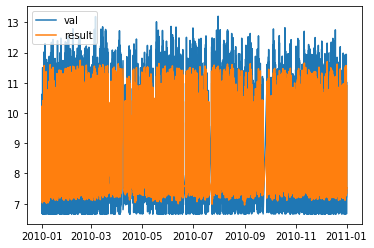

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [14]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)
model1 = Dense(128, activation='relu')(model1)
model1 = Dense(16, activation='relu')(model1)

input2 = Input(shape=(10))

model2 = Dense(32, activation='relu')(input2)
model2 = Dropout(0.25)(model2)
model2 = Dense(16, activation='relu')(model2)
model2 = Flatten()(model2)


merged =concatenate([model1, model2])
merged = Dense(8, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()


history = model.fit([X[:,1:15,:,:],X[:,0,:,:]], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],X_test[:,0,:,:]], np.array(y_val_log)), batch_size=1024,
                    epochs=500)#, y_val_log.values)#, batch_size=128)


results = model.predict([X_test[:,1:15,:,:],X_test[:,0,:,:]])#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_10 (Conv2D)              (None, 1, 1, 256)    36096       input_7[0][0]                    
__________________________________________________________________________________________________
input_8 (InputLayer)            [(None, 150)]        0                                            
__________________________________________________________________________________________________
dropout_12 (Dropout)            (None, 1, 1, 256)    0           conv2d_10[0][0]                  
____________________________________________________________________________________________

705/705 [==============================] - 2s 3ms/step - loss: 0.5541 - mse: 0.5541 - val_loss: 0.6717 - val_mse: 0.6717
Epoch 99/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5523 - mse: 0.5523 - val_loss: 0.6768 - val_mse: 0.6768
Epoch 100/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5531 - mse: 0.5531 - val_loss: 0.6743 - val_mse: 0.6743
Epoch 101/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5534 - mse: 0.5534 - val_loss: 0.6812 - val_mse: 0.6812
Epoch 102/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5529 - mse: 0.5529 - val_loss: 0.6766 - val_mse: 0.6766
Epoch 103/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5537 - mse: 0.5537 - val_loss: 0.6809 - val_mse: 0.6809
Epoch 104/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5522 - mse: 0.5522 - val_loss: 0.6735 - val_mse: 0.6735
Epoch 105/500
705/705 [==============================] - 2s 3ms/step -

Epoch 159/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5442 - mse: 0.5442 - val_loss: 0.6740 - val_mse: 0.6740
Epoch 160/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5444 - mse: 0.5444 - val_loss: 0.6894 - val_mse: 0.6894
Epoch 161/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5446 - mse: 0.5446 - val_loss: 0.6741 - val_mse: 0.6741
Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5442 - mse: 0.5442 - val_loss: 0.6768 - val_mse: 0.6768
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5445 - mse: 0.5445 - val_loss: 0.6749 - val_mse: 0.6749
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5437 - mse: 0.5437 - val_loss: 0.6731 - val_mse: 0.6731
Epoch 165/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5441 - mse: 0.5441 - val_loss: 0.6814 - val_mse: 0.6814
Epoch 166/500
705/705 [==============================] 

Epoch 280/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5338 - mse: 0.5338 - val_loss: 0.6774 - val_mse: 0.6774
Epoch 281/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5348 - mse: 0.5348 - val_loss: 0.6772 - val_mse: 0.6772
Epoch 282/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5344 - mse: 0.5344 - val_loss: 0.6712 - val_mse: 0.6712
Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5335 - mse: 0.5335 - val_loss: 0.6770 - val_mse: 0.6770
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5343 - mse: 0.5343 - val_loss: 0.6738 - val_mse: 0.6738
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5331 - mse: 0.5331 - val_loss: 0.6737 - val_mse: 0.6737
Epoch 286/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5411 - mse: 0.5411 - val_loss: 0.6973 - val_mse: 0.6973
Epoch 287/500
705/705 [==============================] 

Epoch 401/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5274 - mse: 0.5274 - val_loss: 0.6743 - val_mse: 0.6743
Epoch 402/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5284 - mse: 0.5284 - val_loss: 0.6823 - val_mse: 0.6823
Epoch 403/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5282 - mse: 0.5282 - val_loss: 0.6801 - val_mse: 0.6801
Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5281 - mse: 0.5281 - val_loss: 0.6763 - val_mse: 0.6763
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5352 - mse: 0.5352 - val_loss: 0.6732 - val_mse: 0.6732
Epoch 406/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5277 - mse: 0.5277 - val_loss: 0.6669 - val_mse: 0.6669
Epoch 407/500
705/705 [==============================] - 2s 3ms/step - loss: 0.5273 - mse: 0.5273 - val_loss: 0.6756 - val_mse: 0.6756
Epoch 408/500
705/705 [==============================] 

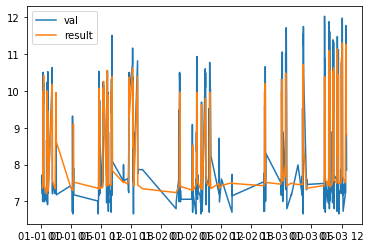

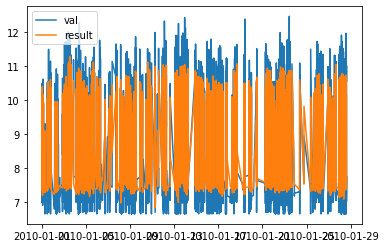

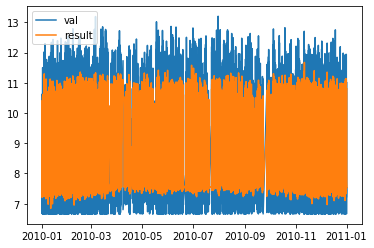

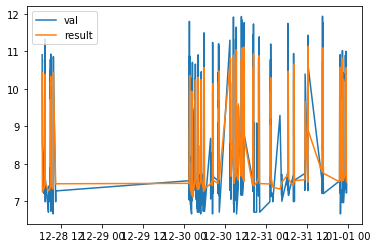

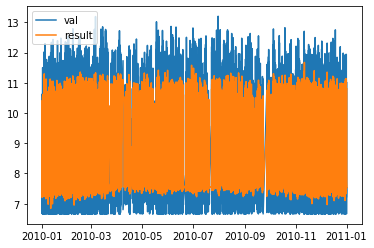

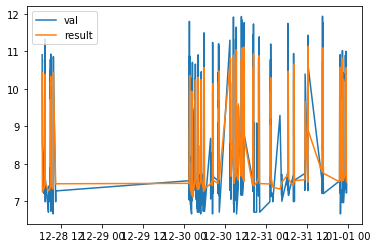

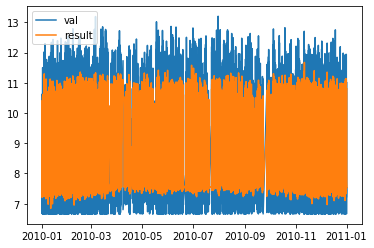

In [15]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(8, activation='relu')(model1)

input2 = Input(shape=(150))

model2 = Dense(64, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(4, activation='relu')(model2)
model2 = Flatten()(model2)


merged =concatenate([model1, model2])
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,:,:,:],(X.shape[0],150))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,:,:,:],(X_test.shape[0],150))], np.array(y_val_log)),
                    batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,:,:,:],(X_test.shape[0],150))])#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

In [1]:
%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

NameError: name 'plt' is not defined

In [8]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))
model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.1)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(10))
model2 = Dense(32, activation='relu')(input2)
model2 = Flatten()(model2)

merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 1, 1, 256)    36096       input_1[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 10)]         0                                            
__________________________________________________________________________________________________
dropout_1 (Dropout)             (None, 1, 1, 256)    0           conv2d[0][0]                     
______________________________________________________________________________________________

705/705 [==============================] - 1s 2ms/step - loss: 0.4137 - mse: 0.4137 - val_loss: 0.6243 - val_mse: 0.6243
Epoch 41/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4127 - mse: 0.4127 - val_loss: 0.6182 - val_mse: 0.6182
Epoch 42/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4131 - mse: 0.4131 - val_loss: 0.6289 - val_mse: 0.6289
Epoch 43/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4114 - mse: 0.4114 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 44/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4096 - mse: 0.4096 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 45/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4086 - mse: 0.4086 - val_loss: 0.6221 - val_mse: 0.6221
Epoch 46/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4082 - mse: 0.4082 - val_loss: 0.6255 - val_mse: 0.6255
Epoch 47/500
705/705 [==============================] - 1s 2ms/step - loss:

KeyboardInterrupt: 

In [9]:

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

NameError: name 'df_results' is not defined

In [11]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(10))
model2 = Dense(32, activation='relu')(input2)
model2 = Flatten()(model2)

merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 1, 10, 256)   3840        input_5[0][0]                    
__________________________________________________________________________________________________
dropout_3 (Dropout)             (None, 1, 10, 256)   0           conv2d_3[0][0]                   
__________________________________________________________________________________________________
input_6 (InputLayer)            [(None, 10)]         0                                            
____________________________________________________________________________________________

705/705 [==============================] - 6s 8ms/step - loss: 0.4118 - mse: 0.4118 - val_loss: 0.6151 - val_mse: 0.6151
Epoch 39/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4115 - mse: 0.4115 - val_loss: 0.6164 - val_mse: 0.6164
Epoch 40/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4540 - mse: 0.4540 - val_loss: 0.6152 - val_mse: 0.6152
Epoch 41/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4195 - mse: 0.4195 - val_loss: 0.6201 - val_mse: 0.6201
Epoch 42/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4129 - mse: 0.4129 - val_loss: 0.6122 - val_mse: 0.6122
Epoch 43/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4107 - mse: 0.4107 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 44/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4089 - mse: 0.4089 - val_loss: 0.6128 - val_mse: 0.6128
Epoch 45/500
705/705 [==============================] - 5s 8ms/step - loss:

705/705 [==============================] - 5s 8ms/step - loss: 0.3714 - mse: 0.3714 - val_loss: 0.6076 - val_mse: 0.6076
Epoch 100/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3698 - mse: 0.3698 - val_loss: 0.6137 - val_mse: 0.6137
Epoch 101/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3691 - mse: 0.3691 - val_loss: 0.6122 - val_mse: 0.6122
Epoch 102/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3686 - mse: 0.3686 - val_loss: 0.6145 - val_mse: 0.6145
Epoch 103/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3677 - mse: 0.3677 - val_loss: 0.6187 - val_mse: 0.6187
Epoch 104/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3674 - mse: 0.3674 - val_loss: 0.6211 - val_mse: 0.6211
Epoch 105/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3681 - mse: 0.3681 - val_loss: 0.6284 - val_mse: 0.6284
Epoch 106/500
705/705 [==============================] - 5s 8ms/step 

Epoch 160/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3512 - mse: 0.3512 - val_loss: 0.6199 - val_mse: 0.6199
Epoch 161/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3509 - mse: 0.3509 - val_loss: 0.6331 - val_mse: 0.6331
Epoch 162/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3509 - mse: 0.3509 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 163/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3503 - mse: 0.3503 - val_loss: 0.6142 - val_mse: 0.6142
Epoch 164/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3503 - mse: 0.3503 - val_loss: 0.6210 - val_mse: 0.6210
Epoch 165/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3497 - mse: 0.3497 - val_loss: 0.6165 - val_mse: 0.6165
Epoch 166/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3501 - mse: 0.3501 - val_loss: 0.6201 - val_mse: 0.6201
Epoch 167/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.3404 - mse: 0.3404 - val_loss: 0.6280 - val_mse: 0.6280
Epoch 221/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3449 - mse: 0.3449 - val_loss: 0.6315 - val_mse: 0.6315
Epoch 222/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3413 - mse: 0.3413 - val_loss: 0.6258 - val_mse: 0.6258
Epoch 223/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3402 - mse: 0.3402 - val_loss: 0.6292 - val_mse: 0.6292
Epoch 224/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3392 - mse: 0.3392 - val_loss: 0.6230 - val_mse: 0.6230
Epoch 225/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3435 - mse: 0.3435 - val_loss: 0.6224 - val_mse: 0.6224
Epoch 226/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3397 - mse: 0.3397 - val_loss: 0.6236 - val_mse: 0.6236
Epoch 227/500
705/705 [==============================] - 5s 8ms/step 

Epoch 281/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3305 - mse: 0.3305 - val_loss: 0.6335 - val_mse: 0.6335
Epoch 282/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3304 - mse: 0.3304 - val_loss: 0.6323 - val_mse: 0.6323
Epoch 283/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3308 - mse: 0.3308 - val_loss: 0.6276 - val_mse: 0.6276
Epoch 284/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3295 - mse: 0.3295 - val_loss: 0.6356 - val_mse: 0.6356
Epoch 285/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3307 - mse: 0.3307 - val_loss: 0.6256 - val_mse: 0.6256
Epoch 286/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3307 - mse: 0.3307 - val_loss: 0.6268 - val_mse: 0.6268
Epoch 287/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3309 - mse: 0.3309 - val_loss: 0.6294 - val_mse: 0.6294
Epoch 288/500
705/705 [==============================] 

705/705 [==============================] - 5s 8ms/step - loss: 0.3233 - mse: 0.3233 - val_loss: 0.6281 - val_mse: 0.6281
Epoch 342/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3229 - mse: 0.3229 - val_loss: 0.6286 - val_mse: 0.6286
Epoch 343/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3219 - mse: 0.3219 - val_loss: 0.6336 - val_mse: 0.6336
Epoch 344/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3212 - mse: 0.3212 - val_loss: 0.6310 - val_mse: 0.6310
Epoch 345/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3219 - mse: 0.3219 - val_loss: 0.6330 - val_mse: 0.6330
Epoch 346/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3222 - mse: 0.3222 - val_loss: 0.6282 - val_mse: 0.6282
Epoch 347/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3216 - mse: 0.3216 - val_loss: 0.6373 - val_mse: 0.6373
Epoch 348/500
705/705 [==============================] - 5s 8ms/step 

Epoch 402/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3155 - mse: 0.3155 - val_loss: 0.6360 - val_mse: 0.6360
Epoch 403/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3162 - mse: 0.3162 - val_loss: 0.6463 - val_mse: 0.6463
Epoch 404/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3171 - mse: 0.3171 - val_loss: 0.6421 - val_mse: 0.6421
Epoch 405/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3171 - mse: 0.3171 - val_loss: 0.6467 - val_mse: 0.6467
Epoch 406/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3172 - mse: 0.3172 - val_loss: 0.6413 - val_mse: 0.6413
Epoch 407/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3155 - mse: 0.3155 - val_loss: 0.6310 - val_mse: 0.6310
Epoch 408/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3157 - mse: 0.3157 - val_loss: 0.6431 - val_mse: 0.6431
Epoch 409/500
705/705 [==============================] 

705/705 [==============================] - 5s 8ms/step - loss: 0.3110 - mse: 0.3110 - val_loss: 0.6379 - val_mse: 0.6379
Epoch 463/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3108 - mse: 0.3108 - val_loss: 0.6343 - val_mse: 0.6343
Epoch 464/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3112 - mse: 0.3112 - val_loss: 0.6431 - val_mse: 0.6431
Epoch 465/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3111 - mse: 0.3111 - val_loss: 0.6382 - val_mse: 0.6382
Epoch 466/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3117 - mse: 0.3117 - val_loss: 0.6445 - val_mse: 0.6445
Epoch 467/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3109 - mse: 0.3109 - val_loss: 0.6367 - val_mse: 0.6367
Epoch 468/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3109 - mse: 0.3109 - val_loss: 0.6447 - val_mse: 0.6447
Epoch 469/500
705/705 [==============================] - 5s 8ms/step 

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [12]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(10))
model2 = Dense(32, activation='relu')(input2)
model2 = Dropout(0.5)(model2)

model2 = Flatten()(model2)

merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_5 (Conv2D)               (None, 1, 10, 256)   3840        input_7[0][0]                    
__________________________________________________________________________________________________
input_8 (InputLayer)            [(None, 10)]         0                                            
__________________________________________________________________________________________________
dropout_4 (Dropout)             (None, 1, 10, 256)   0           conv2d_5[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 5s 8ms/step - loss: 0.5527 - mse: 0.5527 - val_loss: 0.7634 - val_mse: 0.7634
Epoch 38/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5513 - mse: 0.5513 - val_loss: 0.8191 - val_mse: 0.8191
Epoch 39/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5489 - mse: 0.5489 - val_loss: 0.7585 - val_mse: 0.7585
Epoch 40/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5476 - mse: 0.5476 - val_loss: 0.7821 - val_mse: 0.7821
Epoch 41/500
705/705 [==============================] - 5s 7ms/step - loss: 0.5471 - mse: 0.5471 - val_loss: 0.7900 - val_mse: 0.7900
Epoch 42/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5456 - mse: 0.5456 - val_loss: 0.8525 - val_mse: 0.8525
Epoch 43/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5438 - mse: 0.5438 - val_loss: 0.7612 - val_mse: 0.7612
Epoch 44/500
705/705 [==============================] - 6s 8ms/step - loss:

705/705 [==============================] - 5s 7ms/step - loss: 0.4981 - mse: 0.4981 - val_loss: 0.8578 - val_mse: 0.8578
Epoch 99/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4975 - mse: 0.4975 - val_loss: 0.8555 - val_mse: 0.8555
Epoch 100/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4966 - mse: 0.4966 - val_loss: 0.8389 - val_mse: 0.8389
Epoch 101/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4959 - mse: 0.4959 - val_loss: 0.8314 - val_mse: 0.8314
Epoch 102/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4955 - mse: 0.4955 - val_loss: 0.8533 - val_mse: 0.8533
Epoch 103/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4945 - mse: 0.4945 - val_loss: 0.8743 - val_mse: 0.8743
Epoch 104/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4940 - mse: 0.4940 - val_loss: 0.8137 - val_mse: 0.8137
Epoch 105/500
705/705 [==============================] - 5s 8ms/step -

Epoch 159/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4655 - mse: 0.4655 - val_loss: 0.9026 - val_mse: 0.9026
Epoch 160/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4643 - mse: 0.4643 - val_loss: 0.9256 - val_mse: 0.9256
Epoch 161/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 0.8659 - val_mse: 0.8659
Epoch 162/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4641 - mse: 0.4641 - val_loss: 0.9142 - val_mse: 0.9142
Epoch 163/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4625 - mse: 0.4625 - val_loss: 0.9270 - val_mse: 0.9270
Epoch 164/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4638 - mse: 0.4638 - val_loss: 0.9210 - val_mse: 0.9210
Epoch 165/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4634 - mse: 0.4634 - val_loss: 0.9490 - val_mse: 0.9490
Epoch 166/500
705/705 [==============================] 

705/705 [==============================] - 5s 7ms/step - loss: 0.4469 - mse: 0.4469 - val_loss: 0.9282 - val_mse: 0.9282
Epoch 220/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4464 - mse: 0.4464 - val_loss: 0.9172 - val_mse: 0.9172
Epoch 221/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4475 - mse: 0.4475 - val_loss: 0.9347 - val_mse: 0.9347
Epoch 222/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4453 - mse: 0.4453 - val_loss: 0.9265 - val_mse: 0.9265
Epoch 223/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4452 - mse: 0.4452 - val_loss: 0.9088 - val_mse: 0.9088
Epoch 224/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4431 - mse: 0.4431 - val_loss: 0.9165 - val_mse: 0.9165
Epoch 225/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4438 - mse: 0.4438 - val_loss: 0.9963 - val_mse: 0.9963
Epoch 226/500
705/705 [==============================] - 5s 8ms/step 

Epoch 280/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4490 - mse: 0.4490 - val_loss: 0.9504 - val_mse: 0.9504
Epoch 281/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4344 - mse: 0.4344 - val_loss: 0.9620 - val_mse: 0.9620
Epoch 282/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4363 - mse: 0.4363 - val_loss: 0.9615 - val_mse: 0.9615
Epoch 283/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4336 - mse: 0.4336 - val_loss: 0.9278 - val_mse: 0.9278
Epoch 284/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4324 - mse: 0.4324 - val_loss: 0.9712 - val_mse: 0.9712
Epoch 285/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4407 - mse: 0.4407 - val_loss: 0.9201 - val_mse: 0.9201
Epoch 286/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4347 - mse: 0.4347 - val_loss: 0.9638 - val_mse: 0.9638
Epoch 287/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.4223 - mse: 0.4223 - val_loss: 1.0598 - val_mse: 1.0598
Epoch 341/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4215 - mse: 0.4215 - val_loss: 1.0303 - val_mse: 1.0303
Epoch 342/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4200 - mse: 0.4200 - val_loss: 0.9900 - val_mse: 0.9900
Epoch 343/500
705/705 [==============================] - 6s 9ms/step - loss: 0.4195 - mse: 0.4195 - val_loss: 1.0086 - val_mse: 1.0086
Epoch 344/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4193 - mse: 0.4193 - val_loss: 1.0142 - val_mse: 1.0142
Epoch 345/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4206 - mse: 0.4206 - val_loss: 1.0066 - val_mse: 1.0066
Epoch 346/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4206 - mse: 0.4206 - val_loss: 1.0027 - val_mse: 1.0027
Epoch 347/500
705/705 [==============================] - 5s 8ms/step 

Epoch 401/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4125 - mse: 0.4125 - val_loss: 1.0205 - val_mse: 1.0205
Epoch 402/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4121 - mse: 0.4121 - val_loss: 1.0637 - val_mse: 1.0637
Epoch 403/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4123 - mse: 0.4123 - val_loss: 1.0376 - val_mse: 1.0376
Epoch 404/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4115 - mse: 0.4115 - val_loss: 1.0024 - val_mse: 1.0024
Epoch 405/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4121 - mse: 0.4121 - val_loss: 1.0059 - val_mse: 1.0059
Epoch 406/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4201 - mse: 0.4201 - val_loss: 1.0551 - val_mse: 1.0551
Epoch 407/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4117 - mse: 0.4117 - val_loss: 1.0296 - val_mse: 1.0296
Epoch 408/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.4088 - mse: 0.4088 - val_loss: 1.0682 - val_mse: 1.0682
Epoch 462/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4056 - mse: 0.4056 - val_loss: 1.0122 - val_mse: 1.0122
Epoch 463/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4055 - mse: 0.4055 - val_loss: 1.0450 - val_mse: 1.0450
Epoch 464/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 1.0133 - val_mse: 1.0133
Epoch 465/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4051 - mse: 0.4051 - val_loss: 1.0762 - val_mse: 1.0762
Epoch 466/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4041 - mse: 0.4041 - val_loss: 1.0962 - val_mse: 1.0962
Epoch 467/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4051 - mse: 0.4051 - val_loss: 1.0774 - val_mse: 1.0774
Epoch 468/500
705/705 [==============================] - 6s 9ms/step 

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [13]:
model = Sequential()
# model.add(Conv1D(22, kernel_size=int(9), activation='relu', input_shape=(hist_len,22)))
# model.add(MaxPooling1D())
# model.add(Conv1D(22, kernel_size=int(5), activation='relu'))
# model.add(MaxPooling1D())
model = Sequential()
model.add(Conv2D(256, kernel_size=(15,1), activation='relu', input_shape=(15,10,1)))
model.add(Dropout(0.1))
model.add(Conv2D(256, kernel_size=(1,10), activation='relu'))

model.add(Dropout(0.1))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(X, np.array(y_train_log), 
    validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict(X_test)#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 1, 10, 256)        4096      
_________________________________________________________________
dropout_6 (Dropout)          (None, 1, 10, 256)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 1, 1, 256)         655616    
_________________________________________________________________
dropout_7 (Dropout)          (None, 1, 1, 256)         0         
_________________________________________________________________
flatten_8 (Flatten)          (None, 256)               0         
_________________________________________________________________
dense_24 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_25 (Dense)             (None, 16)               

705/705 [==============================] - 6s 8ms/step - loss: 0.4149 - mse: 0.4149 - val_loss: 0.7953 - val_mse: 0.7953
Epoch 51/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4140 - mse: 0.4140 - val_loss: 0.7332 - val_mse: 0.7332
Epoch 52/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4136 - mse: 0.4136 - val_loss: 0.8429 - val_mse: 0.8429
Epoch 53/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4111 - mse: 0.4111 - val_loss: 0.7289 - val_mse: 0.7289
Epoch 54/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4124 - mse: 0.4124 - val_loss: 0.6925 - val_mse: 0.6925
Epoch 55/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4093 - mse: 0.4093 - val_loss: 0.6668 - val_mse: 0.6668
Epoch 56/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4090 - mse: 0.4090 - val_loss: 0.6520 - val_mse: 0.6520
Epoch 57/500
705/705 [==============================] - 6s 8ms/step - loss:

705/705 [==============================] - 6s 8ms/step - loss: 0.3646 - mse: 0.3646 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 112/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3648 - mse: 0.3648 - val_loss: 0.5996 - val_mse: 0.5996
Epoch 113/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3636 - mse: 0.3636 - val_loss: 0.6109 - val_mse: 0.6109
Epoch 114/500
705/705 [==============================] - 6s 9ms/step - loss: 0.3635 - mse: 0.3635 - val_loss: 0.6027 - val_mse: 0.6027
Epoch 115/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3623 - mse: 0.3623 - val_loss: 0.5960 - val_mse: 0.5960
Epoch 116/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3619 - mse: 0.3619 - val_loss: 0.5979 - val_mse: 0.5979
Epoch 117/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3622 - mse: 0.3622 - val_loss: 0.5937 - val_mse: 0.5937
Epoch 118/500
705/705 [==============================] - 6s 8ms/step 

Epoch 172/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3391 - mse: 0.3391 - val_loss: 0.6198 - val_mse: 0.6198
Epoch 173/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3391 - mse: 0.3391 - val_loss: 0.6082 - val_mse: 0.6082
Epoch 174/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3388 - mse: 0.3388 - val_loss: 0.6108 - val_mse: 0.6108
Epoch 175/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3385 - mse: 0.3385 - val_loss: 0.6119 - val_mse: 0.6119
Epoch 176/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3398 - mse: 0.3398 - val_loss: 0.6129 - val_mse: 0.6129
Epoch 177/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3390 - mse: 0.3390 - val_loss: 0.6117 - val_mse: 0.6117
Epoch 178/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3383 - mse: 0.3383 - val_loss: 0.6092 - val_mse: 0.6092
Epoch 179/500
705/705 [==============================] 

705/705 [==============================] - 5s 7ms/step - loss: 0.3342 - mse: 0.3342 - val_loss: 0.6286 - val_mse: 0.6286
Epoch 233/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3269 - mse: 0.3269 - val_loss: 0.6155 - val_mse: 0.6155
Epoch 234/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3260 - mse: 0.3260 - val_loss: 0.6133 - val_mse: 0.6133
Epoch 235/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3258 - mse: 0.3258 - val_loss: 0.6191 - val_mse: 0.6191
Epoch 236/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3256 - mse: 0.3256 - val_loss: 0.6147 - val_mse: 0.6147
Epoch 237/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3255 - mse: 0.3255 - val_loss: 0.6195 - val_mse: 0.6195
Epoch 238/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3256 - mse: 0.3256 - val_loss: 0.6212 - val_mse: 0.6212
Epoch 239/500
705/705 [==============================] - 6s 8ms/step 

Epoch 293/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3175 - mse: 0.3175 - val_loss: 0.6184 - val_mse: 0.6184
Epoch 294/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3167 - mse: 0.3167 - val_loss: 0.6246 - val_mse: 0.6246
Epoch 295/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3162 - mse: 0.3162 - val_loss: 0.6258 - val_mse: 0.6258
Epoch 296/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3160 - mse: 0.3160 - val_loss: 0.6278 - val_mse: 0.6278
Epoch 297/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3168 - mse: 0.3168 - val_loss: 0.6201 - val_mse: 0.6201
Epoch 298/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3165 - mse: 0.3165 - val_loss: 0.6208 - val_mse: 0.6208
Epoch 299/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3168 - mse: 0.3168 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 300/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.3109 - mse: 0.3109 - val_loss: 0.6324 - val_mse: 0.6324
Epoch 354/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3101 - mse: 0.3101 - val_loss: 0.6259 - val_mse: 0.6259
Epoch 355/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3096 - mse: 0.3096 - val_loss: 0.6225 - val_mse: 0.6225
Epoch 356/500
705/705 [==============================] - 5s 7ms/step - loss: 0.3106 - mse: 0.3106 - val_loss: 0.6261 - val_mse: 0.6261
Epoch 357/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3099 - mse: 0.3099 - val_loss: 0.6267 - val_mse: 0.6267
Epoch 358/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3105 - mse: 0.3105 - val_loss: 0.6283 - val_mse: 0.6283
Epoch 359/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3103 - mse: 0.3103 - val_loss: 0.6207 - val_mse: 0.6207
Epoch 360/500
705/705 [==============================] - 6s 8ms/step 

Epoch 414/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3045 - mse: 0.3045 - val_loss: 0.6331 - val_mse: 0.6331
Epoch 415/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3048 - mse: 0.3048 - val_loss: 0.6280 - val_mse: 0.6280
Epoch 416/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3047 - mse: 0.3047 - val_loss: 0.6282 - val_mse: 0.6282
Epoch 417/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3050 - mse: 0.3050 - val_loss: 0.6264 - val_mse: 0.6264
Epoch 418/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3056 - mse: 0.3056 - val_loss: 0.6317 - val_mse: 0.6317
Epoch 419/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3048 - mse: 0.3048 - val_loss: 0.6352 - val_mse: 0.6352
Epoch 420/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3050 - mse: 0.3050 - val_loss: 0.6280 - val_mse: 0.6280
Epoch 421/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.3016 - mse: 0.3016 - val_loss: 0.6367 - val_mse: 0.6367
Epoch 475/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3010 - mse: 0.3010 - val_loss: 0.6311 - val_mse: 0.6311
Epoch 476/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3017 - mse: 0.3017 - val_loss: 0.6329 - val_mse: 0.6329
Epoch 477/500
705/705 [==============================] - 5s 8ms/step - loss: 0.3004 - mse: 0.3004 - val_loss: 0.6306 - val_mse: 0.6306
Epoch 478/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3000 - mse: 0.3000 - val_loss: 0.6318 - val_mse: 0.6318
Epoch 479/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3007 - mse: 0.3007 - val_loss: 0.6279 - val_mse: 0.6279
Epoch 480/500
705/705 [==============================] - 6s 8ms/step - loss: 0.3000 - mse: 0.3000 - val_loss: 0.6305 - val_mse: 0.6305
Epoch 481/500
705/705 [==============================] - 5s 8ms/step 

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:52: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:58: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:64: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_9 (Conv2D)               (None, 1, 10, 256)   3840        input_9[0][0]                    
__________________________________________________________________________________________________
dropout_8 (Dropout)             (None, 1, 10, 256)   0           conv2d_9[0][0]                   
__________________________________________________________________________________________________
input_10 (InputLayer)           [(None, 10)]         0                                            
____________________________________________________________________________________________

705/705 [==============================] - 6s 8ms/step - loss: 0.5810 - mse: 0.5810 - val_loss: 0.7740 - val_mse: 0.7740
Epoch 36/500
705/705 [==============================] - 6s 9ms/step - loss: 0.5765 - mse: 0.5765 - val_loss: 0.7953 - val_mse: 0.7953
Epoch 37/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5742 - mse: 0.5742 - val_loss: 0.7720 - val_mse: 0.7720
Epoch 38/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5722 - mse: 0.5722 - val_loss: 0.7704 - val_mse: 0.7704
Epoch 39/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5715 - mse: 0.5715 - val_loss: 0.8200 - val_mse: 0.8200
Epoch 40/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5696 - mse: 0.5696 - val_loss: 0.7720 - val_mse: 0.7720
Epoch 41/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5676 - mse: 0.5676 - val_loss: 0.7934 - val_mse: 0.7934
Epoch 42/500
705/705 [==============================] - 5s 7ms/step - loss:

705/705 [==============================] - 6s 8ms/step - loss: 0.5243 - mse: 0.5243 - val_loss: 1.0654 - val_mse: 1.0654
Epoch 97/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5254 - mse: 0.5254 - val_loss: 1.0594 - val_mse: 1.0594
Epoch 98/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5233 - mse: 0.5233 - val_loss: 1.0544 - val_mse: 1.0544
Epoch 99/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5227 - mse: 0.5227 - val_loss: 1.0869 - val_mse: 1.0869
Epoch 100/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5230 - mse: 0.5230 - val_loss: 1.0859 - val_mse: 1.0859
Epoch 101/500
705/705 [==============================] - 6s 9ms/step - loss: 0.5227 - mse: 0.5227 - val_loss: 1.0292 - val_mse: 1.0292
Epoch 102/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5228 - mse: 0.5228 - val_loss: 1.0513 - val_mse: 1.0513
Epoch 103/500
705/705 [==============================] - 5s 8ms/step - l

Epoch 157/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5031 - mse: 0.5031 - val_loss: 1.1644 - val_mse: 1.1644
Epoch 158/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5025 - mse: 0.5025 - val_loss: 1.2575 - val_mse: 1.2575
Epoch 159/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5013 - mse: 0.5013 - val_loss: 1.3010 - val_mse: 1.3010
Epoch 160/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5016 - mse: 0.5016 - val_loss: 1.2197 - val_mse: 1.2197
Epoch 161/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5023 - mse: 0.5023 - val_loss: 1.2097 - val_mse: 1.2097
Epoch 162/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5005 - mse: 0.5005 - val_loss: 1.2811 - val_mse: 1.2811
Epoch 163/500
705/705 [==============================] - 6s 8ms/step - loss: 0.5005 - mse: 0.5005 - val_loss: 1.2006 - val_mse: 1.2006
Epoch 164/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.4896 - mse: 0.4896 - val_loss: 1.2707 - val_mse: 1.2707
Epoch 218/500
705/705 [==============================] - 5s 7ms/step - loss: 0.4926 - mse: 0.4926 - val_loss: 1.2735 - val_mse: 1.2735
Epoch 219/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4891 - mse: 0.4891 - val_loss: 1.2786 - val_mse: 1.2786
Epoch 220/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4899 - mse: 0.4899 - val_loss: 1.2395 - val_mse: 1.2395
Epoch 221/500
705/705 [==============================] - 5s 8ms/step - loss: 0.5022 - mse: 0.5022 - val_loss: 1.2942 - val_mse: 1.2942
Epoch 222/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4896 - mse: 0.4896 - val_loss: 1.2615 - val_mse: 1.2615
Epoch 223/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4887 - mse: 0.4887 - val_loss: 1.3146 - val_mse: 1.3146
Epoch 224/500
705/705 [==============================] - 5s 8ms/step 

Epoch 278/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4818 - mse: 0.4818 - val_loss: 1.2676 - val_mse: 1.2676
Epoch 279/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4813 - mse: 0.4813 - val_loss: 1.3881 - val_mse: 1.3881
Epoch 280/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4809 - mse: 0.4809 - val_loss: 1.2317 - val_mse: 1.2317
Epoch 281/500
705/705 [==============================] - 5s 8ms/step - loss: 0.4799 - mse: 0.4799 - val_loss: 1.3271 - val_mse: 1.3271
Epoch 282/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4811 - mse: 0.4811 - val_loss: 1.2641 - val_mse: 1.2641
Epoch 283/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4798 - mse: 0.4798 - val_loss: 1.3116 - val_mse: 1.3116
Epoch 284/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4797 - mse: 0.4797 - val_loss: 1.2755 - val_mse: 1.2755
Epoch 285/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.4739 - mse: 0.4739 - val_loss: 1.2838 - val_mse: 1.2838
Epoch 339/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4739 - mse: 0.4739 - val_loss: 1.3178 - val_mse: 1.3178
Epoch 340/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4746 - mse: 0.4746 - val_loss: 1.3399 - val_mse: 1.3399
Epoch 341/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4732 - mse: 0.4732 - val_loss: 1.3048 - val_mse: 1.3048
Epoch 342/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4722 - mse: 0.4722 - val_loss: 1.3508 - val_mse: 1.3508
Epoch 343/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4737 - mse: 0.4737 - val_loss: 1.3112 - val_mse: 1.3112
Epoch 344/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4732 - mse: 0.4732 - val_loss: 1.2796 - val_mse: 1.2796
Epoch 345/500
705/705 [==============================] - 5s 8ms/step 

Epoch 399/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4682 - mse: 0.4682 - val_loss: 1.2902 - val_mse: 1.2902
Epoch 400/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4687 - mse: 0.4687 - val_loss: 1.3200 - val_mse: 1.3200
Epoch 401/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4686 - mse: 0.4686 - val_loss: 1.2817 - val_mse: 1.2817
Epoch 402/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4696 - mse: 0.4696 - val_loss: 1.2129 - val_mse: 1.2129
Epoch 403/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4685 - mse: 0.4685 - val_loss: 1.3461 - val_mse: 1.3461
Epoch 404/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4678 - mse: 0.4678 - val_loss: 1.3319 - val_mse: 1.3319
Epoch 405/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4676 - mse: 0.4676 - val_loss: 1.2872 - val_mse: 1.2872
Epoch 406/500
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.4629 - mse: 0.4629 - val_loss: 1.3154 - val_mse: 1.3154
Epoch 460/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4630 - mse: 0.4630 - val_loss: 1.2587 - val_mse: 1.2587
Epoch 461/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4632 - mse: 0.4632 - val_loss: 1.3106 - val_mse: 1.3106
Epoch 462/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4639 - mse: 0.4639 - val_loss: 1.2275 - val_mse: 1.2275
Epoch 463/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4652 - mse: 0.4652 - val_loss: 1.2767 - val_mse: 1.2767
Epoch 464/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4636 - mse: 0.4636 - val_loss: 1.3588 - val_mse: 1.3588
Epoch 465/500
705/705 [==============================] - 6s 8ms/step - loss: 0.4629 - mse: 0.4629 - val_loss: 1.3366 - val_mse: 1.3366
Epoch 466/500
705/705 [==============================] - 6s 8ms/step 

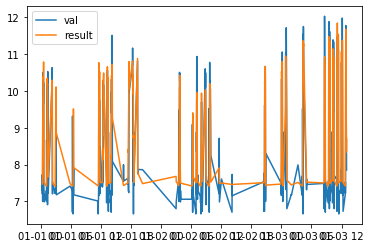

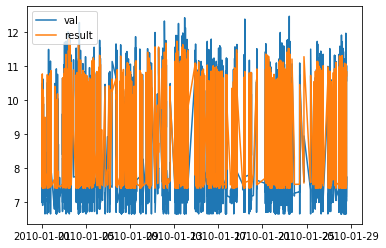

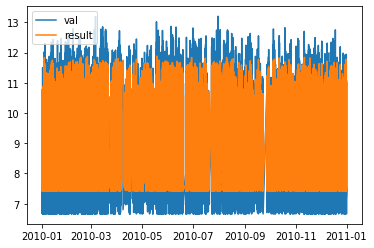

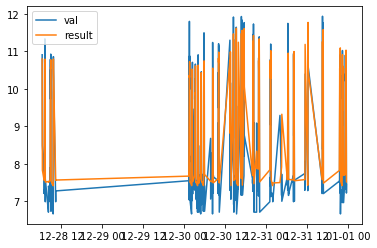

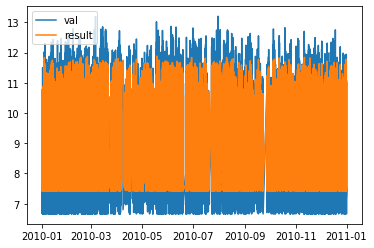

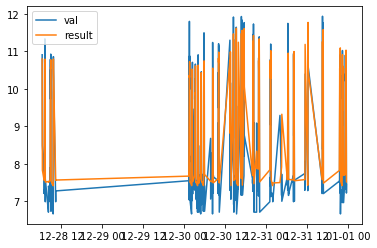

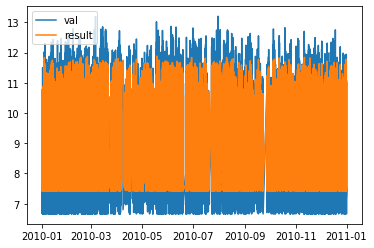

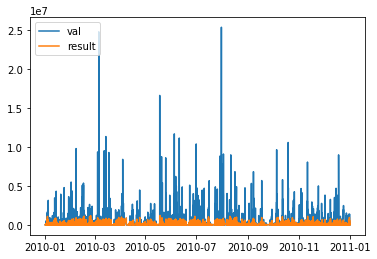

In [14]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(10))
model2 = Dense(32, activation='relu')(input2)
model2 = Dropout(0.5)(model2)

model2 = Flatten()(model2)

merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_11 (Conv2D)              (None, 1, 1, 256)    36096       input_11[0][0]                   
__________________________________________________________________________________________________
input_12 (InputLayer)           [(None, 10)]         0                                            
__________________________________________________________________________________________________
dropout_11 (Dropout)            (None, 1, 1, 256)    0           conv2d_11[0][0]                  
____________________________________________________________________________________________

705/705 [==============================] - 2s 2ms/step - loss: 0.4525 - mse: 0.4525 - val_loss: 0.6097 - val_mse: 0.6097
Epoch 41/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4498 - mse: 0.4498 - val_loss: 0.5988 - val_mse: 0.5988
Epoch 42/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4499 - mse: 0.4499 - val_loss: 0.6068 - val_mse: 0.6068
Epoch 43/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4486 - mse: 0.4486 - val_loss: 0.6084 - val_mse: 0.6084
Epoch 44/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4487 - mse: 0.4487 - val_loss: 0.6028 - val_mse: 0.6028
Epoch 45/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4487 - mse: 0.4487 - val_loss: 0.6208 - val_mse: 0.6208
Epoch 46/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4473 - mse: 0.4473 - val_loss: 0.5944 - val_mse: 0.5944
Epoch 47/500
705/705 [==============================] - 1s 2ms/step - loss:

705/705 [==============================] - 1s 2ms/step - loss: 0.4244 - mse: 0.4244 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 102/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4247 - mse: 0.4247 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 103/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4232 - mse: 0.4232 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 104/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4237 - mse: 0.4237 - val_loss: 0.5944 - val_mse: 0.5944
Epoch 105/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4234 - mse: 0.4234 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 106/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4229 - mse: 0.4229 - val_loss: 0.6008 - val_mse: 0.6008
Epoch 107/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4227 - mse: 0.4227 - val_loss: 0.6024 - val_mse: 0.6024
Epoch 108/500
705/705 [==============================] - 1s 2ms/step 

Epoch 162/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4125 - mse: 0.4125 - val_loss: 0.5954 - val_mse: 0.5954
Epoch 163/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4115 - mse: 0.4115 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 164/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4109 - mse: 0.4109 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 165/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4115 - mse: 0.4115 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 166/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4121 - mse: 0.4121 - val_loss: 0.5920 - val_mse: 0.5920
Epoch 167/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4112 - mse: 0.4112 - val_loss: 0.5870 - val_mse: 0.5870
Epoch 168/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5912 - val_mse: 0.5912
Epoch 169/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4041 - mse: 0.4041 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 223/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4046 - mse: 0.4046 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 224/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4056 - mse: 0.4056 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 225/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4037 - mse: 0.4037 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 226/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4040 - mse: 0.4040 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 227/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4028 - mse: 0.4028 - val_loss: 0.6016 - val_mse: 0.6016
Epoch 228/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4032 - mse: 0.4032 - val_loss: 0.5923 - val_mse: 0.5923
Epoch 229/500
705/705 [==============================] - 1s 2ms/step 

Epoch 283/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3989 - mse: 0.3989 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 284/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3986 - mse: 0.3986 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 285/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3996 - mse: 0.3996 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 286/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3979 - mse: 0.3979 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 287/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.6021 - val_mse: 0.6021
Epoch 288/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3978 - mse: 0.3978 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 289/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3976 - mse: 0.3976 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 290/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.3946 - mse: 0.3946 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 344/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3946 - mse: 0.3946 - val_loss: 0.5900 - val_mse: 0.5900
Epoch 345/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3960 - mse: 0.3960 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 346/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.5880 - val_mse: 0.5880
Epoch 347/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3951 - mse: 0.3951 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 348/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3943 - mse: 0.3943 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 349/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3944 - mse: 0.3944 - val_loss: 0.5944 - val_mse: 0.5944
Epoch 350/500
705/705 [==============================] - 1s 2ms/step 

Epoch 404/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3924 - mse: 0.3924 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 405/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3914 - mse: 0.3914 - val_loss: 0.5898 - val_mse: 0.5898
Epoch 406/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3928 - mse: 0.3928 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 407/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 408/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3920 - mse: 0.3920 - val_loss: 0.5923 - val_mse: 0.5923
Epoch 409/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3912 - mse: 0.3912 - val_loss: 0.5981 - val_mse: 0.5981
Epoch 410/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 411/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.3895 - mse: 0.3895 - val_loss: 0.5976 - val_mse: 0.5976
Epoch 465/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3897 - mse: 0.3897 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 466/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3890 - mse: 0.3890 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 467/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3891 - mse: 0.3891 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 468/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3893 - mse: 0.3893 - val_loss: 0.5944 - val_mse: 0.5944
Epoch 469/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3895 - mse: 0.3895 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 470/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3894 - mse: 0.3894 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 471/500
705/705 [==============================] - 1s 2ms/step 

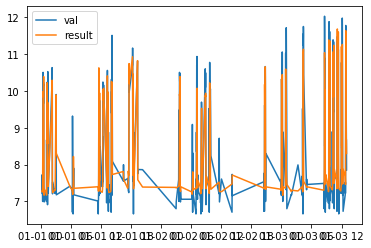

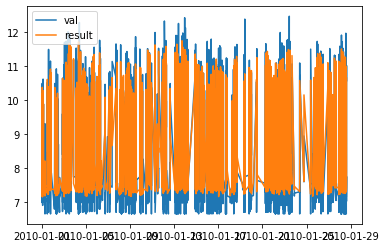

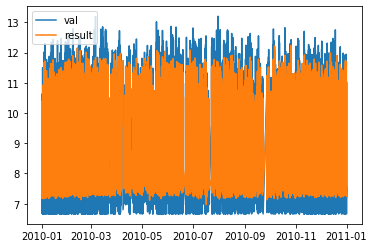

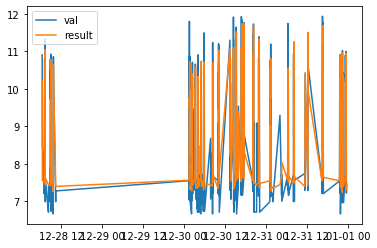

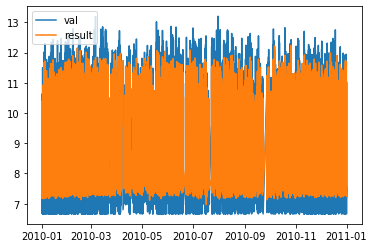

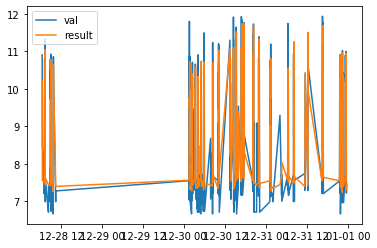

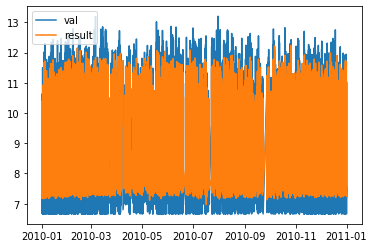

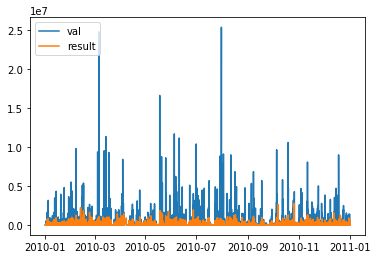

In [15]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))
model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(10))
model2 = Dense(128, activation='relu')(input2)
model2 = Flatten()(model2)

merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 1, 1, 256)    36096       input_13[0][0]                   
__________________________________________________________________________________________________
input_14 (InputLayer)           [(None, 10)]         0                                            
__________________________________________________________________________________________________
dropout_12 (Dropout)            (None, 1, 1, 256)    0           conv2d_12[0][0]                  
____________________________________________________________________________________________

705/705 [==============================] - 2s 3ms/step - loss: 0.4449 - mse: 0.4449 - val_loss: 0.6301 - val_mse: 0.6301
Epoch 41/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4449 - mse: 0.4449 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 42/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4442 - mse: 0.4442 - val_loss: 0.6149 - val_mse: 0.6149
Epoch 43/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4429 - mse: 0.4429 - val_loss: 0.5970 - val_mse: 0.5970
Epoch 44/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5999 - val_mse: 0.5999
Epoch 45/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4425 - mse: 0.4425 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 46/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4421 - mse: 0.4421 - val_loss: 0.5994 - val_mse: 0.5994
Epoch 47/500
705/705 [==============================] - 1s 2ms/step - loss:

705/705 [==============================] - 1s 2ms/step - loss: 0.4187 - mse: 0.4187 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 102/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4187 - mse: 0.4187 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 103/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4184 - mse: 0.4184 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 104/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4184 - mse: 0.4184 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 105/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4188 - mse: 0.4188 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 106/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4180 - mse: 0.4180 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 107/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4178 - mse: 0.4178 - val_loss: 0.5917 - val_mse: 0.5917
Epoch 108/500
705/705 [==============================] - 2s 2ms/step 

Epoch 162/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4081 - mse: 0.4081 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 163/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4074 - mse: 0.4074 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 164/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4079 - mse: 0.4079 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 165/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4080 - mse: 0.4080 - val_loss: 0.5893 - val_mse: 0.5893
Epoch 166/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4077 - mse: 0.4077 - val_loss: 0.5829 - val_mse: 0.5829
Epoch 167/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 168/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4079 - mse: 0.4079 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 169/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4011 - mse: 0.4011 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 223/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4006 - mse: 0.4006 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 224/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4011 - mse: 0.4011 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 225/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4007 - mse: 0.4007 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 226/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4007 - mse: 0.4007 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 227/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4008 - mse: 0.4008 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 228/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4013 - mse: 0.4013 - val_loss: 0.5950 - val_mse: 0.5950
Epoch 229/500
705/705 [==============================] - 2s 2ms/step 

Epoch 283/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4032 - mse: 0.4032 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 284/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3993 - mse: 0.3993 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 285/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3967 - mse: 0.3967 - val_loss: 0.5902 - val_mse: 0.5902
Epoch 286/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3963 - mse: 0.3963 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 287/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3967 - mse: 0.3967 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 288/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3961 - mse: 0.3961 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 289/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3964 - mse: 0.3964 - val_loss: 0.5865 - val_mse: 0.5865
Epoch 290/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.3929 - mse: 0.3929 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 344/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3929 - mse: 0.3929 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 345/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3916 - mse: 0.3916 - val_loss: 0.6041 - val_mse: 0.6041
Epoch 346/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3932 - mse: 0.3932 - val_loss: 0.5993 - val_mse: 0.5993
Epoch 347/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3933 - mse: 0.3933 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 348/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3923 - mse: 0.3923 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 349/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5930 - val_mse: 0.5930
Epoch 350/500
705/705 [==============================] - 1s 2ms/step 

Epoch 404/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3900 - mse: 0.3900 - val_loss: 0.5895 - val_mse: 0.5895
Epoch 405/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3902 - mse: 0.3902 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 406/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3899 - mse: 0.3899 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 407/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3898 - mse: 0.3898 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 408/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3895 - mse: 0.3895 - val_loss: 0.5937 - val_mse: 0.5937
Epoch 409/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3889 - mse: 0.3889 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 410/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3896 - mse: 0.3896 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 411/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.3873 - mse: 0.3873 - val_loss: 0.5905 - val_mse: 0.5905
Epoch 465/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3873 - mse: 0.3873 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 466/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3863 - mse: 0.3863 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 467/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3863 - mse: 0.3863 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 468/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3867 - mse: 0.3867 - val_loss: 0.5897 - val_mse: 0.5897
Epoch 469/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3863 - mse: 0.3863 - val_loss: 0.5906 - val_mse: 0.5906
Epoch 470/500
705/705 [==============================] - 1s 2ms/step - loss: 0.3869 - mse: 0.3869 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 471/500
705/705 [==============================] - 1s 2ms/step 

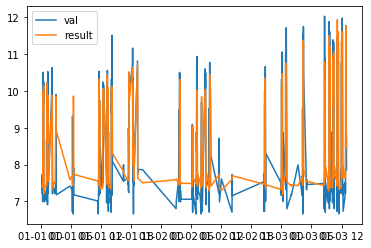

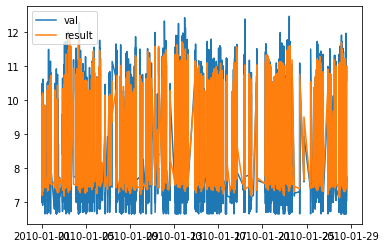

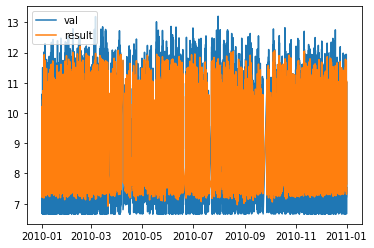

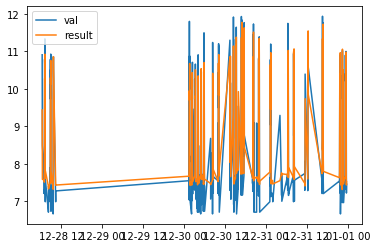

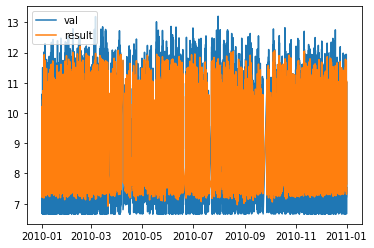

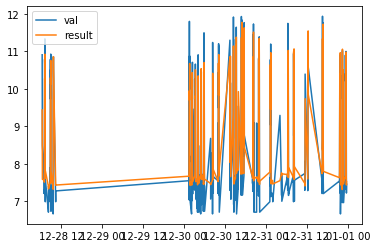

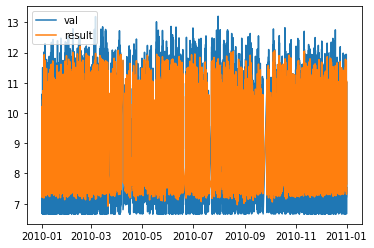

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [16]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(10))

model2 = Dense(128, activation='relu')(input2)
model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib widget

plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

%matplotlib inline

In [ ]:
# plt.figure()
# plt.plot(10**y_val_log[:]*1.6e-6)
# plt.plot(10**df_results[:]*1.6e-6)
# plt.legend(['val', 'result'], loc='upper left')
# plt.show()

plt.figure()
plt.hist(10**y_val_log[:]*1.6e-6,bins=10)
plt.hist(10**df_results[:]*1.6e-6,bins=10)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

KeyboardInterrupt: 

In [ ]:
plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20)
plt.hist(10**df_results.values*1.6e-6,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_14 (InputLayer)           [(None, 10)]         0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 1, 1, 256)    36096       input_13[0][0]                   
__________________________________________________________________________________________________
dense_32 (Dense)                (None, 512)          5632        input_14[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 2s 2ms/step - loss: 0.4602 - mse: 0.4602 - val_loss: 0.6086 - val_mse: 0.6086
Epoch 39/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4606 - mse: 0.4606 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 40/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4590 - mse: 0.4590 - val_loss: 0.5966 - val_mse: 0.5966
Epoch 41/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4584 - mse: 0.4584 - val_loss: 0.6046 - val_mse: 0.6046
Epoch 42/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4564 - mse: 0.4564 - val_loss: 0.5982 - val_mse: 0.5982
Epoch 43/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4566 - mse: 0.4566 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 44/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4559 - mse: 0.4559 - val_loss: 0.6230 - val_mse: 0.6230
Epoch 45/500
705/705 [==============================] - 2s 2ms/step - loss:

705/705 [==============================] - 2s 2ms/step - loss: 0.4291 - mse: 0.4291 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 100/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 101/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4286 - mse: 0.4286 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 102/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4284 - mse: 0.4284 - val_loss: 0.5802 - val_mse: 0.5802
Epoch 103/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4284 - mse: 0.4284 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 104/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4271 - mse: 0.4271 - val_loss: 0.5938 - val_mse: 0.5938
Epoch 105/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4266 - mse: 0.4266 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 106/500
705/705 [==============================] - 2s 2ms/step 

Epoch 160/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4166 - mse: 0.4166 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 161/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4158 - mse: 0.4158 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 162/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4162 - mse: 0.4162 - val_loss: 0.5805 - val_mse: 0.5805
Epoch 163/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4160 - mse: 0.4160 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 164/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4159 - mse: 0.4159 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 165/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4154 - mse: 0.4154 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 166/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4150 - mse: 0.4150 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 167/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 221/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4094 - mse: 0.4094 - val_loss: 0.5831 - val_mse: 0.5831
Epoch 222/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4095 - mse: 0.4095 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 223/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4082 - mse: 0.4082 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 224/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4096 - mse: 0.4096 - val_loss: 0.5806 - val_mse: 0.5806
Epoch 225/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4079 - mse: 0.4079 - val_loss: 0.5841 - val_mse: 0.5841
Epoch 226/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4076 - mse: 0.4076 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 227/500
705/705 [==============================] - 2s 2ms/step 

Epoch 281/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 282/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4043 - mse: 0.4043 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 283/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4033 - mse: 0.4033 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 284/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4036 - mse: 0.4036 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 285/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4033 - mse: 0.4033 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 286/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4034 - mse: 0.4034 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 287/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4027 - mse: 0.4027 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 288/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5829 - val_mse: 0.5829
Epoch 342/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4004 - mse: 0.4004 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 343/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4004 - mse: 0.4004 - val_loss: 0.5776 - val_mse: 0.5776
Epoch 344/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4008 - mse: 0.4008 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 345/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4001 - mse: 0.4001 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 346/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4000 - mse: 0.4000 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 347/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3998 - mse: 0.3998 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 348/500
705/705 [==============================] - 2s 2ms/step 

Epoch 402/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3973 - mse: 0.3973 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 403/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3971 - mse: 0.3971 - val_loss: 0.5880 - val_mse: 0.5880
Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3968 - mse: 0.3968 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3972 - mse: 0.3972 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 406/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3972 - mse: 0.3972 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 407/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 408/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3969 - mse: 0.3969 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 409/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.5906 - val_mse: 0.5906
Epoch 463/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3950 - mse: 0.3950 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 464/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 465/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3943 - mse: 0.3943 - val_loss: 0.5893 - val_mse: 0.5893
Epoch 466/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3953 - mse: 0.3953 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 467/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3950 - mse: 0.3950 - val_loss: 0.5811 - val_mse: 0.5811
Epoch 468/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3949 - mse: 0.3949 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 469/500
705/705 [==============================] - 2s 2ms/step 

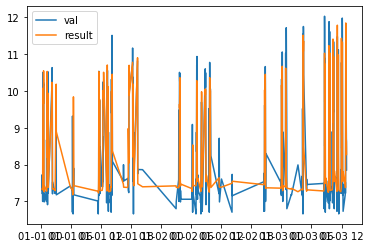

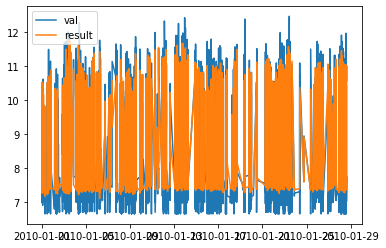

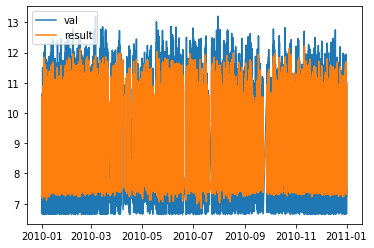

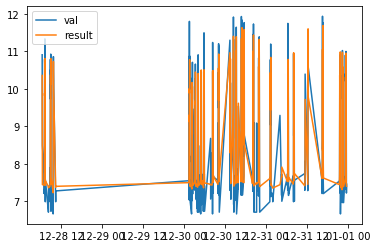

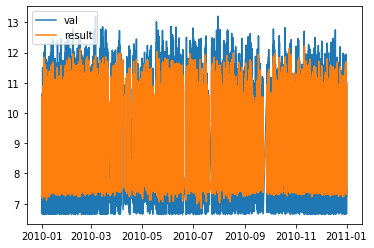

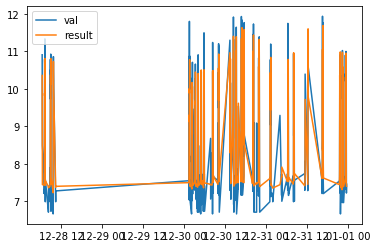

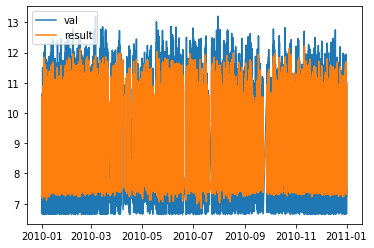

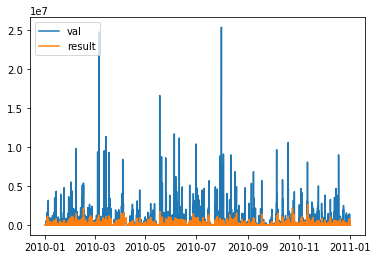

In [20]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(10))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()



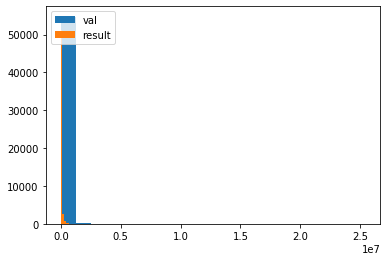

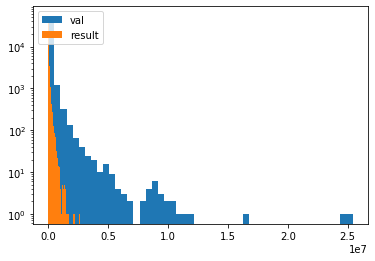

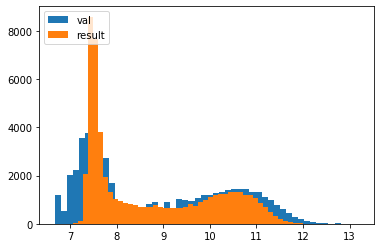

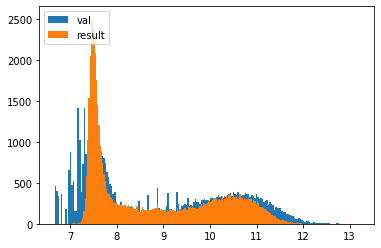

In [21]:
plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20)
plt.hist(10**df_results.values*1.6e-6,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values[:]*1.6e-6,bins=50,log=True)
plt.hist(10**df_results.values*1.6e-6,bins=50,log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=50)
plt.hist(df_results.values,bins=50)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=200)
plt.hist(df_results.values,bins=200)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

In [24]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_20 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_9 (Conv2D)               (None, 1, 1, 256)    36096       input_19[0][0]                   
__________________________________________________________________________________________________
dense_47 (Dense)                (None, 768)          6912        input_20[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 2s 2ms/step - loss: 0.4502 - mse: 0.4502 - val_loss: 0.5943 - val_mse: 0.5943
Epoch 39/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4496 - mse: 0.4496 - val_loss: 0.5815 - val_mse: 0.5815
Epoch 40/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4480 - mse: 0.4480 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 41/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4473 - mse: 0.4473 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 42/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4455 - mse: 0.4455 - val_loss: 0.5954 - val_mse: 0.5954
Epoch 43/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4451 - mse: 0.4451 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 44/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4451 - mse: 0.4451 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 45/500
705/705 [==============================] - 2s 3ms/step - loss:

705/705 [==============================] - 2s 3ms/step - loss: 0.4199 - mse: 0.4199 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 100/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 101/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4197 - mse: 0.4197 - val_loss: 0.5742 - val_mse: 0.5742
Epoch 102/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4191 - mse: 0.4191 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 103/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5774 - val_mse: 0.5774
Epoch 104/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4192 - mse: 0.4192 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 105/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4189 - mse: 0.4189 - val_loss: 0.5743 - val_mse: 0.5743
Epoch 106/500
705/705 [==============================] - 2s 3ms/step 

Epoch 160/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4091 - mse: 0.4091 - val_loss: 0.5700 - val_mse: 0.5700
Epoch 161/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4086 - mse: 0.4086 - val_loss: 0.5721 - val_mse: 0.5721
Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4075 - mse: 0.4075 - val_loss: 0.5756 - val_mse: 0.5756
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4083 - mse: 0.4083 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4083 - mse: 0.4083 - val_loss: 0.5754 - val_mse: 0.5754
Epoch 165/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4079 - mse: 0.4079 - val_loss: 0.5748 - val_mse: 0.5748
Epoch 166/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4076 - mse: 0.4076 - val_loss: 0.5746 - val_mse: 0.5746
Epoch 167/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.4025 - mse: 0.4025 - val_loss: 0.5732 - val_mse: 0.5732
Epoch 221/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4022 - mse: 0.4022 - val_loss: 0.5740 - val_mse: 0.5740
Epoch 222/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4008 - mse: 0.4008 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 223/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4014 - mse: 0.4014 - val_loss: 0.5732 - val_mse: 0.5732
Epoch 224/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4024 - mse: 0.4024 - val_loss: 0.5736 - val_mse: 0.5736
Epoch 225/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4019 - mse: 0.4019 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 226/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4014 - mse: 0.4014 - val_loss: 0.5741 - val_mse: 0.5741
Epoch 227/500
705/705 [==============================] - 2s 3ms/step 

Epoch 281/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3978 - mse: 0.3978 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 282/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3976 - mse: 0.3976 - val_loss: 0.5732 - val_mse: 0.5732
Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3971 - mse: 0.3971 - val_loss: 0.5736 - val_mse: 0.5736
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3976 - mse: 0.3976 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 286/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3970 - mse: 0.3970 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 287/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3976 - mse: 0.3976 - val_loss: 0.5792 - val_mse: 0.5792
Epoch 288/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.3943 - mse: 0.3943 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 342/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3935 - mse: 0.3935 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 343/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3941 - mse: 0.3941 - val_loss: 0.5773 - val_mse: 0.5773
Epoch 344/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3937 - mse: 0.3937 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 345/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3938 - mse: 0.3938 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 346/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3941 - mse: 0.3941 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 347/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3935 - mse: 0.3935 - val_loss: 0.5755 - val_mse: 0.5755
Epoch 348/500
705/705 [==============================] - 2s 3ms/step 

KeyboardInterrupt: 

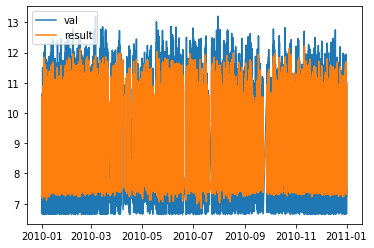

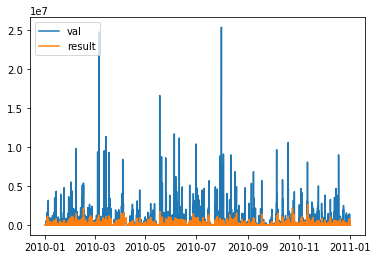

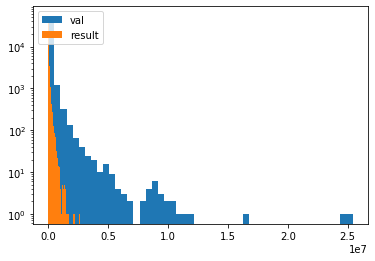

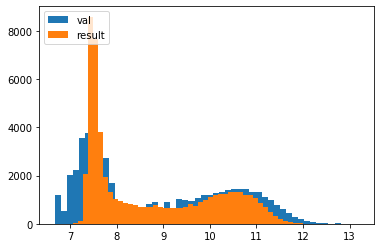

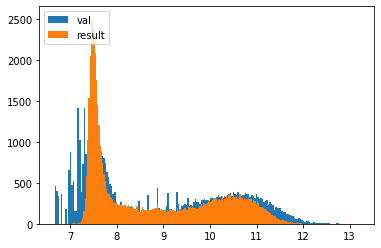

In [25]:
plt.figure()
plt.plot(y_val_log)
plt.plot(df_results)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log*1.6e-6)
plt.plot(10**df_results*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values[:]*1.6e-6,bins=50,log=True)
plt.hist(10**df_results.values*1.6e-6,bins=50,log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=50)
plt.hist(df_results.values,bins=50)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=200)
plt.hist(df_results.values,bins=200)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_22 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_10 (Conv2D)              (None, 1, 1, 256)    36096       input_21[0][0]                   
__________________________________________________________________________________________________
dense_52 (Dense)                (None, 3072)         27648       input_22[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 3s 4ms/step - loss: 0.4761 - mse: 0.4761 - val_loss: 0.5929 - val_mse: 0.5929
Epoch 39/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4757 - mse: 0.4757 - val_loss: 0.6173 - val_mse: 0.6173
Epoch 40/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4737 - mse: 0.4737 - val_loss: 0.5986 - val_mse: 0.5986
Epoch 41/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4723 - mse: 0.4723 - val_loss: 0.6092 - val_mse: 0.6092
Epoch 42/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4723 - mse: 0.4723 - val_loss: 0.5973 - val_mse: 0.5973
Epoch 43/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4711 - mse: 0.4711 - val_loss: 0.6002 - val_mse: 0.6002
Epoch 44/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4699 - mse: 0.4699 - val_loss: 0.5985 - val_mse: 0.5985
Epoch 45/300
705/705 [==============================] - 3s 4ms/step - loss:

705/705 [==============================] - 3s 4ms/step - loss: 0.4336 - mse: 0.4336 - val_loss: 0.5758 - val_mse: 0.5758
Epoch 100/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4347 - mse: 0.4347 - val_loss: 0.5834 - val_mse: 0.5834
Epoch 101/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4337 - mse: 0.4337 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 102/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4337 - mse: 0.4337 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 103/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4327 - mse: 0.4327 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 104/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4322 - mse: 0.4322 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 105/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4325 - mse: 0.4325 - val_loss: 0.5834 - val_mse: 0.5834
Epoch 106/300
705/705 [==============================] - 3s 4ms/step 

Epoch 160/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4190 - mse: 0.4190 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 161/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4185 - mse: 0.4185 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 162/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4178 - mse: 0.4178 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 163/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4178 - mse: 0.4178 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 164/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4184 - mse: 0.4184 - val_loss: 0.5751 - val_mse: 0.5751
Epoch 165/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4177 - mse: 0.4177 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 166/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4180 - mse: 0.4180 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 167/300
705/705 [==============================] 

705/705 [==============================] - 3s 4ms/step - loss: 0.4097 - mse: 0.4097 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 221/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4099 - mse: 0.4099 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 222/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4095 - mse: 0.4095 - val_loss: 0.5758 - val_mse: 0.5758
Epoch 223/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4086 - mse: 0.4086 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 224/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4089 - mse: 0.4089 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 225/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4092 - mse: 0.4092 - val_loss: 0.5734 - val_mse: 0.5734
Epoch 226/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4101 - mse: 0.4101 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 227/300
705/705 [==============================] - 3s 4ms/step 

Epoch 281/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4026 - mse: 0.4026 - val_loss: 0.5740 - val_mse: 0.5740
Epoch 282/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4030 - mse: 0.4030 - val_loss: 0.5740 - val_mse: 0.5740
Epoch 283/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4026 - mse: 0.4026 - val_loss: 0.5756 - val_mse: 0.5756
Epoch 284/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4022 - mse: 0.4022 - val_loss: 0.5754 - val_mse: 0.5754
Epoch 285/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4028 - mse: 0.4028 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 286/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4036 - mse: 0.4036 - val_loss: 0.5830 - val_mse: 0.5830
Epoch 287/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4019 - mse: 0.4019 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 288/300
705/705 [==============================] 

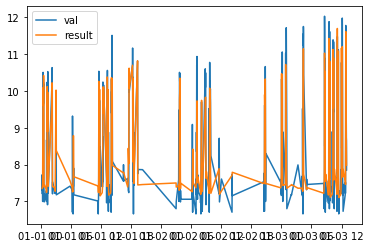

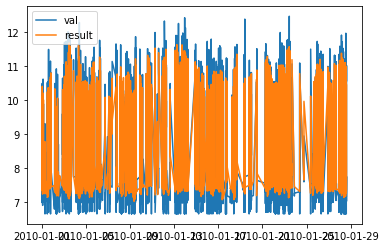

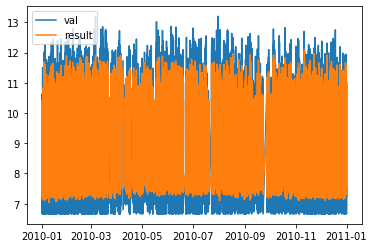

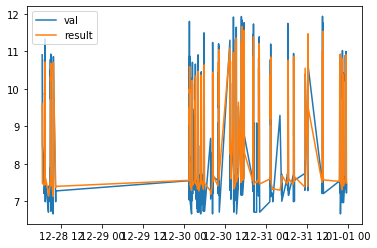

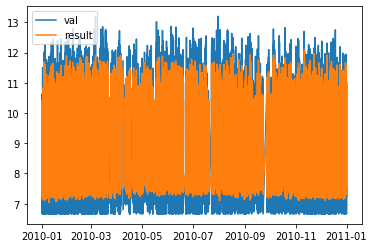

...

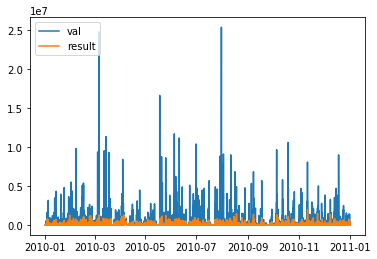

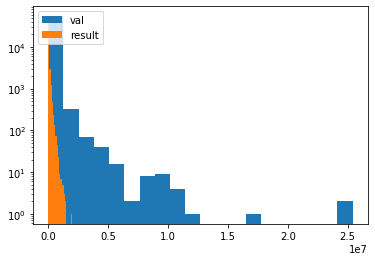

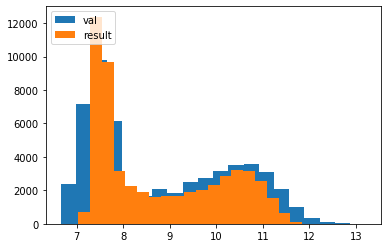

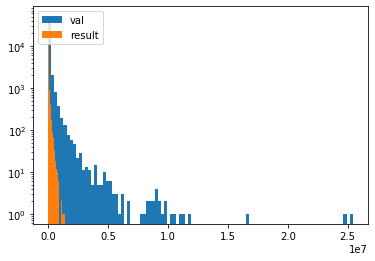

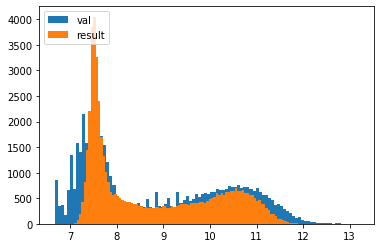

In [26]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768*4, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
input_23 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
dense_57 (Dense)                (None, 512)          4608        input_24[0][0]                   
__________________________________________________________________________________________________
conv2d_11 (Conv2D)              (None, 1, 1, 256)    36096       input_23[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 2s 2ms/step - loss: 0.4558 - mse: 0.4558 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 38/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4561 - mse: 0.4561 - val_loss: 0.5992 - val_mse: 0.5992
Epoch 39/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4542 - mse: 0.4542 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 40/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4538 - mse: 0.4538 - val_loss: 0.5835 - val_mse: 0.5835
Epoch 41/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4517 - mse: 0.4517 - val_loss: 0.5922 - val_mse: 0.5922
Epoch 42/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4533 - mse: 0.4533 - val_loss: 0.5974 - val_mse: 0.5974
Epoch 43/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4515 - mse: 0.4515 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 44/300
705/705 [==============================] - 2s 2ms/step - loss:

705/705 [==============================] - 2s 2ms/step - loss: 0.4291 - mse: 0.4291 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 99/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4280 - mse: 0.4280 - val_loss: 0.5991 - val_mse: 0.5991
Epoch 100/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4277 - mse: 0.4277 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 101/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4276 - mse: 0.4276 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 102/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4283 - mse: 0.4283 - val_loss: 0.5773 - val_mse: 0.5773
Epoch 103/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4258 - mse: 0.4258 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 104/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4271 - mse: 0.4271 - val_loss: 0.5907 - val_mse: 0.5907
Epoch 105/300
705/705 [==============================] - 2s 2ms/step -

Epoch 159/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4146 - mse: 0.4146 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 160/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 161/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4151 - mse: 0.4151 - val_loss: 0.5776 - val_mse: 0.5776
Epoch 162/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4154 - mse: 0.4154 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 163/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5753 - val_mse: 0.5753
Epoch 164/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4147 - mse: 0.4147 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 165/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4145 - mse: 0.4145 - val_loss: 0.5739 - val_mse: 0.5739
Epoch 166/300
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4076 - mse: 0.4076 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 220/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4075 - mse: 0.4075 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 221/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4067 - mse: 0.4067 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 222/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4076 - mse: 0.4076 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 223/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 224/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4069 - mse: 0.4069 - val_loss: 0.5743 - val_mse: 0.5743
Epoch 225/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4067 - mse: 0.4067 - val_loss: 0.5805 - val_mse: 0.5805
Epoch 226/300
705/705 [==============================] - 2s 2ms/step 

Epoch 280/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4014 - mse: 0.4014 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 281/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4041 - mse: 0.4041 - val_loss: 0.5745 - val_mse: 0.5745
Epoch 282/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4012 - mse: 0.4012 - val_loss: 0.5708 - val_mse: 0.5708
Epoch 283/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4001 - mse: 0.4001 - val_loss: 0.5735 - val_mse: 0.5735
Epoch 284/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4019 - mse: 0.4019 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 285/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4016 - mse: 0.4016 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 286/300
705/705 [==============================] - 2s 2ms/step - loss: 0.4009 - mse: 0.4009 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 287/300
705/705 [==============================] 

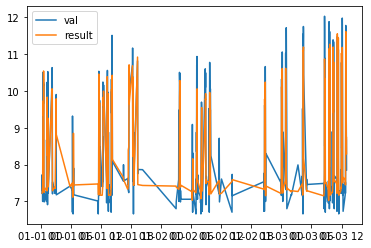

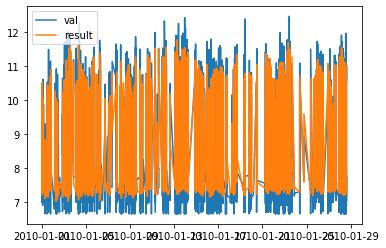

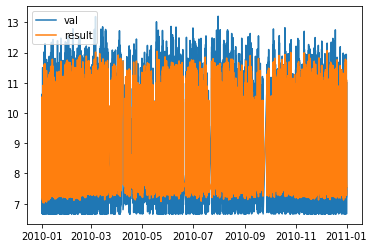

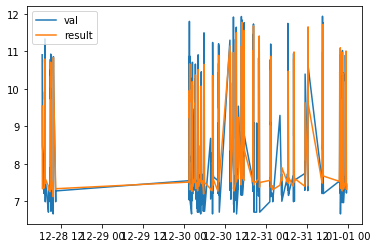

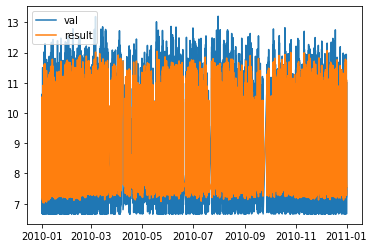

...

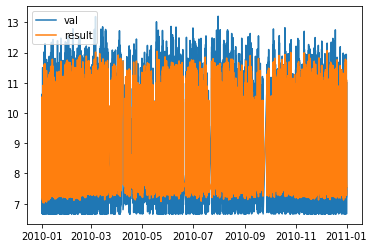

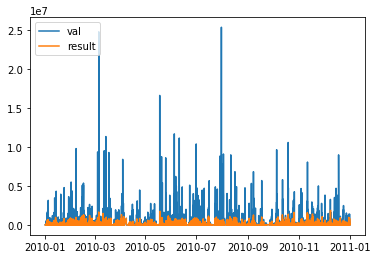

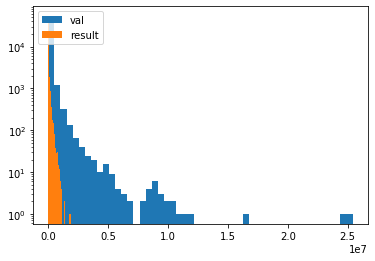

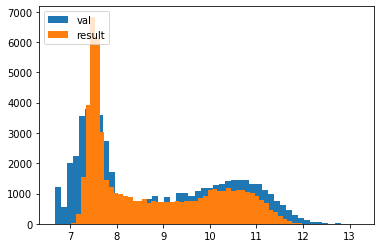

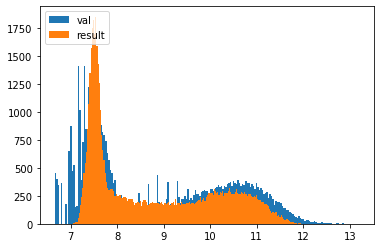

In [27]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log)
plt.plot(df_results)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log*1.6e-6)
plt.plot(10**df_results*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values[:]*1.6e-6,bins=50,log=True)
plt.hist(10**df_results.values*1.6e-6,bins=50,log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=50)
plt.hist(df_results.values,bins=50)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=200)
plt.hist(df_results.values,bins=200)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_25 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 14, 1, 256)   2816        input_25[0][0]                   
__________________________________________________________________________________________________
input_26 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_24 (Dropout)            (None, 14, 1, 256)   0           conv2d_12[0][0]                  
___________________________________________________________________________________________

705/705 [==============================] - 6s 9ms/step - loss: 0.4753 - mse: 0.4753 - val_loss: 0.6027 - val_mse: 0.6027
Epoch 35/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4750 - mse: 0.4750 - val_loss: 0.5980 - val_mse: 0.5980
Epoch 36/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4727 - mse: 0.4727 - val_loss: 0.6513 - val_mse: 0.6513
Epoch 37/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4721 - mse: 0.4721 - val_loss: 0.5980 - val_mse: 0.5980
Epoch 38/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4710 - mse: 0.4710 - val_loss: 0.5968 - val_mse: 0.5968
Epoch 39/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4693 - mse: 0.4693 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 40/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4687 - mse: 0.4687 - val_loss: 0.6096 - val_mse: 0.6096
Epoch 41/300
705/705 [==============================] - 6s 9ms/step - loss:

705/705 [==============================] - 6s 9ms/step - loss: 0.4431 - mse: 0.4431 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 96/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4433 - mse: 0.4433 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 97/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4427 - mse: 0.4427 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 98/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4440 - mse: 0.4440 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 99/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 100/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 101/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 102/300
705/705 [==============================] - 7s 9ms/step - lo

Epoch 156/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4304 - mse: 0.4304 - val_loss: 0.5820 - val_mse: 0.5820
Epoch 157/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4313 - mse: 0.4313 - val_loss: 0.6000 - val_mse: 0.6000
Epoch 158/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4313 - mse: 0.4313 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 159/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4311 - mse: 0.4311 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 160/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4299 - mse: 0.4299 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 161/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5792 - val_mse: 0.5792
Epoch 162/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4290 - mse: 0.4290 - val_loss: 0.5897 - val_mse: 0.5897
Epoch 163/300
705/705 [==============================] 

705/705 [==============================] - 6s 9ms/step - loss: 0.4231 - mse: 0.4231 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 217/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4233 - mse: 0.4233 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 218/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4214 - mse: 0.4214 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 219/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4221 - mse: 0.4221 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 220/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4224 - mse: 0.4224 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 221/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4222 - mse: 0.4222 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 222/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4224 - mse: 0.4224 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 223/300
705/705 [==============================] - 7s 9ms/step 

Epoch 277/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4177 - mse: 0.4177 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 278/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4172 - mse: 0.4172 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 279/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4172 - mse: 0.4172 - val_loss: 0.5891 - val_mse: 0.5891
Epoch 280/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4172 - mse: 0.4172 - val_loss: 0.5786 - val_mse: 0.5786
Epoch 281/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4165 - mse: 0.4165 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 282/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4168 - mse: 0.4168 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 283/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4173 - mse: 0.4173 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 284/300
705/705 [==============================] 

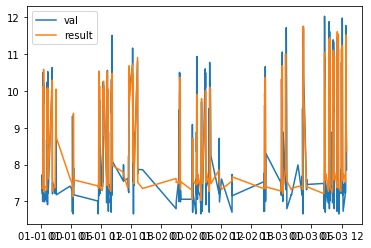

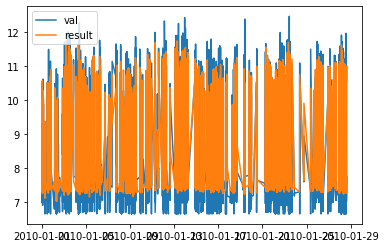

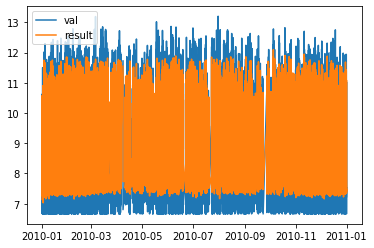

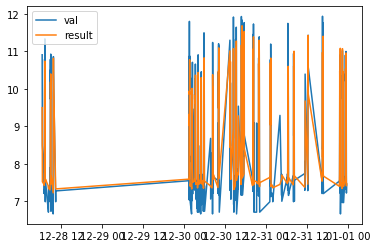

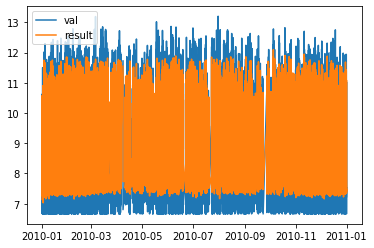

...

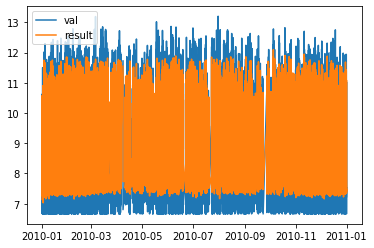

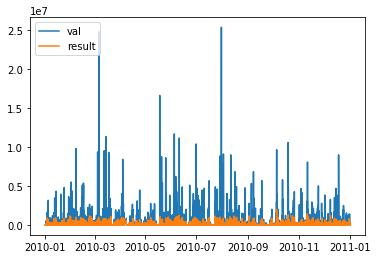

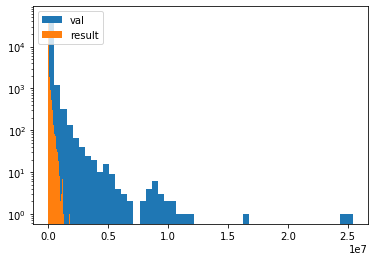

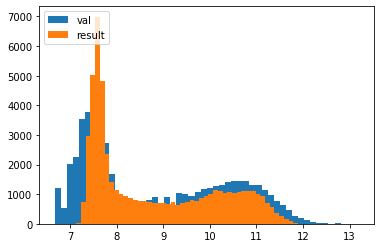

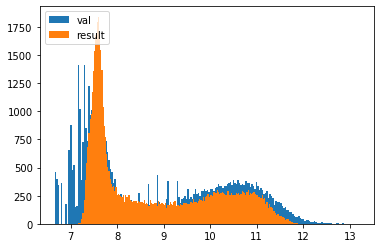

In [28]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log)
plt.plot(df_results)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log*1.6e-6)
plt.plot(10**df_results*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values[:]*1.6e-6,bins=50,log=True)
plt.hist(10**df_results.values*1.6e-6,bins=50,log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=50)
plt.hist(df_results.values,bins=50)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=200)
plt.hist(df_results.values,bins=200)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_28 (InputLayer)           [(None, 10)]         0                                            
__________________________________________________________________________________________________
conv2d_14 (Conv2D)              (None, 1, 1, 512)    72192       input_27[0][0]                   
__________________________________________________________________________________________________
dense_69 (Dense)                (None, 1024)         11264       input_28[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 2s 3ms/step - loss: 0.4676 - mse: 0.4676 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 39/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4675 - mse: 0.4675 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 40/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4660 - mse: 0.4660 - val_loss: 0.6020 - val_mse: 0.6020
Epoch 41/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4649 - mse: 0.4649 - val_loss: 0.5965 - val_mse: 0.5965
Epoch 42/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4626 - mse: 0.4626 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 43/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4625 - mse: 0.4625 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 44/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4609 - mse: 0.4609 - val_loss: 0.6064 - val_mse: 0.6064
Epoch 45/300
705/705 [==============================] - 2s 3ms/step - loss:

705/705 [==============================] - 2s 3ms/step - loss: 0.4233 - mse: 0.4233 - val_loss: 0.5805 - val_mse: 0.5805
Epoch 100/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4236 - mse: 0.4236 - val_loss: 0.5780 - val_mse: 0.5780
Epoch 101/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4227 - mse: 0.4227 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 102/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4227 - mse: 0.4227 - val_loss: 0.5743 - val_mse: 0.5743
Epoch 103/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4223 - mse: 0.4223 - val_loss: 0.5910 - val_mse: 0.5910
Epoch 104/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4225 - mse: 0.4225 - val_loss: 0.5967 - val_mse: 0.5967
Epoch 105/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4214 - mse: 0.4214 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 106/300
705/705 [==============================] - 2s 3ms/step 

Epoch 160/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4039 - mse: 0.4039 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 161/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4029 - mse: 0.4029 - val_loss: 0.5786 - val_mse: 0.5786
Epoch 162/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4032 - mse: 0.4032 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 163/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4033 - mse: 0.4033 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 164/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4036 - mse: 0.4036 - val_loss: 0.5820 - val_mse: 0.5820
Epoch 165/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4028 - mse: 0.4028 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 166/300
705/705 [==============================] - 2s 3ms/step - loss: 0.4022 - mse: 0.4022 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 167/300
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.3926 - mse: 0.3926 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 221/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3925 - mse: 0.3925 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 222/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 223/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3912 - mse: 0.3912 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 224/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3918 - mse: 0.3918 - val_loss: 0.5786 - val_mse: 0.5786
Epoch 225/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3917 - mse: 0.3917 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 226/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3925 - mse: 0.3925 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 227/300
705/705 [==============================] - 2s 3ms/step 

Epoch 281/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3841 - mse: 0.3841 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 282/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3852 - mse: 0.3852 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 283/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3849 - mse: 0.3849 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 284/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3848 - mse: 0.3848 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 285/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3842 - mse: 0.3842 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 286/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3837 - mse: 0.3837 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 287/300
705/705 [==============================] - 2s 3ms/step - loss: 0.3837 - mse: 0.3837 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 288/300
705/705 [==============================] 

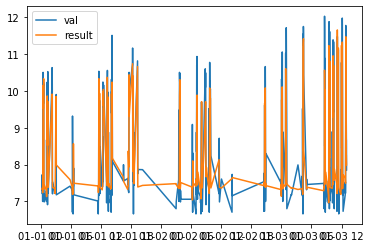

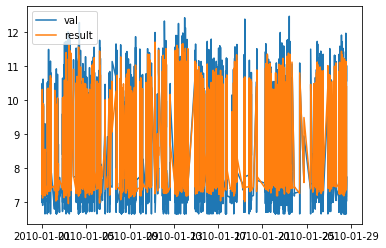

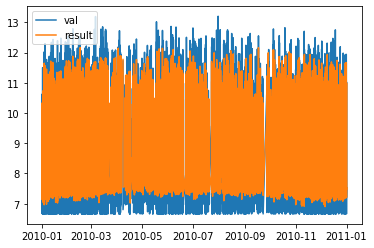

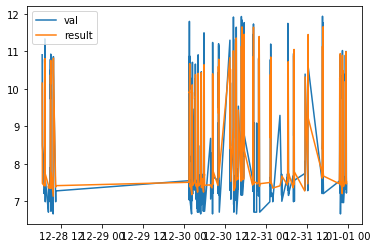

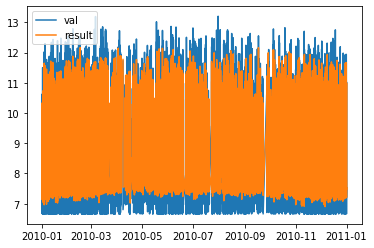

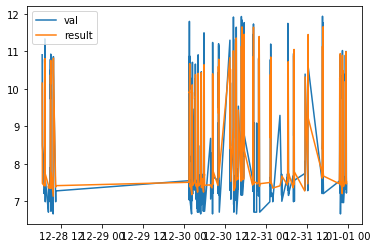

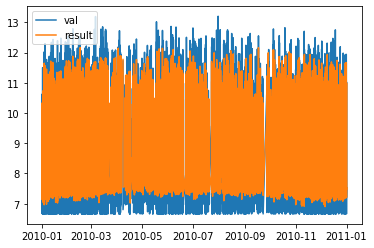

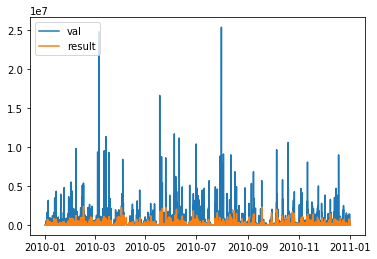

In [29]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(512, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(10))

model2 = Dense(1024, activation='relu')(input2)
model2 = Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:,:],(X.shape[0],10))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:,:],(X_test.shape[0],10))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()



Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_29 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_15 (Conv2D)              (None, 1, 10, 256)   3840        input_29[0][0]                   
__________________________________________________________________________________________________
input_30 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_29 (Dropout)            (None, 1, 10, 256)   0           conv2d_15[0][0]                  
___________________________________________________________________________________________

705/705 [==============================] - 5s 8ms/step - loss: 0.4625 - mse: 0.4625 - val_loss: 0.5960 - val_mse: 0.5960
Epoch 35/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4611 - mse: 0.4611 - val_loss: 0.5983 - val_mse: 0.5983
Epoch 36/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4596 - mse: 0.4596 - val_loss: 0.5984 - val_mse: 0.5984
Epoch 37/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4606 - mse: 0.4606 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 38/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4582 - mse: 0.4582 - val_loss: 0.5971 - val_mse: 0.5971
Epoch 39/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4569 - mse: 0.4569 - val_loss: 0.5916 - val_mse: 0.5916
Epoch 40/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4573 - mse: 0.4573 - val_loss: 0.5923 - val_mse: 0.5923
Epoch 41/300
705/705 [==============================] - 5s 8ms/step - loss:

705/705 [==============================] - 6s 8ms/step - loss: 0.4238 - mse: 0.4238 - val_loss: 0.5831 - val_mse: 0.5831
Epoch 96/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4218 - mse: 0.4218 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 97/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4220 - mse: 0.4220 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 98/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4209 - mse: 0.4209 - val_loss: 0.5878 - val_mse: 0.5878
Epoch 99/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4223 - mse: 0.4223 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 100/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4215 - mse: 0.4215 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 101/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4204 - mse: 0.4204 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 102/300
705/705 [==============================] - 6s 8ms/step - lo

705/705 [==============================] - 5s 8ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.5895 - val_mse: 0.5895
Epoch 156/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4060 - mse: 0.4060 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 157/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4043 - mse: 0.4043 - val_loss: 0.5911 - val_mse: 0.5911
Epoch 158/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4029 - mse: 0.4029 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 159/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4045 - mse: 0.4045 - val_loss: 0.5815 - val_mse: 0.5815
Epoch 160/300
705/705 [==============================] - 5s 8ms/step - loss: 0.4035 - mse: 0.4035 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 161/300
705/705 [==============================] - 6s 8ms/step - loss: 0.4031 - mse: 0.4031 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 162/300
705/705 [==============================] - 6s 8ms/step 

Epoch 216/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3946 - mse: 0.3946 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 217/300
705/705 [==============================] - 6s 8ms/step - loss: 0.3946 - mse: 0.3946 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 218/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3942 - mse: 0.3942 - val_loss: 0.6001 - val_mse: 0.6001
Epoch 219/300
705/705 [==============================] - 6s 8ms/step - loss: 0.3935 - mse: 0.3935 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 220/300
705/705 [==============================] - 6s 8ms/step - loss: 0.3937 - mse: 0.3937 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 221/300
705/705 [==============================] - 6s 8ms/step - loss: 0.3920 - mse: 0.3920 - val_loss: 0.5835 - val_mse: 0.5835
Epoch 222/300
705/705 [==============================] - 6s 8ms/step - loss: 0.3925 - mse: 0.3925 - val_loss: 0.6045 - val_mse: 0.6045
Epoch 223/300
705/705 [==============================] 

705/705 [==============================] - 6s 8ms/step - loss: 0.3859 - mse: 0.3859 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 277/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3862 - mse: 0.3862 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 278/300
705/705 [==============================] - 6s 8ms/step - loss: 0.3868 - mse: 0.3868 - val_loss: 0.5821 - val_mse: 0.5821
Epoch 279/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3861 - mse: 0.3861 - val_loss: 0.5916 - val_mse: 0.5916
Epoch 280/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3867 - mse: 0.3867 - val_loss: 0.5912 - val_mse: 0.5912
Epoch 281/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3859 - mse: 0.3859 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 282/300
705/705 [==============================] - 5s 8ms/step - loss: 0.3858 - mse: 0.3858 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 283/300
705/705 [==============================] - 5s 8ms/step 

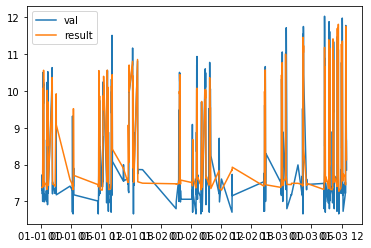

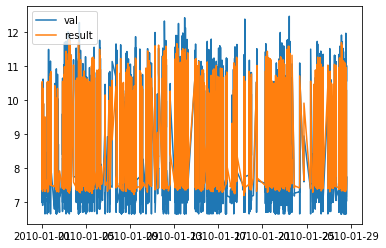

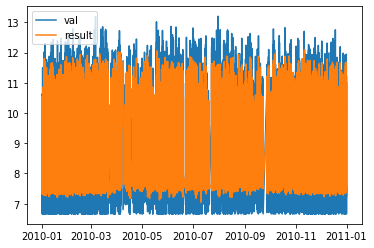

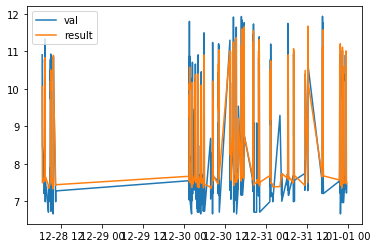

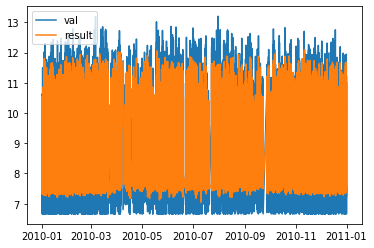

...

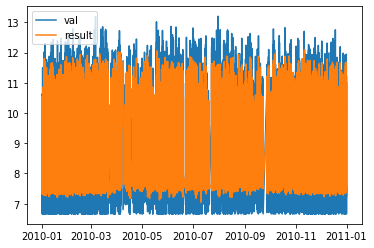

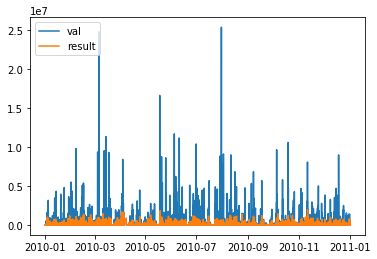

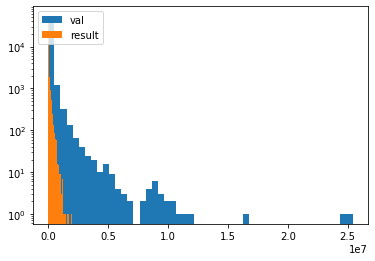

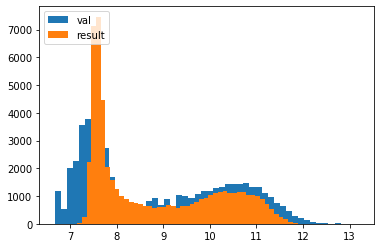

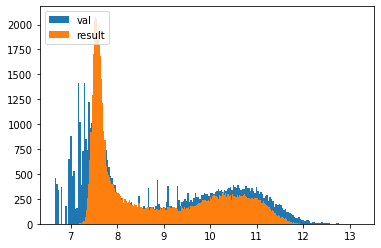

In [30]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log)
plt.plot(df_results)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(10**y_val_log*1.6e-6)
plt.plot(10**df_results*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values[:]*1.6e-6,bins=50,log=True)
plt.hist(10**df_results.values*1.6e-6,bins=50,log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=50)
plt.hist(df_results.values,bins=50)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values[:],bins=200)
plt.hist(df_results.values,bins=200)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_31 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_32 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_17 (Conv2D)              (None, 1, 1, 256)    36096       input_31[0][0]                   
__________________________________________________________________________________________________
dense_80 (Dense)                (None, 3072)         27648       input_32[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 3s 4ms/step - loss: 0.4643 - mse: 0.4643 - val_loss: 0.5945 - val_mse: 0.5945
Epoch 39/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4642 - mse: 0.4642 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 40/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4631 - mse: 0.4631 - val_loss: 0.6115 - val_mse: 0.6115
Epoch 41/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4624 - mse: 0.4624 - val_loss: 0.5911 - val_mse: 0.5911
Epoch 42/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4611 - mse: 0.4611 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 43/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4622 - mse: 0.4622 - val_loss: 0.5972 - val_mse: 0.5972
Epoch 44/300
705/705 [==============================] - 3s 4ms/step - loss: 0.5320 - mse: 0.5320 - val_loss: 0.5969 - val_mse: 0.5969
Epoch 45/300
705/705 [==============================] - 3s 4ms/step - loss:

705/705 [==============================] - 3s 5ms/step - loss: 0.4357 - mse: 0.4357 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 100/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4354 - mse: 0.4354 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 101/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4355 - mse: 0.4355 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 102/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4344 - mse: 0.4344 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 103/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4341 - mse: 0.4341 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 104/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4335 - mse: 0.4335 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 105/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4368 - mse: 0.4368 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 106/300
705/705 [==============================] - 3s 5ms/step 

Epoch 160/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4216 - mse: 0.4216 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 161/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4217 - mse: 0.4217 - val_loss: 0.5774 - val_mse: 0.5774
Epoch 162/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4216 - mse: 0.4216 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 163/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4219 - mse: 0.4219 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 164/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4210 - mse: 0.4210 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 165/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4216 - mse: 0.4216 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 166/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4207 - mse: 0.4207 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 167/300
705/705 [==============================] 

705/705 [==============================] - 3s 5ms/step - loss: 0.4142 - mse: 0.4142 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 221/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4142 - mse: 0.4142 - val_loss: 0.5787 - val_mse: 0.5787
Epoch 222/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4141 - mse: 0.4141 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 223/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4145 - mse: 0.4145 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 224/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4149 - mse: 0.4149 - val_loss: 0.5775 - val_mse: 0.5775
Epoch 225/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4136 - mse: 0.4136 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 226/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4138 - mse: 0.4138 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 227/300
705/705 [==============================] - 3s 4ms/step 

Epoch 281/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4568 - mse: 0.4568 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 282/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4128 - mse: 0.4128 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 283/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4105 - mse: 0.4105 - val_loss: 0.5838 - val_mse: 0.5838
Epoch 284/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4138 - mse: 0.4138 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 285/300
705/705 [==============================] - 3s 5ms/step - loss: 0.4105 - mse: 0.4105 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 286/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4093 - mse: 0.4093 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 287/300
705/705 [==============================] - 3s 4ms/step - loss: 0.4088 - mse: 0.4088 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 288/300
705/705 [==============================] 

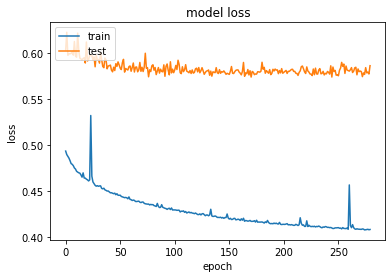

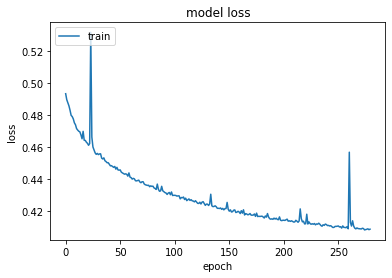

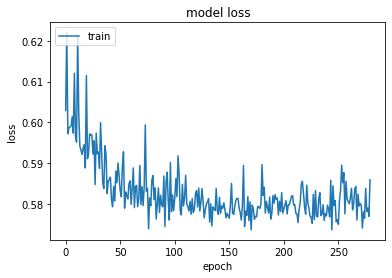

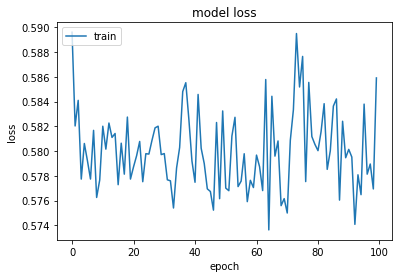

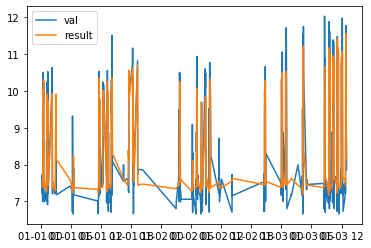

...

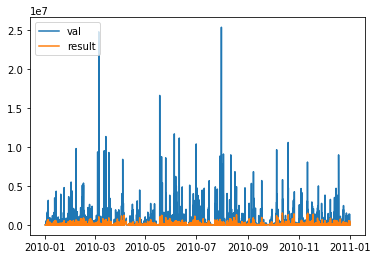

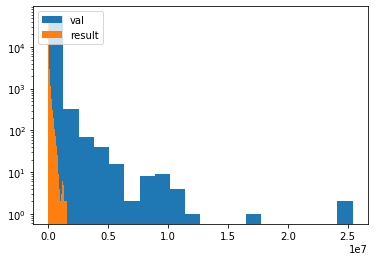

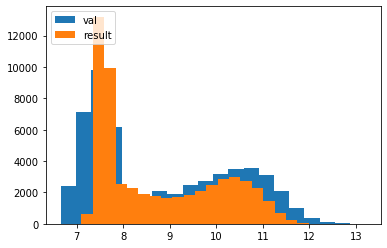

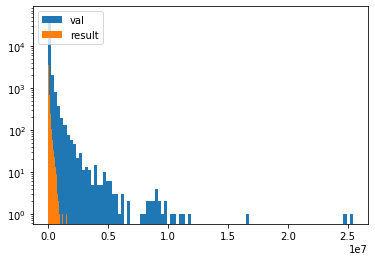

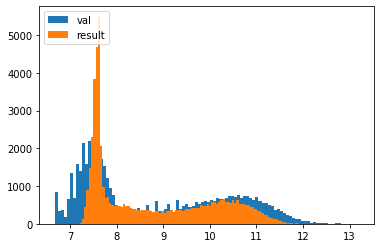

In [31]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768*4, activation='relu')(input2)
model2= Dropout(0.825)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)



print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_34 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dense_85 (Dense)                (None, 3072)         27648       input_34[0][0]                   
__________________________________________________________________________________________________
input_33 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
dropout_35 (Dropout)            (None, 3072)         0           dense_85[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 5s 7ms/step - loss: 0.4862 - mse: 0.4862 - val_loss: 0.6028 - val_mse: 0.6028
Epoch 36/600
705/705 [==============================] - 4s 6ms/step - loss: 0.4824 - mse: 0.4824 - val_loss: 0.6021 - val_mse: 0.6021
Epoch 37/600
705/705 [==============================] - 5s 6ms/step - loss: 0.4825 - mse: 0.4825 - val_loss: 0.6081 - val_mse: 0.6081
Epoch 38/600
705/705 [==============================] - 5s 6ms/step - loss: 0.4812 - mse: 0.4812 - val_loss: 0.6063 - val_mse: 0.6063
Epoch 39/600
705/705 [==============================] - 4s 6ms/step - loss: 0.4810 - mse: 0.4810 - val_loss: 0.6049 - val_mse: 0.6049
Epoch 40/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4815 - mse: 0.4815 - val_loss: 0.5918 - val_mse: 0.5918
Epoch 41/600
705/705 [==============================] - 4s 6ms/step - loss: 0.4797 - mse: 0.4797 - val_loss: 0.6007 - val_mse: 0.6007
Epoch 42/600
705/705 [==============================] - 4s 6ms/step - loss:

705/705 [==============================] - 5s 7ms/step - loss: 0.4484 - mse: 0.4484 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 97/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4475 - mse: 0.4475 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 98/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4472 - mse: 0.4472 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 99/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4471 - mse: 0.4471 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 100/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4468 - mse: 0.4468 - val_loss: 0.5862 - val_mse: 0.5862
Epoch 101/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4467 - mse: 0.4467 - val_loss: 0.5830 - val_mse: 0.5830
Epoch 102/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4464 - mse: 0.4464 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 103/600
705/705 [==============================] - 5s 7ms/step - l

Epoch 157/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4334 - mse: 0.4334 - val_loss: 0.5905 - val_mse: 0.5905
Epoch 158/600
705/705 [==============================] - 5s 6ms/step - loss: 0.4349 - mse: 0.4349 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 159/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4341 - mse: 0.4341 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 160/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4328 - mse: 0.4328 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 161/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4332 - mse: 0.4332 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 162/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4329 - mse: 0.4329 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 163/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4324 - mse: 0.4324 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 164/600
705/705 [==============================] 

705/705 [==============================] - 5s 6ms/step - loss: 0.4248 - mse: 0.4248 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 218/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4249 - mse: 0.4249 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 219/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4254 - mse: 0.4254 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 220/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4246 - mse: 0.4246 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 221/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4246 - mse: 0.4246 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 222/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4248 - mse: 0.4248 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 223/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4247 - mse: 0.4247 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 224/600
705/705 [==============================] - 5s 7ms/step 

Epoch 278/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4186 - mse: 0.4186 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 279/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4198 - mse: 0.4198 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 280/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4222 - mse: 0.4222 - val_loss: 0.5898 - val_mse: 0.5898
Epoch 281/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4197 - mse: 0.4197 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 282/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4198 - mse: 0.4198 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 283/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4188 - mse: 0.4188 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 284/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4176 - mse: 0.4176 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 285/600
705/705 [==============================] 

705/705 [==============================] - 5s 7ms/step - loss: 0.4147 - mse: 0.4147 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 339/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4152 - mse: 0.4152 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 340/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4151 - mse: 0.4151 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 341/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4151 - mse: 0.4151 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 342/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4143 - mse: 0.4143 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 343/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4142 - mse: 0.4142 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 344/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4141 - mse: 0.4141 - val_loss: 0.5870 - val_mse: 0.5870
Epoch 345/600
705/705 [==============================] - 5s 7ms/step 

Epoch 399/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5862 - val_mse: 0.5862
Epoch 400/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4104 - mse: 0.4104 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 401/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4107 - mse: 0.4107 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 402/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4118 - mse: 0.4118 - val_loss: 0.5829 - val_mse: 0.5829
Epoch 403/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4115 - mse: 0.4115 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 404/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4112 - mse: 0.4112 - val_loss: 0.5873 - val_mse: 0.5873
Epoch 405/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4105 - mse: 0.4105 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 406/600
705/705 [==============================] 

705/705 [==============================] - 5s 7ms/step - loss: 0.4075 - mse: 0.4075 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 460/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4083 - mse: 0.4083 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 461/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4075 - mse: 0.4075 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 462/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4085 - mse: 0.4085 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 463/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4077 - mse: 0.4077 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 464/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4080 - mse: 0.4080 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 465/600
705/705 [==============================] - 4s 6ms/step - loss: 0.4080 - mse: 0.4080 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 466/600
705/705 [==============================] - 4s 6ms/step 

Epoch 520/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4051 - mse: 0.4051 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 521/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4057 - mse: 0.4057 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 522/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 523/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4056 - mse: 0.4056 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 524/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4055 - mse: 0.4055 - val_loss: 0.5902 - val_mse: 0.5902
Epoch 525/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4048 - mse: 0.4048 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 526/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 527/600
705/705 [==============================] 

705/705 [==============================] - 5s 7ms/step - loss: 0.4034 - mse: 0.4034 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 581/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4028 - mse: 0.4028 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 582/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4031 - mse: 0.4031 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 583/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4021 - mse: 0.4021 - val_loss: 0.5988 - val_mse: 0.5988
Epoch 584/600
705/705 [==============================] - 5s 6ms/step - loss: 0.4028 - mse: 0.4028 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 585/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4031 - mse: 0.4031 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 586/600
705/705 [==============================] - 5s 7ms/step - loss: 0.4030 - mse: 0.4030 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 587/600
705/705 [==============================] - 5s 7ms/step 

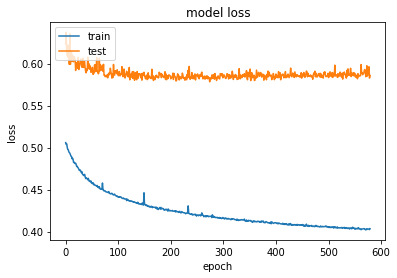

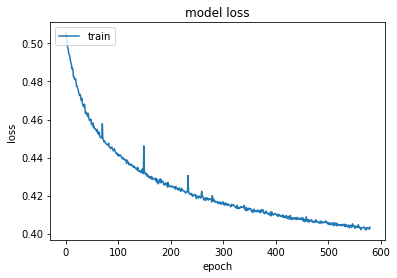

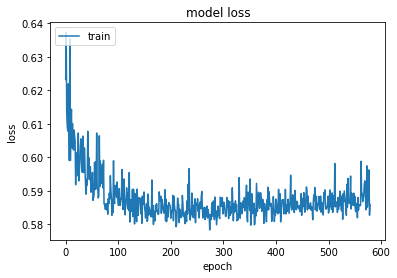

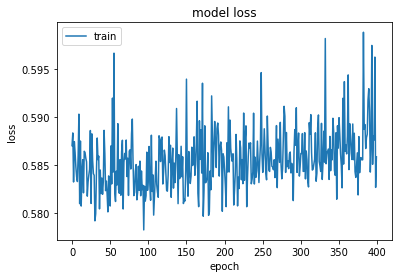

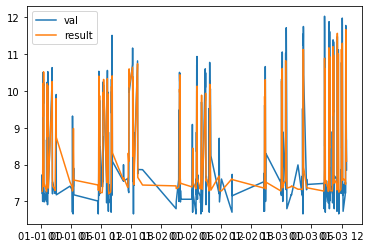

...

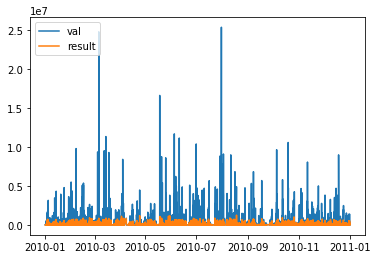

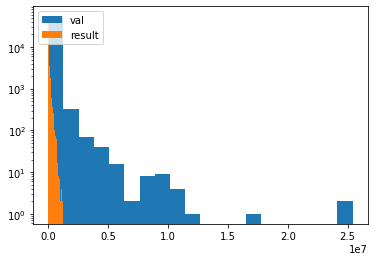

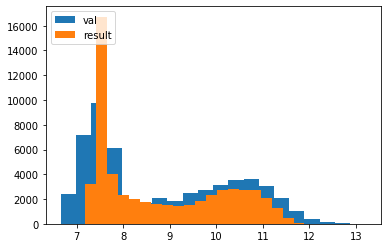

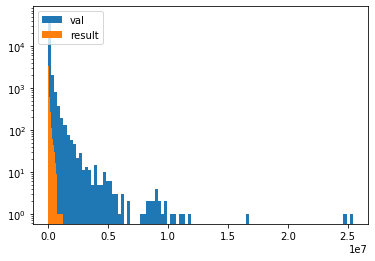

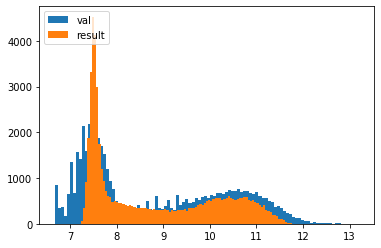

In [32]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768*4, activation='relu')(input2)
model2= Dropout(0.825)(model2)
model2 = Dense(512, activation='relu')(model2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)



print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_35 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, 14, 1, 256)   2816        input_35[0][0]                   
__________________________________________________________________________________________________
input_36 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_37 (Dropout)            (None, 14, 1, 256)   0           conv2d_19[0][0]                  
___________________________________________________________________________________________

Epoch 34/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 0.6175 - val_mse: 0.6175
Epoch 35/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4770 - mse: 0.4770 - val_loss: 0.6062 - val_mse: 0.6062
Epoch 36/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4752 - mse: 0.4752 - val_loss: 0.5991 - val_mse: 0.5991
Epoch 37/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4769 - mse: 0.4769 - val_loss: 0.5964 - val_mse: 0.5964
Epoch 38/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4747 - mse: 0.4747 - val_loss: 0.6017 - val_mse: 0.6017
Epoch 39/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4732 - mse: 0.4732 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 40/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4732 - mse: 0.4732 - val_loss: 0.6124 - val_mse: 0.6124
Epoch 41/600
705/705 [==============================] -

Epoch 95/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4500 - mse: 0.4500 - val_loss: 0.6007 - val_mse: 0.6007
Epoch 96/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4488 - mse: 0.4488 - val_loss: 0.5893 - val_mse: 0.5893
Epoch 97/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4495 - mse: 0.4495 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 98/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4497 - mse: 0.4497 - val_loss: 0.6003 - val_mse: 0.6003
Epoch 99/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4486 - mse: 0.4486 - val_loss: 0.5957 - val_mse: 0.5957
Epoch 100/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4481 - mse: 0.4481 - val_loss: 0.5988 - val_mse: 0.5988
Epoch 101/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4483 - mse: 0.4483 - val_loss: 0.5902 - val_mse: 0.5902
Epoch 102/600
705/705 [==============================] - 6s 

Epoch 156/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4383 - mse: 0.4383 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 157/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4368 - mse: 0.4368 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 158/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4363 - mse: 0.4363 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 159/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4361 - mse: 0.4361 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 160/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4369 - mse: 0.4369 - val_loss: 0.5917 - val_mse: 0.5917
Epoch 161/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4353 - mse: 0.4353 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 162/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4366 - mse: 0.4366 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 163/600
705/705 [==============================] 

705/705 [==============================] - 6s 9ms/step - loss: 0.4294 - mse: 0.4294 - val_loss: 0.5907 - val_mse: 0.5907
Epoch 217/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4291 - mse: 0.4291 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 218/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4284 - mse: 0.4284 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 219/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 220/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4289 - mse: 0.4289 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 221/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 222/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4287 - mse: 0.4287 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 223/600
705/705 [==============================] - 6s 9ms/step 

Epoch 277/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4234 - mse: 0.4234 - val_loss: 0.5811 - val_mse: 0.5811
Epoch 278/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4235 - mse: 0.4235 - val_loss: 0.5913 - val_mse: 0.5913
Epoch 279/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4218 - mse: 0.4218 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 280/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4222 - mse: 0.4222 - val_loss: 0.5832 - val_mse: 0.5832
Epoch 281/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4222 - mse: 0.4222 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 282/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4227 - mse: 0.4227 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 283/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4223 - mse: 0.4223 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 284/600
705/705 [==============================] 

705/705 [==============================] - 7s 9ms/step - loss: 0.4182 - mse: 0.4182 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 338/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4181 - mse: 0.4181 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 339/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4176 - mse: 0.4176 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 340/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4187 - mse: 0.4187 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 341/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4181 - mse: 0.4181 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 342/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 343/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4179 - mse: 0.4179 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 344/600
705/705 [==============================] - 6s 9ms/step 

Epoch 398/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4147 - mse: 0.4147 - val_loss: 0.5956 - val_mse: 0.5956
Epoch 399/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4145 - mse: 0.4145 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 400/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4140 - mse: 0.4140 - val_loss: 0.5792 - val_mse: 0.5792
Epoch 401/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4132 - mse: 0.4132 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 402/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4140 - mse: 0.4140 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 403/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4153 - mse: 0.4153 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 404/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4143 - mse: 0.4143 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 405/600
705/705 [==============================] 

705/705 [==============================] - 7s 9ms/step - loss: 0.4116 - mse: 0.4116 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 459/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4122 - mse: 0.4122 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 460/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4111 - mse: 0.4111 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 461/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4118 - mse: 0.4118 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 462/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4114 - mse: 0.4114 - val_loss: 0.5829 - val_mse: 0.5829
Epoch 463/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4127 - mse: 0.4127 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 464/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4109 - mse: 0.4109 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 465/600
705/705 [==============================] - 6s 9ms/step 

Epoch 519/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4103 - mse: 0.4103 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 520/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4078 - mse: 0.4078 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 521/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5792 - val_mse: 0.5792
Epoch 522/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4090 - mse: 0.4090 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 523/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 524/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4087 - mse: 0.4087 - val_loss: 0.5873 - val_mse: 0.5873
Epoch 525/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4088 - mse: 0.4088 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 526/600
705/705 [==============================]

705/705 [==============================] - 7s 9ms/step - loss: 0.4074 - mse: 0.4074 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 580/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4070 - mse: 0.4070 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 581/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.5912 - val_mse: 0.5912
Epoch 582/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4071 - mse: 0.4071 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 583/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 584/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4070 - mse: 0.4070 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 585/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4093 - mse: 0.4093 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 586/600
705/705 [==============================] - 7s 9ms/step 

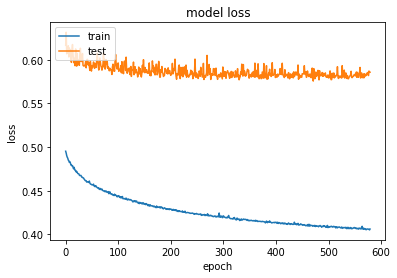

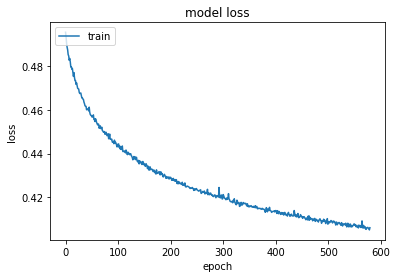

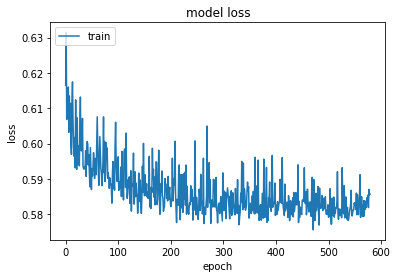

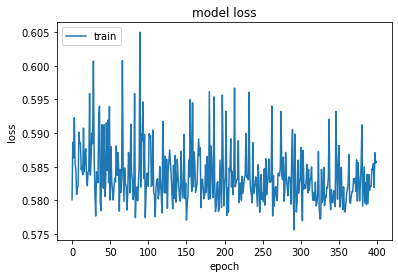

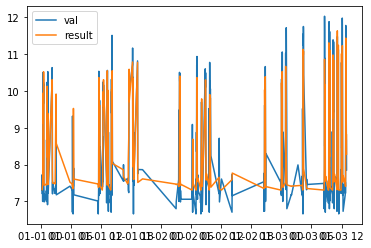

...

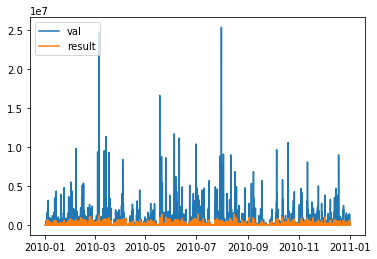

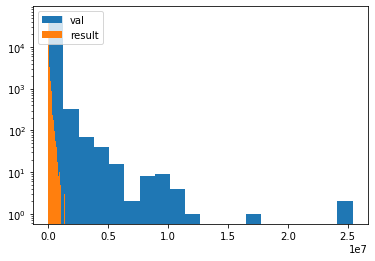

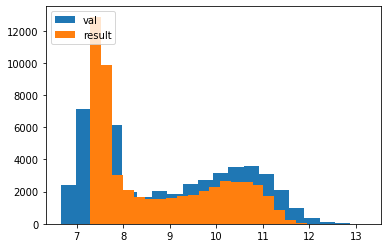

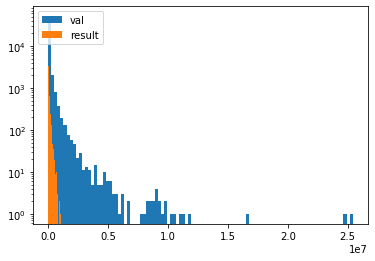

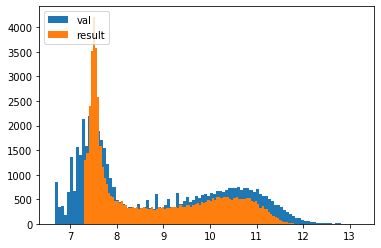

In [33]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_37 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_38 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_21 (Conv2D)              (None, 14, 1, 256)   2816        input_37[0][0]                   
__________________________________________________________________________________________________
dense_98 (Dense)                (None, 512)          4608        input_38[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 7s 10ms/step - loss: 0.4769 - mse: 0.4769 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 33/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4752 - mse: 0.4752 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 34/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4744 - mse: 0.4744 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 35/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4741 - mse: 0.4741 - val_loss: 0.5975 - val_mse: 0.5975
Epoch 36/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4730 - mse: 0.4730 - val_loss: 0.6090 - val_mse: 0.6090
Epoch 37/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4732 - mse: 0.4732 - val_loss: 0.6097 - val_mse: 0.6097
Epoch 38/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4701 - mse: 0.4701 - val_loss: 0.5952 - val_mse: 0.5952
Epoch 39/600
705/705 [==============================] - 7s 10ms/step -

705/705 [==============================] - 6s 9ms/step - loss: 0.4441 - mse: 0.4441 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 94/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4444 - mse: 0.4444 - val_loss: 0.5757 - val_mse: 0.5757
Epoch 95/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4441 - mse: 0.4441 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 96/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4444 - mse: 0.4444 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 97/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4425 - mse: 0.4425 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 98/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4420 - mse: 0.4420 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 99/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4432 - mse: 0.4432 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 100/600
705/705 [==============================] - 6s 9ms/step - loss

Epoch 154/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4308 - mse: 0.4308 - val_loss: 0.5745 - val_mse: 0.5745
Epoch 155/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4299 - mse: 0.4299 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 156/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5802 - val_mse: 0.5802
Epoch 157/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4285 - mse: 0.4285 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 158/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4302 - mse: 0.4302 - val_loss: 0.5761 - val_mse: 0.5761
Epoch 159/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4289 - mse: 0.4289 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 160/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4288 - mse: 0.4288 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 161/600
705/705 [==============================] 

705/705 [==============================] - 7s 10ms/step - loss: 0.4225 - mse: 0.4225 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 215/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4214 - mse: 0.4214 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 216/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4203 - mse: 0.4203 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 217/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4214 - mse: 0.4214 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 218/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4212 - mse: 0.4212 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 219/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4204 - mse: 0.4204 - val_loss: 0.5751 - val_mse: 0.5751
Epoch 220/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4202 - mse: 0.4202 - val_loss: 0.5787 - val_mse: 0.5787
Epoch 221/600
705/705 [==============================] - 7s 9ms/st

705/705 [==============================] - 7s 10ms/step - loss: 0.4149 - mse: 0.4149 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 275/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4142 - mse: 0.4142 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 276/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4135 - mse: 0.4135 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 277/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4135 - mse: 0.4135 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 278/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4131 - mse: 0.4131 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 279/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4131 - mse: 0.4131 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 280/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4135 - mse: 0.4135 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 281/600
705/705 [==============================] - 7s 10m

705/705 [==============================] - 7s 9ms/step - loss: 0.4081 - mse: 0.4081 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 335/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4096 - mse: 0.4096 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 336/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 337/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4086 - mse: 0.4086 - val_loss: 0.5890 - val_mse: 0.5890
Epoch 338/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4083 - mse: 0.4083 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 339/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4081 - mse: 0.4081 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 340/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5841 - val_mse: 0.5841
Epoch 341/600
705/705 [==============================] - 7s 10ms

705/705 [==============================] - 7s 9ms/step - loss: 0.4041 - mse: 0.4041 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 395/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 396/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4040 - mse: 0.4040 - val_loss: 0.5982 - val_mse: 0.5982
Epoch 397/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 398/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4052 - mse: 0.4052 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 399/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 400/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4044 - mse: 0.4044 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 401/600
705/705 [==============================] - 7s 9ms/s

705/705 [==============================] - 7s 10ms/step - loss: 0.4018 - mse: 0.4018 - val_loss: 0.5841 - val_mse: 0.5841
Epoch 455/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4022 - mse: 0.4022 - val_loss: 0.6009 - val_mse: 0.6009
Epoch 456/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4011 - mse: 0.4011 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 457/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4012 - mse: 0.4012 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 458/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4012 - mse: 0.4012 - val_loss: 0.5805 - val_mse: 0.5805
Epoch 459/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4010 - mse: 0.4010 - val_loss: 0.5953 - val_mse: 0.5953
Epoch 460/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4016 - mse: 0.4016 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 461/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.3995 - mse: 0.3995 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 515/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 516/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3989 - mse: 0.3989 - val_loss: 0.5834 - val_mse: 0.5834
Epoch 517/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3982 - mse: 0.3982 - val_loss: 0.5913 - val_mse: 0.5913
Epoch 518/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3984 - mse: 0.3984 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 519/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3985 - mse: 0.3985 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 520/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3986 - mse: 0.3986 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 521/600
705/705 [==============================] - 7s 10ms

Epoch 575/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3969 - mse: 0.3969 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 576/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3968 - mse: 0.3968 - val_loss: 0.5911 - val_mse: 0.5911
Epoch 577/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3965 - mse: 0.3965 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 578/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3960 - mse: 0.3960 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 579/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3972 - mse: 0.3972 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 580/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3968 - mse: 0.3968 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 581/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3976 - mse: 0.3976 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 582/600
705/705 [==============================] 

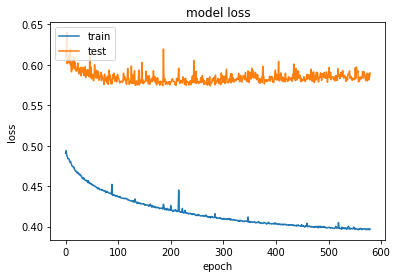

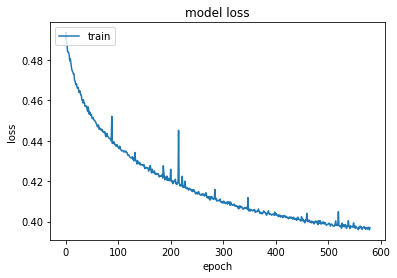

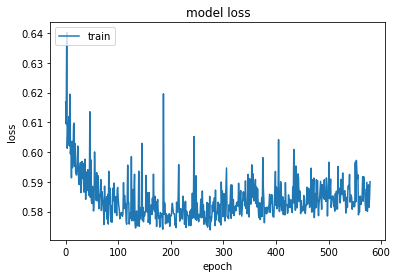

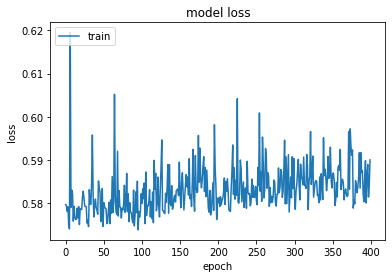

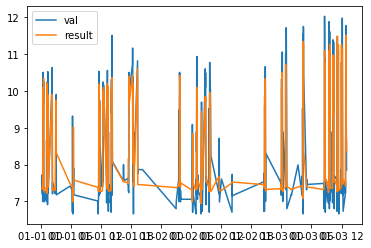

...

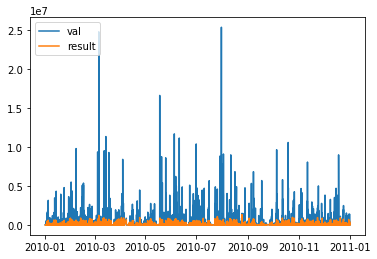

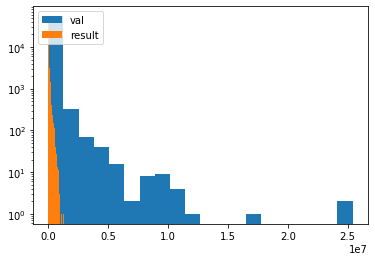

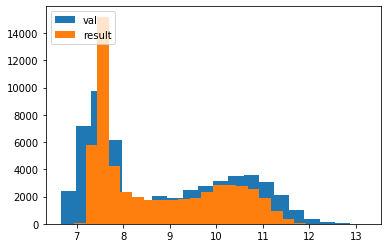

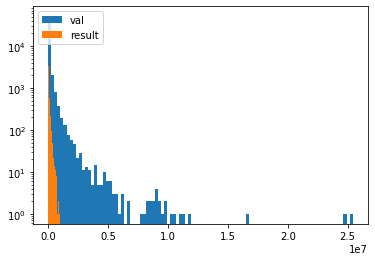

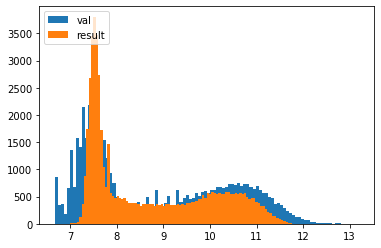

In [34]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)
model2 = Dense(64,activation='relu')(model2)


input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)
model2 = Dense(64,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_39 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_23 (Conv2D)              (None, 14, 1, 256)   2816        input_39[0][0]                   
__________________________________________________________________________________________________
input_40 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_43 (Dropout)            (None, 14, 1, 256)   0           conv2d_23[0][0]                  
___________________________________________________________________________________________

Epoch 34/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4640 - mse: 0.4640 - val_loss: 0.5901 - val_mse: 0.5901
Epoch 35/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4610 - mse: 0.4610 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 36/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4651 - mse: 0.4651 - val_loss: 0.5945 - val_mse: 0.5945
Epoch 37/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4670 - mse: 0.4670 - val_loss: 0.5976 - val_mse: 0.5976
Epoch 38/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4582 - mse: 0.4582 - val_loss: 0.5984 - val_mse: 0.5984
Epoch 39/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4579 - mse: 0.4579 - val_loss: 0.5865 - val_mse: 0.5865
Epoch 40/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4580 - mse: 0.4580 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 41/600
705/705 [==============================] -

705/705 [==============================] - 9s 13ms/step - loss: 0.4313 - mse: 0.4313 - val_loss: 0.5972 - val_mse: 0.5972
Epoch 95/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4312 - mse: 0.4312 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 96/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 97/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4301 - mse: 0.4301 - val_loss: 0.5739 - val_mse: 0.5739
Epoch 98/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4289 - mse: 0.4289 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 99/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4294 - mse: 0.4294 - val_loss: 0.5901 - val_mse: 0.5901
Epoch 100/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4289 - mse: 0.4289 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 101/600
705/705 [==============================] - 9s 13ms/st

705/705 [==============================] - 9s 13ms/step - loss: 0.4176 - mse: 0.4176 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 155/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4176 - mse: 0.4176 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 156/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5804 - val_mse: 0.5804
Epoch 157/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4149 - mse: 0.4149 - val_loss: 0.5806 - val_mse: 0.5806
Epoch 158/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4150 - mse: 0.4150 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 159/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4162 - mse: 0.4162 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 160/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4156 - mse: 0.4156 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 161/600
705/705 [==============================] - 9s 13

705/705 [==============================] - 9s 13ms/step - loss: 0.4057 - mse: 0.4057 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 215/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4064 - mse: 0.4064 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 216/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4058 - mse: 0.4058 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 217/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4067 - mse: 0.4067 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 218/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4067 - mse: 0.4067 - val_loss: 0.5770 - val_mse: 0.5770
Epoch 219/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 220/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 221/600
705/705 [==============================] - 9s 13

705/705 [==============================] - 10s 14ms/step - loss: 0.3996 - mse: 0.3996 - val_loss: 0.5781 - val_mse: 0.5781
Epoch 275/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3993 - mse: 0.3993 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 276/600
705/705 [==============================] - 10s 14ms/step - loss: 0.4060 - mse: 0.4060 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 277/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3984 - mse: 0.3984 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 278/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3982 - mse: 0.3982 - val_loss: 0.5817 - val_mse: 0.5817
Epoch 279/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3987 - mse: 0.3987 - val_loss: 0.5740 - val_mse: 0.5740
Epoch 280/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3981 - mse: 0.3981 - val_loss: 0.5755 - val_mse: 0.5755
Epoch 281/600
705/705 [==============================] 

Epoch 334/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3931 - mse: 0.3931 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 335/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3975 - mse: 0.3975 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 336/600
705/705 [==============================] - 10s 15ms/step - loss: 0.3941 - mse: 0.3941 - val_loss: 0.5880 - val_mse: 0.5880
Epoch 337/600
705/705 [==============================] - 10s 15ms/step - loss: 0.3931 - mse: 0.3931 - val_loss: 0.5786 - val_mse: 0.5786
Epoch 338/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 339/600
705/705 [==============================] - 10s 13ms/step - loss: 0.3926 - mse: 0.3926 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 340/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3933 - mse: 0.3933 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 341/600
705/705 [===================

705/705 [==============================] - 10s 14ms/step - loss: 0.3883 - mse: 0.3883 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 395/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3897 - mse: 0.3897 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 396/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3885 - mse: 0.3885 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 397/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3883 - mse: 0.3883 - val_loss: 0.5751 - val_mse: 0.5751
Epoch 398/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3887 - mse: 0.3887 - val_loss: 0.5811 - val_mse: 0.5811
Epoch 399/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3874 - mse: 0.3874 - val_loss: 0.5761 - val_mse: 0.5761
Epoch 400/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3891 - mse: 0.3891 - val_loss: 0.5730 - val_mse: 0.5730
Epoch 401/600
705/705 [==============================] - 10s

705/705 [==============================] - 9s 13ms/step - loss: 0.3852 - mse: 0.3852 - val_loss: 0.5748 - val_mse: 0.5748
Epoch 455/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3846 - mse: 0.3846 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 456/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3836 - mse: 0.3836 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 457/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3843 - mse: 0.3843 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 458/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3839 - mse: 0.3839 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 459/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3833 - mse: 0.3833 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 460/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3832 - mse: 0.3832 - val_loss: 0.5859 - val_mse: 0.5859
Epoch 461/600
705/705 [==============================] - 9s 1

705/705 [==============================] - 10s 14ms/step - loss: 0.3816 - mse: 0.3816 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 515/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3814 - mse: 0.3814 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 516/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3812 - mse: 0.3812 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 517/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3805 - mse: 0.3805 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 518/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3808 - mse: 0.3808 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 519/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3814 - mse: 0.3814 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 520/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3817 - mse: 0.3817 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 521/600
705/705 [==============================] - 10s

705/705 [==============================] - 9s 13ms/step - loss: 0.3788 - mse: 0.3788 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 575/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3779 - mse: 0.3779 - val_loss: 0.5761 - val_mse: 0.5761
Epoch 576/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3777 - mse: 0.3777 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 577/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3785 - mse: 0.3785 - val_loss: 0.5736 - val_mse: 0.5736
Epoch 578/600
705/705 [==============================] - 10s 14ms/step - loss: 0.3779 - mse: 0.3779 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 579/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3786 - mse: 0.3786 - val_loss: 0.5775 - val_mse: 0.5775
Epoch 580/600
705/705 [==============================] - 9s 13ms/step - loss: 0.3777 - mse: 0.3777 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 581/600
705/705 [==============================] - 10s 

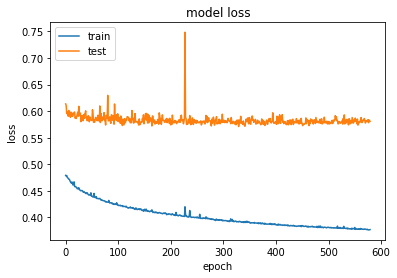

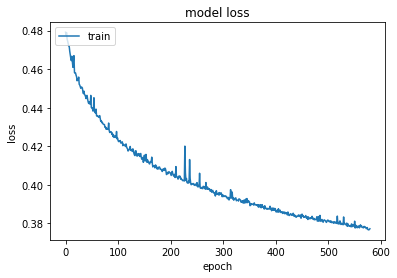

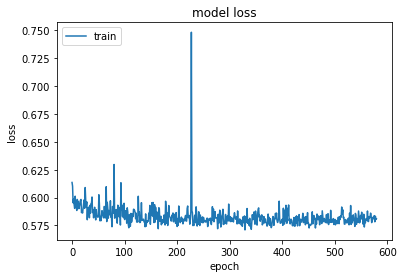

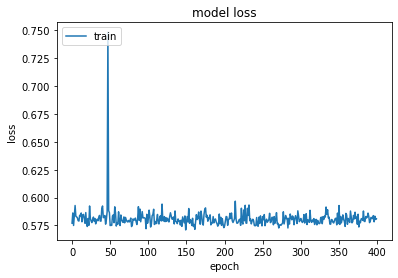

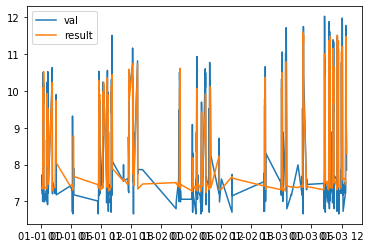

...

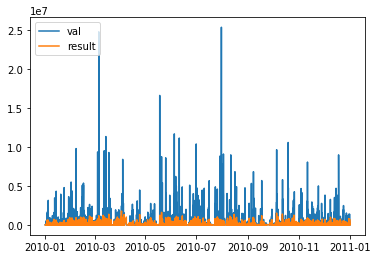

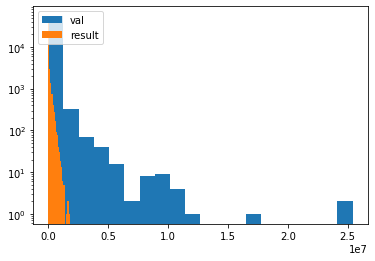

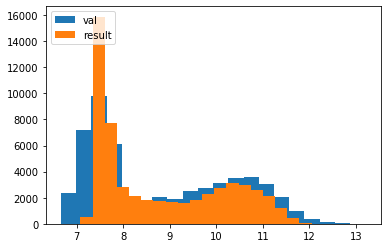

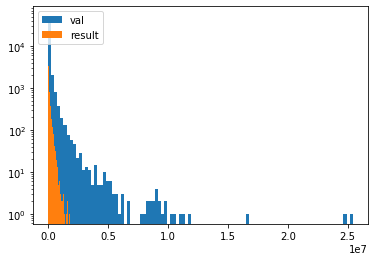

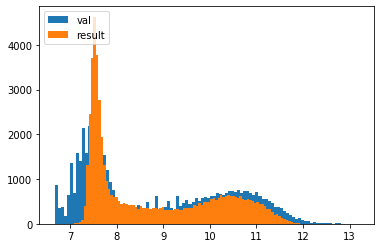

In [35]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(512, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_24"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_49 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_50 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_29 (Conv2D)              (None, 1, 1, 256)    36096       input_49[0][0]                   
__________________________________________________________________________________________________
dense_133 (Dense)               (None, 768)          6912        input_50[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 2s 2ms/step - loss: 0.4661 - mse: 0.4661 - val_loss: 0.6002 - val_mse: 0.6002
Epoch 39/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4669 - mse: 0.4669 - val_loss: 0.6033 - val_mse: 0.6033
Epoch 40/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4648 - mse: 0.4648 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 41/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4649 - mse: 0.4649 - val_loss: 0.5931 - val_mse: 0.5931
Epoch 42/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4637 - mse: 0.4637 - val_loss: 0.6026 - val_mse: 0.6026
Epoch 43/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4634 - mse: 0.4634 - val_loss: 0.5873 - val_mse: 0.5873
Epoch 44/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4612 - mse: 0.4612 - val_loss: 0.5981 - val_mse: 0.5981
Epoch 45/500
705/705 [==============================] - 2s 3ms/step - loss:

705/705 [==============================] - 2s 3ms/step - loss: 0.4321 - mse: 0.4321 - val_loss: 0.5878 - val_mse: 0.5878
Epoch 100/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4313 - mse: 0.4313 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 101/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4310 - mse: 0.4310 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 102/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4308 - mse: 0.4308 - val_loss: 0.5804 - val_mse: 0.5804
Epoch 103/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4309 - mse: 0.4309 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 104/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4300 - mse: 0.4300 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 105/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4287 - mse: 0.4287 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 106/500
705/705 [==============================] - 2s 3ms/step 

Epoch 160/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4150 - mse: 0.4150 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 161/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4156 - mse: 0.4156 - val_loss: 0.5774 - val_mse: 0.5774
Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5755 - val_mse: 0.5755
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4147 - mse: 0.4147 - val_loss: 0.5773 - val_mse: 0.5773
Epoch 165/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4152 - mse: 0.4152 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 166/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4153 - mse: 0.4153 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 167/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.4058 - mse: 0.4058 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 221/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4074 - mse: 0.4074 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 222/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 223/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4060 - mse: 0.4060 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 224/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4057 - mse: 0.4057 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 225/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4060 - mse: 0.4060 - val_loss: 0.5835 - val_mse: 0.5835
Epoch 226/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4049 - mse: 0.4049 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 227/500
705/705 [==============================] - 2s 3ms/step 

Epoch 281/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3997 - mse: 0.3997 - val_loss: 0.5780 - val_mse: 0.5780
Epoch 282/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3999 - mse: 0.3999 - val_loss: 0.5757 - val_mse: 0.5757
Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3996 - mse: 0.3996 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4210 - mse: 0.4210 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 286/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4055 - mse: 0.4055 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 287/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4016 - mse: 0.4016 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 288/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.5781 - val_mse: 0.5781
Epoch 342/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3942 - mse: 0.3942 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 343/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3945 - mse: 0.3945 - val_loss: 0.5781 - val_mse: 0.5781
Epoch 344/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3944 - mse: 0.3944 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 345/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3955 - mse: 0.3955 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 346/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3954 - mse: 0.3954 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 347/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3939 - mse: 0.3939 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 348/500
705/705 [==============================] - 2s 3ms/step 

Epoch 402/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4242 - mse: 0.4242 - val_loss: 0.5772 - val_mse: 0.5772
Epoch 403/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3916 - mse: 0.3916 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3915 - mse: 0.3915 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3916 - mse: 0.3916 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 406/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3903 - mse: 0.3903 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 407/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3906 - mse: 0.3906 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 408/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3909 - mse: 0.3909 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 409/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.3884 - mse: 0.3884 - val_loss: 0.5895 - val_mse: 0.5895
Epoch 463/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3880 - mse: 0.3880 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 464/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3882 - mse: 0.3882 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 465/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4089 - mse: 0.4089 - val_loss: 0.5775 - val_mse: 0.5775
Epoch 466/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3890 - mse: 0.3890 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 467/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3890 - mse: 0.3890 - val_loss: 0.5770 - val_mse: 0.5770
Epoch 468/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3885 - mse: 0.3885 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 469/500
705/705 [==============================] - 2s 3ms/step 

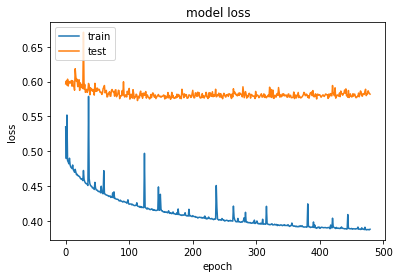

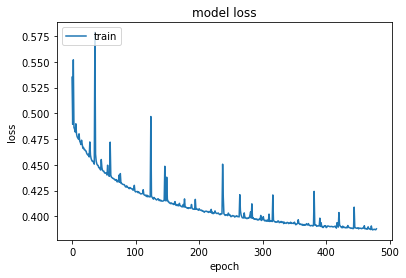

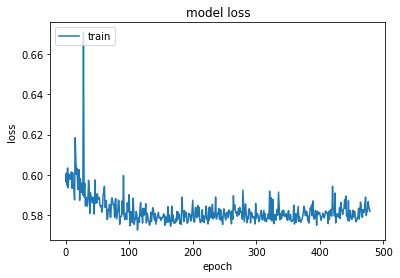

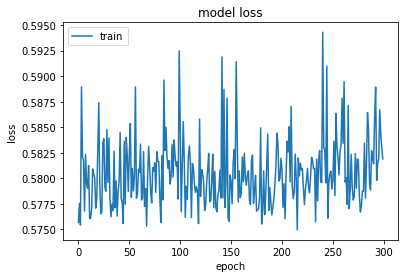

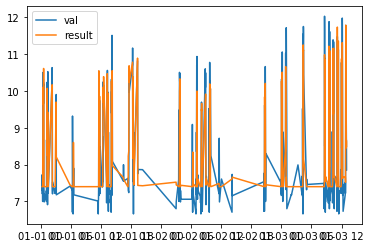

...

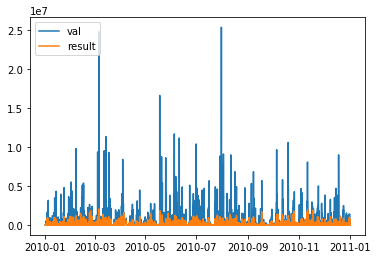

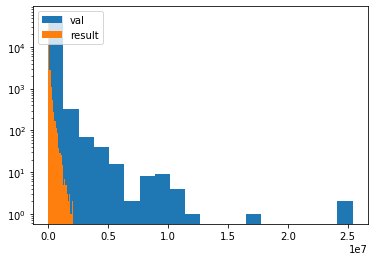

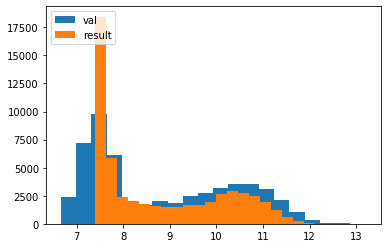

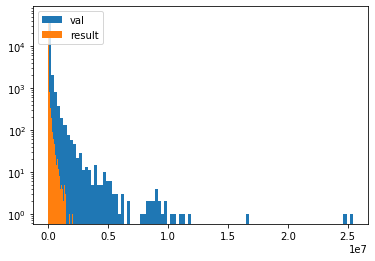

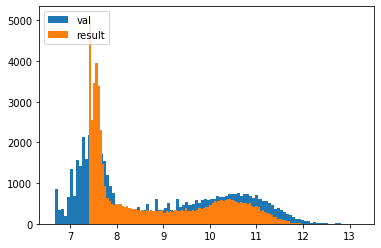

In [40]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_21"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_43 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_44 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_26 (Conv2D)              (None, 1, 1, 512)    72192       input_43[0][0]                   
__________________________________________________________________________________________________
dense_117 (Dense)               (None, 256)          2304        input_44[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 2s 3ms/step - loss: 0.4774 - mse: 0.4774 - val_loss: 0.6207 - val_mse: 0.6207
Epoch 36/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4766 - mse: 0.4766 - val_loss: 0.6232 - val_mse: 0.6232
Epoch 37/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4760 - mse: 0.4760 - val_loss: 0.6206 - val_mse: 0.6206
Epoch 38/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4749 - mse: 0.4749 - val_loss: 0.6240 - val_mse: 0.6240
Epoch 39/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4727 - mse: 0.4727 - val_loss: 0.6405 - val_mse: 0.6405
Epoch 40/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4727 - mse: 0.4727 - val_loss: 0.6365 - val_mse: 0.6365
Epoch 41/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4726 - mse: 0.4726 - val_loss: 0.6222 - val_mse: 0.6222
Epoch 42/500
705/705 [==============================] - 2s 2ms/step - loss:

705/705 [==============================] - 2s 2ms/step - loss: 0.4438 - mse: 0.4438 - val_loss: 0.6101 - val_mse: 0.6101
Epoch 97/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4445 - mse: 0.4445 - val_loss: 0.5969 - val_mse: 0.5969
Epoch 98/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4430 - mse: 0.4430 - val_loss: 0.6036 - val_mse: 0.6036
Epoch 99/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4438 - mse: 0.4438 - val_loss: 0.6194 - val_mse: 0.6194
Epoch 100/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4431 - mse: 0.4431 - val_loss: 0.6196 - val_mse: 0.6196
Epoch 101/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.6016 - val_mse: 0.6016
Epoch 102/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4428 - mse: 0.4428 - val_loss: 0.6069 - val_mse: 0.6069
Epoch 103/500
705/705 [==============================] - 2s 2ms/step - l

Epoch 157/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5970 - val_mse: 0.5970
Epoch 158/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4288 - mse: 0.4288 - val_loss: 0.5973 - val_mse: 0.5973
Epoch 159/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.6026 - val_mse: 0.6026
Epoch 160/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4274 - mse: 0.4274 - val_loss: 0.6175 - val_mse: 0.6175
Epoch 161/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4278 - mse: 0.4278 - val_loss: 0.6024 - val_mse: 0.6024
Epoch 162/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4290 - mse: 0.4290 - val_loss: 0.5971 - val_mse: 0.5971
Epoch 163/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4288 - mse: 0.4288 - val_loss: 0.6038 - val_mse: 0.6038
Epoch 164/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4187 - mse: 0.4187 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 218/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5960 - val_mse: 0.5960
Epoch 219/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4192 - mse: 0.4192 - val_loss: 0.6002 - val_mse: 0.6002
Epoch 220/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4192 - mse: 0.4192 - val_loss: 0.6003 - val_mse: 0.6003
Epoch 221/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4182 - mse: 0.4182 - val_loss: 0.6042 - val_mse: 0.6042
Epoch 222/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4182 - mse: 0.4182 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 223/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4193 - mse: 0.4193 - val_loss: 0.5934 - val_mse: 0.5934
Epoch 224/500
705/705 [==============================] - 2s 2ms/step 

Epoch 278/500
705/705 [==============================] - 2s 3ms/step - loss: 0.4119 - mse: 0.4119 - val_loss: 0.5961 - val_mse: 0.5961
Epoch 279/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4133 - mse: 0.4133 - val_loss: 0.5958 - val_mse: 0.5958
Epoch 280/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4126 - mse: 0.4126 - val_loss: 0.5946 - val_mse: 0.5946
Epoch 281/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4122 - mse: 0.4122 - val_loss: 0.5943 - val_mse: 0.5943
Epoch 282/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4115 - mse: 0.4115 - val_loss: 0.5968 - val_mse: 0.5968
Epoch 283/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4117 - mse: 0.4117 - val_loss: 0.6047 - val_mse: 0.6047
Epoch 284/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4118 - mse: 0.4118 - val_loss: 0.6156 - val_mse: 0.6156
Epoch 285/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4062 - mse: 0.4062 - val_loss: 0.5987 - val_mse: 0.5987
Epoch 339/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4067 - mse: 0.4067 - val_loss: 0.5962 - val_mse: 0.5962
Epoch 340/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4067 - mse: 0.4067 - val_loss: 0.6006 - val_mse: 0.6006
Epoch 341/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4071 - mse: 0.4071 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 342/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4069 - mse: 0.4069 - val_loss: 0.6007 - val_mse: 0.6007
Epoch 343/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.6250 - val_mse: 0.6250
Epoch 344/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4060 - mse: 0.4060 - val_loss: 0.6158 - val_mse: 0.6158
Epoch 345/500
705/705 [==============================] - 2s 2ms/step 

Epoch 399/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4027 - mse: 0.4027 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 400/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4030 - mse: 0.4030 - val_loss: 0.5978 - val_mse: 0.5978
Epoch 401/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4028 - mse: 0.4028 - val_loss: 0.5972 - val_mse: 0.5972
Epoch 402/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4035 - mse: 0.4035 - val_loss: 0.6123 - val_mse: 0.6123
Epoch 403/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4037 - mse: 0.4037 - val_loss: 0.6025 - val_mse: 0.6025
Epoch 404/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4032 - mse: 0.4032 - val_loss: 0.6032 - val_mse: 0.6032
Epoch 405/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4031 - mse: 0.4031 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 406/500
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.3996 - mse: 0.3996 - val_loss: 0.6009 - val_mse: 0.6009
Epoch 460/500
705/705 [==============================] - 2s 3ms/step - loss: 0.3993 - mse: 0.3993 - val_loss: 0.6010 - val_mse: 0.6010
Epoch 461/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3988 - mse: 0.3988 - val_loss: 0.5972 - val_mse: 0.5972
Epoch 462/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5985 - val_mse: 0.5985
Epoch 463/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3998 - mse: 0.3998 - val_loss: 0.5967 - val_mse: 0.5967
Epoch 464/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5929 - val_mse: 0.5929
Epoch 465/500
705/705 [==============================] - 2s 2ms/step - loss: 0.3992 - mse: 0.3992 - val_loss: 0.6060 - val_mse: 0.6060
Epoch 466/500
705/705 [==============================] - 2s 2ms/step 

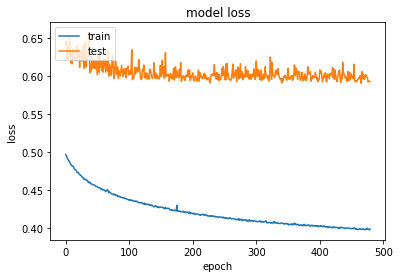

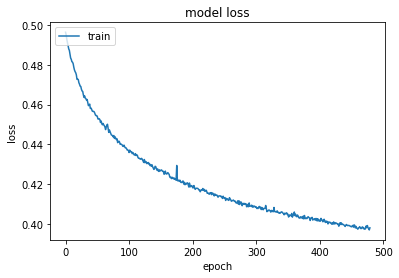

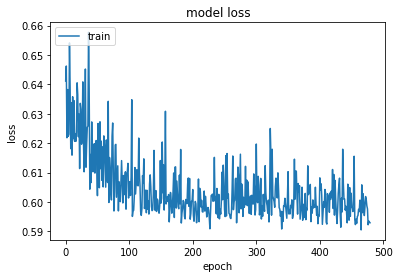

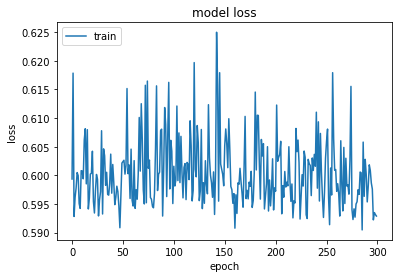

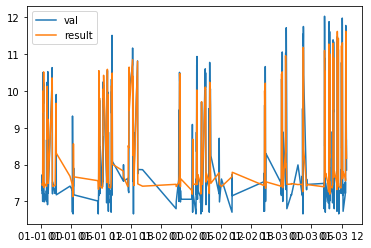

...

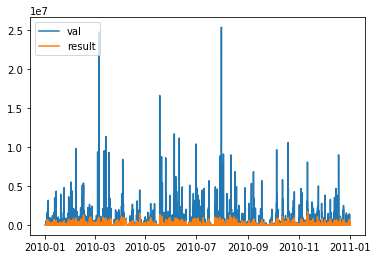

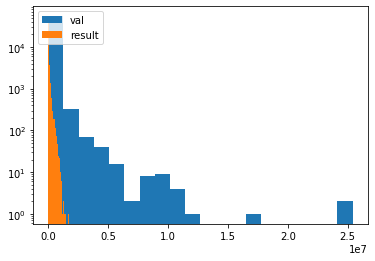

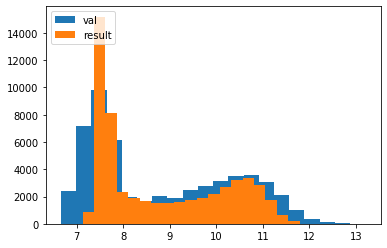

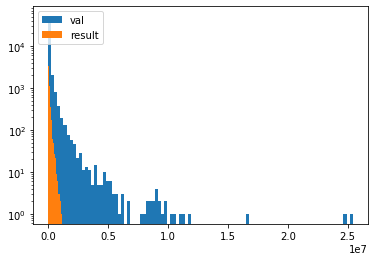

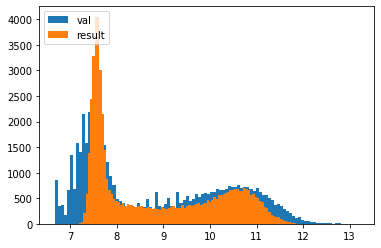

In [37]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(512, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)
model1 = Dense(64, activation='relu')(model1)

input2 = Input(shape=(8))

model2 = Dense(256, activation='relu')(input2)
model2= Dropout(0.5)(model2)
model2 = Dense(64, activation='relu')(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(32, activation='relu')(merged)
merged = Dense(8, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_25"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_51 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_52 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_30 (Conv2D)              (None, 1, 1, 256)    36096       input_51[0][0]                   
__________________________________________________________________________________________________
dense_138 (Dense)               (None, 768)          6912        input_52[0][0]                   
___________________________________________________________________________________________

89/89 [==============================] - 1s 9ms/step - loss: 0.5102 - mse: 0.5102 - val_loss: 0.6279 - val_mse: 0.6279
Epoch 40/500
89/89 [==============================] - 1s 9ms/step - loss: 0.5075 - mse: 0.5075 - val_loss: 0.6383 - val_mse: 0.6383
Epoch 41/500
89/89 [==============================] - 1s 9ms/step - loss: 0.5046 - mse: 0.5046 - val_loss: 0.6268 - val_mse: 0.6268
Epoch 42/500
89/89 [==============================] - 1s 9ms/step - loss: 0.5043 - mse: 0.5043 - val_loss: 0.6281 - val_mse: 0.6281
Epoch 43/500
89/89 [==============================] - 1s 9ms/step - loss: 0.5039 - mse: 0.5039 - val_loss: 0.6404 - val_mse: 0.6404
Epoch 44/500
89/89 [==============================] - 1s 9ms/step - loss: 0.5021 - mse: 0.5021 - val_loss: 0.6307 - val_mse: 0.6307
Epoch 45/500
89/89 [==============================] - 1s 9ms/step - loss: 0.5026 - mse: 0.5026 - val_loss: 0.6336 - val_mse: 0.6336
Epoch 46/500
89/89 [==============================] - 1s 9ms/step - loss: 0.4998 - mse: 0

89/89 [==============================] - 1s 11ms/step - loss: 0.4636 - mse: 0.4636 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 102/500
89/89 [==============================] - 1s 11ms/step - loss: 0.4625 - mse: 0.4625 - val_loss: 0.6174 - val_mse: 0.6174
Epoch 103/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4632 - mse: 0.4632 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 104/500
89/89 [==============================] - 1s 11ms/step - loss: 0.4624 - mse: 0.4624 - val_loss: 0.5949 - val_mse: 0.5949
Epoch 105/500
89/89 [==============================] - 1s 11ms/step - loss: 0.4606 - mse: 0.4606 - val_loss: 0.6201 - val_mse: 0.6201
Epoch 106/500
89/89 [==============================] - 1s 11ms/step - loss: 0.4635 - mse: 0.4635 - val_loss: 0.5973 - val_mse: 0.5973
Epoch 107/500
89/89 [==============================] - 1s 11ms/step - loss: 0.4608 - mse: 0.4608 - val_loss: 0.6096 - val_mse: 0.6096
Epoch 108/500
89/89 [==============================] - 1s 11ms/step - loss: 

89/89 [==============================] - 1s 11ms/step - loss: 0.4418 - mse: 0.4418 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 163/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4425 - mse: 0.4425 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 164/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4416 - mse: 0.4416 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 165/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4419 - mse: 0.4419 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 166/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4404 - mse: 0.4404 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 167/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4421 - mse: 0.4421 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 168/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4408 - mse: 0.4408 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 169/500
89/89 [==============================] - 1s 11ms/step - loss: 

89/89 [==============================] - 1s 10ms/step - loss: 0.4305 - mse: 0.4305 - val_loss: 0.5870 - val_mse: 0.5870
Epoch 224/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4296 - mse: 0.4296 - val_loss: 0.5832 - val_mse: 0.5832
Epoch 225/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4302 - mse: 0.4302 - val_loss: 0.5806 - val_mse: 0.5806
Epoch 226/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4302 - mse: 0.4302 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 227/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4294 - mse: 0.4294 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 228/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4312 - mse: 0.4312 - val_loss: 0.5865 - val_mse: 0.5865
Epoch 229/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 230/500
89/89 [==============================] - 1s 10ms/step - loss: 

89/89 [==============================] - 1s 10ms/step - loss: 0.4237 - mse: 0.4237 - val_loss: 0.5750 - val_mse: 0.5750
Epoch 285/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4216 - mse: 0.4216 - val_loss: 0.5859 - val_mse: 0.5859
Epoch 286/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4222 - mse: 0.4222 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 287/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4225 - mse: 0.4225 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 288/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4227 - mse: 0.4227 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 289/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4224 - mse: 0.4224 - val_loss: 0.5770 - val_mse: 0.5770
Epoch 290/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4233 - mse: 0.4233 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 291/500
89/89 [==============================] - 1s 10ms/step - loss: 

89/89 [==============================] - 1s 10ms/step - loss: 0.4178 - mse: 0.4178 - val_loss: 0.5830 - val_mse: 0.5830
Epoch 346/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4175 - mse: 0.4175 - val_loss: 0.5830 - val_mse: 0.5830
Epoch 347/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4174 - mse: 0.4174 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 348/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4178 - mse: 0.4178 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 349/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4166 - mse: 0.4166 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 350/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4166 - mse: 0.4166 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 351/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4175 - mse: 0.4175 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 352/500
89/89 [==============================] - 1s 10ms/step - loss: 

89/89 [==============================] - 1s 10ms/step - loss: 0.4135 - mse: 0.4135 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 407/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4127 - mse: 0.4127 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 408/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4133 - mse: 0.4133 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 409/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4118 - mse: 0.4118 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 410/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4126 - mse: 0.4126 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 411/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5815 - val_mse: 0.5815
Epoch 412/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 413/500
89/89 [==============================] - 1s 10ms/step - loss: 

89/89 [==============================] - 1s 10ms/step - loss: 0.4090 - mse: 0.4090 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 468/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4087 - mse: 0.4087 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 469/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4087 - mse: 0.4087 - val_loss: 0.5780 - val_mse: 0.5780
Epoch 470/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4089 - mse: 0.4089 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 471/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4092 - mse: 0.4092 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 472/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4089 - mse: 0.4089 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 473/500
89/89 [==============================] - 1s 10ms/step - loss: 0.4085 - mse: 0.4085 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 474/500
89/89 [==============================] - 1s 10ms/step - loss: 

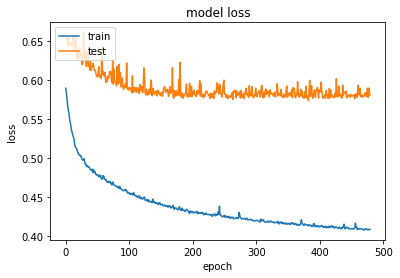

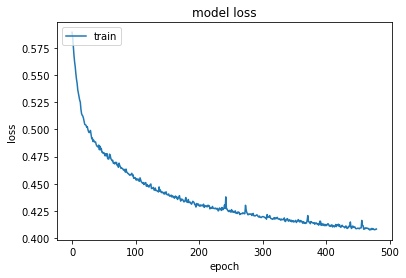

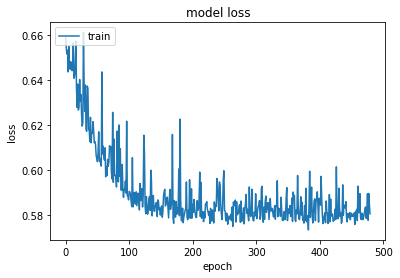

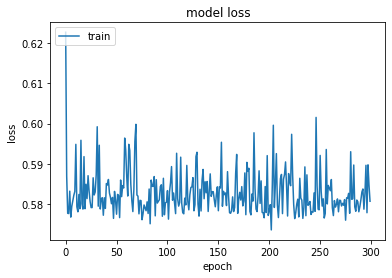

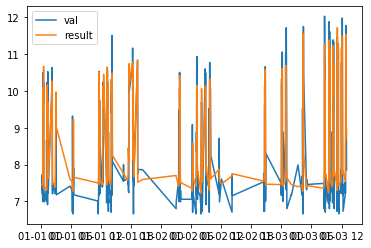

...

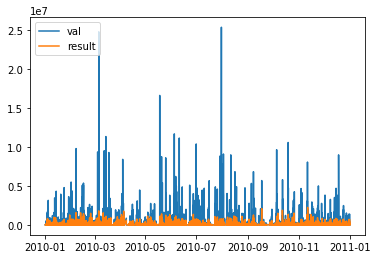

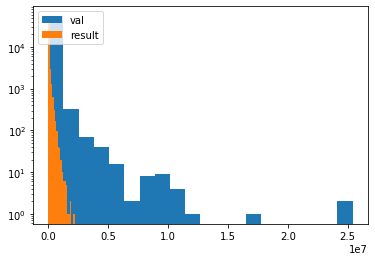

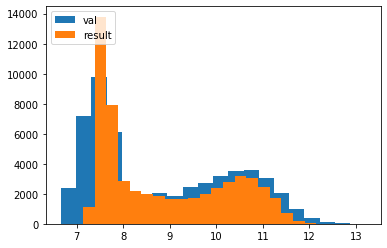

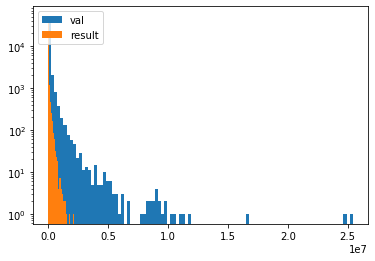

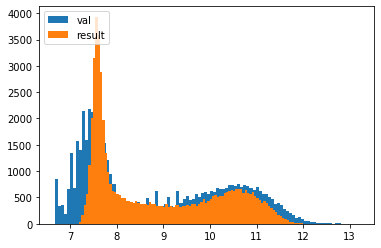

In [41]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=8192,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_23"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_47 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_48 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_28 (Conv2D)              (None, 1, 1, 256)    36096       input_47[0][0]                   
__________________________________________________________________________________________________
dense_128 (Dense)               (None, 768)          6912        input_48[0][0]                   
___________________________________________________________________________________________

2820/2820 [==============================] - 5s 2ms/step - loss: 0.4455 - mse: 0.4455 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 39/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4443 - mse: 0.4443 - val_loss: 0.5770 - val_mse: 0.5770
Epoch 40/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4435 - mse: 0.4435 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 41/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5775 - val_mse: 0.5775
Epoch 42/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4421 - mse: 0.4421 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 43/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4428 - mse: 0.4428 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 44/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4405 - mse: 0.4405 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 45/500
2820/2820 [==============================] - 5s 

2820/2820 [==============================] - 5s 2ms/step - loss: 0.4215 - mse: 0.4215 - val_loss: 0.5815 - val_mse: 0.5815
Epoch 99/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4205 - mse: 0.4205 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 100/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4208 - mse: 0.4208 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 101/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4200 - mse: 0.4200 - val_loss: 0.5744 - val_mse: 0.5744
Epoch 102/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4198 - mse: 0.4198 - val_loss: 0.5804 - val_mse: 0.5804
Epoch 103/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4202 - mse: 0.4202 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 104/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4209 - mse: 0.4209 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 105/500
2820/2820 [==============================]

Epoch 158/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4106 - mse: 0.4106 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 159/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4103 - mse: 0.4103 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 160/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4103 - mse: 0.4103 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 161/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4103 - mse: 0.4103 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 162/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4104 - mse: 0.4104 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 163/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4102 - mse: 0.4102 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 164/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4096 - mse: 0.4096 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 165/500
2820/2820 [================

Epoch 218/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4043 - mse: 0.4043 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 219/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4042 - mse: 0.4042 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 220/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4040 - mse: 0.4040 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 221/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4032 - mse: 0.4032 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 222/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4031 - mse: 0.4031 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 223/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.4030 - mse: 0.4030 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 224/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.4036 - mse: 0.4036 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 225/500
2820/2820 [================

Epoch 278/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 279/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3991 - mse: 0.3991 - val_loss: 0.5744 - val_mse: 0.5744
Epoch 280/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3997 - mse: 0.3997 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 281/500
2820/2820 [==============================] - 8s 3ms/step - loss: 0.3989 - mse: 0.3989 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 282/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3987 - mse: 0.3987 - val_loss: 0.5811 - val_mse: 0.5811
Epoch 283/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 284/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3992 - mse: 0.3992 - val_loss: 0.5792 - val_mse: 0.5792
Epoch 285/500
2820/2820 [================

Epoch 338/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3974 - mse: 0.3974 - val_loss: 0.5827 - val_mse: 0.5827
Epoch 339/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3957 - mse: 0.3957 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 340/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3966 - mse: 0.3966 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 341/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3953 - mse: 0.3953 - val_loss: 0.5830 - val_mse: 0.5830
Epoch 342/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 343/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3960 - mse: 0.3960 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 344/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3965 - mse: 0.3965 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 345/500
2820/2820 [================

Epoch 398/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3934 - mse: 0.3934 - val_loss: 0.5805 - val_mse: 0.5805
Epoch 399/500
2820/2820 [==============================] - 6s 2ms/step - loss: 0.3964 - mse: 0.3964 - val_loss: 0.5817 - val_mse: 0.5817
Epoch 400/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3924 - mse: 0.3924 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 401/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3930 - mse: 0.3930 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 402/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3925 - mse: 0.3925 - val_loss: 0.5870 - val_mse: 0.5870
Epoch 403/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3940 - mse: 0.3940 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 404/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3926 - mse: 0.3926 - val_loss: 0.5847 - val_mse: 0.5847
Epoch 405/500
2820/2820 [================

Epoch 458/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3913 - mse: 0.3913 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 459/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3914 - mse: 0.3914 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 460/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3917 - mse: 0.3917 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 461/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3903 - mse: 0.3903 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 462/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3910 - mse: 0.3910 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 463/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3912 - mse: 0.3912 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 464/500
2820/2820 [==============================] - 5s 2ms/step - loss: 0.3912 - mse: 0.3912 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 465/500
2820/2820 [================

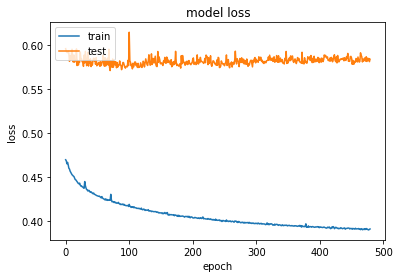

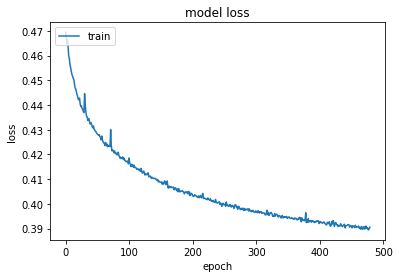

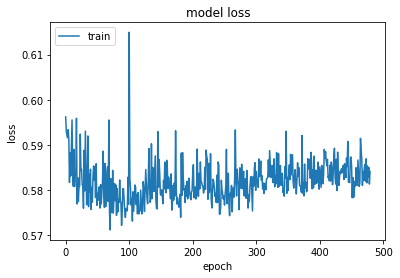

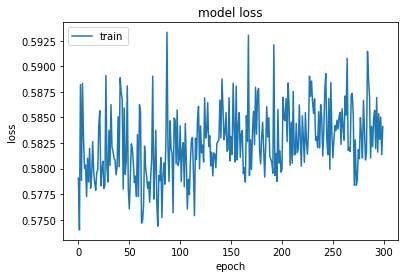

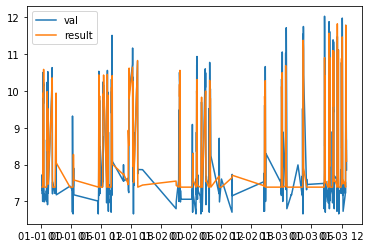

...

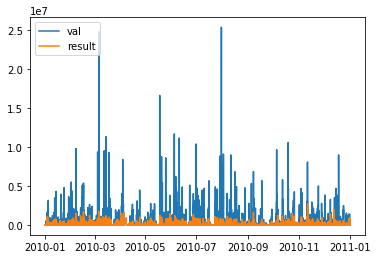

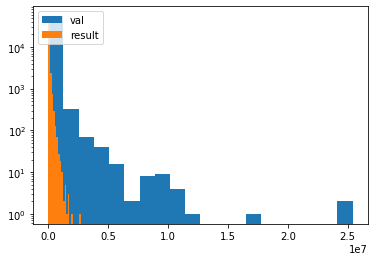

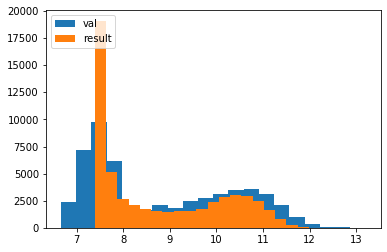

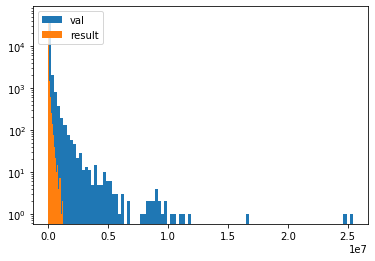

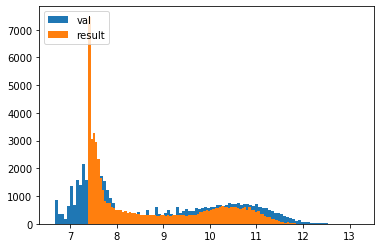

In [39]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=256,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_28"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_57 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_58 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_33 (Conv2D)              (None, 1, 1, 256)    36096       input_57[0][0]                   
__________________________________________________________________________________________________
dense_153 (Dense)               (None, 768)          6912        input_58[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 2s 2ms/step - loss: 0.0121 - mse: 0.4582 - val_loss: 0.0150 - val_mse: 0.4381
Epoch 39/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0121 - mse: 0.4463 - val_loss: 0.0149 - val_mse: 0.4171
Epoch 40/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0121 - mse: 0.4614 - val_loss: 0.0147 - val_mse: 0.5189
Epoch 41/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0121 - mse: 0.5015 - val_loss: 0.0151 - val_mse: 0.4645
Epoch 42/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0121 - mse: 0.5284 - val_loss: 0.0148 - val_mse: 0.6301
Epoch 43/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0120 - mse: 0.5135 - val_loss: 0.0152 - val_mse: 0.5072
Epoch 44/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0120 - mse: 0.5117 - val_loss: 0.0148 - val_mse: 0.4824
Epoch 45/500
705/705 [==============================] - 2s 3ms/step - loss:

705/705 [==============================] - 2s 2ms/step - loss: 0.0112 - mse: 0.3627 - val_loss: 0.0150 - val_mse: 0.3249
Epoch 100/500
705/705 [==============================] - 2s 2ms/step - loss: 0.0112 - mse: 0.3205 - val_loss: 0.0150 - val_mse: 0.3062
Epoch 101/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0111 - mse: 0.3046 - val_loss: 0.0152 - val_mse: 0.2890
Epoch 102/500
705/705 [==============================] - 2s 2ms/step - loss: 0.0112 - mse: 0.3227 - val_loss: 0.0150 - val_mse: 0.3031
Epoch 103/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0111 - mse: 0.3129 - val_loss: 0.0151 - val_mse: 0.3181
Epoch 104/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0112 - mse: 0.3232 - val_loss: 0.0152 - val_mse: 0.3062
Epoch 105/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0112 - mse: 0.3357 - val_loss: 0.0152 - val_mse: 0.3392
Epoch 106/500
705/705 [==============================] - 2s 3ms/step 

Epoch 160/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0106 - mse: 0.3971 - val_loss: 0.0150 - val_mse: 0.3881
Epoch 161/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0107 - mse: 0.3791 - val_loss: 0.0152 - val_mse: 0.3389
Epoch 162/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0107 - mse: 0.3630 - val_loss: 0.0154 - val_mse: 0.4645
Epoch 163/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0107 - mse: 0.3846 - val_loss: 0.0153 - val_mse: 0.3079
Epoch 164/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0107 - mse: 0.3556 - val_loss: 0.0153 - val_mse: 0.3197
Epoch 165/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0106 - mse: 0.3705 - val_loss: 0.0154 - val_mse: 0.4140
Epoch 166/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0106 - mse: 0.3688 - val_loss: 0.0151 - val_mse: 0.3302
Epoch 167/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.0103 - mse: 0.3611 - val_loss: 0.0153 - val_mse: 0.4929
Epoch 221/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0103 - mse: 0.4165 - val_loss: 0.0153 - val_mse: 0.3752
Epoch 222/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0103 - mse: 0.3880 - val_loss: 0.0152 - val_mse: 0.3709
Epoch 223/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0103 - mse: 0.3999 - val_loss: 0.0154 - val_mse: 0.4616
Epoch 224/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0102 - mse: 0.4046 - val_loss: 0.0154 - val_mse: 0.4696
Epoch 225/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0103 - mse: 0.4052 - val_loss: 0.0153 - val_mse: 0.4402
Epoch 226/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0103 - mse: 0.4645 - val_loss: 0.0152 - val_mse: 0.4685
Epoch 227/500
705/705 [==============================] - 2s 3ms/step 

Epoch 281/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0099 - mse: 0.3248 - val_loss: 0.0152 - val_mse: 0.3385
Epoch 282/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0100 - mse: 0.3591 - val_loss: 0.0153 - val_mse: 0.3477
Epoch 283/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0100 - mse: 0.3561 - val_loss: 0.0152 - val_mse: 0.3722
Epoch 284/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0100 - mse: 0.3415 - val_loss: 0.0153 - val_mse: 0.3278
Epoch 285/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0100 - mse: 0.3393 - val_loss: 0.0153 - val_mse: 0.3794
Epoch 286/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0100 - mse: 0.3185 - val_loss: 0.0155 - val_mse: 0.3695
Epoch 287/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0100 - mse: 0.3390 - val_loss: 0.0154 - val_mse: 0.3574
Epoch 288/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.0097 - mse: 0.3678 - val_loss: 0.0153 - val_mse: 0.4156
Epoch 342/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0097 - mse: 0.3679 - val_loss: 0.0152 - val_mse: 0.4396
Epoch 343/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0098 - mse: 0.3555 - val_loss: 0.0152 - val_mse: 0.3416
Epoch 344/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0097 - mse: 0.3465 - val_loss: 0.0153 - val_mse: 0.2513
Epoch 345/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0097 - mse: 0.3380 - val_loss: 0.0153 - val_mse: 0.3205
Epoch 346/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0097 - mse: 0.3969 - val_loss: 0.0152 - val_mse: 0.3735
Epoch 347/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0097 - mse: 0.3827 - val_loss: 0.0153 - val_mse: 0.3276
Epoch 348/500
705/705 [==============================] - 2s 3ms/step 

Epoch 402/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3647 - val_loss: 0.0154 - val_mse: 0.3196
Epoch 403/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3544 - val_loss: 0.0155 - val_mse: 0.4205
Epoch 404/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3501 - val_loss: 0.0154 - val_mse: 0.3331
Epoch 405/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0096 - mse: 0.3596 - val_loss: 0.0156 - val_mse: 0.3669
Epoch 406/500
705/705 [==============================] - 2s 2ms/step - loss: 0.0095 - mse: 0.3482 - val_loss: 0.0155 - val_mse: 0.3499
Epoch 407/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3555 - val_loss: 0.0155 - val_mse: 0.3745
Epoch 408/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3449 - val_loss: 0.0154 - val_mse: 0.4060
Epoch 409/500
705/705 [==============================] 

705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3630 - val_loss: 0.0156 - val_mse: 0.3945
Epoch 463/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0094 - mse: 0.3612 - val_loss: 0.0155 - val_mse: 0.4535
Epoch 464/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0094 - mse: 0.3350 - val_loss: 0.0156 - val_mse: 0.3439
Epoch 465/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0094 - mse: 0.3495 - val_loss: 0.0155 - val_mse: 0.3083
Epoch 466/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0094 - mse: 0.3918 - val_loss: 0.0156 - val_mse: 0.4413
Epoch 467/500
705/705 [==============================] - 2s 3ms/step - loss: 0.0095 - mse: 0.3665 - val_loss: 0.0155 - val_mse: 0.3064
Epoch 468/500
705/705 [==============================] - 2s 2ms/step - loss: 0.0093 - mse: 0.3667 - val_loss: 0.0156 - val_mse: 0.4292
Epoch 469/500
705/705 [==============================] - 2s 3ms/step 

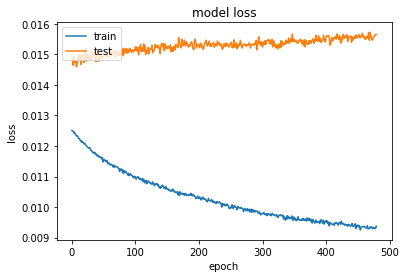

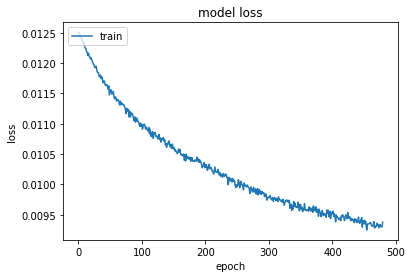

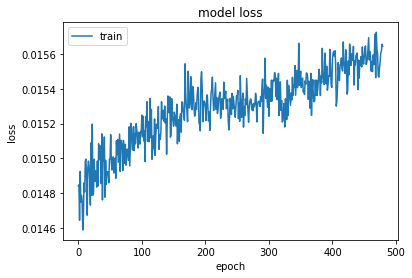

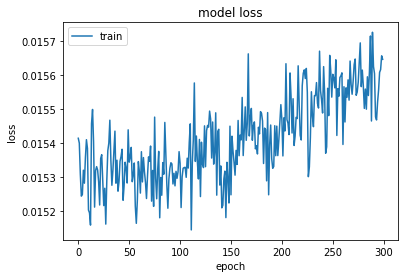

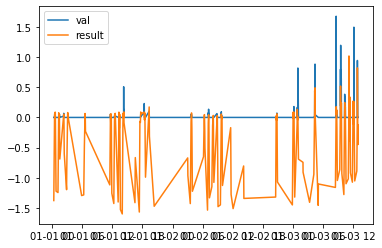

...

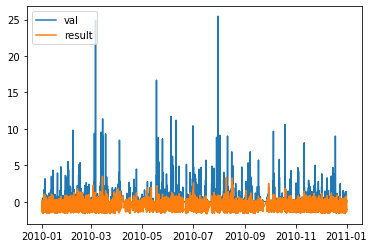

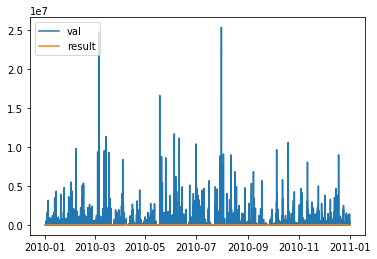

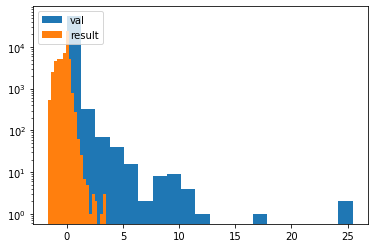

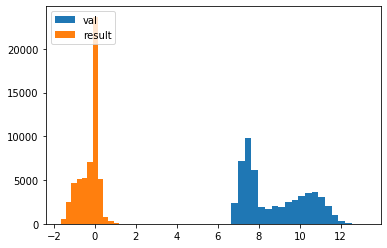

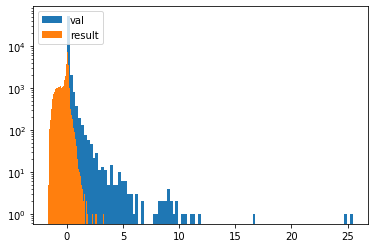

In [44]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(768, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='msle', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_erg), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_erg)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_erg[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_erg[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_erg[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_erg[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_erg[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_erg[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_erg.values,bins=20, log=True)
plt.hist(df_results.values,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_erg.values,bins=100, log=True)
plt.hist(df_results.values,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()



Model: "model_27"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_55 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_56 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_32 (Conv2D)              (None, 1, 1, 128)    18048       input_55[0][0]                   
__________________________________________________________________________________________________
dense_148 (Dense)               (None, 256)          2304        input_56[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 1s 2ms/step - loss: 0.4941 - mse: 0.4941 - val_loss: 0.6047 - val_mse: 0.6047
Epoch 39/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4936 - mse: 0.4936 - val_loss: 0.6062 - val_mse: 0.6062
Epoch 40/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4927 - mse: 0.4927 - val_loss: 0.6012 - val_mse: 0.6012
Epoch 41/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4925 - mse: 0.4925 - val_loss: 0.6028 - val_mse: 0.6028
Epoch 42/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4924 - mse: 0.4924 - val_loss: 0.6149 - val_mse: 0.6149
Epoch 43/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4916 - mse: 0.4916 - val_loss: 0.6050 - val_mse: 0.6050
Epoch 44/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4907 - mse: 0.4907 - val_loss: 0.6032 - val_mse: 0.6032
Epoch 45/500
705/705 [==============================] - 1s 2ms/step - loss:

705/705 [==============================] - 1s 2ms/step - loss: 0.4686 - mse: 0.4686 - val_loss: 0.6022 - val_mse: 0.6022
Epoch 100/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4709 - mse: 0.4709 - val_loss: 0.5970 - val_mse: 0.5970
Epoch 101/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4669 - mse: 0.4669 - val_loss: 0.6004 - val_mse: 0.6004
Epoch 102/500
705/705 [==============================] - 2s 2ms/step - loss: 0.4670 - mse: 0.4670 - val_loss: 0.5989 - val_mse: 0.5989
Epoch 103/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4662 - mse: 0.4662 - val_loss: 0.6046 - val_mse: 0.6046
Epoch 104/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4666 - mse: 0.4666 - val_loss: 0.5977 - val_mse: 0.5977
Epoch 105/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4661 - mse: 0.4661 - val_loss: 0.5976 - val_mse: 0.5976
Epoch 106/500
705/705 [==============================] - 1s 2ms/step 

Epoch 160/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4562 - mse: 0.4562 - val_loss: 0.5948 - val_mse: 0.5948
Epoch 161/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4568 - mse: 0.4568 - val_loss: 0.6002 - val_mse: 0.6002
Epoch 162/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4564 - mse: 0.4564 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 163/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4559 - mse: 0.4559 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 164/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4564 - mse: 0.4564 - val_loss: 0.5968 - val_mse: 0.5968
Epoch 165/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4561 - mse: 0.4561 - val_loss: 0.6010 - val_mse: 0.6010
Epoch 166/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4557 - mse: 0.4557 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 167/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4504 - mse: 0.4504 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 221/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4499 - mse: 0.4499 - val_loss: 0.5946 - val_mse: 0.5946
Epoch 222/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4505 - mse: 0.4505 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 223/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4501 - mse: 0.4501 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 224/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4500 - mse: 0.4500 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 225/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4492 - mse: 0.4492 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 226/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4499 - mse: 0.4499 - val_loss: 0.5920 - val_mse: 0.5920
Epoch 227/500
705/705 [==============================] - 1s 2ms/step 

Epoch 281/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4456 - mse: 0.4456 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 282/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4460 - mse: 0.4460 - val_loss: 0.5862 - val_mse: 0.5862
Epoch 283/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4452 - mse: 0.4452 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 284/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4454 - mse: 0.4454 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 285/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4452 - mse: 0.4452 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 286/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4454 - mse: 0.4454 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 287/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4458 - mse: 0.4458 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 288/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4426 - mse: 0.4426 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 342/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4428 - mse: 0.4428 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 343/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 344/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4427 - mse: 0.4427 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 345/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4421 - mse: 0.4421 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 346/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 347/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5950 - val_mse: 0.5950
Epoch 348/500
705/705 [==============================] - 1s 2ms/step 

Epoch 402/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4406 - mse: 0.4406 - val_loss: 0.5950 - val_mse: 0.5950
Epoch 403/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4414 - mse: 0.4414 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 404/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4404 - mse: 0.4404 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 405/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4405 - mse: 0.4405 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 406/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4412 - mse: 0.4412 - val_loss: 0.5951 - val_mse: 0.5951
Epoch 407/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4406 - mse: 0.4406 - val_loss: 0.5958 - val_mse: 0.5958
Epoch 408/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4403 - mse: 0.4403 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 409/500
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4386 - mse: 0.4386 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 463/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4389 - mse: 0.4389 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 464/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4389 - mse: 0.4389 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 465/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4384 - mse: 0.4384 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 466/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4389 - mse: 0.4389 - val_loss: 0.5910 - val_mse: 0.5910
Epoch 467/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4388 - mse: 0.4388 - val_loss: 0.5964 - val_mse: 0.5964
Epoch 468/500
705/705 [==============================] - 1s 2ms/step - loss: 0.4386 - mse: 0.4386 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 469/500
705/705 [==============================] - 1s 2ms/step 

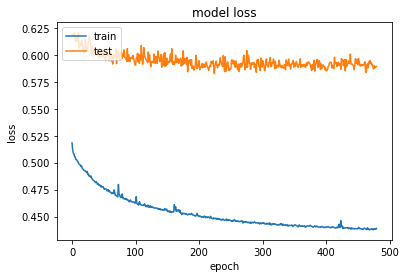

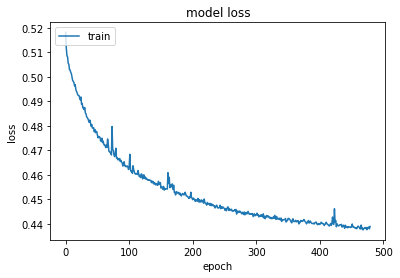

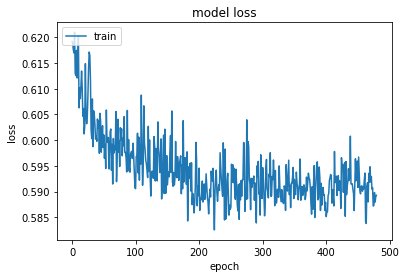

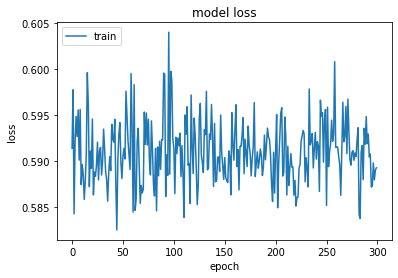

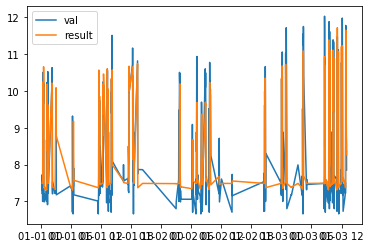

...

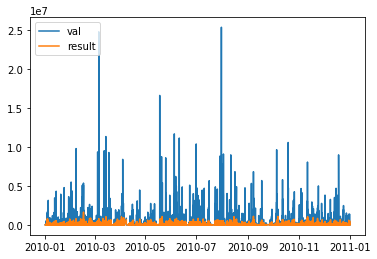

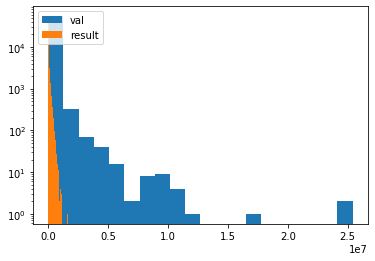

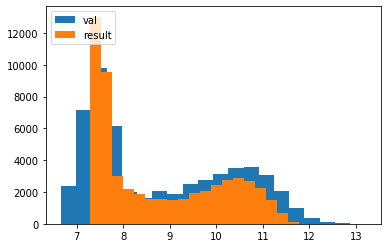

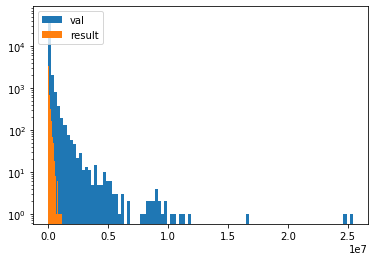

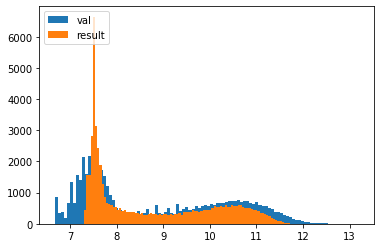

In [43]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(128, kernel_size=(14,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(256, activation='relu')(input2)
model2= Dropout(0.5)(model2)

model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(64, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=500)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_29"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_59 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_34 (Conv2D)              (None, 14, 1, 256)   2816        input_59[0][0]                   
__________________________________________________________________________________________________
input_60 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_64 (Dropout)            (None, 14, 1, 256)   0           conv2d_34[0][0]                  
___________________________________________________________________________________________

705/705 [==============================] - 7s 10ms/step - loss: 0.4749 - mse: 0.4749 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 35/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4739 - mse: 0.4739 - val_loss: 0.5928 - val_mse: 0.5928
Epoch 36/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4739 - mse: 0.4739 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 37/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4736 - mse: 0.4736 - val_loss: 0.6013 - val_mse: 0.6013
Epoch 38/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4718 - mse: 0.4718 - val_loss: 0.6038 - val_mse: 0.6038
Epoch 39/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4700 - mse: 0.4700 - val_loss: 0.6106 - val_mse: 0.6106
Epoch 40/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4691 - mse: 0.4691 - val_loss: 0.5992 - val_mse: 0.5992
Epoch 41/600
705/705 [==============================] - 6s 9ms/step - los

705/705 [==============================] - 7s 10ms/step - loss: 0.4437 - mse: 0.4437 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 96/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4432 - mse: 0.4432 - val_loss: 0.5873 - val_mse: 0.5873
Epoch 97/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 98/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4417 - mse: 0.4417 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 99/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4428 - mse: 0.4428 - val_loss: 0.5888 - val_mse: 0.5888
Epoch 100/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5838 - val_mse: 0.5838
Epoch 101/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4416 - mse: 0.4416 - val_loss: 0.5821 - val_mse: 0.5821
Epoch 102/600
705/705 [==============================] - 7s 10ms/step - 

705/705 [==============================] - 7s 9ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 156/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5804 - val_mse: 0.5804
Epoch 157/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4297 - mse: 0.4297 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 158/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4304 - mse: 0.4304 - val_loss: 0.5806 - val_mse: 0.5806
Epoch 159/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4285 - mse: 0.4285 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 160/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4294 - mse: 0.4294 - val_loss: 0.5917 - val_mse: 0.5917
Epoch 161/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 162/600
705/705 [==============================] - 7s 10ms/ste

705/705 [==============================] - 7s 10ms/step - loss: 0.4184 - mse: 0.4184 - val_loss: 0.5974 - val_mse: 0.5974
Epoch 216/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4200 - mse: 0.4200 - val_loss: 0.5971 - val_mse: 0.5971
Epoch 217/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4255 - mse: 0.4255 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 218/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4190 - mse: 0.4190 - val_loss: 0.5831 - val_mse: 0.5831
Epoch 219/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4215 - mse: 0.4215 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 220/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4187 - mse: 0.4187 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 221/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4187 - mse: 0.4187 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 222/600
705/705 [==============================] - 7s 10ms/

705/705 [==============================] - 7s 11ms/step - loss: 0.4130 - mse: 0.4130 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 276/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4124 - mse: 0.4124 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 277/600
705/705 [==============================] - 7s 11ms/step - loss: 0.4130 - mse: 0.4130 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 278/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4120 - mse: 0.4120 - val_loss: 0.5829 - val_mse: 0.5829
Epoch 279/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4121 - mse: 0.4121 - val_loss: 0.5804 - val_mse: 0.5804
Epoch 280/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4168 - mse: 0.4168 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 281/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4119 - mse: 0.4119 - val_loss: 0.5837 - val_mse: 0.5837
Epoch 282/600
705/705 [==============================] - 7s 11

705/705 [==============================] - 7s 10ms/step - loss: 0.4077 - mse: 0.4077 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 336/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4078 - mse: 0.4078 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 337/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4078 - mse: 0.4078 - val_loss: 0.5899 - val_mse: 0.5899
Epoch 338/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4072 - mse: 0.4072 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 339/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4070 - mse: 0.4070 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 340/600
705/705 [==============================] - 7s 11ms/step - loss: 0.4069 - mse: 0.4069 - val_loss: 0.5817 - val_mse: 0.5817
Epoch 341/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.5831 - val_mse: 0.5831
Epoch 342/600
705/705 [==============================] - 8s 11

705/705 [==============================] - 8s 11ms/step - loss: 0.4029 - mse: 0.4029 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 396/600
705/705 [==============================] - 7s 11ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5999 - val_mse: 0.5999
Epoch 397/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4022 - mse: 0.4022 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 398/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4020 - mse: 0.4020 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 399/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4019 - mse: 0.4019 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 400/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4021 - mse: 0.4021 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 401/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4018 - mse: 0.4018 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 402/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.4016 - mse: 0.4016 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 456/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4006 - mse: 0.4006 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 457/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4012 - mse: 0.4012 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 458/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3997 - mse: 0.3997 - val_loss: 0.5858 - val_mse: 0.5858
Epoch 459/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 460/600
705/705 [==============================] - 7s 11ms/step - loss: 0.3985 - mse: 0.3985 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 461/600
705/705 [==============================] - 8s 11ms/step - loss: 0.3982 - mse: 0.3982 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 462/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 8s 11ms/step - loss: 0.3966 - mse: 0.3966 - val_loss: 0.5838 - val_mse: 0.5838
Epoch 516/600
705/705 [==============================] - 8s 11ms/step - loss: 0.3960 - mse: 0.3960 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 517/600
705/705 [==============================] - 7s 11ms/step - loss: 0.3956 - mse: 0.3956 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 518/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3964 - mse: 0.3964 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 519/600
705/705 [==============================] - 8s 11ms/step - loss: 0.3952 - mse: 0.3952 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 520/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3956 - mse: 0.3956 - val_loss: 0.5821 - val_mse: 0.5821
Epoch 521/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3955 - mse: 0.3955 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 522/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 9ms/step - loss: 0.3935 - mse: 0.3935 - val_loss: 0.5895 - val_mse: 0.5895
Epoch 576/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3928 - mse: 0.3928 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 577/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3934 - mse: 0.3934 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 578/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3939 - mse: 0.3939 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 579/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3937 - mse: 0.3937 - val_loss: 0.5849 - val_mse: 0.5849
Epoch 580/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3944 - mse: 0.3944 - val_loss: 0.5878 - val_mse: 0.5878
Epoch 581/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3930 - mse: 0.3930 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 582/600
705/705 [==============================] - 7s 10ms/

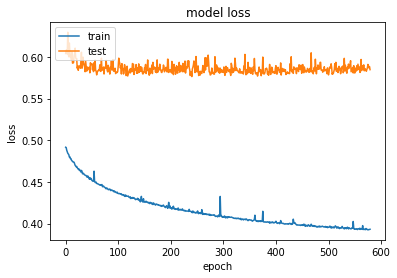

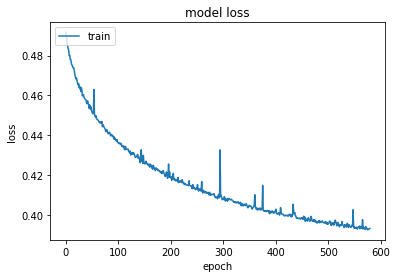

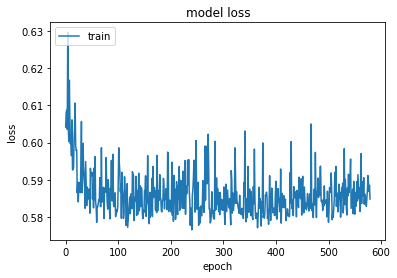

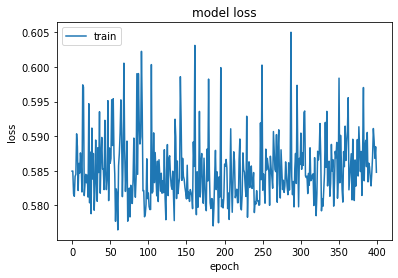

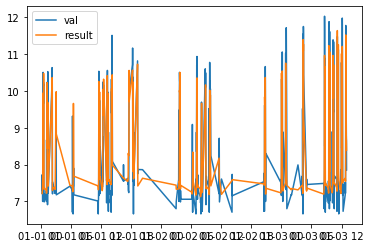

...

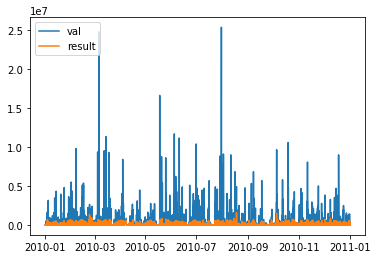

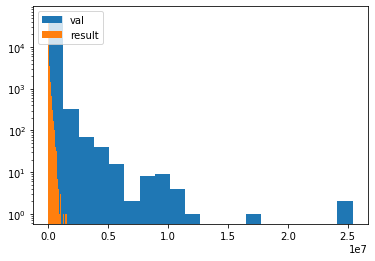

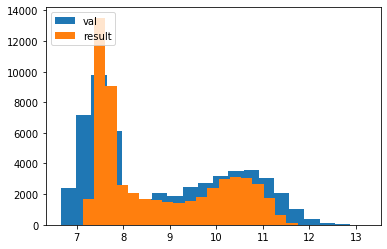

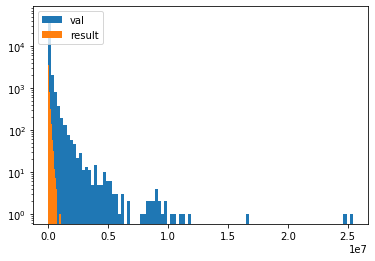

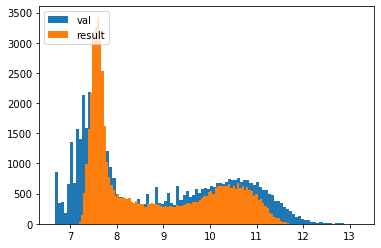

In [45]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_30"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_61 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_36 (Conv2D)              (None, 14, 1, 256)   2816        input_61[0][0]                   
__________________________________________________________________________________________________
input_62 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_67 (Dropout)            (None, 14, 1, 256)   0           conv2d_36[0][0]                  
___________________________________________________________________________________________

Epoch 34/600
705/705 [==============================] - 9s 12ms/step - loss: 0.4756 - mse: 0.4756 - val_loss: 0.6072 - val_mse: 0.6072
Epoch 35/600
705/705 [==============================] - 9s 12ms/step - loss: 0.4691 - mse: 0.4691 - val_loss: 0.6122 - val_mse: 0.6122
Epoch 36/600
705/705 [==============================] - 9s 13ms/step - loss: 0.4682 - mse: 0.4682 - val_loss: 0.6050 - val_mse: 0.6050
Epoch 37/600
705/705 [==============================] - 12s 16ms/step - loss: 0.4659 - mse: 0.4659 - val_loss: 0.5988 - val_mse: 0.5988
Epoch 38/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4641 - mse: 0.4641 - val_loss: 0.6062 - val_mse: 0.6062
Epoch 39/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4624 - mse: 0.4624 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 40/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4614 - mse: 0.4614 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 41/600
705/705 [=============================

705/705 [==============================] - 16s 23ms/step - loss: 0.4260 - mse: 0.4260 - val_loss: 0.5731 - val_mse: 0.5731
Epoch 95/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4255 - mse: 0.4255 - val_loss: 0.5865 - val_mse: 0.5865
Epoch 96/600
705/705 [==============================] - 17s 24ms/step - loss: 0.4243 - mse: 0.4243 - val_loss: 0.5729 - val_mse: 0.5729
Epoch 97/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4241 - mse: 0.4241 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 98/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4245 - mse: 0.4245 - val_loss: 0.5798 - val_mse: 0.5798
Epoch 99/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4260 - mse: 0.4260 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 100/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4235 - mse: 0.4235 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 101/600
705/705 [==============================] - 16s

Epoch 154/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4016 - mse: 0.4016 - val_loss: 0.5729 - val_mse: 0.5729
Epoch 155/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4026 - mse: 0.4026 - val_loss: 0.5815 - val_mse: 0.5815
Epoch 156/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4011 - mse: 0.4011 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 157/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4010 - mse: 0.4010 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 158/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4000 - mse: 0.4000 - val_loss: 0.5744 - val_mse: 0.5744
Epoch 159/600
705/705 [==============================] - 16s 23ms/step - loss: 0.4004 - mse: 0.4004 - val_loss: 0.5739 - val_mse: 0.5739
Epoch 160/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 161/600
705/705 [==================

Epoch 214/600
705/705 [==============================] - 17s 24ms/step - loss: 0.7075 - mse: 0.7075 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 215/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3955 - mse: 0.3955 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 216/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3871 - mse: 0.3871 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 217/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3868 - mse: 0.3868 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 218/600
705/705 [==============================] - 17s 23ms/step - loss: 0.3887 - mse: 0.3887 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 219/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3861 - mse: 0.3861 - val_loss: 0.5755 - val_mse: 0.5755
Epoch 220/600
705/705 [==============================] - 17s 24ms/step - loss: 0.3861 - mse: 0.3861 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 221/600
705/705 [==================

Epoch 274/600
705/705 [==============================] - 17s 24ms/step - loss: 0.3777 - mse: 0.3777 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 275/600
705/705 [==============================] - 17s 25ms/step - loss: 0.3771 - mse: 0.3771 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 276/600
705/705 [==============================] - 17s 24ms/step - loss: 0.3773 - mse: 0.3773 - val_loss: 0.5791 - val_mse: 0.5791
Epoch 277/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3767 - mse: 0.3767 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 278/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3770 - mse: 0.3770 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 279/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3763 - mse: 0.3763 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 280/600
705/705 [==============================] - 17s 24ms/step - loss: 0.3764 - mse: 0.3764 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 281/600
705/705 [==================

705/705 [==============================] - 16s 23ms/step - loss: 0.3697 - mse: 0.3697 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 334/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3695 - mse: 0.3695 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 335/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3692 - mse: 0.3692 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 336/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3695 - mse: 0.3695 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 337/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3701 - mse: 0.3701 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 338/600
705/705 [==============================] - 17s 23ms/step - loss: 0.3698 - mse: 0.3698 - val_loss: 0.5820 - val_mse: 0.5820
Epoch 339/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3689 - mse: 0.3689 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 340/600
705/705 [==============================] 

705/705 [==============================] - 16s 23ms/step - loss: 0.3630 - mse: 0.3630 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 393/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3705 - mse: 0.3705 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 394/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3648 - mse: 0.3648 - val_loss: 0.5862 - val_mse: 0.5862
Epoch 395/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3637 - mse: 0.3637 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 396/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3634 - mse: 0.3634 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 397/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3641 - mse: 0.3641 - val_loss: 0.5828 - val_mse: 0.5828
Epoch 398/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3634 - mse: 0.3634 - val_loss: 0.5859 - val_mse: 0.5859
Epoch 399/600
705/705 [==============================] 

Epoch 452/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3582 - mse: 0.3582 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 453/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3585 - mse: 0.3585 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 454/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3595 - mse: 0.3595 - val_loss: 0.5859 - val_mse: 0.5859
Epoch 455/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3587 - mse: 0.3587 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 456/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3582 - mse: 0.3582 - val_loss: 0.5845 - val_mse: 0.5845
Epoch 457/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3576 - mse: 0.3576 - val_loss: 0.5898 - val_mse: 0.5898
Epoch 458/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3588 - mse: 0.3588 - val_loss: 0.5851 - val_mse: 0.5851
Epoch 459/600
705/705 [==================

705/705 [==============================] - 16s 22ms/step - loss: 0.3543 - mse: 0.3543 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 512/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3543 - mse: 0.3543 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 513/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3544 - mse: 0.3544 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 514/600
705/705 [==============================] - 16s 23ms/step - loss: 0.3527 - mse: 0.3527 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 515/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3539 - mse: 0.3539 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 516/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3537 - mse: 0.3537 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 517/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3547 - mse: 0.3547 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 518/600
705/705 [==============================] 

705/705 [==============================] - 16s 22ms/step - loss: 0.3504 - mse: 0.3504 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 571/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3508 - mse: 0.3508 - val_loss: 0.5901 - val_mse: 0.5901
Epoch 572/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3507 - mse: 0.3507 - val_loss: 0.5913 - val_mse: 0.5913
Epoch 573/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3507 - mse: 0.3507 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 574/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3510 - mse: 0.3510 - val_loss: 0.5932 - val_mse: 0.5932mse
Epoch 575/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3509 - mse: 0.3509 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 576/600
705/705 [==============================] - 16s 22ms/step - loss: 0.3501 - mse: 0.3501 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 577/600
705/705 [=============================

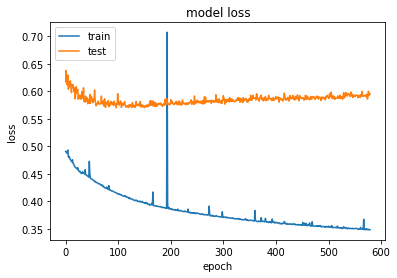

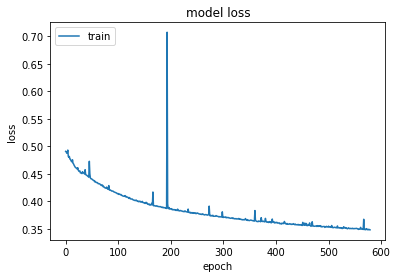

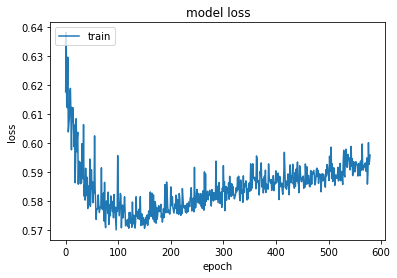

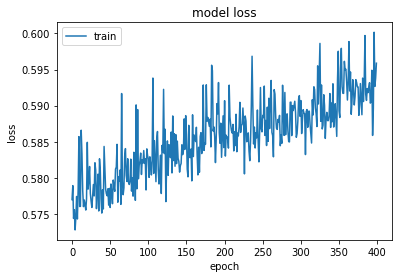

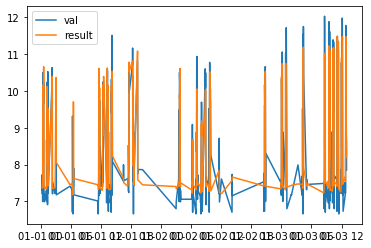

...

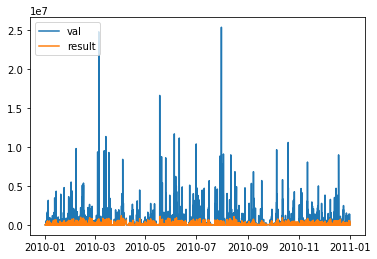

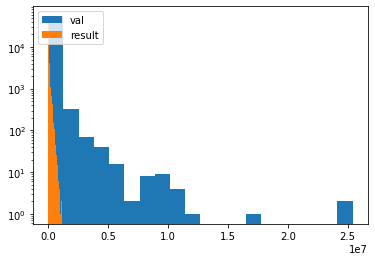

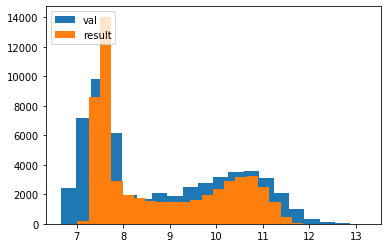

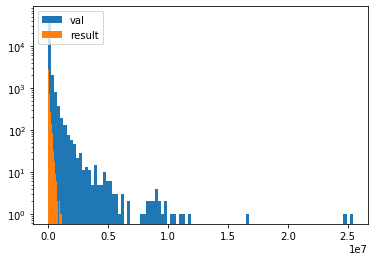

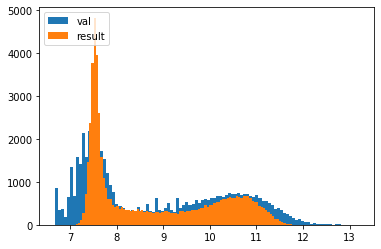

In [46]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(5,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_31"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_63 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_64 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_38 (Conv2D)              (None, 14, 1, 256)   2816        input_63[0][0]                   
__________________________________________________________________________________________________
dense_170 (Dense)               (None, 512)          4608        input_64[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 12s 17ms/step - loss: 0.4387 - mse: 0.4387 - val_loss: 0.5901 - val_mse: 0.5901
Epoch 36/600
705/705 [==============================] - 12s 17ms/step - loss: 0.4376 - mse: 0.4376 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 37/600
705/705 [==============================] - 12s 17ms/step - loss: 0.4361 - mse: 0.4361 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 38/600
705/705 [==============================] - 12s 17ms/step - loss: 0.4350 - mse: 0.4350 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 39/600
705/705 [==============================] - 12s 17ms/step - loss: 0.4332 - mse: 0.4332 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 40/600
705/705 [==============================] - 12s 17ms/step - loss: 0.4320 - mse: 0.4320 - val_loss: 0.5944 - val_mse: 0.5944
Epoch 41/600
705/705 [==============================] - 12s 17ms/step - loss: 0.4319 - mse: 0.4319 - val_loss: 0.5973 - val_mse: 0.5973
Epoch 42/600
705/705 [==============================] - 12s 1

705/705 [==============================] - 12s 17ms/step - loss: 0.3944 - mse: 0.3944 - val_loss: 0.5951 - val_mse: 0.5951
Epoch 96/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3961 - mse: 0.3961 - val_loss: 0.5906 - val_mse: 0.5906
Epoch 97/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.6386 - val_mse: 0.6386
Epoch 98/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3936 - mse: 0.3936 - val_loss: 0.5986 - val_mse: 0.5986
Epoch 99/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3927 - mse: 0.3927 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 100/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3921 - mse: 0.3921 - val_loss: 0.5890 - val_mse: 0.5890
Epoch 101/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5900 - val_mse: 0.5900
Epoch 102/600
705/705 [==============================] - 12

Epoch 155/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3755 - mse: 0.3755 - val_loss: 0.5992 - val_mse: 0.5992
Epoch 156/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3751 - mse: 0.3751 - val_loss: 0.6044 - val_mse: 0.6044
Epoch 157/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3738 - mse: 0.3738 - val_loss: 0.5986 - val_mse: 0.5986
Epoch 158/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3741 - mse: 0.3741 - val_loss: 0.5963 - val_mse: 0.5963
Epoch 159/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3740 - mse: 0.3740 - val_loss: 0.5952 - val_mse: 0.5952
Epoch 160/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3752 - mse: 0.3752 - val_loss: 0.5907 - val_mse: 0.5907
Epoch 161/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3737 - mse: 0.3737 - val_loss: 0.5938 - val_mse: 0.5938
Epoch 162/600
705/705 [==================

Epoch 215/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3640 - mse: 0.3640 - val_loss: 0.5943 - val_mse: 0.5943
Epoch 216/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3638 - mse: 0.3638 - val_loss: 0.6033 - val_mse: 0.6033
Epoch 217/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3637 - mse: 0.3637 - val_loss: 0.6004 - val_mse: 0.6004
Epoch 218/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3627 - mse: 0.3627 - val_loss: 0.6015 - val_mse: 0.6015
Epoch 219/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3627 - mse: 0.3627 - val_loss: 0.6008 - val_mse: 0.6008
Epoch 220/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3628 - mse: 0.3628 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 221/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3624 - mse: 0.3624 - val_loss: 0.5972 - val_mse: 0.5972
Epoch 222/600
705/705 [==================

Epoch 275/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3553 - mse: 0.3553 - val_loss: 0.6106 - val_mse: 0.6106
Epoch 276/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3548 - mse: 0.3548 - val_loss: 0.6077 - val_mse: 0.6077
Epoch 277/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3547 - mse: 0.3547 - val_loss: 0.6146 - val_mse: 0.6146
Epoch 278/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3542 - mse: 0.3542 - val_loss: 0.6017 - val_mse: 0.6017
Epoch 279/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3545 - mse: 0.3545 - val_loss: 0.6031 - val_mse: 0.6031
Epoch 280/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3548 - mse: 0.3548 - val_loss: 0.5961 - val_mse: 0.5961
Epoch 281/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3544 - mse: 0.3544 - val_loss: 0.6049 - val_mse: 0.6049
Epoch 282/600
705/705 [==================

Epoch 335/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3485 - mse: 0.3485 - val_loss: 0.6056 - val_mse: 0.6056
Epoch 336/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3491 - mse: 0.3491 - val_loss: 0.6043 - val_mse: 0.6043
Epoch 337/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3494 - mse: 0.3494 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 338/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3518 - mse: 0.3518 - val_loss: 0.6098 - val_mse: 0.6098
Epoch 339/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3485 - mse: 0.3485 - val_loss: 0.6127 - val_mse: 0.6127
Epoch 340/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3499 - mse: 0.3499 - val_loss: 0.6051 - val_mse: 0.6051
Epoch 341/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3491 - mse: 0.3491 - val_loss: 0.6028 - val_mse: 0.6028
Epoch 342/600
705/705 [==================

Epoch 395/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3456 - mse: 0.3456 - val_loss: 0.6168 - val_mse: 0.6168
Epoch 396/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3447 - mse: 0.3447 - val_loss: 0.6135 - val_mse: 0.6135
Epoch 397/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3451 - mse: 0.3451 - val_loss: 0.6100 - val_mse: 0.6100
Epoch 398/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3441 - mse: 0.3441 - val_loss: 0.6121 - val_mse: 0.6121
Epoch 399/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3443 - mse: 0.3443 - val_loss: 0.6142 - val_mse: 0.6142
Epoch 400/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3444 - mse: 0.3444 - val_loss: 0.6098 - val_mse: 0.6098
Epoch 401/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3447 - mse: 0.3447 - val_loss: 0.6142 - val_mse: 0.6142
Epoch 402/600
705/705 [==================

Epoch 455/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3731 - mse: 0.3731 - val_loss: 0.6204 - val_mse: 0.6204
Epoch 456/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3482 - mse: 0.3482 - val_loss: 0.6162 - val_mse: 0.6162
Epoch 457/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3494 - mse: 0.3494 - val_loss: 0.6147 - val_mse: 0.6147
Epoch 458/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3437 - mse: 0.3437 - val_loss: 0.6145 - val_mse: 0.6145
Epoch 459/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3427 - mse: 0.3427 - val_loss: 0.6193 - val_mse: 0.6193
Epoch 460/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3417 - mse: 0.3417 - val_loss: 0.6174 - val_mse: 0.6174
Epoch 461/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3414 - mse: 0.3414 - val_loss: 0.6147 - val_mse: 0.6147
Epoch 462/600
705/705 [==================

Epoch 515/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3381 - mse: 0.3381 - val_loss: 0.6157 - val_mse: 0.6157
Epoch 516/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3384 - mse: 0.3384 - val_loss: 0.6209 - val_mse: 0.6209
Epoch 517/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3378 - mse: 0.3378 - val_loss: 0.6246 - val_mse: 0.6246
Epoch 518/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3377 - mse: 0.3377 - val_loss: 0.6183 - val_mse: 0.6183
Epoch 519/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3378 - mse: 0.3378 - val_loss: 0.6172 - val_mse: 0.6172
Epoch 520/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3380 - mse: 0.3380 - val_loss: 0.6181 - val_mse: 0.6181
Epoch 521/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3371 - mse: 0.3371 - val_loss: 0.6216 - val_mse: 0.6216
Epoch 522/600
705/705 [==================

Epoch 575/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3343 - mse: 0.3343 - val_loss: 0.6223 - val_mse: 0.6223
Epoch 576/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3337 - mse: 0.3337 - val_loss: 0.6225 - val_mse: 0.6225
Epoch 577/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3350 - mse: 0.3350 - val_loss: 0.6218 - val_mse: 0.6218
Epoch 578/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3340 - mse: 0.3340 - val_loss: 0.6249 - val_mse: 0.6249
Epoch 579/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3347 - mse: 0.3347 - val_loss: 0.6225 - val_mse: 0.6225
Epoch 580/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3339 - mse: 0.3339 - val_loss: 0.6270 - val_mse: 0.6270
Epoch 581/600
705/705 [==============================] - 12s 17ms/step - loss: 0.3341 - mse: 0.3341 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 582/600
705/705 [==================

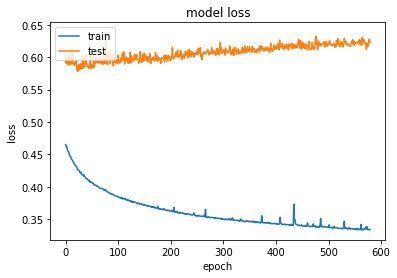

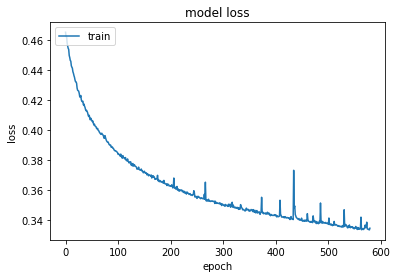

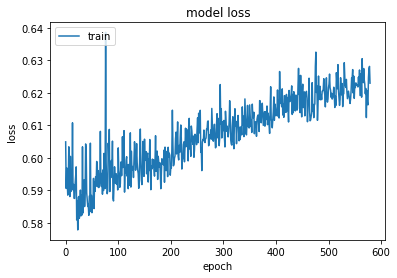

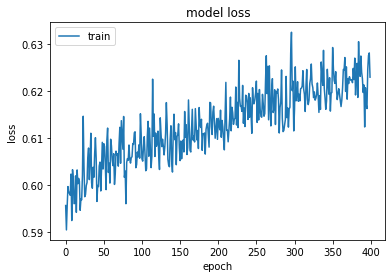

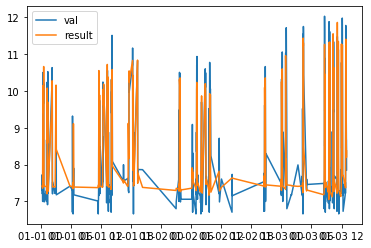

...

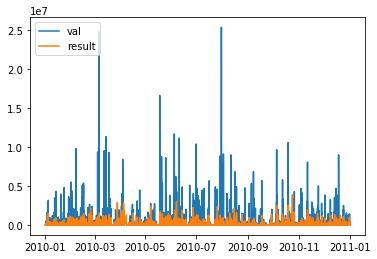

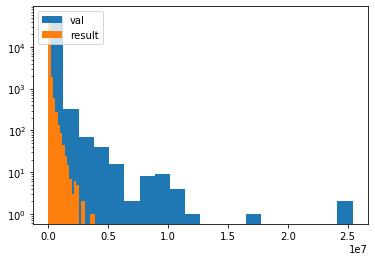

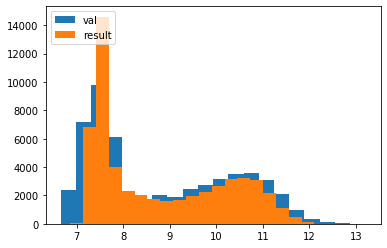

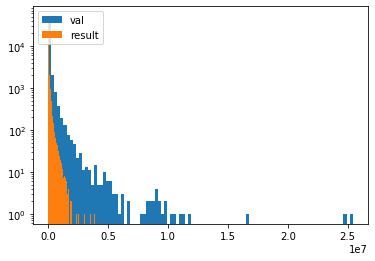

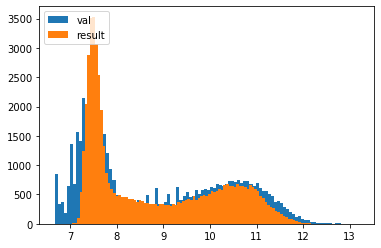

In [47]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_33"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_67 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_43 (Conv2D)              (None, 14, 8, 256)   1024        input_67[0][0]                   
__________________________________________________________________________________________________
dropout_75 (Dropout)            (None, 14, 8, 256)   0           conv2d_43[0][0]                  
__________________________________________________________________________________________________
input_68 (InputLayer)           [(None, 8)]          0                                            
___________________________________________________________________________________________

705/705 [==============================] - 56s 80ms/step - loss: 0.4352 - mse: 0.4352 - val_loss: 0.5901 - val_mse: 0.5901
Epoch 33/600
705/705 [==============================] - 56s 80ms/step - loss: 0.4347 - mse: 0.4347 - val_loss: 0.5938 - val_mse: 0.5938
Epoch 34/600
705/705 [==============================] - 56s 80ms/step - loss: 0.4323 - mse: 0.4323 - val_loss: 0.5918 - val_mse: 0.5918
Epoch 35/600
705/705 [==============================] - 56s 80ms/step - loss: 0.4309 - mse: 0.4309 - val_loss: 0.5971 - val_mse: 0.5971
Epoch 36/600
705/705 [==============================] - 56s 80ms/step - loss: 0.4300 - mse: 0.4300 - val_loss: 0.5997 - val_mse: 0.5997
Epoch 37/600
705/705 [==============================] - 56s 80ms/step - loss: 0.4281 - mse: 0.4281 - val_loss: 0.6016 - val_mse: 0.6016
Epoch 38/600
705/705 [==============================] - 56s 80ms/step - loss: 0.4263 - mse: 0.4263 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 39/600
705/705 [==============================] - 56s 8

705/705 [==============================] - 56s 80ms/step - loss: 0.3781 - mse: 0.3781 - val_loss: 0.6027 - val_mse: 0.6027
Epoch 93/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3779 - mse: 0.3779 - val_loss: 0.5953 - val_mse: 0.5953
Epoch 94/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3777 - mse: 0.3777 - val_loss: 0.6000 - val_mse: 0.6000
Epoch 95/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3776 - mse: 0.3776 - val_loss: 0.5930 - val_mse: 0.5930
Epoch 96/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3762 - mse: 0.3762 - val_loss: 0.5937 - val_mse: 0.5937
Epoch 97/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3771 - mse: 0.3771 - val_loss: 0.6037 - val_mse: 0.6037
Epoch 98/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3772 - mse: 0.3772 - val_loss: 0.6041 - val_mse: 0.6041
Epoch 99/600
705/705 [==============================] - 56s 8

Epoch 152/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3551 - mse: 0.3551 - val_loss: 0.6005 - val_mse: 0.6005
Epoch 153/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3545 - mse: 0.3545 - val_loss: 0.5952 - val_mse: 0.5952
Epoch 154/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3533 - mse: 0.3533 - val_loss: 0.6018 - val_mse: 0.6018
Epoch 155/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3536 - mse: 0.3536 - val_loss: 0.6068 - val_mse: 0.6068
Epoch 156/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3528 - mse: 0.3528 - val_loss: 0.6002 - val_mse: 0.6002
Epoch 157/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3540 - mse: 0.3540 - val_loss: 0.6006 - val_mse: 0.6006
Epoch 158/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3533 - mse: 0.3533 - val_loss: 0.6074 - val_mse: 0.6074
Epoch 159/600
705/705 [==================

Epoch 212/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3411 - mse: 0.3411 - val_loss: 0.6109 - val_mse: 0.6109
Epoch 213/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3395 - mse: 0.3395 - val_loss: 0.6064 - val_mse: 0.6064
Epoch 214/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3403 - mse: 0.3403 - val_loss: 0.6130 - val_mse: 0.6130
Epoch 215/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3404 - mse: 0.3404 - val_loss: 0.6045 - val_mse: 0.6045
Epoch 216/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3388 - mse: 0.3388 - val_loss: 0.6105 - val_mse: 0.6105
Epoch 217/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3389 - mse: 0.3389 - val_loss: 0.6168 - val_mse: 0.6168
Epoch 218/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3395 - mse: 0.3395 - val_loss: 0.6225 - val_mse: 0.6225
Epoch 219/600
705/705 [==================

Epoch 272/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3288 - mse: 0.3288 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 273/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3281 - mse: 0.3281 - val_loss: 0.6096 - val_mse: 0.6096
Epoch 274/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3306 - mse: 0.3306 - val_loss: 0.6138 - val_mse: 0.6138
Epoch 275/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3297 - mse: 0.3297 - val_loss: 0.6088 - val_mse: 0.6088
Epoch 276/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3289 - mse: 0.3289 - val_loss: 0.6076 - val_mse: 0.6076
Epoch 277/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3288 - mse: 0.3288 - val_loss: 0.6117 - val_mse: 0.6117
Epoch 278/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3283 - mse: 0.3283 - val_loss: 0.6082 - val_mse: 0.6082
Epoch 279/600
705/705 [==================

Epoch 332/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3215 - mse: 0.3215 - val_loss: 0.6166 - val_mse: 0.6166
Epoch 333/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3211 - mse: 0.3211 - val_loss: 0.6120 - val_mse: 0.6120
Epoch 334/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3223 - mse: 0.3223 - val_loss: 0.6191 - val_mse: 0.6191
Epoch 335/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3208 - mse: 0.3208 - val_loss: 0.6205 - val_mse: 0.6205
Epoch 336/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3205 - mse: 0.3205 - val_loss: 0.6193 - val_mse: 0.6193
Epoch 337/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3197 - mse: 0.3197 - val_loss: 0.6193 - val_mse: 0.6193
Epoch 338/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3206 - mse: 0.3206 - val_loss: 0.6133 - val_mse: 0.6133
Epoch 339/600
705/705 [==================

Epoch 392/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3171 - mse: 0.3171 - val_loss: 0.6189 - val_mse: 0.6189
Epoch 393/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3153 - mse: 0.3153 - val_loss: 0.6183 - val_mse: 0.6183
Epoch 394/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3150 - mse: 0.3150 - val_loss: 0.6190 - val_mse: 0.6190
Epoch 395/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3147 - mse: 0.3147 - val_loss: 0.6202 - val_mse: 0.6202
Epoch 396/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3153 - mse: 0.3153 - val_loss: 0.6207 - val_mse: 0.6207
Epoch 397/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3146 - mse: 0.3146 - val_loss: 0.6188 - val_mse: 0.6188
Epoch 398/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3148 - mse: 0.3148 - val_loss: 0.6209 - val_mse: 0.6209
Epoch 399/600
705/705 [==================

Epoch 452/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3101 - mse: 0.3101 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 453/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3103 - mse: 0.3103 - val_loss: 0.6201 - val_mse: 0.6201
Epoch 454/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3106 - mse: 0.3106 - val_loss: 0.6249 - val_mse: 0.6249
Epoch 455/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3104 - mse: 0.3104 - val_loss: 0.6267 - val_mse: 0.6267
Epoch 456/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3094 - mse: 0.3094 - val_loss: 0.6272 - val_mse: 0.6272
Epoch 457/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3092 - mse: 0.3092 - val_loss: 0.6181 - val_mse: 0.6181
Epoch 458/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3093 - mse: 0.3093 - val_loss: 0.6216 - val_mse: 0.6216
Epoch 459/600
705/705 [==================

Epoch 512/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3054 - mse: 0.3054 - val_loss: 0.6390 - val_mse: 0.6390
Epoch 513/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3063 - mse: 0.3063 - val_loss: 0.6274 - val_mse: 0.6274
Epoch 514/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3058 - mse: 0.3058 - val_loss: 0.6272 - val_mse: 0.6272
Epoch 515/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3054 - mse: 0.3054 - val_loss: 0.6209 - val_mse: 0.6209
Epoch 516/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3059 - mse: 0.3059 - val_loss: 0.6317 - val_mse: 0.6317
Epoch 517/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3056 - mse: 0.3056 - val_loss: 0.6227 - val_mse: 0.6227
Epoch 518/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3053 - mse: 0.3053 - val_loss: 0.6243 - val_mse: 0.6243
Epoch 519/600
705/705 [==================

Epoch 572/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3016 - mse: 0.3016 - val_loss: 0.6323 - val_mse: 0.6323
Epoch 573/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3024 - mse: 0.3024 - val_loss: 0.6276 - val_mse: 0.6276
Epoch 574/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3009 - mse: 0.3009 - val_loss: 0.6275 - val_mse: 0.6275
Epoch 575/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3015 - mse: 0.3015 - val_loss: 0.6313 - val_mse: 0.6313
Epoch 576/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3018 - mse: 0.3018 - val_loss: 0.6263 - val_mse: 0.6263
Epoch 577/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3012 - mse: 0.3012 - val_loss: 0.6319 - val_mse: 0.6319
Epoch 578/600
705/705 [==============================] - 56s 80ms/step - loss: 0.3016 - mse: 0.3016 - val_loss: 0.6388 - val_mse: 0.6388
Epoch 579/600
705/705 [==================

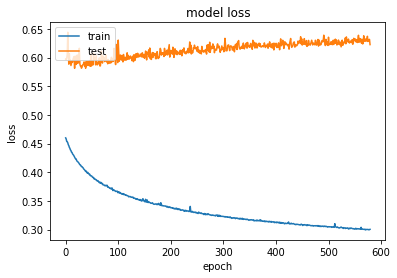

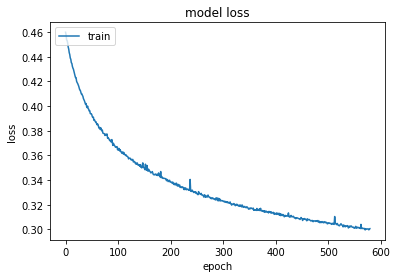

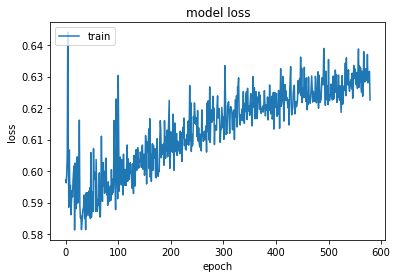

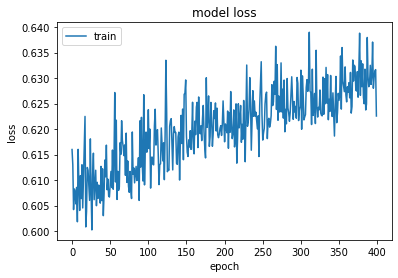

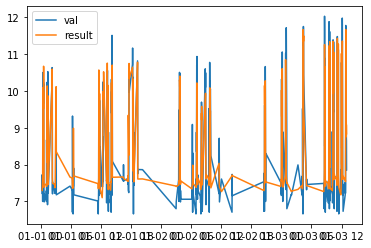

...

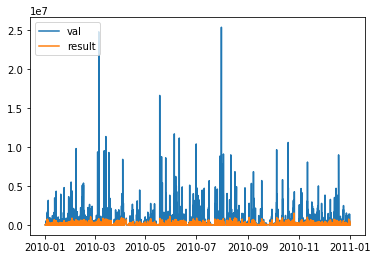

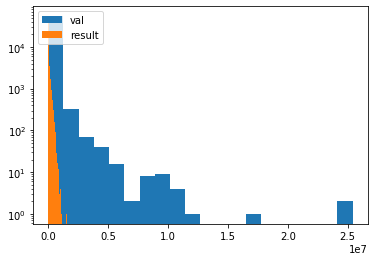

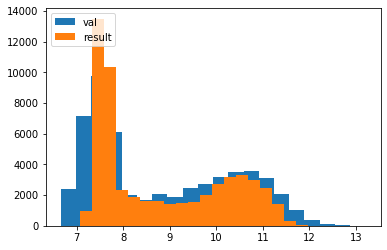

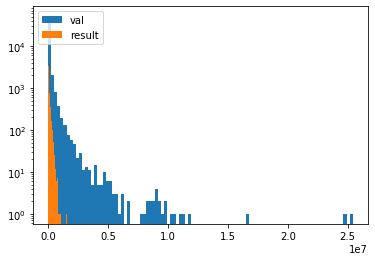

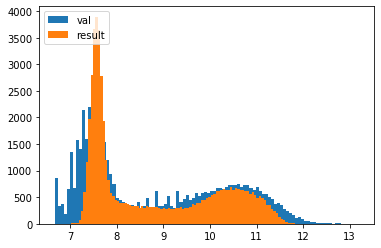

In [49]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,3), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(1,4), activation='relu')(model1)
# model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)

plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


In [6]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='sigmoid')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='sigmoid')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='sigmoid')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='sigmoid')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='sigmoid')(merged)
merged = Dense(16, activation='sigmoid')(merged)
merged = Dense(4, activation='sigmoid')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 14, 1, 256)   2816        input_1[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout (Dropout)               (None, 14, 1, 256)   0           conv2d[0][0]                     
______________________________________________________________________________________________

Epoch 34/600
705/705 [==============================] - 7s 10ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3723 - val_mse: 2.3723
Epoch 35/600
705/705 [==============================] - 8s 11ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3696 - val_mse: 2.3696
Epoch 36/600
705/705 [==============================] - 8s 11ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3687 - val_mse: 2.3687
Epoch 37/600
705/705 [==============================] - 7s 10ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3667 - val_mse: 2.3667
Epoch 38/600
705/705 [==============================] - 8s 11ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3730 - val_mse: 2.3730
Epoch 39/600
705/705 [==============================] - 7s 10ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3715 - val_mse: 2.3715
Epoch 40/600
705/705 [==============================] - 7s 9ms/step - loss: 1.6292 - mse: 1.6292 - val_loss: 2.3718 - val_mse: 2.3718
Epoch 41/600
705/705 [==============================] - 

Epoch 95/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4695 - mse: 0.4695 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 96/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4681 - mse: 0.4681 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 97/600
705/705 [==============================] - 7s 11ms/step - loss: 0.4668 - mse: 0.4668 - val_loss: 0.5844 - val_mse: 0.5844
Epoch 98/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 0.5833 - val_mse: 0.5833
Epoch 99/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4641 - mse: 0.4641 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 100/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4627 - mse: 0.4627 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 101/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4620 - mse: 0.4620 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 102/600
705/705 [==============================

705/705 [==============================] - 7s 10ms/step - loss: 0.4209 - mse: 0.4209 - val_loss: 0.5690 - val_mse: 0.5690
Epoch 156/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4195 - mse: 0.4195 - val_loss: 0.5710 - val_mse: 0.5710
Epoch 157/600
705/705 [==============================] - 7s 11ms/step - loss: 0.4199 - mse: 0.4199 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 158/600
705/705 [==============================] - 7s 11ms/step - loss: 0.4196 - mse: 0.4196 - val_loss: 0.5704 - val_mse: 0.5704
Epoch 159/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 160/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4183 - mse: 0.4183 - val_loss: 0.5727 - val_mse: 0.5727
Epoch 161/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4185 - mse: 0.4185 - val_loss: 0.5730 - val_mse: 0.5730
Epoch 162/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.4020 - mse: 0.4020 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 216/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4020 - mse: 0.4020 - val_loss: 0.5711 - val_mse: 0.5711
Epoch 217/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4014 - mse: 0.4014 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 218/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4006 - mse: 0.4006 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 219/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4007 - mse: 0.4007 - val_loss: 0.5715 - val_mse: 0.5715
Epoch 220/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4012 - mse: 0.4012 - val_loss: 0.5740 - val_mse: 0.5740
Epoch 221/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4014 - mse: 0.4014 - val_loss: 0.5741 - val_mse: 0.5741
Epoch 222/600
705/705 [==============================] - 7s 10m

705/705 [==============================] - 7s 9ms/step - loss: 0.3925 - mse: 0.3925 - val_loss: 0.5741 - val_mse: 0.5741
Epoch 276/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3936 - mse: 0.3936 - val_loss: 0.5755 - val_mse: 0.5755
Epoch 277/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3920 - mse: 0.3920 - val_loss: 0.5734 - val_mse: 0.5734
Epoch 278/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3935 - mse: 0.3935 - val_loss: 0.5729 - val_mse: 0.5729
Epoch 279/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3926 - mse: 0.3926 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 280/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3928 - mse: 0.3928 - val_loss: 0.5737 - val_mse: 0.5737
Epoch 281/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3923 - mse: 0.3923 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 282/600
705/705 [==============================] - 7s 9ms/step 

705/705 [==============================] - 7s 10ms/step - loss: 0.3865 - mse: 0.3865 - val_loss: 0.5739 - val_mse: 0.5739
Epoch 336/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3868 - mse: 0.3868 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 337/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3868 - mse: 0.3868 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 338/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3871 - mse: 0.3871 - val_loss: 0.5731 - val_mse: 0.5731
Epoch 339/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3866 - mse: 0.3866 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 340/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3861 - mse: 0.3861 - val_loss: 0.5742 - val_mse: 0.5742
Epoch 341/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3856 - mse: 0.3856 - val_loss: 0.5756 - val_mse: 0.5756
Epoch 342/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 9ms/step - loss: 0.3821 - mse: 0.3821 - val_loss: 0.5811 - val_mse: 0.5811
Epoch 396/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3821 - mse: 0.3821 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 397/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3832 - mse: 0.3832 - val_loss: 0.5831 - val_mse: 0.5831
Epoch 398/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3821 - mse: 0.3821 - val_loss: 0.5777 - val_mse: 0.5777
Epoch 399/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3820 - mse: 0.3820 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 400/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3819 - mse: 0.3819 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 401/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3819 - mse: 0.3819 - val_loss: 0.5787 - val_mse: 0.5787
Epoch 402/600
705/705 [==============================] - 7s 10ms/st

705/705 [==============================] - 7s 10ms/step - loss: 0.3796 - mse: 0.3796 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 456/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3783 - mse: 0.3783 - val_loss: 0.5802 - val_mse: 0.5802
Epoch 457/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3789 - mse: 0.3789 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 458/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3787 - mse: 0.3787 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 459/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3787 - mse: 0.3787 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 460/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3796 - mse: 0.3796 - val_loss: 0.5813 - val_mse: 0.5813
Epoch 461/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3786 - mse: 0.3786 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 462/600
705/705 [==============================] - 6s 9ms/ste

705/705 [==============================] - 7s 10ms/step - loss: 0.3760 - mse: 0.3760 - val_loss: 0.5823 - val_mse: 0.5823
Epoch 516/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3761 - mse: 0.3761 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 517/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3762 - mse: 0.3762 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 518/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3763 - mse: 0.3763 - val_loss: 0.5817 - val_mse: 0.5817
Epoch 519/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3760 - mse: 0.3760 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 520/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3762 - mse: 0.3762 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 521/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3750 - mse: 0.3750 - val_loss: 0.5841 - val_mse: 0.5841
Epoch 522/600
705/705 [==============================] - 7s 10

KeyboardInterrupt: 

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 14, 1, 256)   2816        input_3[0][0]                    
__________________________________________________________________________________________________
input_4 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_3 (Dropout)             (None, 14, 1, 256)   0           conv2d_2[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 6s 9ms/step - loss: 0.4695 - mse: 0.4695 - val_loss: 0.6006 - val_mse: 0.6006
Epoch 35/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4704 - mse: 0.4704 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 36/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4687 - mse: 0.4687 - val_loss: 0.5954 - val_mse: 0.5954
Epoch 37/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4686 - mse: 0.4686 - val_loss: 0.5905 - val_mse: 0.5905
Epoch 38/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4685 - mse: 0.4685 - val_loss: 0.5991 - val_mse: 0.5991
Epoch 39/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4672 - mse: 0.4672 - val_loss: 0.5878 - val_mse: 0.5878
Epoch 40/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 0.6132 - val_mse: 0.6132
Epoch 41/300
705/705 [==============================] - 6s 9ms/step - loss:

705/705 [==============================] - 6s 9ms/step - loss: 0.4401 - mse: 0.4401 - val_loss: 0.5976 - val_mse: 0.5976
Epoch 96/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4402 - mse: 0.4402 - val_loss: 0.5830 - val_mse: 0.5830
Epoch 97/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4404 - mse: 0.4404 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 98/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4395 - mse: 0.4395 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 99/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4395 - mse: 0.4395 - val_loss: 0.5865 - val_mse: 0.5865
Epoch 100/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4389 - mse: 0.4389 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 101/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4392 - mse: 0.4392 - val_loss: 0.5960 - val_mse: 0.5960
Epoch 102/300
705/705 [==============================] - 6s 9ms/step - lo

705/705 [==============================] - 7s 10ms/step - loss: 0.4309 - mse: 0.4309 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 156/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4300 - mse: 0.4300 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 157/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5902 - val_mse: 0.5902
Epoch 158/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4302 - mse: 0.4302 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 159/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 160/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4291 - mse: 0.4291 - val_loss: 0.5891 - val_mse: 0.5891
Epoch 161/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4290 - mse: 0.4290 - val_loss: 0.5831 - val_mse: 0.5831
Epoch 162/300
705/705 [==============================] - 7s 9ms

705/705 [==============================] - 7s 9ms/step - loss: 0.4166 - mse: 0.4166 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 216/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4158 - mse: 0.4158 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 217/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4152 - mse: 0.4152 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 218/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4146 - mse: 0.4146 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 219/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4164 - mse: 0.4164 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 220/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4161 - mse: 0.4161 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 221/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4156 - mse: 0.4156 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 222/300
705/705 [==============================] - 7s 10ms

705/705 [==============================] - 6s 9ms/step - loss: 0.4097 - mse: 0.4097 - val_loss: 0.5920 - val_mse: 0.5920
Epoch 276/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5811 - val_mse: 0.5811
Epoch 277/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 278/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4084 - mse: 0.4084 - val_loss: 0.5832 - val_mse: 0.5832
Epoch 279/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4078 - mse: 0.4078 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 280/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4092 - mse: 0.4092 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 281/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4090 - mse: 0.4090 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 282/300
705/705 [==============================] - 7s 9ms/step

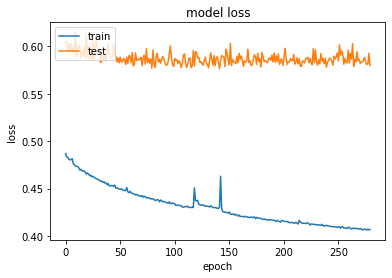

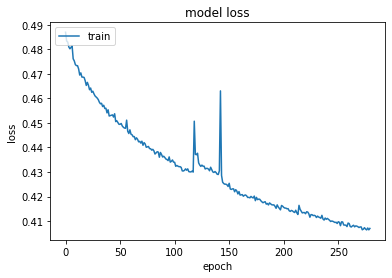

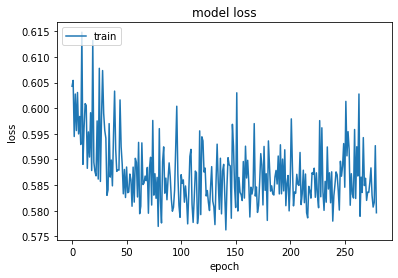

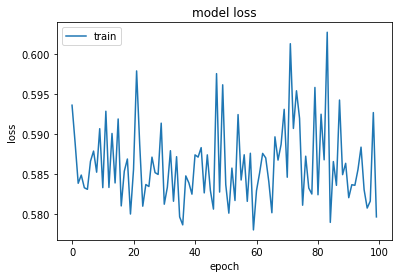

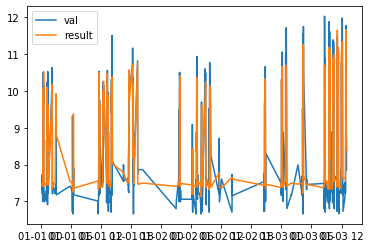

...

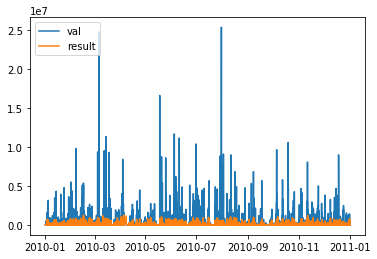

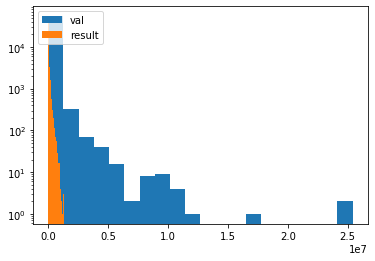

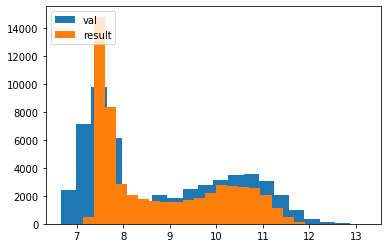

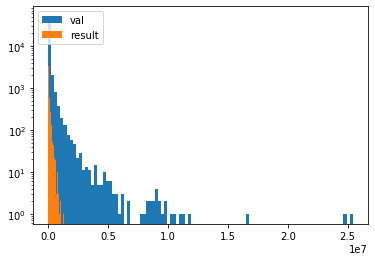

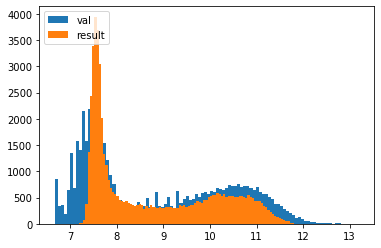

In [7]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1,activation='relu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_4 (Conv2D)               (None, 14, 1, 256)   2816        input_5[0][0]                    
__________________________________________________________________________________________________
input_6 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_6 (Dropout)             (None, 14, 1, 256)   0           conv2d_4[0][0]                   
____________________________________________________________________________________________

Epoch 34/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4723 - mse: 0.4723 - val_loss: 0.5991 - val_mse: 0.5991
Epoch 35/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4711 - mse: 0.4711 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 36/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4695 - mse: 0.4695 - val_loss: 0.5985 - val_mse: 0.5985
Epoch 37/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4701 - mse: 0.4701 - val_loss: 0.5992 - val_mse: 0.5992
Epoch 38/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4701 - mse: 0.4701 - val_loss: 0.5977 - val_mse: 0.5977
Epoch 39/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4686 - mse: 0.4686 - val_loss: 0.6206 - val_mse: 0.6206
Epoch 40/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4670 - mse: 0.4670 - val_loss: 0.6150 - val_mse: 0.6150
Epoch 41/300
705/705 [==============================] - 7s 1

Epoch 95/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4411 - mse: 0.4411 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 96/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4412 - mse: 0.4412 - val_loss: 0.5859 - val_mse: 0.5859
Epoch 97/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4394 - mse: 0.4394 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 98/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4402 - mse: 0.4402 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 99/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4387 - mse: 0.4387 - val_loss: 0.5815 - val_mse: 0.5815
Epoch 100/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4390 - mse: 0.4390 - val_loss: 0.5792 - val_mse: 0.5792
Epoch 101/300
705/705 [==============================] - 6s 9ms/step - loss: 0.4385 - mse: 0.4385 - val_loss: 0.5719 - val_mse: 0.5719
Epoch 102/300
705/705 [==============================] - 6s

705/705 [==============================] - 7s 10ms/step - loss: 0.4262 - mse: 0.4262 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 156/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4266 - mse: 0.4266 - val_loss: 0.5917 - val_mse: 0.5917
Epoch 157/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4259 - mse: 0.4259 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 158/300
705/705 [==============================] - 8s 11ms/step - loss: 0.4269 - mse: 0.4269 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 159/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4266 - mse: 0.4266 - val_loss: 0.5823 - val_mse: 0.5823
Epoch 160/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4265 - mse: 0.4265 - val_loss: 0.5751 - val_mse: 0.5751
Epoch 161/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4253 - mse: 0.4253 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 162/300
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.4169 - mse: 0.4169 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 216/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4165 - mse: 0.4165 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 217/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4170 - mse: 0.4170 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 218/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4167 - mse: 0.4167 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 219/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5729 - val_mse: 0.5729
Epoch 220/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4168 - mse: 0.4168 - val_loss: 0.5821 - val_mse: 0.5821
Epoch 221/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4156 - mse: 0.4156 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 222/300
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 9ms/step - loss: 0.4103 - mse: 0.4103 - val_loss: 0.5775 - val_mse: 0.5775
Epoch 276/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4105 - mse: 0.4105 - val_loss: 0.5770 - val_mse: 0.5770
Epoch 277/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4099 - mse: 0.4099 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 278/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4098 - mse: 0.4098 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 279/300
705/705 [==============================] - 7s 9ms/step - loss: 0.4107 - mse: 0.4107 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 280/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4099 - mse: 0.4099 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 281/300
705/705 [==============================] - 7s 10ms/step - loss: 0.4097 - mse: 0.4097 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 282/300
705/705 [==============================] - 7s 10ms

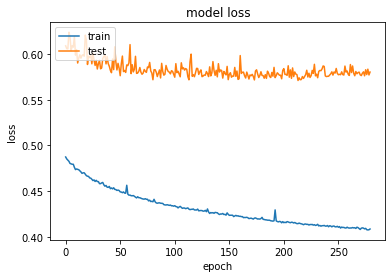

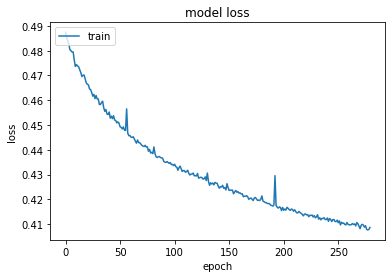

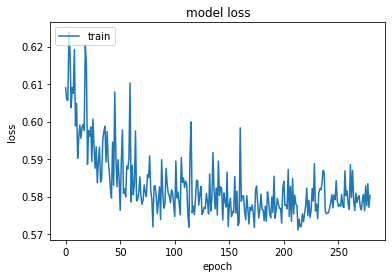

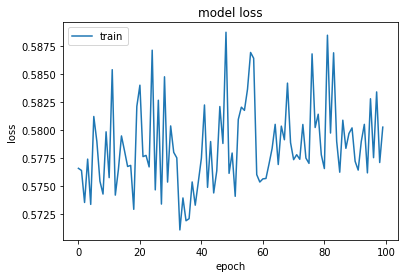

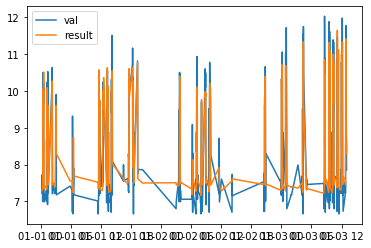

...

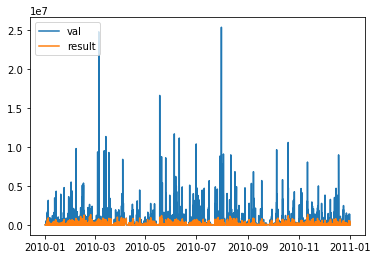

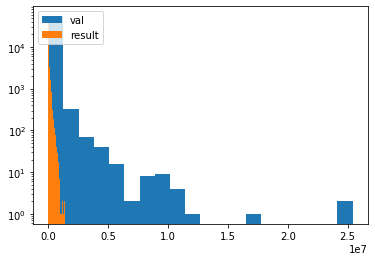

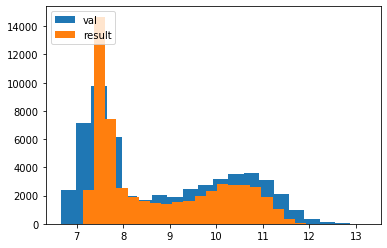

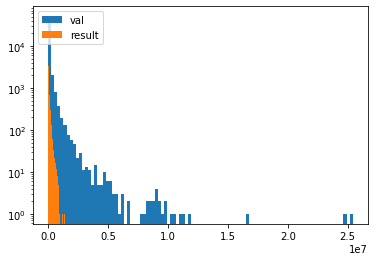

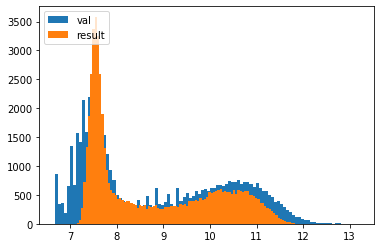

In [8]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1,activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


In [10]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1,activation='tanh')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_8 (Conv2D)               (None, 14, 1, 256)   2816        input_9[0][0]                    
__________________________________________________________________________________________________
input_10 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_12 (Dropout)            (None, 14, 1, 256)   0           conv2d_8[0][0]                   
____________________________________________________________________________________________

KeyboardInterrupt: 

In [12]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1,activation='exponential')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=300)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 14, 1, 256)   2816        input_13[0][0]                   
__________________________________________________________________________________________________
input_14 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_18 (Dropout)            (None, 14, 1, 256)   0           conv2d_12[0][0]                  
____________________________________________________________________________________________

KeyboardInterrupt: 

In [13]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='exponential')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='exponential')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='exponential')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='exponential')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='exponential')(merged)
merged = Dense(16, activation='exponential')(merged)
merged = Dense(4, activation='exponential')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_14 (Conv2D)              (None, 14, 1, 256)   2816        input_15[0][0]                   
__________________________________________________________________________________________________
input_16 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_21 (Dropout)            (None, 14, 1, 256)   0           conv2d_14[0][0]                  
____________________________________________________________________________________________

KeyboardInterrupt: 

In [14]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='elu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_17 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_16 (Conv2D)              (None, 14, 1, 256)   2816        input_17[0][0]                   
__________________________________________________________________________________________________
input_18 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_24 (Dropout)            (None, 14, 1, 256)   0           conv2d_16[0][0]                  
____________________________________________________________________________________________

Epoch 34/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4402 - mse: 0.4402 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 35/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4392 - mse: 0.4392 - val_loss: 0.5913 - val_mse: 0.5913
Epoch 36/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4390 - mse: 0.4390 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 37/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4378 - mse: 0.4378 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 38/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4401 - mse: 0.4401 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 39/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4357 - mse: 0.4357 - val_loss: 0.5832 - val_mse: 0.5832
Epoch 40/600
705/705 [==============================] - 7s 10ms/step - loss: 0.5317 - mse: 0.5317 - val_loss: 0.5745 - val_mse: 0.5745
Epoch 41/600
705/705 [==============================] - 

Epoch 95/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4253 - mse: 0.4253 - val_loss: 0.5797 - val_mse: 0.5797
Epoch 96/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4271 - mse: 0.4271 - val_loss: 0.5708 - val_mse: 0.5708
Epoch 97/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4251 - mse: 0.4251 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 98/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4227 - mse: 0.4227 - val_loss: 0.5712 - val_mse: 0.5712
Epoch 99/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4230 - mse: 0.4230 - val_loss: 0.5716 - val_mse: 0.5716
Epoch 100/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4220 - mse: 0.4220 - val_loss: 0.5713 - val_mse: 0.5713
Epoch 101/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4218 - mse: 0.4218 - val_loss: 0.5699 - val_mse: 0.5699
Epoch 102/600
705/705 [==============================

KeyboardInterrupt: 

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, 14, 1, 256)   2816        input_19[0][0]                   
__________________________________________________________________________________________________
input_20 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_27 (Dropout)            (None, 14, 1, 256)   0           conv2d_18[0][0]                  
____________________________________________________________________________________________

Epoch 34/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4401 - mse: 0.4401 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 35/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4403 - mse: 0.4403 - val_loss: 0.5824 - val_mse: 0.5824
Epoch 36/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4400 - mse: 0.4400 - val_loss: 0.5746 - val_mse: 0.5746
Epoch 37/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4400 - mse: 0.4400 - val_loss: 0.5745 - val_mse: 0.5745
Epoch 38/100
705/705 [==============================] - 7s 11ms/step - loss: 0.4376 - mse: 0.4376 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 39/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4371 - mse: 0.4371 - val_loss: 0.5744 - val_mse: 0.5744
Epoch 40/100
705/705 [==============================] - 7s 11ms/step - loss: 0.4357 - mse: 0.4357 - val_loss: 0.5801 - val_mse: 0.5801
Epoch 41/100
705/705 [==============================] -

Epoch 95/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4193 - mse: 0.4193 - val_loss: 0.5787 - val_mse: 0.5787
Epoch 96/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4174 - mse: 0.4174 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 97/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4235 - mse: 0.4235 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 98/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4176 - mse: 0.4176 - val_loss: 0.5702 - val_mse: 0.5702
Epoch 99/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4171 - mse: 0.4171 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 100/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4182 - mse: 0.4182 - val_loss: 0.5757 - val_mse: 0.5757


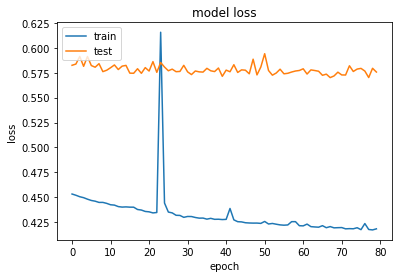

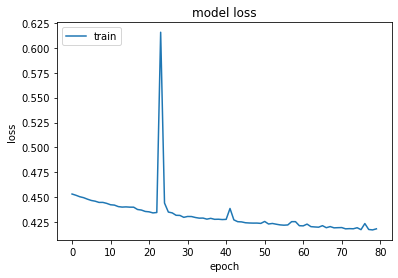

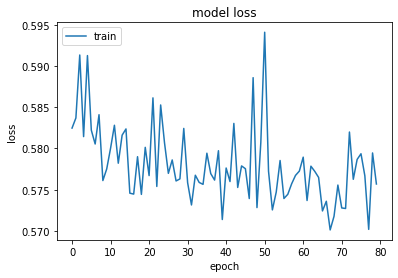

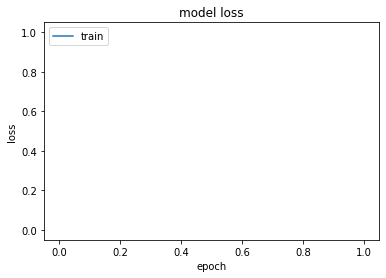

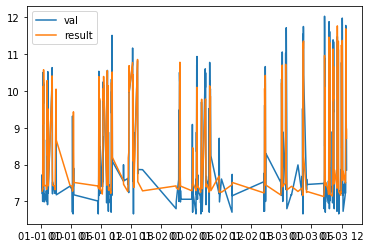

...

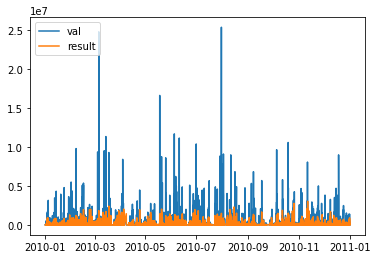

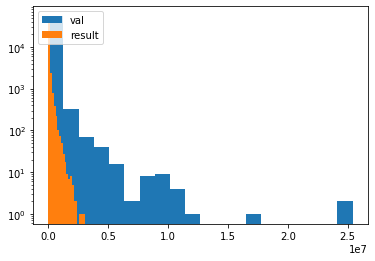

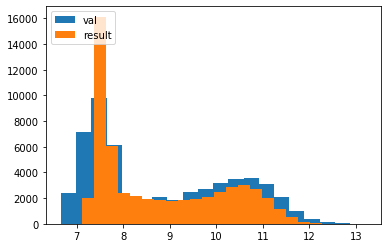

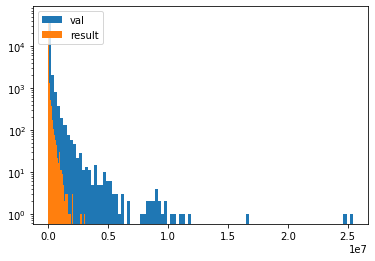

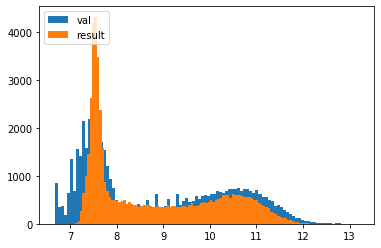

In [15]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='elu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 14, 1, 256)   2816        input_21[0][0]                   
__________________________________________________________________________________________________
input_22 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_30 (Dropout)            (None, 14, 1, 256)   0           conv2d_20[0][0]                  
___________________________________________________________________________________________

Epoch 34/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4543 - mse: 0.4543 - val_loss: 0.5977 - val_mse: 0.5977
Epoch 35/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4544 - mse: 0.4544 - val_loss: 0.6038 - val_mse: 0.6038
Epoch 36/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4530 - mse: 0.4530 - val_loss: 0.5999 - val_mse: 0.5999
Epoch 37/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4528 - mse: 0.4528 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 38/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4518 - mse: 0.4518 - val_loss: 0.5913 - val_mse: 0.5913
Epoch 39/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4509 - mse: 0.4509 - val_loss: 0.5922 - val_mse: 0.5922
Epoch 40/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4506 - mse: 0.4506 - val_loss: 0.5954 - val_mse: 0.5954
Epoch 41/100
705/705 [==============================] - 7

Epoch 95/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4372 - mse: 0.4372 - val_loss: 0.5946 - val_mse: 0.5946
Epoch 96/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4376 - mse: 0.4376 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 97/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4364 - mse: 0.4364 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 98/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4365 - mse: 0.4365 - val_loss: 0.5980 - val_mse: 0.5980
Epoch 99/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4365 - mse: 0.4365 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 100/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4358 - mse: 0.4358 - val_loss: 0.5885 - val_mse: 0.5885


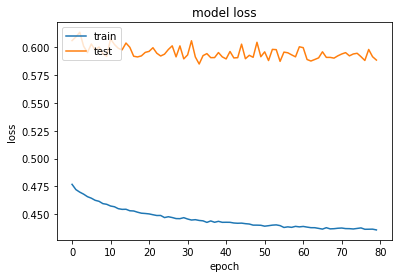

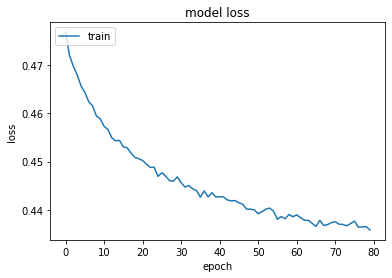

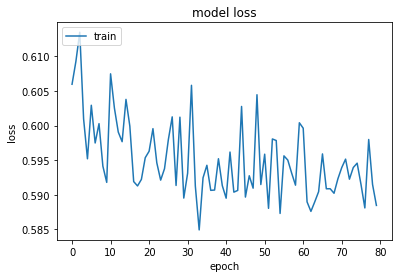

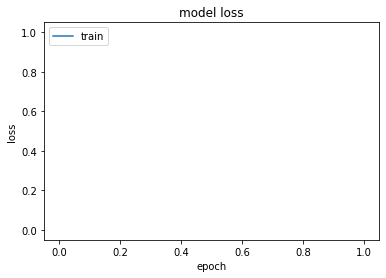

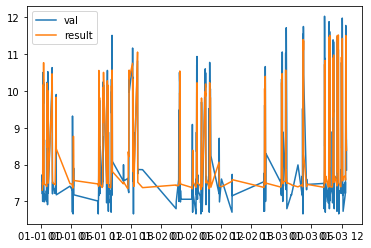

...

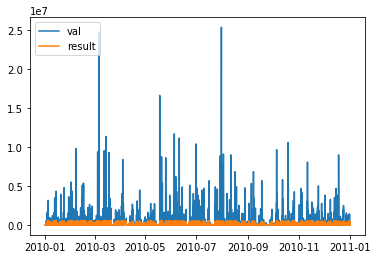

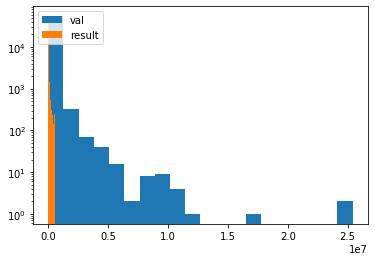

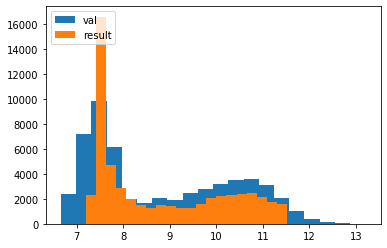

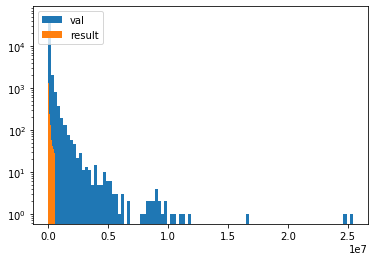

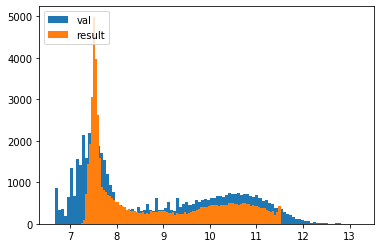

In [16]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='tanh')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='tanh')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='tanh')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='tanh')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='tanh')(merged)
merged = Dense(16, activation='tanh')(merged)
merged = Dense(4, activation='tanh')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_23 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_22 (Conv2D)              (None, 14, 1, 256)   2816        input_23[0][0]                   
__________________________________________________________________________________________________
input_24 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_33 (Dropout)            (None, 14, 1, 256)   0           conv2d_22[0][0]                  
___________________________________________________________________________________________

Epoch 34/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4391 - mse: 0.4391 - val_loss: 0.5750 - val_mse: 0.5750
Epoch 35/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4387 - mse: 0.4387 - val_loss: 0.5795 - val_mse: 0.5795
Epoch 36/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4381 - mse: 0.4381 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 37/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4375 - mse: 0.4375 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 38/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4365 - mse: 0.4365 - val_loss: 0.5852 - val_mse: 0.5852
Epoch 39/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4355 - mse: 0.4355 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 40/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4352 - mse: 0.4352 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 41/100
705/705 [==============================] -

Epoch 95/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4190 - mse: 0.4190 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 96/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4185 - mse: 0.4185 - val_loss: 0.5690 - val_mse: 0.5690
Epoch 97/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4173 - mse: 0.4173 - val_loss: 0.5679 - val_mse: 0.5679
Epoch 98/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4168 - mse: 0.4168 - val_loss: 0.5671 - val_mse: 0.5671
Epoch 99/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4172 - mse: 0.4172 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 100/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4170 - mse: 0.4170 - val_loss: 0.5674 - val_mse: 0.5674


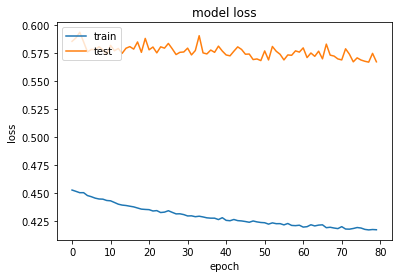

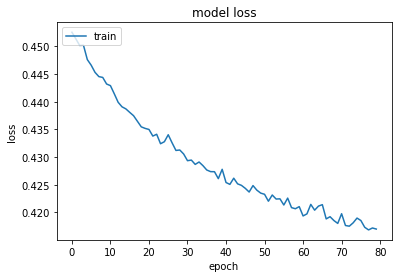

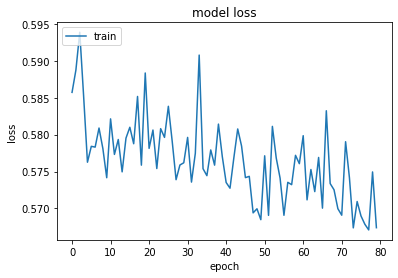

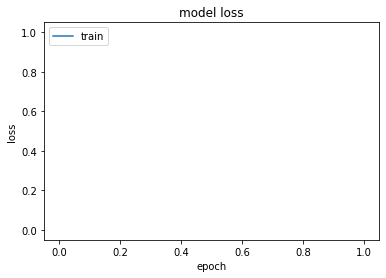

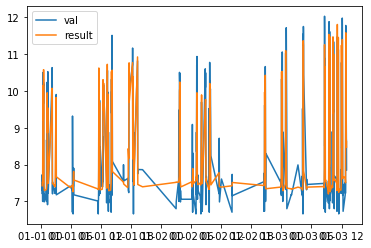

...

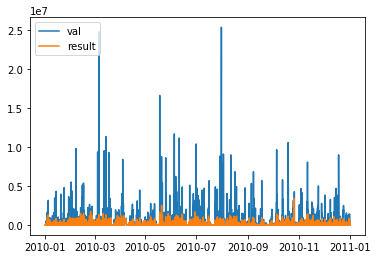

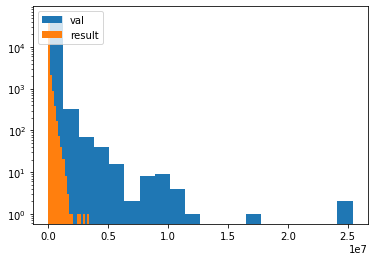

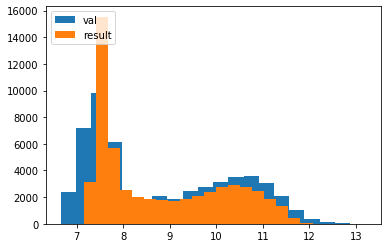

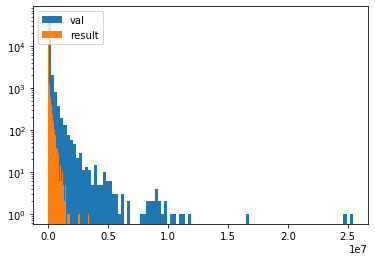

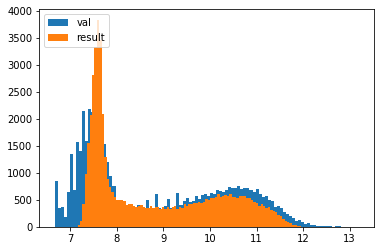

In [17]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='elu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_25 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_24 (Conv2D)              (None, 14, 1, 256)   2816        input_25[0][0]                   
__________________________________________________________________________________________________
input_26 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_36 (Dropout)            (None, 14, 1, 256)   0           conv2d_24[0][0]                  
___________________________________________________________________________________________

705/705 [==============================] - 7s 9ms/step - loss: 0.4407 - mse: 0.4407 - val_loss: 0.5696 - val_mse: 0.5696
Epoch 35/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4396 - mse: 0.4396 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 36/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4391 - mse: 0.4391 - val_loss: 0.5717 - val_mse: 0.5717
Epoch 37/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4386 - mse: 0.4386 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 38/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4381 - mse: 0.4381 - val_loss: 0.5731 - val_mse: 0.5731
Epoch 39/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4367 - mse: 0.4367 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 40/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4359 - mse: 0.4359 - val_loss: 0.5838 - val_mse: 0.5838
Epoch 41/600
705/705 [==============================] - 6s 9ms/step - loss:

705/705 [==============================] - 7s 9ms/step - loss: 0.4185 - mse: 0.4185 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 96/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4190 - mse: 0.4190 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 97/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4184 - mse: 0.4184 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 98/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4179 - mse: 0.4179 - val_loss: 0.5758 - val_mse: 0.5758
Epoch 99/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4197 - mse: 0.4197 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 100/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4174 - mse: 0.4174 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 101/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4188 - mse: 0.4188 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 102/600
705/705 [==============================] - 6s 9ms/step - lo

Epoch 156/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4095 - mse: 0.4095 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 157/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4093 - mse: 0.4093 - val_loss: 0.5754 - val_mse: 0.5754
Epoch 158/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4100 - mse: 0.4100 - val_loss: 0.5741 - val_mse: 0.5741
Epoch 159/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4104 - mse: 0.4104 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 160/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4110 - mse: 0.4110 - val_loss: 0.5751 - val_mse: 0.5751
Epoch 161/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4103 - mse: 0.4103 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 162/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4093 - mse: 0.4093 - val_loss: 0.5799 - val_mse: 0.5799
Epoch 163/600
705/705 [==============================] 

705/705 [==============================] - 7s 9ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5819 - val_mse: 0.5819
Epoch 217/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4062 - mse: 0.4062 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 218/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 219/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4056 - mse: 0.4056 - val_loss: 0.5737 - val_mse: 0.5737
Epoch 220/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4056 - mse: 0.4056 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 221/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4046 - mse: 0.4046 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 222/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4053 - mse: 0.4053 - val_loss: 0.5753 - val_mse: 0.5753
Epoch 223/600
705/705 [==============================] - 6s 9ms/step 

Epoch 277/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4019 - mse: 0.4019 - val_loss: 0.5751 - val_mse: 0.5751
Epoch 278/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4021 - mse: 0.4021 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 279/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4025 - mse: 0.4025 - val_loss: 0.5739 - val_mse: 0.5739
Epoch 280/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4013 - mse: 0.4013 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 281/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4045 - mse: 0.4045 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 282/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4023 - mse: 0.4023 - val_loss: 0.5786 - val_mse: 0.5786
Epoch 283/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4048 - mse: 0.4048 - val_loss: 0.5746 - val_mse: 0.5746
Epoch 284/600
705/705 [==============================] 

705/705 [==============================] - 7s 9ms/step - loss: 0.4005 - mse: 0.4005 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 338/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4012 - mse: 0.4012 - val_loss: 0.5748 - val_mse: 0.5748
Epoch 339/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 340/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4000 - mse: 0.4000 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 341/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4003 - mse: 0.4003 - val_loss: 0.5752 - val_mse: 0.5752
Epoch 342/600
705/705 [==============================] - 6s 9ms/step - loss: 0.4002 - mse: 0.4002 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 343/600
705/705 [==============================] - 6s 9ms/step - loss: 0.3996 - mse: 0.3996 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 344/600
705/705 [==============================] - 7s 9ms/step 

705/705 [==============================] - 7s 10ms/step - loss: 0.3984 - mse: 0.3984 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 398/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3993 - mse: 0.3993 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 399/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4017 - mse: 0.4017 - val_loss: 0.5775 - val_mse: 0.5775
Epoch 400/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3989 - mse: 0.3989 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 401/600
705/705 [==============================] - 7s 9ms/step - loss: 0.4100 - mse: 0.4100 - val_loss: 0.5783 - val_mse: 0.5783
Epoch 402/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4011 - mse: 0.4011 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 403/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3986 - mse: 0.3986 - val_loss: 0.5776 - val_mse: 0.5776
Epoch 404/600
705/705 [==============================] - 7s 10m

705/705 [==============================] - 7s 10ms/step - loss: 0.3970 - mse: 0.3970 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 458/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 459/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3956 - mse: 0.3956 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 460/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3974 - mse: 0.3974 - val_loss: 0.5793 - val_mse: 0.5793
Epoch 461/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5788 - val_mse: 0.5788
Epoch 462/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3969 - mse: 0.3969 - val_loss: 0.5809 - val_mse: 0.5809
Epoch 463/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3984 - mse: 0.3984 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 464/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.3982 - mse: 0.3982 - val_loss: 0.5820 - val_mse: 0.5820
Epoch 518/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4044 - mse: 0.4044 - val_loss: 0.5757 - val_mse: 0.5757
Epoch 519/600
705/705 [==============================] - 8s 11ms/step - loss: 0.4006 - mse: 0.4006 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 520/600
705/705 [==============================] - 7s 10ms/step - loss: 0.4010 - mse: 0.4010 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 521/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3981 - mse: 0.3981 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 522/600
705/705 [==============================] - 7s 11ms/step - loss: 0.3962 - mse: 0.3962 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 523/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3953 - mse: 0.3953 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 524/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 8s 11ms/step - loss: 0.3947 - mse: 0.3947 - val_loss: 0.5905 - val_mse: 0.5905
Epoch 578/600
705/705 [==============================] - 8s 11ms/step - loss: 0.3968 - mse: 0.3968 - val_loss: 0.5750 - val_mse: 0.5750
Epoch 579/600
705/705 [==============================] - 8s 11ms/step - loss: 0.3947 - mse: 0.3947 - val_loss: 0.5787 - val_mse: 0.5787
Epoch 580/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.5778 - val_mse: 0.5778
Epoch 581/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3957 - mse: 0.3957 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 582/600
705/705 [==============================] - 7s 10ms/step - loss: 0.3947 - mse: 0.3947 - val_loss: 0.5823 - val_mse: 0.5823
Epoch 583/600
705/705 [==============================] - 7s 9ms/step - loss: 0.3956 - mse: 0.3956 - val_loss: 0.5878 - val_mse: 0.5878
Epoch 584/600
705/705 [==============================] - 7s 9ms

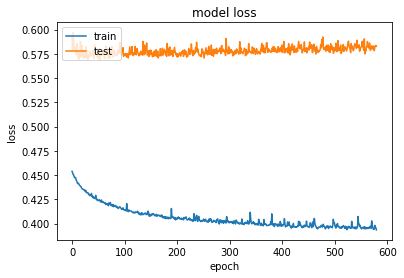

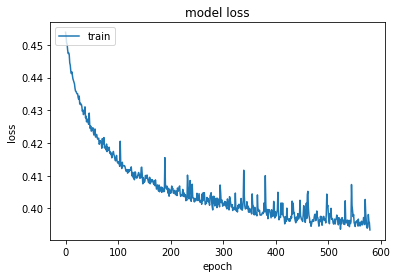

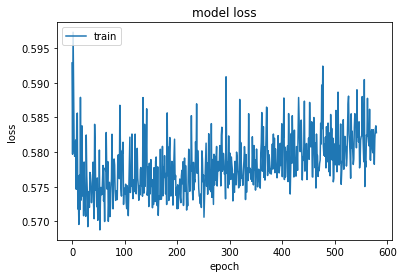

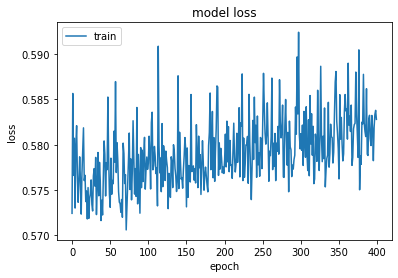

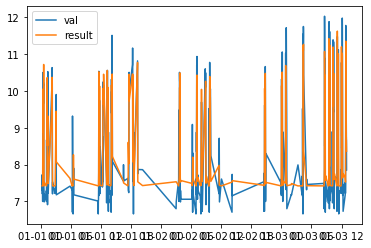

...

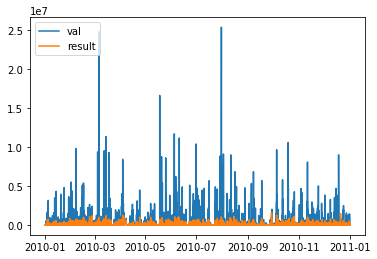

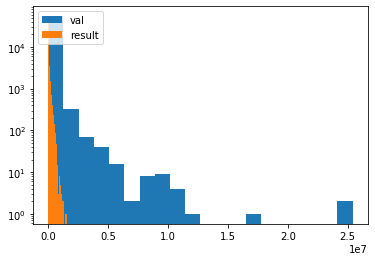

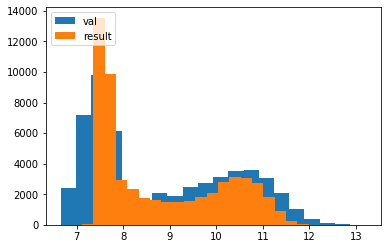

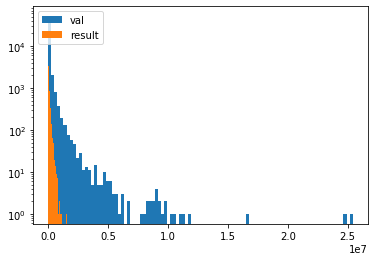

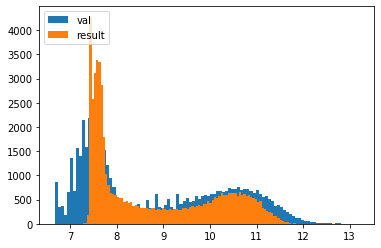

In [18]:
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='elu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 14, 1, 256)   2816        input_1[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
alpha_dropout (AlphaDropout)    (None, 14, 1, 256)   0           conv2d[0][0]                     
______________________________________________________________________________________________

Epoch 34/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4693 - mse: 0.4693 - val_loss: 1.2588 - val_mse: 1.2588
Epoch 35/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4692 - mse: 0.4692 - val_loss: 1.2602 - val_mse: 1.2602
Epoch 36/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4683 - mse: 0.4683 - val_loss: 1.1055 - val_mse: 1.1055
Epoch 37/150
705/705 [==============================] - 7s 11ms/step - loss: 0.4669 - mse: 0.4669 - val_loss: 1.1758 - val_mse: 1.1758
Epoch 38/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4646 - mse: 0.4646 - val_loss: 1.2007 - val_mse: 1.2007
Epoch 39/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4646 - mse: 0.4646 - val_loss: 1.2816 - val_mse: 1.2816
Epoch 40/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4639 - mse: 0.4639 - val_loss: 1.2931 - val_mse: 1.2931
Epoch 41/150
705/705 [==============================] -

Epoch 95/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4394 - mse: 0.4394 - val_loss: 1.1910 - val_mse: 1.1910
Epoch 96/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4386 - mse: 0.4386 - val_loss: 1.1262 - val_mse: 1.1262
Epoch 97/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4389 - mse: 0.4389 - val_loss: 1.1410 - val_mse: 1.1410
Epoch 98/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4396 - mse: 0.4396 - val_loss: 1.0311 - val_mse: 1.0311
Epoch 99/150
705/705 [==============================] - 8s 11ms/step - loss: 0.4419 - mse: 0.4419 - val_loss: 1.0079 - val_mse: 1.0079
Epoch 100/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4405 - mse: 0.4405 - val_loss: 0.9564 - val_mse: 0.9564
Epoch 101/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4393 - mse: 0.4393 - val_loss: 1.1143 - val_mse: 1.1143
Epoch 102/150
705/705 [==============================

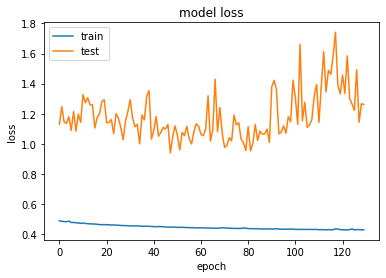

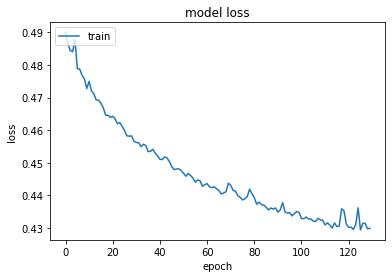

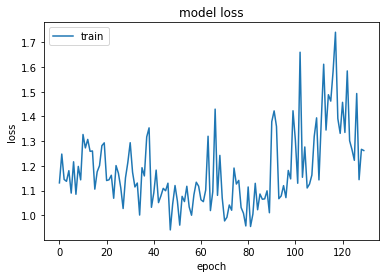

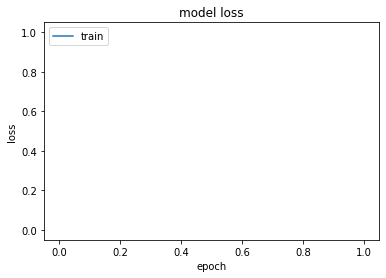

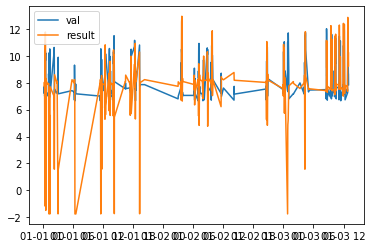

...

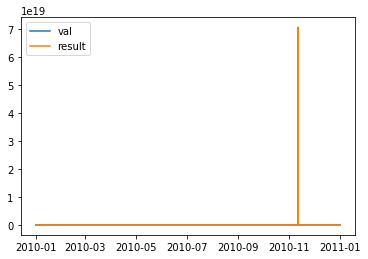

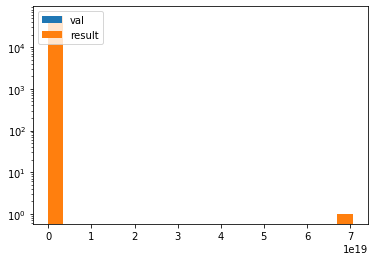

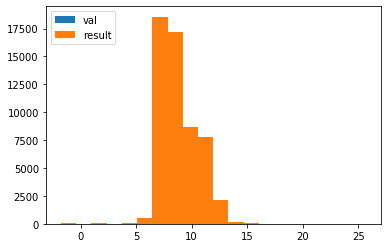

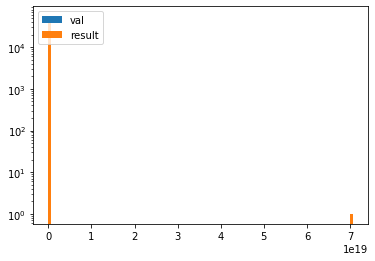

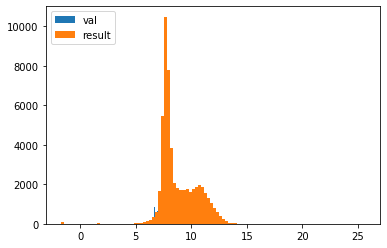

In [6]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
model1 = AlphaDropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, kernel_initializer='lecun_normal',activation='selu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(128,kernel_initializer='lecun_normal',activation='selu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(16, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(4, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal',activation='selu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=150)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


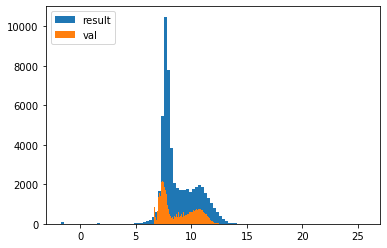

In [9]:
plt.figure()

plt.hist(df_results.values,bins=100)

plt.hist(y_val_log.values,bins=100)

plt.legend(['result', 'val'], loc='upper left')
plt.show()

Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_29 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_28 (Conv2D)              (None, 14, 1, 256)   2816        input_29[0][0]                   
__________________________________________________________________________________________________
dropout_39 (Dropout)            (None, 14, 1, 256)   0           conv2d_28[0][0]                  
__________________________________________________________________________________________________
input_30 (InputLayer)           [(None, 8)]          0                                            
___________________________________________________________________________________________

705/705 [==============================] - 7s 9ms/step - loss: 0.4567 - mse: 0.4567 - val_loss: 0.6360 - val_mse: 0.6360
Epoch 33/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4564 - mse: 0.4564 - val_loss: 0.6187 - val_mse: 0.6187
Epoch 34/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4557 - mse: 0.4557 - val_loss: 0.6160 - val_mse: 0.6160
Epoch 35/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4545 - mse: 0.4545 - val_loss: 0.6086 - val_mse: 0.6086
Epoch 36/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4531 - mse: 0.4531 - val_loss: 0.6076 - val_mse: 0.6076
Epoch 37/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4530 - mse: 0.4530 - val_loss: 0.6060 - val_mse: 0.6060
Epoch 38/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4513 - mse: 0.4513 - val_loss: 0.6098 - val_mse: 0.6098
Epoch 39/100
705/705 [==============================] - 7s 10ms/step - l

Epoch 93/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4297 - mse: 0.4297 - val_loss: 0.6046 - val_mse: 0.6046
Epoch 94/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.6166 - val_mse: 0.6166
Epoch 95/100
705/705 [==============================] - 7s 10ms/step - loss: 0.4298 - mse: 0.4298 - val_loss: 0.5994 - val_mse: 0.5994
Epoch 96/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4284 - mse: 0.4284 - val_loss: 0.6009 - val_mse: 0.6009
Epoch 97/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4290 - mse: 0.4290 - val_loss: 0.6114 - val_mse: 0.6114
Epoch 98/100
705/705 [==============================] - 7s 9ms/step - loss: 0.4291 - mse: 0.4291 - val_loss: 0.6096 - val_mse: 0.6096
Epoch 99/100
705/705 [==============================] - 6s 9ms/step - loss: 0.4274 - mse: 0.4274 - val_loss: 0.6154 - val_mse: 0.6154
Epoch 100/100
705/705 [==============================] - 7s 

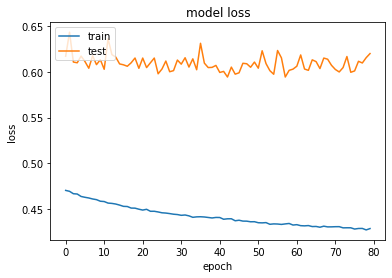

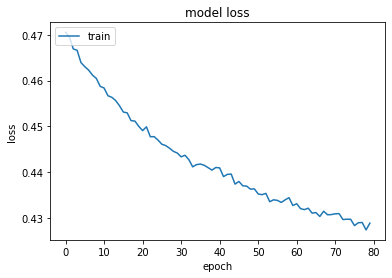

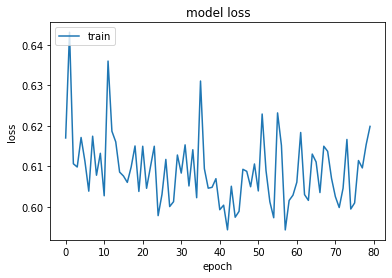

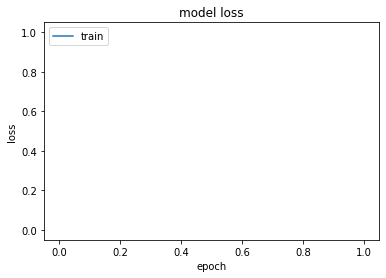

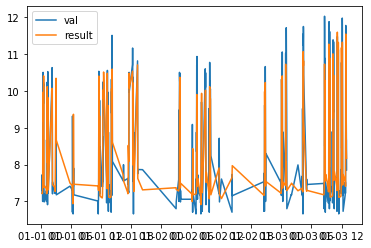

...

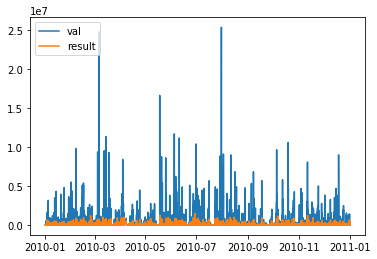

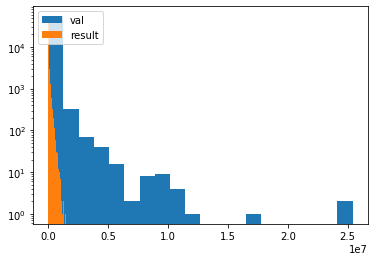

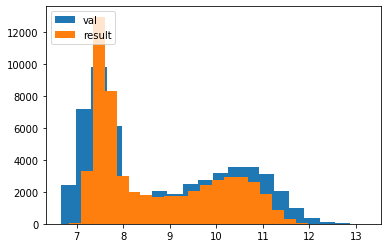

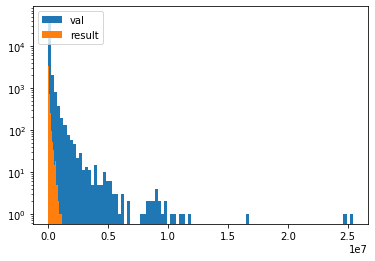

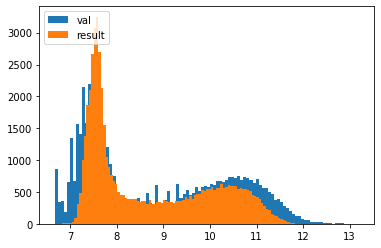

In [20]:


from tensorflow.keras.layers import Input, concatenate, MaxPooling2D
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='elu')(input1)
model1 = Dropout(0.5)(model1)
model1 = MaxPooling2D(pool_size=(2, 1))(model1)
model1 = Conv2D(256, kernel_size=(7,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 14, 1, 256)   2816        input_3[0][0]                    
__________________________________________________________________________________________________
input_4 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout (Dropout)               (None, 14, 1, 256)   0           conv2d[0][0]                     
______________________________________________________________________________________________

705/705 [==============================] - 6s 9ms/step - loss: 0.4663 - mse: 0.4663 - val_loss: 0.5865 - val_mse: 0.5865
Epoch 35/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4655 - mse: 0.4655 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 36/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4638 - mse: 0.4638 - val_loss: 0.6043 - val_mse: 0.6043
Epoch 37/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4631 - mse: 0.4631 - val_loss: 0.5870 - val_mse: 0.5870
Epoch 38/150
705/705 [==============================] - 6s 9ms/step - loss: 0.4627 - mse: 0.4627 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 39/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4620 - mse: 0.4620 - val_loss: 0.5897 - val_mse: 0.5897
Epoch 40/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4604 - mse: 0.4604 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 41/150
705/705 [==============================] - 7s 9ms/step - loss

Epoch 95/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4323 - mse: 0.4323 - val_loss: 0.5748 - val_mse: 0.5748
Epoch 96/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4327 - mse: 0.4327 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 97/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4313 - mse: 0.4313 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 98/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4311 - mse: 0.4311 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 99/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4322 - mse: 0.4322 - val_loss: 0.5808 - val_mse: 0.5808
Epoch 100/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4308 - mse: 0.4308 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 101/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4310 - mse: 0.4310 - val_loss: 0.5840 - val_mse: 0.5840
Epoch 102/150
705/705 [==============================] -

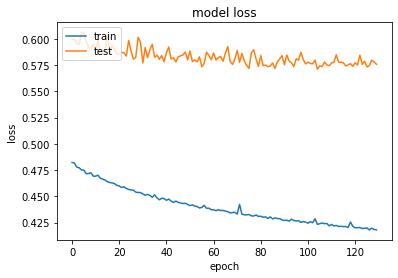

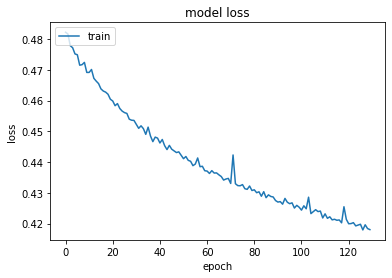

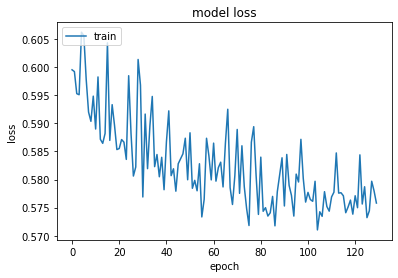

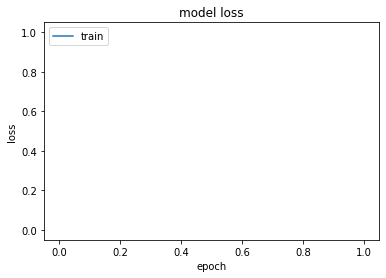

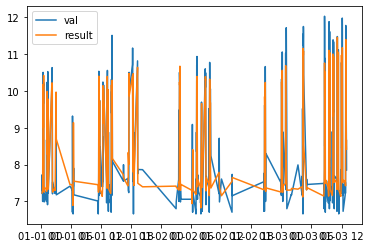

...

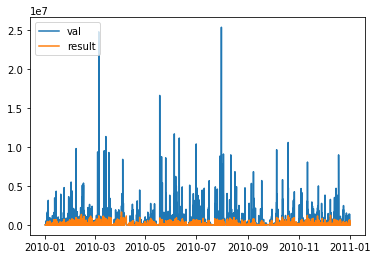

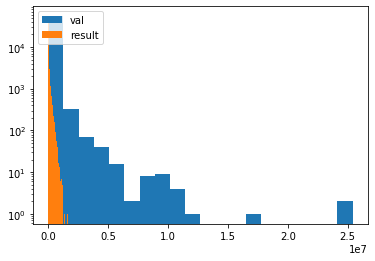

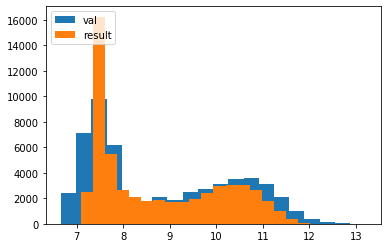

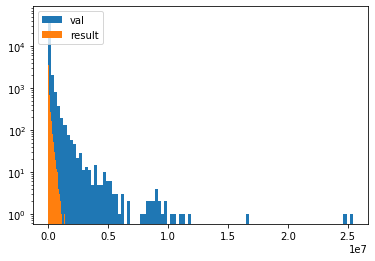

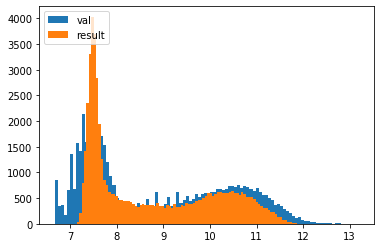

In [8]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10),  activation='relu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1),activation='relu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512,activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128,activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal',activation='selu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=150)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 14, 1, 256)   2816        input_5[0][0]                    
__________________________________________________________________________________________________
input_6 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
alpha_dropout (AlphaDropout)    (None, 14, 1, 256)   0           conv2d_2[0][0]                   
____________________________________________________________________________________________

Epoch 34/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5602 - mse: 0.5602 - val_loss: 1.8010 - val_mse: 1.8010
Epoch 35/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5570 - mse: 0.5570 - val_loss: 2.0652 - val_mse: 2.0652
Epoch 36/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5555 - mse: 0.5555 - val_loss: 1.6486 - val_mse: 1.6486
Epoch 37/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5525 - mse: 0.5525 - val_loss: 1.7974 - val_mse: 1.7974
Epoch 38/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5490 - mse: 0.5490 - val_loss: 1.8089 - val_mse: 1.8089
Epoch 39/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5476 - mse: 0.5476 - val_loss: 1.7372 - val_mse: 1.7372
Epoch 40/150
705/705 [==============================] - 7s 10ms/step - loss: 0.5451 - mse: 0.5451 - val_loss: 1.7161 - val_mse: 1.7161
Epoch 41/150
705/705 [==============================] -

Epoch 95/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4947 - mse: 0.4947 - val_loss: 1.4054 - val_mse: 1.4054
Epoch 96/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4948 - mse: 0.4948 - val_loss: 1.3370 - val_mse: 1.3370
Epoch 97/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4938 - mse: 0.4938 - val_loss: 1.3656 - val_mse: 1.3656
Epoch 98/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4935 - mse: 0.4935 - val_loss: 1.4722 - val_mse: 1.4722
Epoch 99/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4932 - mse: 0.4932 - val_loss: 1.3281 - val_mse: 1.3281
Epoch 100/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4932 - mse: 0.4932 - val_loss: 1.3783 - val_mse: 1.3783
Epoch 101/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4929 - mse: 0.4929 - val_loss: 1.3389 - val_mse: 1.3389
Epoch 102/150
705/705 [==============================

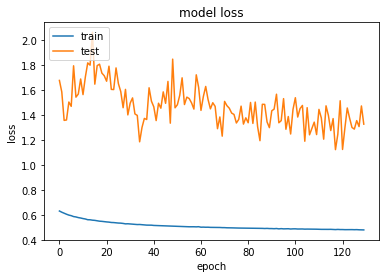

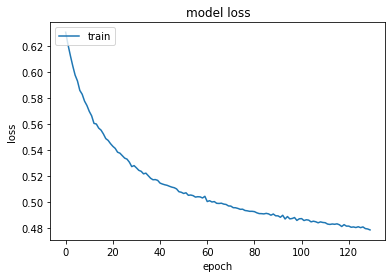

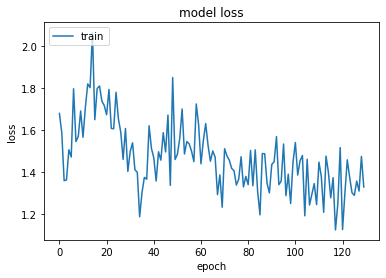

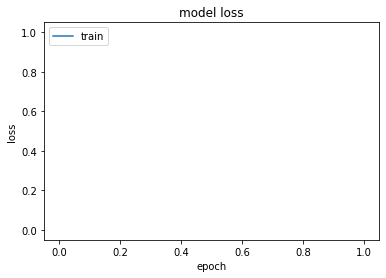

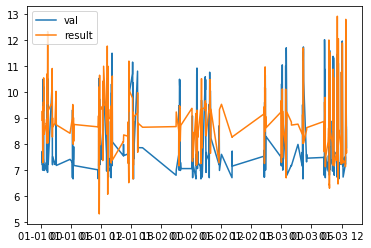

...

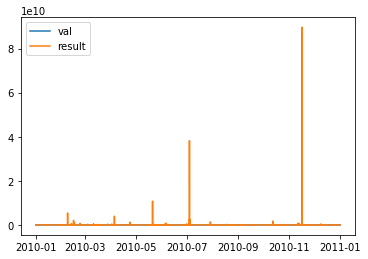

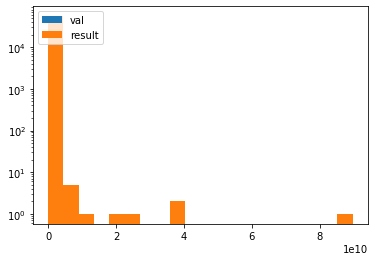

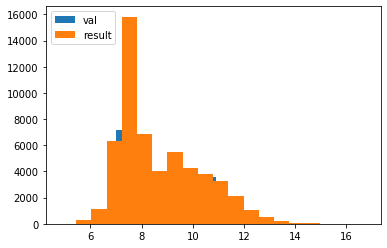

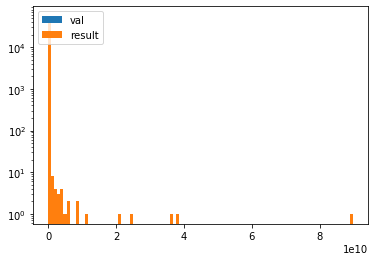

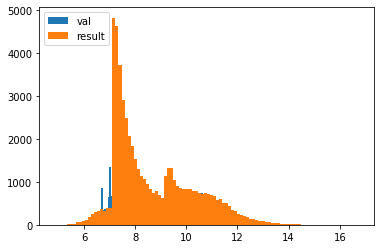

In [9]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10),  activation='relu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1),activation='relu')(model1)
model1 = AlphaDropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512,activation='relu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128,activation='relu')(merged)
merged = Dense(16, activation='relu')(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1)(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=150)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_4 (Conv2D)               (None, 14, 6, 256)   1536        input_7[0][0]                    
__________________________________________________________________________________________________
dropout_3 (Dropout)             (None, 14, 6, 256)   0           conv2d_4[0][0]                   
__________________________________________________________________________________________________
input_8 (InputLayer)            [(None, 8)]          0                                            
____________________________________________________________________________________________

705/705 [==============================] - 15s 22ms/step - loss: 0.4490 - mse: 0.4490 - val_loss: 4.0576 - val_mse: 4.0576
Epoch 33/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4485 - mse: 0.4485 - val_loss: 5.0855 - val_mse: 5.0855
Epoch 34/100
705/705 [==============================] - 15s 22ms/step - loss: 0.4461 - mse: 0.4461 - val_loss: 3.8488 - val_mse: 3.8488
Epoch 35/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4448 - mse: 0.4448 - val_loss: 4.6816 - val_mse: 4.6816
Epoch 36/100
705/705 [==============================] - 15s 22ms/step - loss: 0.4442 - mse: 0.4442 - val_loss: 6.9080 - val_mse: 6.9080
Epoch 37/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4410 - mse: 0.4410 - val_loss: 5.7117 - val_mse: 5.7117
Epoch 38/100
705/705 [==============================] - 15s 22ms/step - loss: 0.4416 - mse: 0.4416 - val_loss: 7.9226 - val_mse: 7.9226
Epoch 39/100
705/705 [==============================] - 16s 2

705/705 [==============================] - 16s 22ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 39.7963 - val_mse: 39.7963
Epoch 92/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 37.0707 - val_mse: 37.0707
Epoch 93/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 39.2651 - val_mse: 39.2651
Epoch 94/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4142 - mse: 0.4142 - val_loss: 39.8037 - val_mse: 39.8037
Epoch 95/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4141 - mse: 0.4141 - val_loss: 42.5598 - val_mse: 42.5598
Epoch 96/100
705/705 [==============================] - 15s 22ms/step - loss: 0.4147 - mse: 0.4147 - val_loss: 39.6990 - val_mse: 39.6990
Epoch 97/100
705/705 [==============================] - 16s 22ms/step - loss: 0.4135 - mse: 0.4135 - val_loss: 40.0734 - val_mse: 40.0734
Epoch 98/100
705/705 [=========================

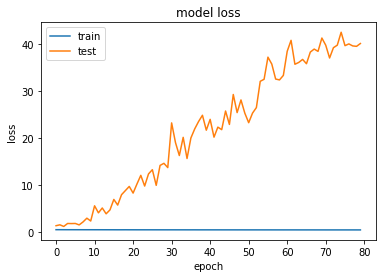

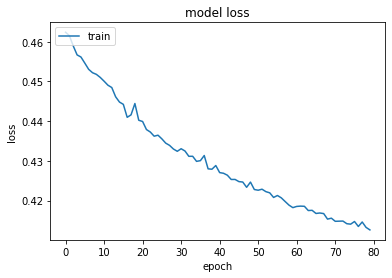

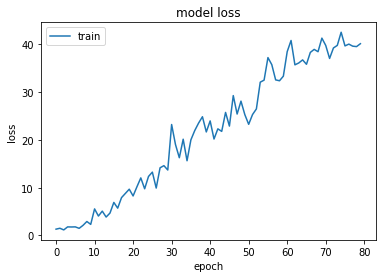

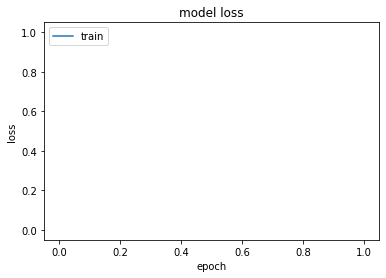

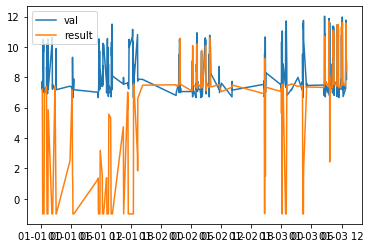

...

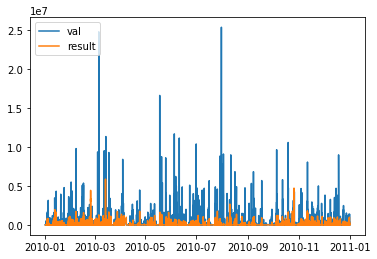

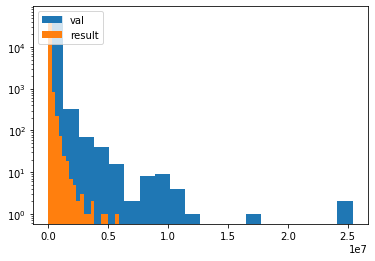

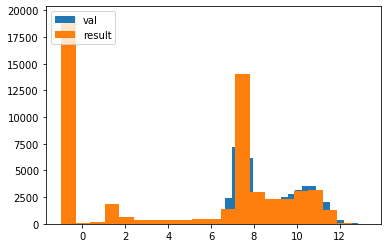

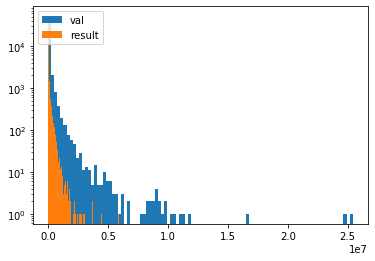

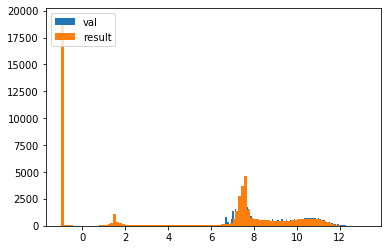

In [10]:


from tensorflow.keras.layers import Input, concatenate, MaxPooling2D
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,5), activation='elu')(input1)
model1 = Dropout(0.5)(model1)
model1 = MaxPooling2D(pool_size=(2, 2))(model1)
model1 = Conv2D(256, kernel_size=(7,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 14, 1, 256)   2816        input_9[0][0]                    
__________________________________________________________________________________________________
input_10 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, 7, 1, 256)    0           conv2d_6[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 6s 8ms/step - loss: 0.4404 - mse: 0.4404 - val_loss: 0.5980 - val_mse: 0.5980
Epoch 35/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4402 - mse: 0.4402 - val_loss: 0.5956 - val_mse: 0.5956
Epoch 36/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4386 - mse: 0.4386 - val_loss: 0.6015 - val_mse: 0.6015
Epoch 37/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4392 - mse: 0.4392 - val_loss: 0.5973 - val_mse: 0.5973
Epoch 38/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4386 - mse: 0.4386 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 39/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4371 - mse: 0.4371 - val_loss: 0.5900 - val_mse: 0.5900
Epoch 40/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4353 - mse: 0.4353 - val_loss: 0.5969 - val_mse: 0.5969
Epoch 41/100
705/705 [==============================] - 6s 8ms/step - loss:

705/705 [==============================] - 6s 8ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.6074 - val_mse: 0.6074
Epoch 96/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4043 - mse: 0.4043 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 97/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4037 - mse: 0.4037 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 98/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4037 - mse: 0.4037 - val_loss: 0.6002 - val_mse: 0.6002
Epoch 99/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4022 - mse: 0.4022 - val_loss: 0.6049 - val_mse: 0.6049
Epoch 100/100
705/705 [==============================] - 6s 8ms/step - loss: 0.4024 - mse: 0.4024 - val_loss: 0.5901 - val_mse: 0.5901


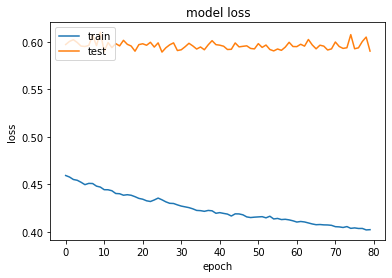

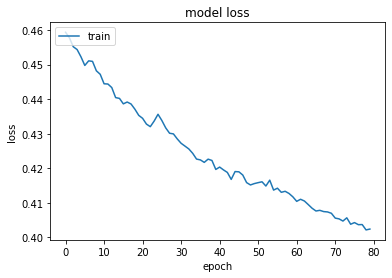

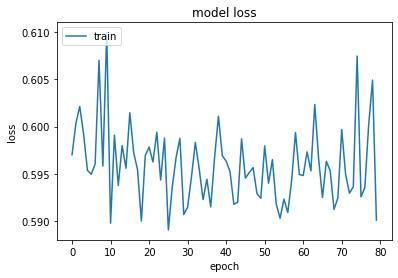

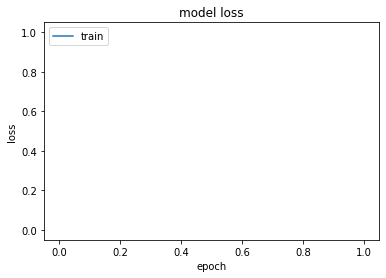

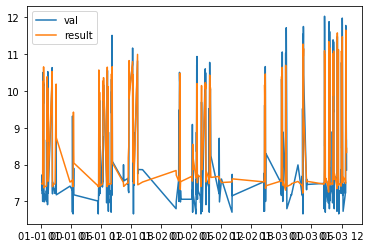

...

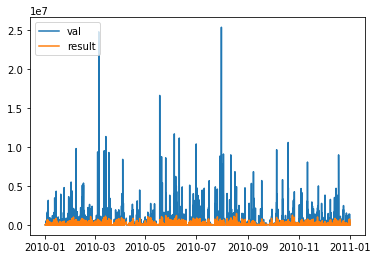

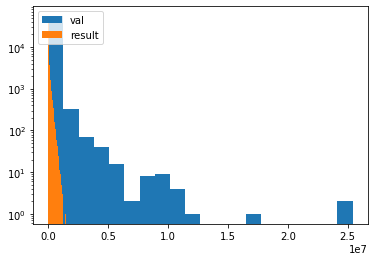

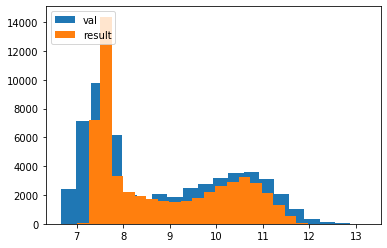

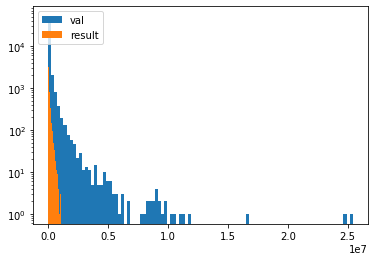

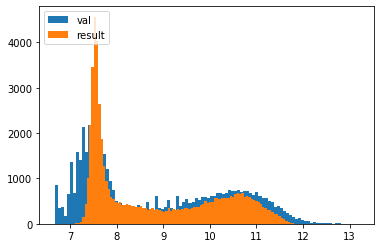

In [11]:


from tensorflow.keras.layers import Input, concatenate, MaxPooling2D
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), activation='elu')(input1)
# model1 = Dropout(0.5)(model1)
model1 = MaxPooling2D(pool_size=(2, 1))(model1)
model1 = Conv2D(256, kernel_size=(7,1), activation='elu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, activation='elu')(merged)
merged = Dense(16, activation='elu')(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_8 (Conv2D)               (None, 14, 1, 256)   2816        input_11[0][0]                   
__________________________________________________________________________________________________
input_12 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
dropout_8 (Dropout)             (None, 14, 1, 256)   0           conv2d_8[0][0]                   
____________________________________________________________________________________________

705/705 [==============================] - 7s 9ms/step - loss: 0.4409 - mse: 0.4409 - val_loss: 0.5817 - val_mse: 0.5817
Epoch 35/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4388 - mse: 0.4388 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 36/150
705/705 [==============================] - 6s 9ms/step - loss: 0.4378 - mse: 0.4378 - val_loss: 0.5759 - val_mse: 0.5759
Epoch 37/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4376 - mse: 0.4376 - val_loss: 0.5782 - val_mse: 0.5782
Epoch 38/150
705/705 [==============================] - 6s 9ms/step - loss: 0.4358 - mse: 0.4358 - val_loss: 0.5800 - val_mse: 0.5800
Epoch 39/150
705/705 [==============================] - 6s 9ms/step - loss: 0.4344 - mse: 0.4344 - val_loss: 0.5810 - val_mse: 0.5810
Epoch 40/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4354 - mse: 0.4354 - val_loss: 0.5728 - val_mse: 0.5728
Epoch 41/150
705/705 [==============================] - 6s 9ms/step - los

705/705 [==============================] - 7s 9ms/step - loss: 0.4163 - mse: 0.4163 - val_loss: 0.5710 - val_mse: 0.5710
Epoch 96/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4164 - mse: 0.4164 - val_loss: 0.5703 - val_mse: 0.5703
Epoch 97/150
705/705 [==============================] - 6s 9ms/step - loss: 0.4151 - mse: 0.4151 - val_loss: 0.5728 - val_mse: 0.5728
Epoch 98/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4158 - mse: 0.4158 - val_loss: 0.5728 - val_mse: 0.5728
Epoch 99/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 100/150
705/705 [==============================] - 7s 10ms/step - loss: 0.4143 - mse: 0.4143 - val_loss: 0.5714 - val_mse: 0.5714
Epoch 101/150
705/705 [==============================] - 7s 9ms/step - loss: 0.4160 - mse: 0.4160 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 102/150
705/705 [==============================] - 6s 9ms/step -

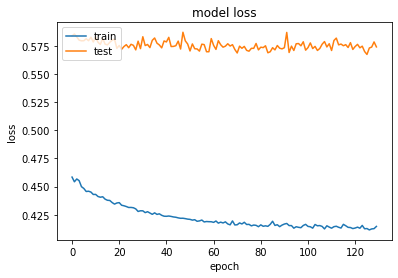

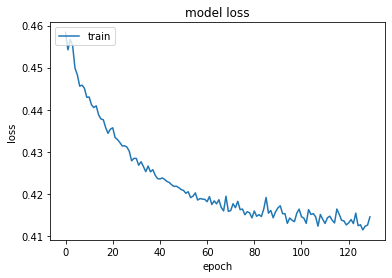

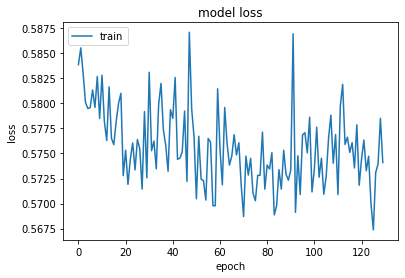

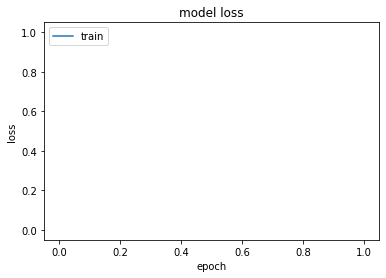

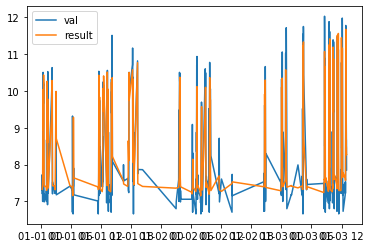

...

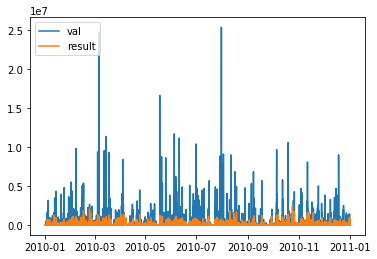

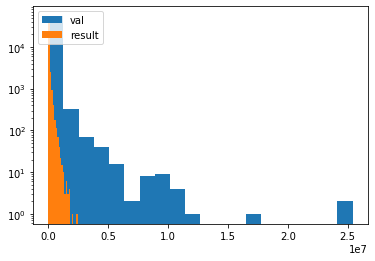

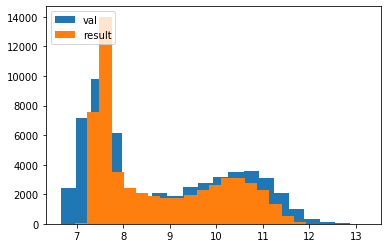

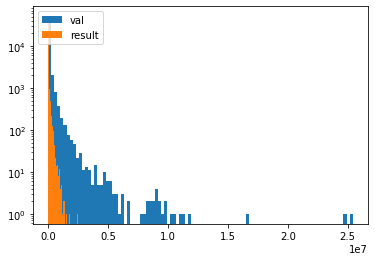

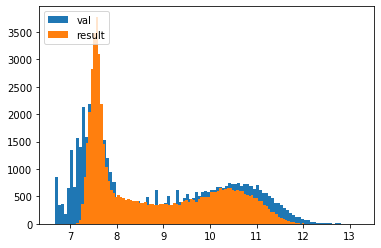

In [12]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, kernel_initializer='lecun_normal',activation='selu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,kernel_initializer='lecun_normal',activation='selu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(16, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(4, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal',activation='selu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=150)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 14, 1, 256)   2816        input_2[0][0]                    
__________________________________________________________________________________________________
input_3 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
alpha_dropout (AlphaDropout)    (None, 14, 1, 256)   0           conv2d[0][0]                     
______________________________________________________________________________________________

Epoch 34/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8085 - mse: 0.8085 - val_loss: 1.2051 - val_mse: 1.2051
Epoch 35/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8073 - mse: 0.8073 - val_loss: 1.1906 - val_mse: 1.1906
Epoch 36/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8069 - mse: 0.8069 - val_loss: 1.1893 - val_mse: 1.1893
Epoch 37/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8061 - mse: 0.8061 - val_loss: 1.2103 - val_mse: 1.2103
Epoch 38/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8059 - mse: 0.8059 - val_loss: 1.1728 - val_mse: 1.1728
Epoch 39/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8055 - mse: 0.8055 - val_loss: 1.2237 - val_mse: 1.2237
Epoch 40/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8043 - mse: 0.8043 - val_loss: 1.1718 - val_mse: 1.1718
Epoch 41/600
705/705 [==============================] -

Epoch 95/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8005 - mse: 0.8005 - val_loss: 1.2257 - val_mse: 1.2257
Epoch 96/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7993 - mse: 0.7993 - val_loss: 1.2213 - val_mse: 1.2213
Epoch 97/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7980 - mse: 0.7980 - val_loss: 1.1961 - val_mse: 1.1961
Epoch 98/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8015 - mse: 0.8015 - val_loss: 1.1719 - val_mse: 1.1719
Epoch 99/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7996 - mse: 0.7996 - val_loss: 1.1762 - val_mse: 1.1762
Epoch 100/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7996 - mse: 0.7996 - val_loss: 1.2368 - val_mse: 1.2368
Epoch 101/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7990 - mse: 0.7990 - val_loss: 1.2437 - val_mse: 1.2437
Epoch 102/600
705/705 [==============================

705/705 [==============================] - 7s 10ms/step - loss: 0.7948 - mse: 0.7948 - val_loss: 1.2498 - val_mse: 1.2498
Epoch 156/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7946 - mse: 0.7946 - val_loss: 1.3991 - val_mse: 1.3991
Epoch 157/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7937 - mse: 0.7937 - val_loss: 1.3016 - val_mse: 1.3016
Epoch 158/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7940 - mse: 0.7940 - val_loss: 1.2140 - val_mse: 1.2140
Epoch 159/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7941 - mse: 0.7941 - val_loss: 1.4096 - val_mse: 1.4096
Epoch 160/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7935 - mse: 0.7935 - val_loss: 1.3470 - val_mse: 1.3470
Epoch 161/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7933 - mse: 0.7933 - val_loss: 1.3083 - val_mse: 1.3083
Epoch 162/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.7933 - mse: 0.7933 - val_loss: 1.4107 - val_mse: 1.4107
Epoch 216/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7913 - mse: 0.7913 - val_loss: 1.3645 - val_mse: 1.3645
Epoch 217/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7931 - mse: 0.7931 - val_loss: 1.4814 - val_mse: 1.4814
Epoch 218/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7920 - mse: 0.7920 - val_loss: 1.3387 - val_mse: 1.3387
Epoch 219/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7939 - mse: 0.7939 - val_loss: 1.2521 - val_mse: 1.2521
Epoch 220/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7963 - mse: 0.7963 - val_loss: 1.2531 - val_mse: 1.2531
Epoch 221/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7950 - mse: 0.7950 - val_loss: 1.3142 - val_mse: 1.3142
Epoch 222/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.7894 - mse: 0.7894 - val_loss: 1.3817 - val_mse: 1.3817
Epoch 276/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7882 - mse: 0.7882 - val_loss: 1.5011 - val_mse: 1.5011
Epoch 277/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7905 - mse: 0.7905 - val_loss: 1.5151 - val_mse: 1.5151
Epoch 278/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7909 - mse: 0.7909 - val_loss: 1.4137 - val_mse: 1.4137
Epoch 279/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7904 - mse: 0.7904 - val_loss: 1.5850 - val_mse: 1.5850
Epoch 280/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7910 - mse: 0.7910 - val_loss: 1.6733 - val_mse: 1.6733
Epoch 281/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7911 - mse: 0.7911 - val_loss: 1.5021 - val_mse: 1.5021
Epoch 282/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.7905 - mse: 0.7905 - val_loss: 1.7608 - val_mse: 1.7608
Epoch 336/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7946 - mse: 0.7946 - val_loss: 1.8990 - val_mse: 1.8990
Epoch 337/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7937 - mse: 0.7937 - val_loss: 1.8655 - val_mse: 1.8655
Epoch 338/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7923 - mse: 0.7923 - val_loss: 1.8939 - val_mse: 1.8939
Epoch 339/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7889 - mse: 0.7889 - val_loss: 1.8164 - val_mse: 1.8164
Epoch 340/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7940 - mse: 0.7940 - val_loss: 2.0774 - val_mse: 2.0774
Epoch 341/600
705/705 [==============================] - 7s 10ms/step - loss: 0.7931 - mse: 0.7931 - val_loss: 2.1329 - val_mse: 2.1329
Epoch 342/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.8049 - mse: 0.8049 - val_loss: 2.1739 - val_mse: 2.1739
Epoch 396/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8057 - mse: 0.8057 - val_loss: 2.0272 - val_mse: 2.0272
Epoch 397/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8068 - mse: 0.8068 - val_loss: 1.9595 - val_mse: 1.9595
Epoch 398/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8065 - mse: 0.8065 - val_loss: 1.9824 - val_mse: 1.9824
Epoch 399/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8070 - mse: 0.8070 - val_loss: 1.9599 - val_mse: 1.9599
Epoch 400/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8081 - mse: 0.8081 - val_loss: 1.8891 - val_mse: 1.8891
Epoch 401/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8075 - mse: 0.8075 - val_loss: 2.1319 - val_mse: 2.1319
Epoch 402/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.8022 - mse: 0.8022 - val_loss: 2.0616 - val_mse: 2.0616
Epoch 456/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8013 - mse: 0.8013 - val_loss: 1.8147 - val_mse: 1.8147
Epoch 457/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8031 - mse: 0.8031 - val_loss: 2.1656 - val_mse: 2.1656
Epoch 458/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8031 - mse: 0.8031 - val_loss: 2.1879 - val_mse: 2.1879
Epoch 459/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8027 - mse: 0.8027 - val_loss: 2.1436 - val_mse: 2.1436
Epoch 460/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8040 - mse: 0.8040 - val_loss: 2.3862 - val_mse: 2.3862
Epoch 461/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8023 - mse: 0.8023 - val_loss: 1.5631 - val_mse: 1.5631
Epoch 462/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.8086 - mse: 0.8086 - val_loss: 1.7755 - val_mse: 1.7755
Epoch 516/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8069 - mse: 0.8069 - val_loss: 1.9411 - val_mse: 1.9411
Epoch 517/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8052 - mse: 0.8052 - val_loss: 1.9512 - val_mse: 1.9512
Epoch 518/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8062 - mse: 0.8062 - val_loss: 1.9738 - val_mse: 1.9738
Epoch 519/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8052 - mse: 0.8052 - val_loss: 2.2544 - val_mse: 2.2544
Epoch 520/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8093 - mse: 0.8093 - val_loss: 2.2353 - val_mse: 2.2353
Epoch 521/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8126 - mse: 0.8126 - val_loss: 1.9263 - val_mse: 1.9263
Epoch 522/600
705/705 [==============================] - 7s 10

705/705 [==============================] - 7s 10ms/step - loss: 0.8070 - mse: 0.8070 - val_loss: 1.8622 - val_mse: 1.8622
Epoch 576/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8037 - mse: 0.8037 - val_loss: 1.8122 - val_mse: 1.8122
Epoch 577/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8065 - mse: 0.8065 - val_loss: 1.8271 - val_mse: 1.8271
Epoch 578/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8074 - mse: 0.8074 - val_loss: 1.4793 - val_mse: 1.4793
Epoch 579/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8063 - mse: 0.8063 - val_loss: 1.5892 - val_mse: 1.5892
Epoch 580/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8042 - mse: 0.8042 - val_loss: 1.7040 - val_mse: 1.7040
Epoch 581/600
705/705 [==============================] - 7s 10ms/step - loss: 0.8063 - mse: 0.8063 - val_loss: 1.6601 - val_mse: 1.6601
Epoch 582/600
705/705 [==============================] - 7s 10

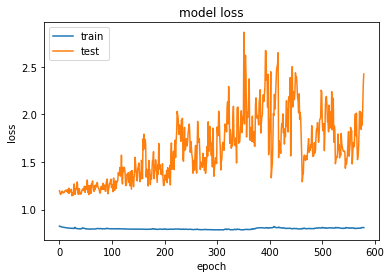

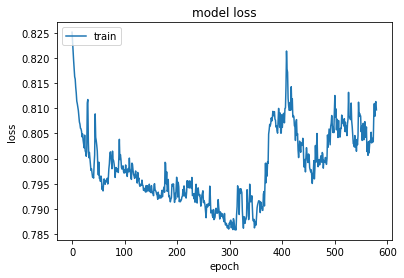

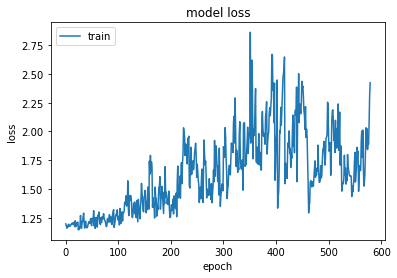

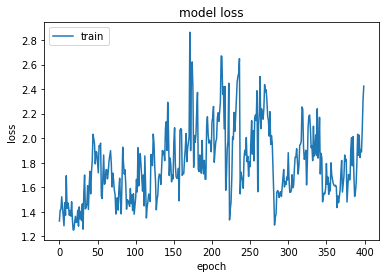

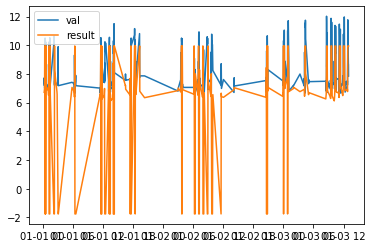

...

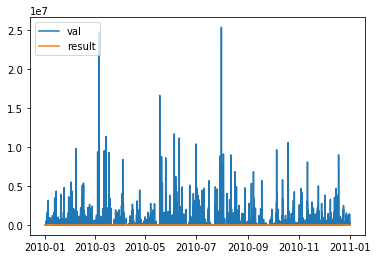

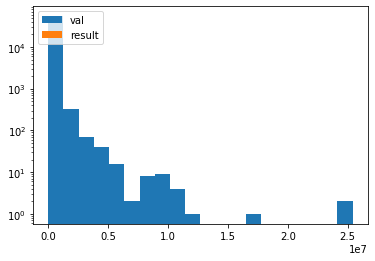

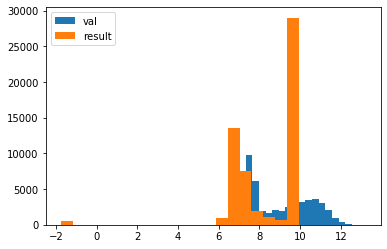

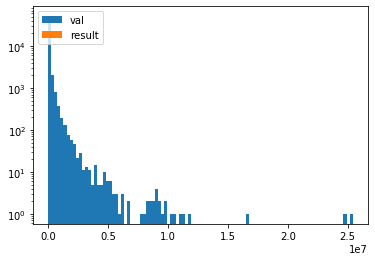

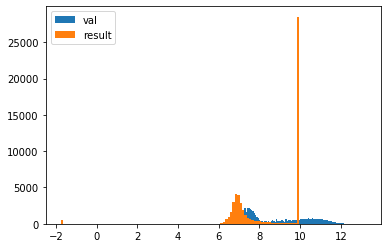

In [7]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
model1 = AlphaDropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, kernel_initializer='lecun_normal',activation='selu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(128,kernel_initializer='lecun_normal',activation='selu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])

merged = Dense(128, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(16, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(4, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal',activation='selu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_5 (InputLayer)            [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 14, 1, 256)   2816        input_4[0][0]                    
__________________________________________________________________________________________________
dense_6 (Dense)                 (None, 512)          4608        input_5[0][0]                    
____________________________________________________________________________________________

705/705 [==============================] - 6s 9ms/step - loss: 0.6924 - mse: 0.6924 - val_loss: 1.1423 - val_mse: 1.1423
Epoch 32/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6783 - mse: 0.6783 - val_loss: 1.1953 - val_mse: 1.1953
Epoch 33/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6654 - mse: 0.6654 - val_loss: 1.1702 - val_mse: 1.1702
Epoch 34/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6694 - mse: 0.6694 - val_loss: 1.2073 - val_mse: 1.2073
Epoch 35/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6697 - mse: 0.6697 - val_loss: 1.1675 - val_mse: 1.1675
Epoch 36/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6732 - mse: 0.6732 - val_loss: 1.1497 - val_mse: 1.1497
Epoch 37/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6747 - mse: 0.6747 - val_loss: 1.1967 - val_mse: 1.1967
Epoch 38/600
705/705 [==============================] - 6s 9ms/step - loss:

705/705 [==============================] - 6s 9ms/step - loss: 0.6373 - mse: 0.6373 - val_loss: 1.3852 - val_mse: 1.3852
Epoch 93/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6420 - mse: 0.6420 - val_loss: 1.3729 - val_mse: 1.3729
Epoch 94/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6374 - mse: 0.6374 - val_loss: 1.3877 - val_mse: 1.3877
Epoch 95/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6379 - mse: 0.6379 - val_loss: 1.3797 - val_mse: 1.3797
Epoch 96/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6378 - mse: 0.6378 - val_loss: 1.3571 - val_mse: 1.3571
Epoch 97/600
705/705 [==============================] - 6s 9ms/step - loss: 1.0517 - mse: 1.0517 - val_loss: 1.3022 - val_mse: 1.3022
Epoch 98/600
705/705 [==============================] - 6s 9ms/step - loss: 0.6464 - mse: 0.6464 - val_loss: 1.3397 - val_mse: 1.3397
Epoch 99/600
705/705 [==============================] - 6s 9ms/step - loss:

Epoch 153/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5889 - mse: 0.5889 - val_loss: 0.9247 - val_mse: 0.9247
Epoch 154/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5888 - mse: 0.5888 - val_loss: 0.9029 - val_mse: 0.9029
Epoch 155/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5877 - mse: 0.5877 - val_loss: 0.9348 - val_mse: 0.9348
Epoch 156/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5854 - mse: 0.5854 - val_loss: 0.9570 - val_mse: 0.9570
Epoch 157/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5844 - mse: 0.5844 - val_loss: 0.8487 - val_mse: 0.8487
Epoch 158/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5837 - mse: 0.5837 - val_loss: 0.9227 - val_mse: 0.9227
Epoch 159/600
705/705 [==============================] - 6s 9ms/step - loss: 0.9606 - mse: 0.9606 - val_loss: 0.8943 - val_mse: 0.8943
Epoch 160/600
705/705 [==============================] 

705/705 [==============================] - 6s 9ms/step - loss: 0.5699 - mse: 0.5699 - val_loss: 0.9286 - val_mse: 0.9286
Epoch 214/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5700 - mse: 0.5700 - val_loss: 0.9397 - val_mse: 0.9397
Epoch 215/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5699 - mse: 0.5699 - val_loss: 0.9394 - val_mse: 0.9394
Epoch 216/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5723 - mse: 0.5723 - val_loss: 0.9249 - val_mse: 0.9249
Epoch 217/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5706 - mse: 0.5706 - val_loss: 0.9446 - val_mse: 0.9446
Epoch 218/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5687 - mse: 0.5687 - val_loss: 0.8968 - val_mse: 0.8968
Epoch 219/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5698 - mse: 0.5698 - val_loss: 0.9154 - val_mse: 0.9154
Epoch 220/600
705/705 [==============================] - 6s 9ms/step 

Epoch 274/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5630 - mse: 0.5630 - val_loss: 0.9181 - val_mse: 0.9181
Epoch 275/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5645 - mse: 0.5645 - val_loss: 0.8982 - val_mse: 0.8982
Epoch 276/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5741 - mse: 0.5741 - val_loss: 0.8839 - val_mse: 0.8839
Epoch 277/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5673 - mse: 0.5673 - val_loss: 0.8963 - val_mse: 0.8963
Epoch 278/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5651 - mse: 0.5651 - val_loss: 0.8871 - val_mse: 0.8871
Epoch 279/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5976 - mse: 0.5976 - val_loss: 0.9405 - val_mse: 0.9405
Epoch 280/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5706 - mse: 0.5706 - val_loss: 0.8880 - val_mse: 0.8880
Epoch 281/600
705/705 [==============================] 

705/705 [==============================] - 6s 9ms/step - loss: 0.5639 - mse: 0.5639 - val_loss: 0.9047 - val_mse: 0.9047
Epoch 335/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5628 - mse: 0.5628 - val_loss: 0.9264 - val_mse: 0.9264
Epoch 336/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5632 - mse: 0.5632 - val_loss: 0.8878 - val_mse: 0.8878
Epoch 337/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5631 - mse: 0.5631 - val_loss: 0.9310 - val_mse: 0.9310
Epoch 338/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5620 - mse: 0.5620 - val_loss: 0.9167 - val_mse: 0.9167
Epoch 339/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5625 - mse: 0.5625 - val_loss: 0.9270 - val_mse: 0.9270
Epoch 340/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5623 - mse: 0.5623 - val_loss: 0.9012 - val_mse: 0.9012
Epoch 341/600
705/705 [==============================] - 6s 9ms/step 

Epoch 395/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5592 - mse: 0.5592 - val_loss: 0.6809 - val_mse: 0.6809
Epoch 396/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5591 - mse: 0.5591 - val_loss: 0.6742 - val_mse: 0.6742
Epoch 397/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5608 - mse: 0.5608 - val_loss: 0.6697 - val_mse: 0.6697
Epoch 398/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5590 - mse: 0.5590 - val_loss: 0.6776 - val_mse: 0.6776
Epoch 399/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5588 - mse: 0.5588 - val_loss: 0.6697 - val_mse: 0.6697
Epoch 400/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5582 - mse: 0.5582 - val_loss: 0.6702 - val_mse: 0.6702
Epoch 401/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5596 - mse: 0.5596 - val_loss: 0.6675 - val_mse: 0.6675
Epoch 402/600
705/705 [==============================] 

705/705 [==============================] - 6s 9ms/step - loss: 0.5558 - mse: 0.5558 - val_loss: 0.6618 - val_mse: 0.6618
Epoch 456/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5549 - mse: 0.5549 - val_loss: 0.6663 - val_mse: 0.6663
Epoch 457/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5555 - mse: 0.5555 - val_loss: 0.6637 - val_mse: 0.6637
Epoch 458/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5562 - mse: 0.5562 - val_loss: 0.6636 - val_mse: 0.6636
Epoch 459/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5568 - mse: 0.5568 - val_loss: 0.6591 - val_mse: 0.6591
Epoch 460/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5572 - mse: 0.5572 - val_loss: 0.6546 - val_mse: 0.6546
Epoch 461/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5557 - mse: 0.5557 - val_loss: 0.6570 - val_mse: 0.6570
Epoch 462/600
705/705 [==============================] - 6s 9ms/step 

Epoch 516/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5492 - mse: 0.5492 - val_loss: 0.6502 - val_mse: 0.6502
Epoch 517/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5503 - mse: 0.5503 - val_loss: 0.6505 - val_mse: 0.6505
Epoch 518/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5488 - mse: 0.5488 - val_loss: 0.6512 - val_mse: 0.6512
Epoch 519/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5486 - mse: 0.5486 - val_loss: 0.6476 - val_mse: 0.6476
Epoch 520/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5487 - mse: 0.5487 - val_loss: 0.6489 - val_mse: 0.6489
Epoch 521/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5482 - mse: 0.5482 - val_loss: 0.6505 - val_mse: 0.6505
Epoch 522/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5493 - mse: 0.5493 - val_loss: 0.6486 - val_mse: 0.6486
Epoch 523/600
705/705 [==============================] 

705/705 [==============================] - 6s 9ms/step - loss: 0.5451 - mse: 0.5451 - val_loss: 0.6450 - val_mse: 0.6450
Epoch 577/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5440 - mse: 0.5440 - val_loss: 0.6467 - val_mse: 0.6467
Epoch 578/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5441 - mse: 0.5441 - val_loss: 0.6469 - val_mse: 0.6469
Epoch 579/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5452 - mse: 0.5452 - val_loss: 0.6477 - val_mse: 0.6477
Epoch 580/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5444 - mse: 0.5444 - val_loss: 0.6457 - val_mse: 0.6457
Epoch 581/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5451 - mse: 0.5451 - val_loss: 0.6423 - val_mse: 0.6423
Epoch 582/600
705/705 [==============================] - 6s 9ms/step - loss: 0.5438 - mse: 0.5438 - val_loss: 0.6428 - val_mse: 0.6428
Epoch 583/600
705/705 [==============================] - 6s 9ms/step 

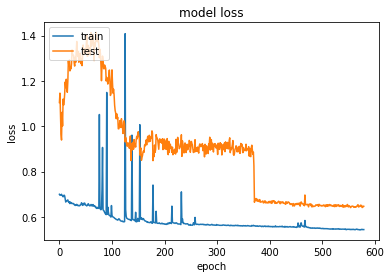

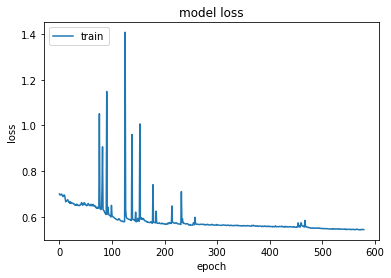

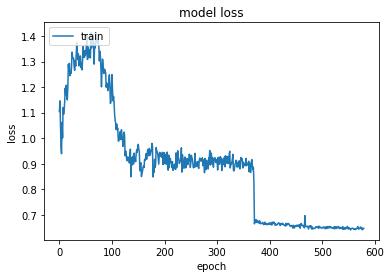

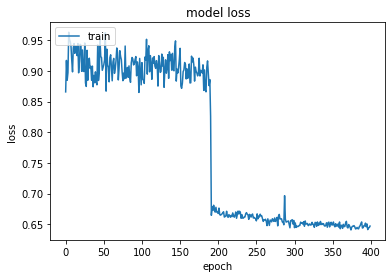

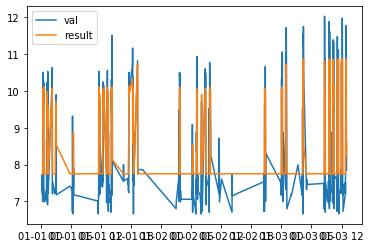

...

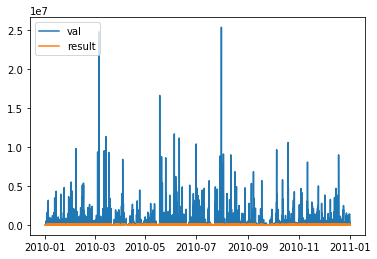

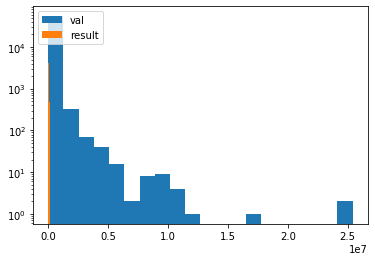

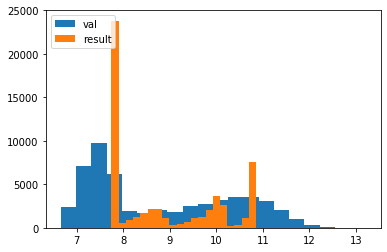

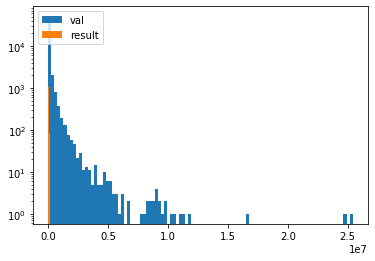

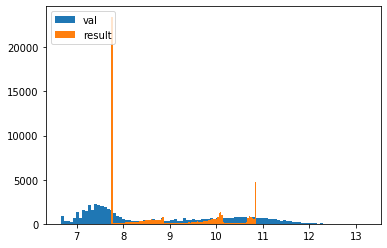

In [8]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = Dropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, kernel_initializer='lecun_normal',activation='selu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,kernel_initializer='lecun_normal',activation='selu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
merged = Dropout(0.5)(merged)

merged = Dense(128, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dropout(0.5)(merged)
merged = Dense(16, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dropout(0.5)(merged)
merged = Dense(4, kernel_initializer='lecun_normal',activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal',activation='selu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_11 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_22 (Dense)             (None, 512)               77312     
_________________________________________________________________
alpha_dropout_5 (AlphaDropou (None, 512)               0         
_________________________________________________________________
dense_23 (Dense)             (None, 128)               65664     
_________________________________________________________________
dense_24 (Dense)             (None, 32)                4128      
_________________________________________________________________
dense_25 (Dense)             (None, 4)                 132       
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 5   

705/705 [==============================] - 1s 2ms/step - loss: 0.4590 - mse: 0.4590 - val_loss: 5.6582 - val_mse: 5.6582
Epoch 53/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4574 - mse: 0.4574 - val_loss: 5.6122 - val_mse: 5.6122
Epoch 54/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4555 - mse: 0.4555 - val_loss: 5.3826 - val_mse: 5.3826
Epoch 55/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4565 - mse: 0.4565 - val_loss: 5.1500 - val_mse: 5.1500
Epoch 56/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4543 - mse: 0.4543 - val_loss: 5.6602 - val_mse: 5.6602
Epoch 57/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4554 - mse: 0.4554 - val_loss: 4.9672 - val_mse: 4.9672
Epoch 58/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4535 - mse: 0.4535 - val_loss: 5.4826 - val_mse: 5.4826
Epoch 59/150
705/705 [==============================] - 1s 2ms/step - loss:

705/705 [==============================] - 1s 2ms/step - loss: 0.4314 - mse: 0.4314 - val_loss: 2.2013 - val_mse: 2.2013
Epoch 114/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4310 - mse: 0.4310 - val_loss: 2.1526 - val_mse: 2.1526
Epoch 115/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4307 - mse: 0.4307 - val_loss: 2.2117 - val_mse: 2.2117
Epoch 116/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4303 - mse: 0.4303 - val_loss: 2.1949 - val_mse: 2.1949
Epoch 117/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4302 - mse: 0.4302 - val_loss: 2.0857 - val_mse: 2.0857
Epoch 118/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4301 - mse: 0.4301 - val_loss: 2.2434 - val_mse: 2.2434
Epoch 119/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4296 - mse: 0.4296 - val_loss: 2.0707 - val_mse: 2.0707
Epoch 120/150
705/705 [==============================] - 1s 2ms/step 

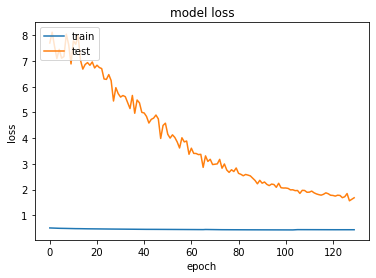

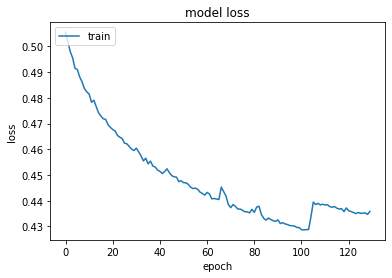

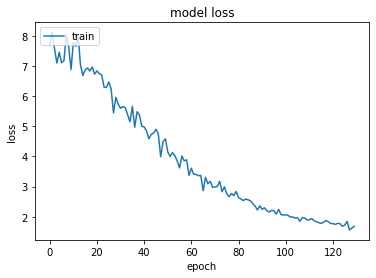

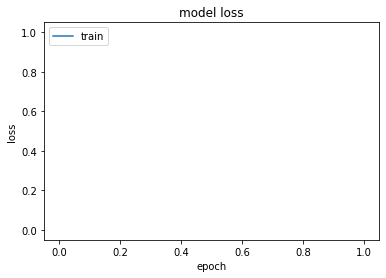

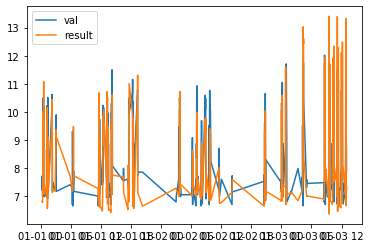

...

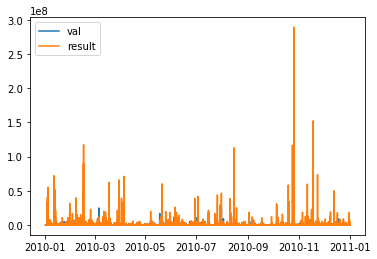

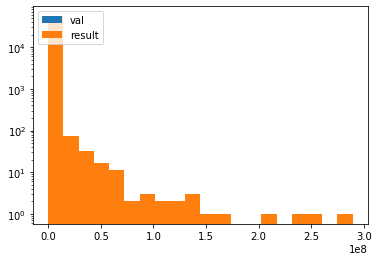

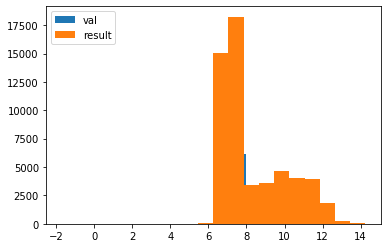

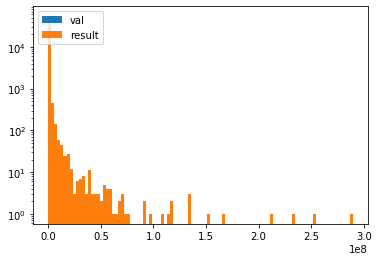

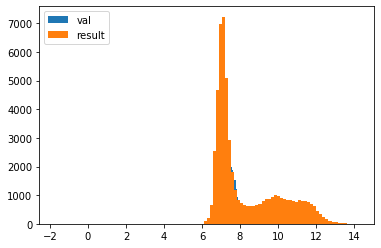

In [13]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model




input2 = Input(shape=(150))
model2 = Dense(512, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(128, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(32, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(4, kernel_initializer='lecun_normal', activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=150)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_12 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_27 (Dense)             (None, 512)               77312     
_________________________________________________________________
dropout_5 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_28 (Dense)             (None, 128)               65664     
_________________________________________________________________
dense_29 (Dense)             (None, 32)                4128      
_________________________________________________________________
dense_30 (Dense)             (None, 4)                 132       
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 5   

705/705 [==============================] - 1s 2ms/step - loss: 0.4467 - mse: 0.4467 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 53/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4476 - mse: 0.4476 - val_loss: 0.5747 - val_mse: 0.5747
Epoch 54/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4463 - mse: 0.4463 - val_loss: 0.5764 - val_mse: 0.5764
Epoch 55/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4459 - mse: 0.4459 - val_loss: 0.5812 - val_mse: 0.5812
Epoch 56/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4441 - mse: 0.4441 - val_loss: 0.5818 - val_mse: 0.5818
Epoch 57/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4479 - mse: 0.4479 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 58/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4432 - mse: 0.4432 - val_loss: 0.5807 - val_mse: 0.5807
Epoch 59/150
705/705 [==============================] - 1s 2ms/step - loss:

705/705 [==============================] - 1s 2ms/step - loss: 0.4294 - mse: 0.4294 - val_loss: 0.5679 - val_mse: 0.5679
Epoch 114/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4285 - mse: 0.4285 - val_loss: 0.5733 - val_mse: 0.5733
Epoch 115/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4279 - mse: 0.4279 - val_loss: 0.5781 - val_mse: 0.5781
Epoch 116/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4278 - mse: 0.4278 - val_loss: 0.5767 - val_mse: 0.5767
Epoch 117/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4281 - mse: 0.4281 - val_loss: 0.5702 - val_mse: 0.5702
Epoch 118/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4286 - mse: 0.4286 - val_loss: 0.5716 - val_mse: 0.5716
Epoch 119/150
705/705 [==============================] - 1s 2ms/step - loss: 0.4283 - mse: 0.4283 - val_loss: 0.5727 - val_mse: 0.5727
Epoch 120/150
705/705 [==============================] - 1s 2ms/step 

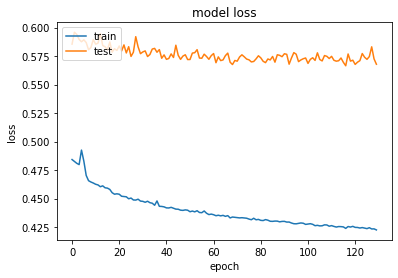

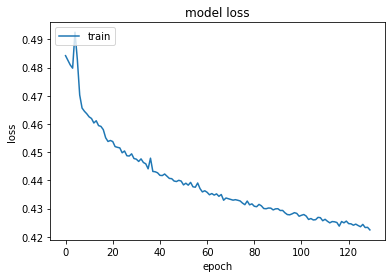

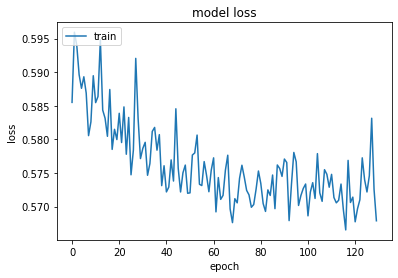

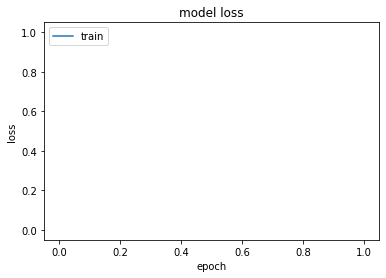

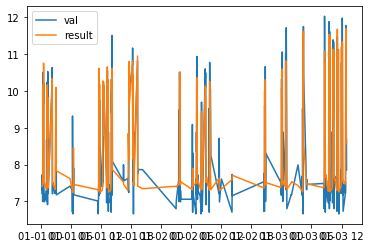

...

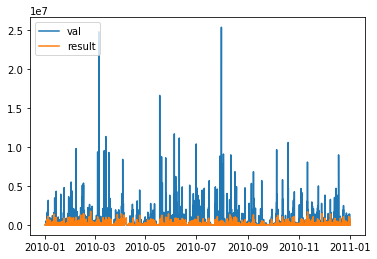

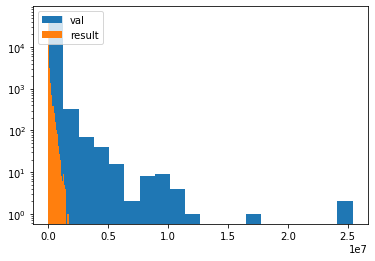

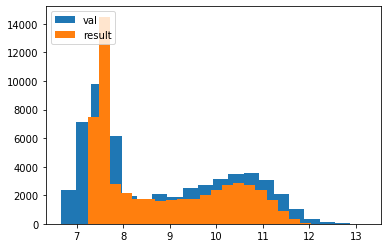

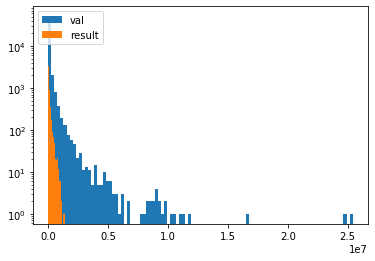

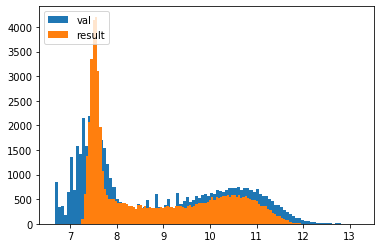

In [14]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model


input2 = Input(shape=(150))
model2 = Dense(512, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(32, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(4, kernel_initializer='lecun_normal', activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=150)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_15 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_42 (Dense)             (None, 256)               38656     
_________________________________________________________________
dropout_9 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_43 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_44 (Dense)             (None, 16)                1040      
_________________________________________________________________
dense_45 (Dense)             (None, 4)                 68        
_________________________________________________________________
dense_46 (Dense)             (None, 1)                 5   

Epoch 53/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4753 - mse: 0.4753 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 54/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4740 - mse: 0.4740 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 55/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4736 - mse: 0.4736 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 56/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4738 - mse: 0.4738 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 57/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4734 - mse: 0.4734 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 58/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4727 - mse: 0.4727 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 59/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4721 - mse: 0.4721 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 60/600
705/705 [==============================] - 1s 2ms

705/705 [==============================] - 1s 2ms/step - loss: 0.4595 - mse: 0.4595 - val_loss: 0.5850 - val_mse: 0.5850
Epoch 115/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4592 - mse: 0.4592 - val_loss: 0.5794 - val_mse: 0.5794
Epoch 116/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4589 - mse: 0.4589 - val_loss: 0.5826 - val_mse: 0.5826
Epoch 117/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4594 - mse: 0.4594 - val_loss: 0.5820 - val_mse: 0.5820
Epoch 118/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4592 - mse: 0.4592 - val_loss: 0.5848 - val_mse: 0.5848
Epoch 119/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4590 - mse: 0.4590 - val_loss: 0.5842 - val_mse: 0.5842
Epoch 120/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4579 - mse: 0.4579 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 121/600
705/705 [==============================] - 1s 2ms/step 

Epoch 175/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4527 - mse: 0.4527 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 176/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4526 - mse: 0.4526 - val_loss: 0.5784 - val_mse: 0.5784
Epoch 177/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4522 - mse: 0.4522 - val_loss: 0.5763 - val_mse: 0.5763
Epoch 178/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4527 - mse: 0.4527 - val_loss: 0.5780 - val_mse: 0.5780
Epoch 179/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4530 - mse: 0.4530 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 180/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4527 - mse: 0.4527 - val_loss: 0.5790 - val_mse: 0.5790
Epoch 181/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4522 - mse: 0.4522 - val_loss: 0.5803 - val_mse: 0.5803
Epoch 182/600
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4491 - mse: 0.4491 - val_loss: 0.5779 - val_mse: 0.5779
Epoch 236/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4493 - mse: 0.4493 - val_loss: 0.5785 - val_mse: 0.5785
Epoch 237/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4491 - mse: 0.4491 - val_loss: 0.5756 - val_mse: 0.5756
Epoch 238/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4493 - mse: 0.4493 - val_loss: 0.5768 - val_mse: 0.5768
Epoch 239/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4489 - mse: 0.4489 - val_loss: 0.5839 - val_mse: 0.5839
Epoch 240/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4480 - mse: 0.4480 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 241/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4488 - mse: 0.4488 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 242/600
705/705 [==============================] - 1s 2ms/step 

705/705 [==============================] - 1s 2ms/step - loss: 0.4458 - mse: 0.4458 - val_loss: 0.5729 - val_mse: 0.5729
Epoch 296/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4462 - mse: 0.4462 - val_loss: 0.5733 - val_mse: 0.5733
Epoch 297/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4461 - mse: 0.4461 - val_loss: 0.5822 - val_mse: 0.5822
Epoch 298/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4462 - mse: 0.4462 - val_loss: 0.5740 - val_mse: 0.5740
Epoch 299/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4462 - mse: 0.4462 - val_loss: 0.5766 - val_mse: 0.5766
Epoch 300/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4459 - mse: 0.4459 - val_loss: 0.5755 - val_mse: 0.5755
Epoch 301/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4468 - mse: 0.4468 - val_loss: 0.5722 - val_mse: 0.5722
Epoch 302/600
705/705 [==============================] - 1s 2ms/step 

Epoch 356/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4441 - mse: 0.4441 - val_loss: 0.5753 - val_mse: 0.5753
Epoch 357/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4445 - mse: 0.4445 - val_loss: 0.5746 - val_mse: 0.5746
Epoch 358/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4447 - mse: 0.4447 - val_loss: 0.5721 - val_mse: 0.5721
Epoch 359/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4445 - mse: 0.4445 - val_loss: 0.5760 - val_mse: 0.5760
Epoch 360/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4445 - mse: 0.4445 - val_loss: 0.5750 - val_mse: 0.5750
Epoch 361/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4440 - mse: 0.4440 - val_loss: 0.5748 - val_mse: 0.5748
Epoch 362/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4449 - mse: 0.4449 - val_loss: 0.5745 - val_mse: 0.5745
Epoch 363/600
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4431 - mse: 0.4431 - val_loss: 0.5736 - val_mse: 0.5736
Epoch 417/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4429 - mse: 0.4429 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 418/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4425 - mse: 0.4425 - val_loss: 0.5706 - val_mse: 0.5706
Epoch 419/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4427 - mse: 0.4427 - val_loss: 0.5720 - val_mse: 0.5720
Epoch 420/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5704 - val_mse: 0.5704
Epoch 421/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4428 - mse: 0.4428 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 422/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5747 - val_mse: 0.5747
Epoch 423/600
705/705 [==============================] - 1s 2ms/step 

Epoch 477/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4416 - mse: 0.4416 - val_loss: 0.5730 - val_mse: 0.5730
Epoch 478/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4414 - mse: 0.4414 - val_loss: 0.5743 - val_mse: 0.5743
Epoch 479/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4408 - mse: 0.4408 - val_loss: 0.5825 - val_mse: 0.5825
Epoch 480/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4412 - mse: 0.4412 - val_loss: 0.5714 - val_mse: 0.5714
Epoch 481/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4408 - mse: 0.4408 - val_loss: 0.5724 - val_mse: 0.5724
Epoch 482/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4413 - mse: 0.4413 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 483/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4417 - mse: 0.4417 - val_loss: 0.5704 - val_mse: 0.5704
Epoch 484/600
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4401 - mse: 0.4401 - val_loss: 0.5717 - val_mse: 0.5717
Epoch 538/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4406 - mse: 0.4406 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 539/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4394 - mse: 0.4394 - val_loss: 0.5736 - val_mse: 0.5736
Epoch 540/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4398 - mse: 0.4398 - val_loss: 0.5750 - val_mse: 0.5750
Epoch 541/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4404 - mse: 0.4404 - val_loss: 0.5743 - val_mse: 0.5743
Epoch 542/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4402 - mse: 0.4402 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 543/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4399 - mse: 0.4399 - val_loss: 0.5706 - val_mse: 0.5706
Epoch 544/600
705/705 [==============================] - 1s 2ms/step 

Epoch 598/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4385 - mse: 0.4385 - val_loss: 0.5737 - val_mse: 0.5737
Epoch 599/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4389 - mse: 0.4389 - val_loss: 0.5724 - val_mse: 0.5724
Epoch 600/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4396 - mse: 0.4396 - val_loss: 0.5798 - val_mse: 0.5798


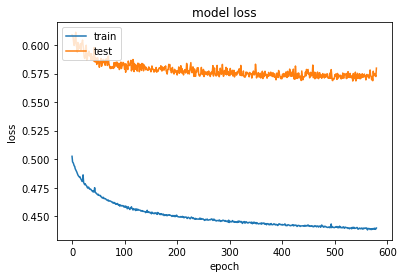

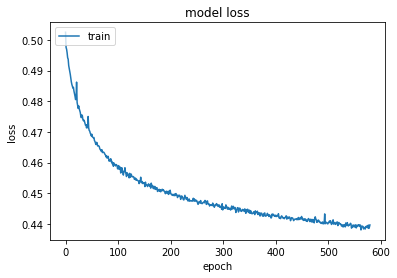

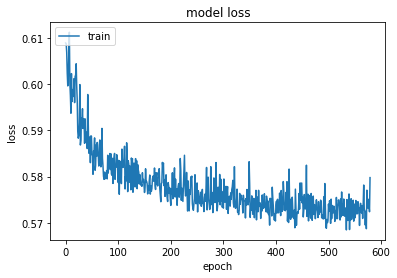

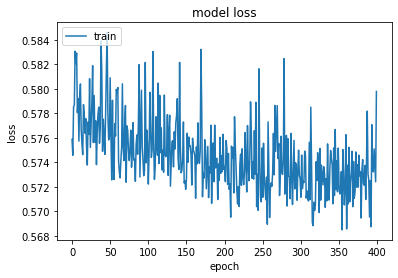

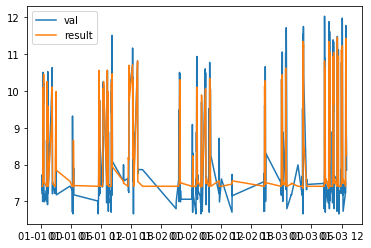

...

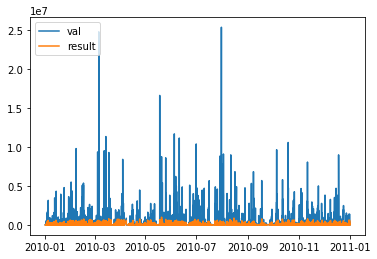

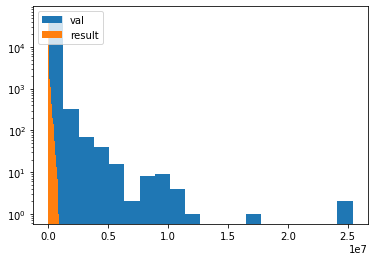

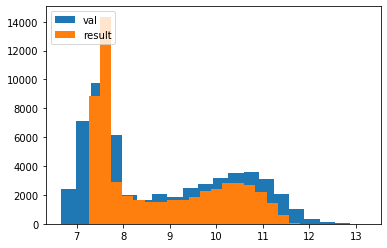

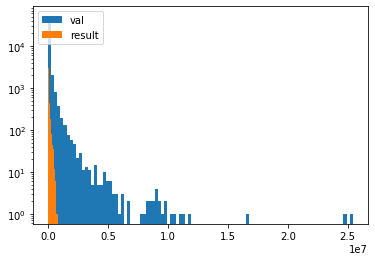

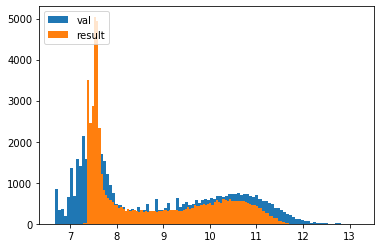

In [17]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model




input2 = Input(shape=(150))
model2 = Dense(256, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(64, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(16, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(4, kernel_initializer='lecun_normal', activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_16 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_47 (Dense)             (None, 256)               38656     
_________________________________________________________________
dropout_10 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_48 (Dense)             (None, 64)                16448     
_________________________________________________________________
dropout_11 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_49 (Dense)             (None, 16)                1040      
_________________________________________________________________
dense_50 (Dense)             (None, 4)                 68  

705/705 [==============================] - 1s 2ms/step - loss: 0.5495 - mse: 0.5495 - val_loss: 0.6404 - val_mse: 0.6404
Epoch 52/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5499 - mse: 0.5499 - val_loss: 0.6469 - val_mse: 0.6469
Epoch 53/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5486 - mse: 0.5486 - val_loss: 0.6283 - val_mse: 0.6283
Epoch 54/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5483 - mse: 0.5483 - val_loss: 0.6330 - val_mse: 0.6330
Epoch 55/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5485 - mse: 0.5485 - val_loss: 0.6293 - val_mse: 0.6293
Epoch 56/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5463 - mse: 0.5463 - val_loss: 0.6351 - val_mse: 0.6351
Epoch 57/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5477 - mse: 0.5477 - val_loss: 0.6424 - val_mse: 0.6424
Epoch 58/2000
705/705 [==============================] - 1s 2ms/step 

Epoch 112/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5288 - mse: 0.5288 - val_loss: 0.6409 - val_mse: 0.6409
Epoch 113/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5279 - mse: 0.5279 - val_loss: 0.6487 - val_mse: 0.6487
Epoch 114/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5279 - mse: 0.5279 - val_loss: 0.6482 - val_mse: 0.6482
Epoch 115/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5277 - mse: 0.5277 - val_loss: 0.6357 - val_mse: 0.6357
Epoch 116/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5269 - mse: 0.5269 - val_loss: 0.6418 - val_mse: 0.6418
Epoch 117/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5258 - mse: 0.5258 - val_loss: 0.6425 - val_mse: 0.6425
Epoch 118/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5282 - mse: 0.5282 - val_loss: 0.6491 - val_mse: 0.6491
Epoch 119/2000
705/705 [========================

705/705 [==============================] - 2s 2ms/step - loss: 0.5183 - mse: 0.5183 - val_loss: 0.6445 - val_mse: 0.6445
Epoch 173/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5188 - mse: 0.5188 - val_loss: 0.6436 - val_mse: 0.6436
Epoch 174/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5177 - mse: 0.5177 - val_loss: 0.6349 - val_mse: 0.6349
Epoch 175/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5185 - mse: 0.5185 - val_loss: 0.6520 - val_mse: 0.6520
Epoch 176/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5187 - mse: 0.5187 - val_loss: 0.6516 - val_mse: 0.6516
Epoch 177/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5198 - mse: 0.5198 - val_loss: 0.6515 - val_mse: 0.6515
Epoch 178/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 0.6438 - val_mse: 0.6438
Epoch 179/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5098 - mse: 0.5098 - val_loss: 0.6178 - val_mse: 0.6178
Epoch 233/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5102 - mse: 0.5102 - val_loss: 0.6387 - val_mse: 0.6387
Epoch 234/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5096 - mse: 0.5096 - val_loss: 0.6408 - val_mse: 0.6408
Epoch 235/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5101 - mse: 0.5101 - val_loss: 0.6381 - val_mse: 0.6381
Epoch 236/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5115 - mse: 0.5115 - val_loss: 0.6454 - val_mse: 0.6454
Epoch 237/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5104 - mse: 0.5104 - val_loss: 0.6413 - val_mse: 0.6413
Epoch 238/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.5091 - mse: 0.5091 - val_loss: 0.6423 - val_mse: 0.6423
Epoch 239/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5046 - mse: 0.5046 - val_loss: 0.6247 - val_mse: 0.6247
Epoch 293/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5052 - mse: 0.5052 - val_loss: 0.6312 - val_mse: 0.6312
Epoch 294/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5039 - mse: 0.5039 - val_loss: 0.6388 - val_mse: 0.6388
Epoch 295/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5045 - mse: 0.5045 - val_loss: 0.6248 - val_mse: 0.6248
Epoch 296/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5033 - mse: 0.5033 - val_loss: 0.6211 - val_mse: 0.6211
Epoch 297/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5036 - mse: 0.5036 - val_loss: 0.6299 - val_mse: 0.6299
Epoch 298/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5035 - mse: 0.5035 - val_loss: 0.6253 - val_mse: 0.6253
Epoch 299/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5003 - mse: 0.5003 - val_loss: 0.6289 - val_mse: 0.6289
Epoch 353/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5012 - mse: 0.5012 - val_loss: 0.6302 - val_mse: 0.6302
Epoch 354/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5016 - mse: 0.5016 - val_loss: 0.6245 - val_mse: 0.6245
Epoch 355/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5017 - mse: 0.5017 - val_loss: 0.6282 - val_mse: 0.6282
Epoch 356/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5011 - mse: 0.5011 - val_loss: 0.6210 - val_mse: 0.6210
Epoch 357/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5004 - mse: 0.5004 - val_loss: 0.6198 - val_mse: 0.6198
Epoch 358/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5009 - mse: 0.5009 - val_loss: 0.6278 - val_mse: 0.6278
Epoch 359/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4983 - mse: 0.4983 - val_loss: 0.6244 - val_mse: 0.6244
Epoch 413/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4983 - mse: 0.4983 - val_loss: 0.6124 - val_mse: 0.6124
Epoch 414/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4985 - mse: 0.4985 - val_loss: 0.6297 - val_mse: 0.6297
Epoch 415/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4975 - mse: 0.4975 - val_loss: 0.6193 - val_mse: 0.6193
Epoch 416/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4990 - mse: 0.4990 - val_loss: 0.6241 - val_mse: 0.6241
Epoch 417/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4985 - mse: 0.4985 - val_loss: 0.6204 - val_mse: 0.6204
Epoch 418/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4983 - mse: 0.4983 - val_loss: 0.6274 - val_mse: 0.6274
Epoch 419/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4969 - mse: 0.4969 - val_loss: 0.6365 - val_mse: 0.6365
Epoch 473/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4975 - mse: 0.4975 - val_loss: 0.6208 - val_mse: 0.6208
Epoch 474/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4965 - mse: 0.4965 - val_loss: 0.6272 - val_mse: 0.6272
Epoch 475/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4966 - mse: 0.4966 - val_loss: 0.6185 - val_mse: 0.6185
Epoch 476/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4969 - mse: 0.4969 - val_loss: 0.6366 - val_mse: 0.6366
Epoch 477/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4960 - mse: 0.4960 - val_loss: 0.6220 - val_mse: 0.6220
Epoch 478/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4964 - mse: 0.4964 - val_loss: 0.6430 - val_mse: 0.6430
Epoch 479/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4952 - mse: 0.4952 - val_loss: 0.6138 - val_mse: 0.6138
Epoch 533/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4946 - mse: 0.4946 - val_loss: 0.6248 - val_mse: 0.6248
Epoch 534/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4950 - mse: 0.4950 - val_loss: 0.6187 - val_mse: 0.6187
Epoch 535/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4947 - mse: 0.4947 - val_loss: 0.6153 - val_mse: 0.6153
Epoch 536/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4955 - mse: 0.4955 - val_loss: 0.6248 - val_mse: 0.6248
Epoch 537/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4953 - mse: 0.4953 - val_loss: 0.6145 - val_mse: 0.6145
Epoch 538/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4946 - mse: 0.4946 - val_loss: 0.6150 - val_mse: 0.6150
Epoch 539/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4939 - mse: 0.4939 - val_loss: 0.6221 - val_mse: 0.6221
Epoch 593/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4934 - mse: 0.4934 - val_loss: 0.6231 - val_mse: 0.6231
Epoch 594/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4926 - mse: 0.4926 - val_loss: 0.6170 - val_mse: 0.6170
Epoch 595/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4938 - mse: 0.4938 - val_loss: 0.6119 - val_mse: 0.6119
Epoch 596/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4940 - mse: 0.4940 - val_loss: 0.6164 - val_mse: 0.6164
Epoch 597/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4940 - mse: 0.4940 - val_loss: 0.6238 - val_mse: 0.6238
Epoch 598/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4927 - mse: 0.4927 - val_loss: 0.6131 - val_mse: 0.6131
Epoch 599/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4917 - mse: 0.4917 - val_loss: 0.6178 - val_mse: 0.6178
Epoch 653/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4901 - mse: 0.4901 - val_loss: 0.6202 - val_mse: 0.6202
Epoch 654/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4922 - mse: 0.4922 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 655/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4908 - mse: 0.4908 - val_loss: 0.6177 - val_mse: 0.6177
Epoch 656/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4912 - mse: 0.4912 - val_loss: 0.6183 - val_mse: 0.6183
Epoch 657/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4920 - mse: 0.4920 - val_loss: 0.6243 - val_mse: 0.6243
Epoch 658/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4929 - mse: 0.4929 - val_loss: 0.6321 - val_mse: 0.6321
Epoch 659/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4897 - mse: 0.4897 - val_loss: 0.6111 - val_mse: 0.6111
Epoch 713/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4899 - mse: 0.4899 - val_loss: 0.6185 - val_mse: 0.6185
Epoch 714/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4906 - mse: 0.4906 - val_loss: 0.6143 - val_mse: 0.6143
Epoch 715/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4901 - mse: 0.4901 - val_loss: 0.6191 - val_mse: 0.6191
Epoch 716/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4899 - mse: 0.4899 - val_loss: 0.6180 - val_mse: 0.6180
Epoch 717/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4898 - mse: 0.4898 - val_loss: 0.6180 - val_mse: 0.6180
Epoch 718/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4907 - mse: 0.4907 - val_loss: 0.6368 - val_mse: 0.6368
Epoch 719/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4895 - mse: 0.4895 - val_loss: 0.6319 - val_mse: 0.6319
Epoch 773/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4897 - mse: 0.4897 - val_loss: 0.6293 - val_mse: 0.6293
Epoch 774/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4896 - mse: 0.4896 - val_loss: 0.6219 - val_mse: 0.6219
Epoch 775/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4900 - mse: 0.4900 - val_loss: 0.6142 - val_mse: 0.6142
Epoch 776/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4890 - mse: 0.4890 - val_loss: 0.6117 - val_mse: 0.6117
Epoch 777/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4890 - mse: 0.4890 - val_loss: 0.6160 - val_mse: 0.6160
Epoch 778/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4895 - mse: 0.4895 - val_loss: 0.6298 - val_mse: 0.6298
Epoch 779/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4884 - mse: 0.4884 - val_loss: 0.6177 - val_mse: 0.6177
Epoch 833/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4888 - mse: 0.4888 - val_loss: 0.6143 - val_mse: 0.6143
Epoch 834/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4882 - mse: 0.4882 - val_loss: 0.6195 - val_mse: 0.6195
Epoch 835/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4884 - mse: 0.4884 - val_loss: 0.6217 - val_mse: 0.6217
Epoch 836/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4885 - mse: 0.4885 - val_loss: 0.6147 - val_mse: 0.6147
Epoch 837/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4877 - mse: 0.4877 - val_loss: 0.6046 - val_mse: 0.6046
Epoch 838/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4874 - mse: 0.4874 - val_loss: 0.6105 - val_mse: 0.6105
Epoch 839/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4874 - mse: 0.4874 - val_loss: 0.6147 - val_mse: 0.6147
Epoch 893/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4880 - mse: 0.4880 - val_loss: 0.6168 - val_mse: 0.6168
Epoch 894/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4869 - mse: 0.4869 - val_loss: 0.6309 - val_mse: 0.6309
Epoch 895/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4887 - mse: 0.4887 - val_loss: 0.6327 - val_mse: 0.6327
Epoch 896/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4869 - mse: 0.4869 - val_loss: 0.6149 - val_mse: 0.6149
Epoch 897/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4870 - mse: 0.4870 - val_loss: 0.6246 - val_mse: 0.6246
Epoch 898/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4869 - mse: 0.4869 - val_loss: 0.6176 - val_mse: 0.6176
Epoch 899/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4862 - mse: 0.4862 - val_loss: 0.6166 - val_mse: 0.6166
Epoch 953/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4864 - mse: 0.4864 - val_loss: 0.6147 - val_mse: 0.6147
Epoch 954/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4875 - mse: 0.4875 - val_loss: 0.6244 - val_mse: 0.6244
Epoch 955/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4858 - mse: 0.4858 - val_loss: 0.6226 - val_mse: 0.6226
Epoch 956/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4864 - mse: 0.4864 - val_loss: 0.6101 - val_mse: 0.6101
Epoch 957/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4864 - mse: 0.4864 - val_loss: 0.6091 - val_mse: 0.6091
Epoch 958/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4871 - mse: 0.4871 - val_loss: 0.6245 - val_mse: 0.6245
Epoch 959/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4854 - mse: 0.4854 - val_loss: 0.6219 - val_mse: 0.6219
Epoch 1013/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4853 - mse: 0.4853 - val_loss: 0.6135 - val_mse: 0.6135
Epoch 1014/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4849 - mse: 0.4849 - val_loss: 0.6215 - val_mse: 0.6215
Epoch 1015/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4854 - mse: 0.4854 - val_loss: 0.6156 - val_mse: 0.6156
Epoch 1016/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4855 - mse: 0.4855 - val_loss: 0.6252 - val_mse: 0.6252
Epoch 1017/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4863 - mse: 0.4863 - val_loss: 0.6167 - val_mse: 0.6167
Epoch 1018/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4852 - mse: 0.4852 - val_loss: 0.6181 - val_mse: 0.6181
Epoch 1019/2000
705/705 [==============================] 

Epoch 1072/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4851 - mse: 0.4851 - val_loss: 0.6274 - val_mse: 0.6274
Epoch 1073/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4848 - mse: 0.4848 - val_loss: 0.6270 - val_mse: 0.6270
Epoch 1074/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4835 - mse: 0.4835 - val_loss: 0.6219 - val_mse: 0.6219
Epoch 1075/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4848 - mse: 0.4848 - val_loss: 0.6237 - val_mse: 0.6237
Epoch 1076/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 0.6206 - val_mse: 0.6206
Epoch 1077/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4855 - mse: 0.4855 - val_loss: 0.6386 - val_mse: 0.6386
Epoch 1078/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4853 - mse: 0.4853 - val_loss: 0.6231 - val_mse: 0.6231
Epoch 1079/2000
705/705 [================

Epoch 1132/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4846 - mse: 0.4846 - val_loss: 0.6180 - val_mse: 0.6180
Epoch 1133/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4848 - mse: 0.4848 - val_loss: 0.6065 - val_mse: 0.6065
Epoch 1134/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4843 - mse: 0.4843 - val_loss: 0.6197 - val_mse: 0.6197
Epoch 1135/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4847 - mse: 0.4847 - val_loss: 0.6200 - val_mse: 0.6200
Epoch 1136/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4839 - mse: 0.4839 - val_loss: 0.6291 - val_mse: 0.6291
Epoch 1137/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4838 - mse: 0.4838 - val_loss: 0.6191 - val_mse: 0.6191
Epoch 1138/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4843 - mse: 0.4843 - val_loss: 0.6227 - val_mse: 0.6227
Epoch 1139/2000
705/705 [================

Epoch 1192/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4840 - mse: 0.4840 - val_loss: 0.6248 - val_mse: 0.6248
Epoch 1193/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4843 - mse: 0.4843 - val_loss: 0.6275 - val_mse: 0.6275
Epoch 1194/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4828 - mse: 0.4828 - val_loss: 0.6105 - val_mse: 0.6105
Epoch 1195/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4829 - mse: 0.4829 - val_loss: 0.6138 - val_mse: 0.6138
Epoch 1196/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4843 - mse: 0.4843 - val_loss: 0.6160 - val_mse: 0.6160
Epoch 1197/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4826 - mse: 0.4826 - val_loss: 0.6124 - val_mse: 0.6124
Epoch 1198/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4830 - mse: 0.4830 - val_loss: 0.6086 - val_mse: 0.6086
Epoch 1199/2000
705/705 [================

Epoch 1252/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4837 - mse: 0.4837 - val_loss: 0.6155 - val_mse: 0.6155
Epoch 1253/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4827 - mse: 0.4827 - val_loss: 0.6238 - val_mse: 0.6238
Epoch 1254/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4834 - mse: 0.4834 - val_loss: 0.6196 - val_mse: 0.6196
Epoch 1255/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4842 - mse: 0.4842 - val_loss: 0.6269 - val_mse: 0.6269
Epoch 1256/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4827 - mse: 0.4827 - val_loss: 0.6179 - val_mse: 0.6179
Epoch 1257/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4828 - mse: 0.4828 - val_loss: 0.6191 - val_mse: 0.6191
Epoch 1258/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4834 - mse: 0.4834 - val_loss: 0.6165 - val_mse: 0.6165
Epoch 1259/2000
705/705 [================

Epoch 1312/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4830 - mse: 0.4830 - val_loss: 0.6118 - val_mse: 0.6118
Epoch 1313/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4831 - mse: 0.4831 - val_loss: 0.6212 - val_mse: 0.6212
Epoch 1314/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4828 - mse: 0.4828 - val_loss: 0.6218 - val_mse: 0.6218
Epoch 1315/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4819 - mse: 0.4819 - val_loss: 0.6143 - val_mse: 0.6143
Epoch 1316/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4826 - mse: 0.4826 - val_loss: 0.6198 - val_mse: 0.6198
Epoch 1317/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4824 - mse: 0.4824 - val_loss: 0.6303 - val_mse: 0.6303
Epoch 1318/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4818 - mse: 0.4818 - val_loss: 0.6126 - val_mse: 0.6126
Epoch 1319/2000
705/705 [================

Epoch 1372/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4818 - mse: 0.4818 - val_loss: 0.6178 - val_mse: 0.6178
Epoch 1373/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4819 - mse: 0.4819 - val_loss: 0.6140 - val_mse: 0.6140
Epoch 1374/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4817 - mse: 0.4817 - val_loss: 0.6134 - val_mse: 0.6134
Epoch 1375/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4818 - mse: 0.4818 - val_loss: 0.6166 - val_mse: 0.6166
Epoch 1376/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4812 - mse: 0.4812 - val_loss: 0.6254 - val_mse: 0.6254
Epoch 1377/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4819 - mse: 0.4819 - val_loss: 0.6099 - val_mse: 0.6099
Epoch 1378/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4818 - mse: 0.4818 - val_loss: 0.6259 - val_mse: 0.6259
Epoch 1379/2000
705/705 [================

Epoch 1432/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4810 - mse: 0.4810 - val_loss: 0.6117 - val_mse: 0.6117
Epoch 1433/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4808 - mse: 0.4808 - val_loss: 0.6188 - val_mse: 0.6188
Epoch 1434/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4816 - mse: 0.4816 - val_loss: 0.6111 - val_mse: 0.6111
Epoch 1435/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4820 - mse: 0.4820 - val_loss: 0.6128 - val_mse: 0.6128
Epoch 1436/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4820 - mse: 0.4820 - val_loss: 0.6131 - val_mse: 0.6131
Epoch 1437/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4813 - mse: 0.4813 - val_loss: 0.6094 - val_mse: 0.6094
Epoch 1438/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4814 - mse: 0.4814 - val_loss: 0.6154 - val_mse: 0.6154
Epoch 1439/2000
705/705 [================

Epoch 1492/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4803 - mse: 0.4803 - val_loss: 0.6142 - val_mse: 0.6142
Epoch 1493/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4809 - mse: 0.4809 - val_loss: 0.6262 - val_mse: 0.6262
Epoch 1494/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4812 - mse: 0.4812 - val_loss: 0.6133 - val_mse: 0.6133
Epoch 1495/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4816 - mse: 0.4816 - val_loss: 0.6074 - val_mse: 0.6074
Epoch 1496/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4813 - mse: 0.4813 - val_loss: 0.6111 - val_mse: 0.6111
Epoch 1497/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4798 - mse: 0.4798 - val_loss: 0.6145 - val_mse: 0.6145
Epoch 1498/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4803 - mse: 0.4803 - val_loss: 0.6085 - val_mse: 0.6085
Epoch 1499/2000
705/705 [================

Epoch 1552/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4799 - mse: 0.4799 - val_loss: 0.6196 - val_mse: 0.6196
Epoch 1553/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4808 - mse: 0.4808 - val_loss: 0.6172 - val_mse: 0.6172
Epoch 1554/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4803 - mse: 0.4803 - val_loss: 0.6073 - val_mse: 0.6073
Epoch 1555/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4810 - mse: 0.4810 - val_loss: 0.6204 - val_mse: 0.6204
Epoch 1556/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4801 - mse: 0.4801 - val_loss: 0.6205 - val_mse: 0.6205
Epoch 1557/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4804 - mse: 0.4804 - val_loss: 0.6060 - val_mse: 0.6060
Epoch 1558/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4804 - mse: 0.4804 - val_loss: 0.6214 - val_mse: 0.6214
Epoch 1559/2000
705/705 [================

Epoch 1612/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4800 - mse: 0.4800 - val_loss: 0.6151 - val_mse: 0.6151
Epoch 1613/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4795 - mse: 0.4795 - val_loss: 0.6084 - val_mse: 0.6084
Epoch 1614/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4798 - mse: 0.4798 - val_loss: 0.6194 - val_mse: 0.6194
Epoch 1615/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4807 - mse: 0.4807 - val_loss: 0.6110 - val_mse: 0.6110
Epoch 1616/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4805 - mse: 0.4805 - val_loss: 0.6099 - val_mse: 0.6099
Epoch 1617/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4796 - mse: 0.4796 - val_loss: 0.6137 - val_mse: 0.6137
Epoch 1618/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4790 - mse: 0.4790 - val_loss: 0.6154 - val_mse: 0.6154
Epoch 1619/2000
705/705 [================

Epoch 1672/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4791 - mse: 0.4791 - val_loss: 0.6169 - val_mse: 0.6169
Epoch 1673/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4801 - mse: 0.4801 - val_loss: 0.6192 - val_mse: 0.6192
Epoch 1674/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4799 - mse: 0.4799 - val_loss: 0.6139 - val_mse: 0.6139
Epoch 1675/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4811 - mse: 0.4811 - val_loss: 0.6087 - val_mse: 0.6087
Epoch 1676/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4797 - mse: 0.4797 - val_loss: 0.6174 - val_mse: 0.6174
Epoch 1677/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4795 - mse: 0.4795 - val_loss: 0.6201 - val_mse: 0.6201
Epoch 1678/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4794 - mse: 0.4794 - val_loss: 0.6150 - val_mse: 0.6150
Epoch 1679/2000
705/705 [================

Epoch 1732/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4791 - mse: 0.4791 - val_loss: 0.6186 - val_mse: 0.6186
Epoch 1733/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4786 - mse: 0.4786 - val_loss: 0.6165 - val_mse: 0.6165
Epoch 1734/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4810 - mse: 0.4810 - val_loss: 0.6238 - val_mse: 0.6238
Epoch 1735/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4785 - mse: 0.4785 - val_loss: 0.6184 - val_mse: 0.6184
Epoch 1736/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 0.6078 - val_mse: 0.6078
Epoch 1737/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4790 - mse: 0.4790 - val_loss: 0.6079 - val_mse: 0.6079
Epoch 1738/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4789 - mse: 0.4789 - val_loss: 0.6166 - val_mse: 0.6166
Epoch 1739/2000
705/705 [================

Epoch 1792/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 0.6220 - val_mse: 0.6220
Epoch 1793/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4789 - mse: 0.4789 - val_loss: 0.6025 - val_mse: 0.6025
Epoch 1794/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 0.6232 - val_mse: 0.6232
Epoch 1795/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 0.6177 - val_mse: 0.6177
Epoch 1796/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4790 - mse: 0.4790 - val_loss: 0.6277 - val_mse: 0.6277
Epoch 1797/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4792 - mse: 0.4792 - val_loss: 0.6135 - val_mse: 0.6135
Epoch 1798/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4789 - mse: 0.4789 - val_loss: 0.6195 - val_mse: 0.6195
Epoch 1799/2000
705/705 [================

Epoch 1852/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4786 - mse: 0.4786 - val_loss: 0.6153 - val_mse: 0.6153
Epoch 1853/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4796 - mse: 0.4796 - val_loss: 0.6199 - val_mse: 0.6199
Epoch 1854/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4783 - mse: 0.4783 - val_loss: 0.6070 - val_mse: 0.6070
Epoch 1855/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4786 - mse: 0.4786 - val_loss: 0.6093 - val_mse: 0.6093
Epoch 1856/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4792 - mse: 0.4792 - val_loss: 0.6312 - val_mse: 0.6312
Epoch 1857/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4781 - mse: 0.4781 - val_loss: 0.6184 - val_mse: 0.6184
Epoch 1858/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4785 - mse: 0.4785 - val_loss: 0.6143 - val_mse: 0.6143
Epoch 1859/2000
705/705 [================

Epoch 1912/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4784 - mse: 0.4784 - val_loss: 0.6126 - val_mse: 0.6126
Epoch 1913/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4774 - mse: 0.4774 - val_loss: 0.6161 - val_mse: 0.6161
Epoch 1914/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4782 - mse: 0.4782 - val_loss: 0.6218 - val_mse: 0.6218
Epoch 1915/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4784 - mse: 0.4784 - val_loss: 0.6067 - val_mse: 0.6067
Epoch 1916/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4784 - mse: 0.4784 - val_loss: 0.6112 - val_mse: 0.6112
Epoch 1917/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4783 - mse: 0.4783 - val_loss: 0.6106 - val_mse: 0.6106
Epoch 1918/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4788 - mse: 0.4788 - val_loss: 0.6179 - val_mse: 0.6179
Epoch 1919/2000
705/705 [================

Epoch 1972/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4767 - mse: 0.4767 - val_loss: 0.6169 - val_mse: 0.6169
Epoch 1973/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4773 - mse: 0.4773 - val_loss: 0.6108 - val_mse: 0.6108
Epoch 1974/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4779 - mse: 0.4779 - val_loss: 0.6140 - val_mse: 0.6140
Epoch 1975/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4770 - mse: 0.4770 - val_loss: 0.6203 - val_mse: 0.6203
Epoch 1976/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4774 - mse: 0.4774 - val_loss: 0.6098 - val_mse: 0.6098
Epoch 1977/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4782 - mse: 0.4782 - val_loss: 0.6117 - val_mse: 0.6117
Epoch 1978/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4776 - mse: 0.4776 - val_loss: 0.6215 - val_mse: 0.6215
Epoch 1979/2000
705/705 [================

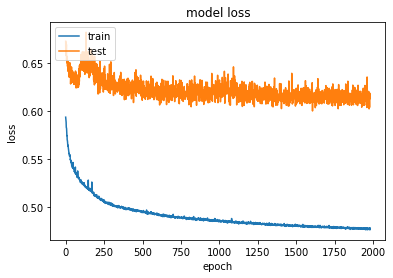

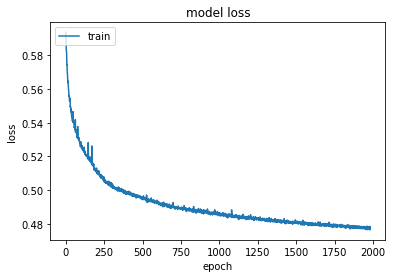

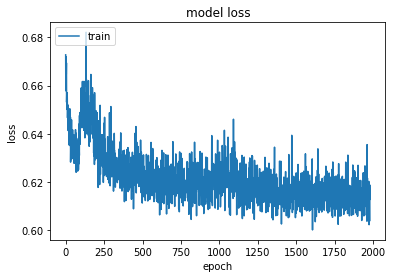

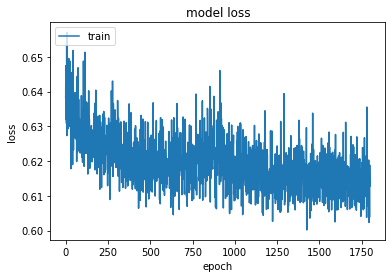

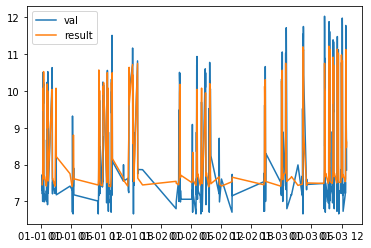

...

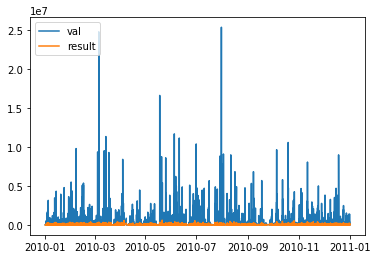

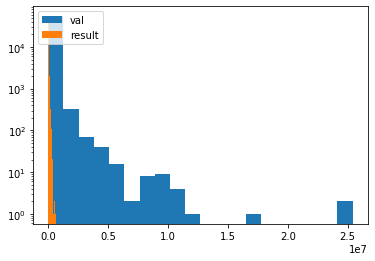

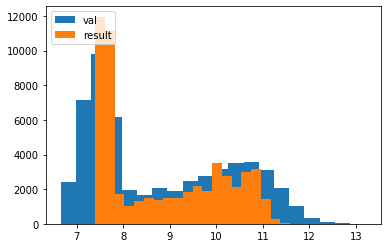

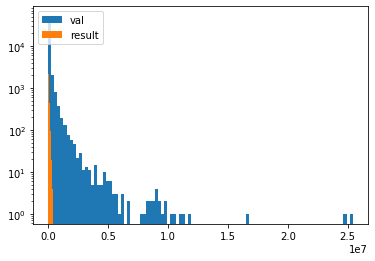

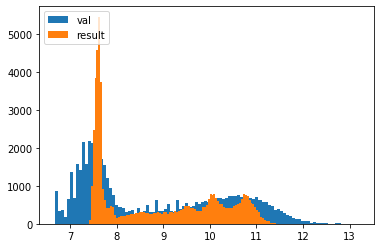

In [18]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model




input2 = Input(shape=(150))
model2 = Dense(256, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(64, kernel_initializer='lecun_normal', activation='selu')(model2)
model2 = Dropout(0.5)(model2)
merged = Dense(16, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(4, kernel_initializer='lecun_normal', activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=2000)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_17 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_52 (Dense)             (None, 256)               38656     
_________________________________________________________________
alpha_dropout_6 (AlphaDropou (None, 256)               0         
_________________________________________________________________
dense_53 (Dense)             (None, 64)                16448     
_________________________________________________________________
alpha_dropout_7 (AlphaDropou (None, 64)                0         
_________________________________________________________________
dense_54 (Dense)             (None, 16)                1040      
_________________________________________________________________
dense_55 (Dense)             (None, 4)                 68  

705/705 [==============================] - 1s 2ms/step - loss: 0.5367 - mse: 0.5367 - val_loss: 6.2747 - val_mse: 6.2747
Epoch 52/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5377 - mse: 0.5377 - val_loss: 6.4847 - val_mse: 6.4847
Epoch 53/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5361 - mse: 0.5361 - val_loss: 7.0297 - val_mse: 7.0297
Epoch 54/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5360 - mse: 0.5360 - val_loss: 6.7724 - val_mse: 6.7724
Epoch 55/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5354 - mse: 0.5354 - val_loss: 7.2143 - val_mse: 7.2143
Epoch 56/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5355 - mse: 0.5355 - val_loss: 6.8587 - val_mse: 6.8587
Epoch 57/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5330 - mse: 0.5330 - val_loss: 7.2021 - val_mse: 7.2021
Epoch 58/600
705/705 [==============================] - 1s 2ms/step - loss:

705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.1227 - val_mse: 5.1227
Epoch 113/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5129 - mse: 0.5129 - val_loss: 5.5304 - val_mse: 5.5304
Epoch 114/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 5.0950 - val_mse: 5.0950
Epoch 115/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5128 - mse: 0.5128 - val_loss: 4.9948 - val_mse: 4.9948
Epoch 116/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5124 - mse: 0.5124 - val_loss: 5.0606 - val_mse: 5.0606
Epoch 117/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5114 - mse: 0.5114 - val_loss: 5.1769 - val_mse: 5.1769
Epoch 118/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5110 - mse: 0.5110 - val_loss: 5.5440 - val_mse: 5.5440
Epoch 119/600
705/705 [==============================] - 1s 2ms/step 

705/705 [==============================] - 1s 2ms/step - loss: 0.5026 - mse: 0.5026 - val_loss: 5.0100 - val_mse: 5.0100
Epoch 173/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5022 - mse: 0.5022 - val_loss: 4.5581 - val_mse: 4.5581
Epoch 174/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5025 - mse: 0.5025 - val_loss: 4.5552 - val_mse: 4.5552
Epoch 175/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5022 - mse: 0.5022 - val_loss: 4.7141 - val_mse: 4.7141
Epoch 176/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5021 - mse: 0.5021 - val_loss: 4.7104 - val_mse: 4.7104
Epoch 177/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5025 - mse: 0.5025 - val_loss: 4.4232 - val_mse: 4.4232
Epoch 178/600
705/705 [==============================] - 1s 2ms/step - loss: 0.5034 - mse: 0.5034 - val_loss: 4.3813 - val_mse: 4.3813
Epoch 179/600
705/705 [==============================] - 1s 2ms/step 

Epoch 233/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4968 - mse: 0.4968 - val_loss: 3.6585 - val_mse: 3.6585
Epoch 234/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4968 - mse: 0.4968 - val_loss: 3.3661 - val_mse: 3.3661
Epoch 235/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4975 - mse: 0.4975 - val_loss: 3.6430 - val_mse: 3.6430
Epoch 236/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4969 - mse: 0.4969 - val_loss: 3.2236 - val_mse: 3.2236
Epoch 237/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4966 - mse: 0.4966 - val_loss: 3.2172 - val_mse: 3.2172
Epoch 238/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4975 - mse: 0.4975 - val_loss: 3.2053 - val_mse: 3.2053
Epoch 239/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4976 - mse: 0.4976 - val_loss: 3.3765 - val_mse: 3.3765
Epoch 240/600
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4930 - mse: 0.4930 - val_loss: 2.6169 - val_mse: 2.6169
Epoch 294/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4922 - mse: 0.4922 - val_loss: 2.9387 - val_mse: 2.9387
Epoch 295/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4922 - mse: 0.4922 - val_loss: 3.1148 - val_mse: 3.1148
Epoch 296/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4926 - mse: 0.4926 - val_loss: 2.9228 - val_mse: 2.9228
Epoch 297/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4920 - mse: 0.4920 - val_loss: 3.2367 - val_mse: 3.2367
Epoch 298/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4919 - mse: 0.4919 - val_loss: 2.8789 - val_mse: 2.8789
Epoch 299/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4923 - mse: 0.4923 - val_loss: 3.1903 - val_mse: 3.1903
Epoch 300/600
705/705 [==============================] - 1s 2ms/step 

Epoch 354/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4838 - mse: 0.4838 - val_loss: 2.7173 - val_mse: 2.7173
Epoch 355/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4833 - mse: 0.4833 - val_loss: 2.6579 - val_mse: 2.6579
Epoch 356/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4839 - mse: 0.4839 - val_loss: 3.1840 - val_mse: 3.1840
Epoch 357/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4830 - mse: 0.4830 - val_loss: 2.5076 - val_mse: 2.5076
Epoch 358/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4843 - mse: 0.4843 - val_loss: 2.7763 - val_mse: 2.7763
Epoch 359/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4834 - mse: 0.4834 - val_loss: 2.6716 - val_mse: 2.6716
Epoch 360/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4841 - mse: 0.4841 - val_loss: 2.8934 - val_mse: 2.8934
Epoch 361/600
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4796 - mse: 0.4796 - val_loss: 0.8688 - val_mse: 0.8688
Epoch 415/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4797 - mse: 0.4797 - val_loss: 0.8679 - val_mse: 0.8679
Epoch 416/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4801 - mse: 0.4801 - val_loss: 0.9144 - val_mse: 0.9144
Epoch 417/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4796 - mse: 0.4796 - val_loss: 0.8985 - val_mse: 0.8985
Epoch 418/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4803 - mse: 0.4803 - val_loss: 0.9266 - val_mse: 0.9266
Epoch 419/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4797 - mse: 0.4797 - val_loss: 0.8894 - val_mse: 0.8894
Epoch 420/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4801 - mse: 0.4801 - val_loss: 0.8199 - val_mse: 0.8199
Epoch 421/600
705/705 [==============================] - 1s 2ms/step 

Epoch 475/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4765 - mse: 0.4765 - val_loss: 0.8886 - val_mse: 0.8886
Epoch 476/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4776 - mse: 0.4776 - val_loss: 0.9022 - val_mse: 0.9022
Epoch 477/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4779 - mse: 0.4779 - val_loss: 0.9615 - val_mse: 0.9615
Epoch 478/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4770 - mse: 0.4770 - val_loss: 0.9744 - val_mse: 0.9744
Epoch 479/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4772 - mse: 0.4772 - val_loss: 1.1184 - val_mse: 1.1184
Epoch 480/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4767 - mse: 0.4767 - val_loss: 0.9768 - val_mse: 0.9768
Epoch 481/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4774 - mse: 0.4774 - val_loss: 0.9719 - val_mse: 0.9719
Epoch 482/600
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4759 - mse: 0.4759 - val_loss: 1.0532 - val_mse: 1.0532
Epoch 536/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4750 - mse: 0.4750 - val_loss: 0.9938 - val_mse: 0.9938
Epoch 537/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4757 - mse: 0.4757 - val_loss: 0.9515 - val_mse: 0.9515
Epoch 538/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4749 - mse: 0.4749 - val_loss: 1.0145 - val_mse: 1.0145
Epoch 539/600
705/705 [==============================] - 2s 3ms/step - loss: 0.4757 - mse: 0.4757 - val_loss: 1.0698 - val_mse: 1.0698
Epoch 540/600
705/705 [==============================] - 2s 3ms/step - loss: 0.4755 - mse: 0.4755 - val_loss: 0.9795 - val_mse: 0.9795
Epoch 541/600
705/705 [==============================] - 2s 3ms/step - loss: 0.4762 - mse: 0.4762 - val_loss: 1.0937 - val_mse: 1.0937
Epoch 542/600
705/705 [==============================] - 2s 2ms/step 

Epoch 596/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4741 - mse: 0.4741 - val_loss: 1.0563 - val_mse: 1.0563
Epoch 597/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4743 - mse: 0.4743 - val_loss: 1.0036 - val_mse: 1.0036
Epoch 598/600
705/705 [==============================] - 2s 2ms/step - loss: 0.4742 - mse: 0.4742 - val_loss: 1.0208 - val_mse: 1.0208
Epoch 599/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4741 - mse: 0.4741 - val_loss: 0.9921 - val_mse: 0.9921
Epoch 600/600
705/705 [==============================] - 1s 2ms/step - loss: 0.4743 - mse: 0.4743 - val_loss: 1.0765 - val_mse: 1.0765


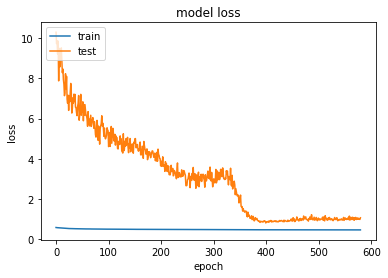

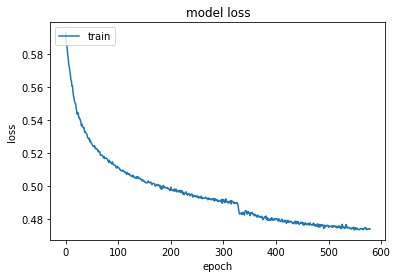

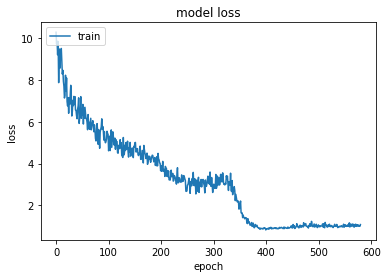

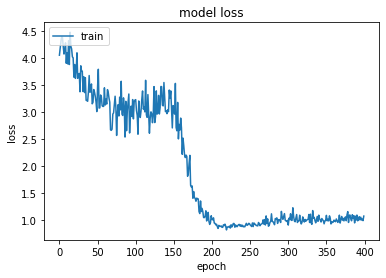

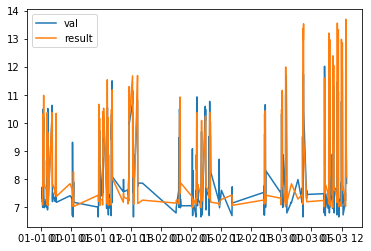

...

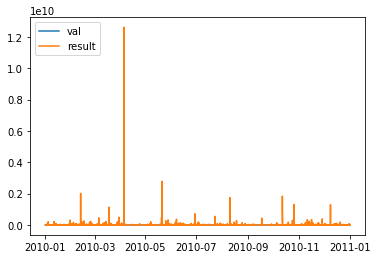

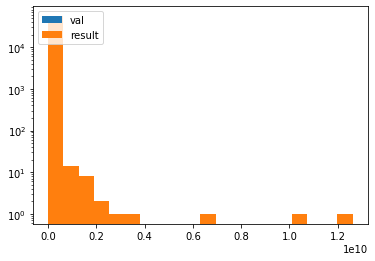

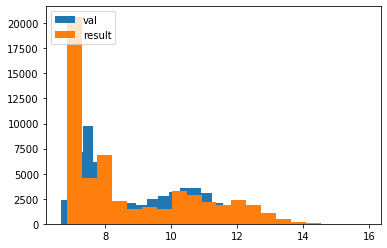

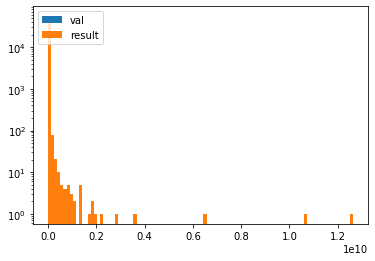

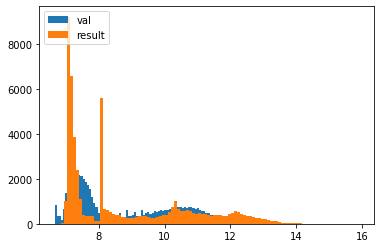

In [19]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model




input2 = Input(shape=(150))
model2 = Dense(256, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(64, kernel_initializer='lecun_normal', activation='selu')(model2)
model2 = AlphaDropout(0.5)(model2)
merged = Dense(16, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(4, kernel_initializer='lecun_normal', activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=600)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_57 (Dense)             (None, 256)               38656     
_________________________________________________________________
alpha_dropout_8 (AlphaDropou (None, 256)               0         
_________________________________________________________________
dense_58 (Dense)             (None, 64)                16448     
_________________________________________________________________
alpha_dropout_9 (AlphaDropou (None, 64)                0         
_________________________________________________________________
dense_59 (Dense)             (None, 16)                1040      
_________________________________________________________________
dense_60 (Dense)             (None, 4)                 68  

705/705 [==============================] - 1s 2ms/step - loss: 0.5417 - mse: 0.5417 - val_loss: 2.4330 - val_mse: 2.4330
Epoch 52/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5417 - mse: 0.5417 - val_loss: 2.1289 - val_mse: 2.1289
Epoch 53/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5413 - mse: 0.5413 - val_loss: 2.0103 - val_mse: 2.0103
Epoch 54/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5395 - mse: 0.5395 - val_loss: 2.1182 - val_mse: 2.1182
Epoch 55/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5396 - mse: 0.5396 - val_loss: 1.9564 - val_mse: 1.9564
Epoch 56/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.5382 - mse: 0.5382 - val_loss: 1.9767 - val_mse: 1.9767
Epoch 57/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5380 - mse: 0.5380 - val_loss: 2.1010 - val_mse: 2.1010
Epoch 58/2000
705/705 [==============================] - 1s 2ms/step 

Epoch 112/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.5205 - mse: 0.5205 - val_loss: 1.8976 - val_mse: 1.8976
Epoch 113/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5186 - mse: 0.5186 - val_loss: 1.8865 - val_mse: 1.8865
Epoch 114/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5178 - mse: 0.5178 - val_loss: 1.8889 - val_mse: 1.8889
Epoch 115/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5189 - mse: 0.5189 - val_loss: 1.6909 - val_mse: 1.6909
Epoch 116/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5192 - mse: 0.5192 - val_loss: 1.5713 - val_mse: 1.5713
Epoch 117/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5180 - mse: 0.5180 - val_loss: 1.7245 - val_mse: 1.7245
Epoch 118/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5181 - mse: 0.5181 - val_loss: 1.6149 - val_mse: 1.6149
Epoch 119/2000
705/705 [========================

705/705 [==============================] - 1s 2ms/step - loss: 0.5096 - mse: 0.5096 - val_loss: 1.5713 - val_mse: 1.5713
Epoch 173/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5093 - mse: 0.5093 - val_loss: 1.6304 - val_mse: 1.6304
Epoch 174/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5103 - mse: 0.5103 - val_loss: 1.6155 - val_mse: 1.6155
Epoch 175/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5105 - mse: 0.5105 - val_loss: 1.5379 - val_mse: 1.5379
Epoch 176/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5089 - mse: 0.5089 - val_loss: 1.5717 - val_mse: 1.5717
Epoch 177/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5096 - mse: 0.5096 - val_loss: 1.5112 - val_mse: 1.5112
Epoch 178/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5097 - mse: 0.5097 - val_loss: 1.5821 - val_mse: 1.5821
Epoch 179/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5051 - mse: 0.5051 - val_loss: 1.7793 - val_mse: 1.7793
Epoch 233/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5045 - mse: 0.5045 - val_loss: 1.8041 - val_mse: 1.8041
Epoch 234/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5032 - mse: 0.5032 - val_loss: 1.5558 - val_mse: 1.5558
Epoch 235/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5053 - mse: 0.5053 - val_loss: 1.6715 - val_mse: 1.6715
Epoch 236/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5049 - mse: 0.5049 - val_loss: 1.7116 - val_mse: 1.7116
Epoch 237/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5034 - mse: 0.5034 - val_loss: 1.7328 - val_mse: 1.7328
Epoch 238/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5033 - mse: 0.5033 - val_loss: 1.6633 - val_mse: 1.6633
Epoch 239/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5007 - mse: 0.5007 - val_loss: 1.7886 - val_mse: 1.7886
Epoch 293/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4999 - mse: 0.4999 - val_loss: 1.6436 - val_mse: 1.6436
Epoch 294/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5002 - mse: 0.5002 - val_loss: 1.5783 - val_mse: 1.5783
Epoch 295/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5009 - mse: 0.5009 - val_loss: 1.7314 - val_mse: 1.7314
Epoch 296/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5020 - mse: 0.5020 - val_loss: 1.7162 - val_mse: 1.7162
Epoch 297/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5009 - mse: 0.5009 - val_loss: 1.6499 - val_mse: 1.6499
Epoch 298/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.5029 - mse: 0.5029 - val_loss: 1.7079 - val_mse: 1.7079
Epoch 299/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4976 - mse: 0.4976 - val_loss: 1.7185 - val_mse: 1.7185
Epoch 353/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4982 - mse: 0.4982 - val_loss: 1.6927 - val_mse: 1.6927
Epoch 354/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4994 - mse: 0.4994 - val_loss: 1.6907 - val_mse: 1.6907
Epoch 355/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4979 - mse: 0.4979 - val_loss: 1.6893 - val_mse: 1.6893
Epoch 356/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4974 - mse: 0.4974 - val_loss: 1.6335 - val_mse: 1.6335
Epoch 357/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4964 - mse: 0.4964 - val_loss: 1.5831 - val_mse: 1.5831
Epoch 358/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4969 - mse: 0.4969 - val_loss: 1.7162 - val_mse: 1.7162
Epoch 359/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4953 - mse: 0.4953 - val_loss: 1.7872 - val_mse: 1.7872
Epoch 413/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4958 - mse: 0.4958 - val_loss: 1.7288 - val_mse: 1.7288
Epoch 414/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4954 - mse: 0.4954 - val_loss: 1.7408 - val_mse: 1.7408
Epoch 415/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4951 - mse: 0.4951 - val_loss: 1.7018 - val_mse: 1.7018
Epoch 416/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4960 - mse: 0.4960 - val_loss: 1.6751 - val_mse: 1.6751
Epoch 417/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4950 - mse: 0.4950 - val_loss: 1.6292 - val_mse: 1.6292
Epoch 418/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4942 - mse: 0.4942 - val_loss: 1.6813 - val_mse: 1.6813
Epoch 419/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4941 - mse: 0.4941 - val_loss: 1.8383 - val_mse: 1.8383
Epoch 473/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4935 - mse: 0.4935 - val_loss: 1.7243 - val_mse: 1.7243
Epoch 474/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4943 - mse: 0.4943 - val_loss: 1.6953 - val_mse: 1.6953
Epoch 475/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4929 - mse: 0.4929 - val_loss: 1.7633 - val_mse: 1.7633
Epoch 476/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4934 - mse: 0.4934 - val_loss: 1.6384 - val_mse: 1.6384
Epoch 477/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4930 - mse: 0.4930 - val_loss: 1.7266 - val_mse: 1.7266
Epoch 478/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4933 - mse: 0.4933 - val_loss: 1.8321 - val_mse: 1.8321
Epoch 479/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4916 - mse: 0.4916 - val_loss: 1.7559 - val_mse: 1.7559
Epoch 533/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4927 - mse: 0.4927 - val_loss: 1.6279 - val_mse: 1.6279
Epoch 534/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4921 - mse: 0.4921 - val_loss: 1.7814 - val_mse: 1.7814
Epoch 535/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4925 - mse: 0.4925 - val_loss: 1.7384 - val_mse: 1.7384
Epoch 536/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4915 - mse: 0.4915 - val_loss: 1.6991 - val_mse: 1.6991
Epoch 537/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4918 - mse: 0.4918 - val_loss: 1.8544 - val_mse: 1.8544
Epoch 538/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4907 - mse: 0.4907 - val_loss: 1.7230 - val_mse: 1.7230
Epoch 539/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4899 - mse: 0.4899 - val_loss: 1.6717 - val_mse: 1.6717
Epoch 593/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4915 - mse: 0.4915 - val_loss: 1.7080 - val_mse: 1.7080
Epoch 594/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4916 - mse: 0.4916 - val_loss: 1.6957 - val_mse: 1.6957
Epoch 595/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4900 - mse: 0.4900 - val_loss: 1.7487 - val_mse: 1.7487
Epoch 596/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4902 - mse: 0.4902 - val_loss: 1.7228 - val_mse: 1.7228
Epoch 597/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4901 - mse: 0.4901 - val_loss: 1.7207 - val_mse: 1.7207
Epoch 598/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4901 - mse: 0.4901 - val_loss: 1.6833 - val_mse: 1.6833
Epoch 599/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4904 - mse: 0.4904 - val_loss: 1.7404 - val_mse: 1.7404
Epoch 653/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4905 - mse: 0.4905 - val_loss: 1.9155 - val_mse: 1.9155
Epoch 654/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4895 - mse: 0.4895 - val_loss: 1.8177 - val_mse: 1.8177
Epoch 655/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4898 - mse: 0.4898 - val_loss: 1.9785 - val_mse: 1.9785
Epoch 656/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4891 - mse: 0.4891 - val_loss: 1.8024 - val_mse: 1.8024
Epoch 657/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4890 - mse: 0.4890 - val_loss: 1.8850 - val_mse: 1.8850
Epoch 658/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4887 - mse: 0.4887 - val_loss: 1.9364 - val_mse: 1.9364
Epoch 659/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4882 - mse: 0.4882 - val_loss: 1.7585 - val_mse: 1.7585
Epoch 713/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4884 - mse: 0.4884 - val_loss: 1.7080 - val_mse: 1.7080
Epoch 714/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4873 - mse: 0.4873 - val_loss: 1.6903 - val_mse: 1.6903
Epoch 715/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4892 - mse: 0.4892 - val_loss: 1.7334 - val_mse: 1.7334
Epoch 716/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4880 - mse: 0.4880 - val_loss: 1.8961 - val_mse: 1.8961
Epoch 717/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4876 - mse: 0.4876 - val_loss: 1.7915 - val_mse: 1.7915
Epoch 718/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4868 - mse: 0.4868 - val_loss: 1.7874 - val_mse: 1.7874
Epoch 719/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4870 - mse: 0.4870 - val_loss: 1.8773 - val_mse: 1.8773
Epoch 773/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4905 - mse: 0.4905 - val_loss: 1.7464 - val_mse: 1.7464
Epoch 774/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4884 - mse: 0.4884 - val_loss: 1.6149 - val_mse: 1.6149
Epoch 775/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4886 - mse: 0.4886 - val_loss: 1.8120 - val_mse: 1.8120
Epoch 776/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4868 - mse: 0.4868 - val_loss: 1.6508 - val_mse: 1.6508
Epoch 777/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4872 - mse: 0.4872 - val_loss: 1.9083 - val_mse: 1.9083
Epoch 778/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4869 - mse: 0.4869 - val_loss: 1.8749 - val_mse: 1.8749
Epoch 779/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4871 - mse: 0.4871 - val_loss: 1.8108 - val_mse: 1.8108
Epoch 833/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4864 - mse: 0.4864 - val_loss: 1.7615 - val_mse: 1.7615
Epoch 834/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4866 - mse: 0.4866 - val_loss: 1.7848 - val_mse: 1.7848
Epoch 835/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4880 - mse: 0.4880 - val_loss: 1.8368 - val_mse: 1.8368
Epoch 836/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4867 - mse: 0.4867 - val_loss: 1.6494 - val_mse: 1.6494
Epoch 837/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 1.9710 - val_mse: 1.9710
Epoch 838/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4862 - mse: 0.4862 - val_loss: 1.6911 - val_mse: 1.6911
Epoch 839/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4846 - mse: 0.4846 - val_loss: 1.7128 - val_mse: 1.7128
Epoch 893/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4858 - mse: 0.4858 - val_loss: 1.8377 - val_mse: 1.8377
Epoch 894/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4871 - mse: 0.4871 - val_loss: 1.7425 - val_mse: 1.7425
Epoch 895/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4867 - mse: 0.4867 - val_loss: 1.6429 - val_mse: 1.6429
Epoch 896/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4855 - mse: 0.4855 - val_loss: 1.8113 - val_mse: 1.8113
Epoch 897/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4853 - mse: 0.4853 - val_loss: 1.7470 - val_mse: 1.7470
Epoch 898/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4852 - mse: 0.4852 - val_loss: 1.9523 - val_mse: 1.9523
Epoch 899/2000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4846 - mse: 0.4846 - val_loss: 1.8231 - val_mse: 1.8231
Epoch 953/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4847 - mse: 0.4847 - val_loss: 1.8205 - val_mse: 1.8205
Epoch 954/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4840 - mse: 0.4840 - val_loss: 1.7148 - val_mse: 1.7148
Epoch 955/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4845 - mse: 0.4845 - val_loss: 1.8864 - val_mse: 1.8864
Epoch 956/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 1.8346 - val_mse: 1.8346
Epoch 957/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4859 - mse: 0.4859 - val_loss: 1.6282 - val_mse: 1.6282
Epoch 958/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4868 - mse: 0.4868 - val_loss: 1.8228 - val_mse: 1.8228
Epoch 959/2000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4906 - mse: 0.4906 - val_loss: 1.7839 - val_mse: 1.7839
Epoch 1013/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4899 - mse: 0.4899 - val_loss: 1.9272 - val_mse: 1.9272
Epoch 1014/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4875 - mse: 0.4875 - val_loss: 1.7491 - val_mse: 1.7491
Epoch 1015/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4842 - mse: 0.4842 - val_loss: 1.7054 - val_mse: 1.7054
Epoch 1016/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4844 - mse: 0.4844 - val_loss: 1.9389 - val_mse: 1.9389
Epoch 1017/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4842 - mse: 0.4842 - val_loss: 1.8228 - val_mse: 1.8228
Epoch 1018/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4850 - mse: 0.4850 - val_loss: 1.9615 - val_mse: 1.9615
Epoch 1019/2000
705/705 [==============================] 

Epoch 1072/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4865 - mse: 0.4865 - val_loss: 1.5297 - val_mse: 1.5297
Epoch 1073/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 1.4616 - val_mse: 1.4616
Epoch 1074/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4849 - mse: 0.4849 - val_loss: 1.5051 - val_mse: 1.5051
Epoch 1075/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4868 - mse: 0.4868 - val_loss: 1.5307 - val_mse: 1.5307
Epoch 1076/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4844 - mse: 0.4844 - val_loss: 1.4479 - val_mse: 1.4479
Epoch 1077/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4848 - mse: 0.4848 - val_loss: 1.5400 - val_mse: 1.5400
Epoch 1078/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4838 - mse: 0.4838 - val_loss: 1.4524 - val_mse: 1.4524
Epoch 1079/2000
705/705 [================

Epoch 1132/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4934 - mse: 0.4934 - val_loss: 1.5172 - val_mse: 1.5172
Epoch 1133/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 1.5500 - val_mse: 1.5500
Epoch 1134/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4846 - mse: 0.4846 - val_loss: 1.5302 - val_mse: 1.5302
Epoch 1135/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4835 - mse: 0.4835 - val_loss: 1.5703 - val_mse: 1.5703
Epoch 1136/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4851 - mse: 0.4851 - val_loss: 1.4729 - val_mse: 1.4729
Epoch 1137/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4854 - mse: 0.4854 - val_loss: 1.5296 - val_mse: 1.5296
Epoch 1138/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4848 - mse: 0.4848 - val_loss: 1.5104 - val_mse: 1.5104
Epoch 1139/2000
705/705 [================

Epoch 1192/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4856 - mse: 0.4856 - val_loss: 1.5444 - val_mse: 1.5444
Epoch 1193/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4860 - mse: 0.4860 - val_loss: 1.6911 - val_mse: 1.6911
Epoch 1194/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4870 - mse: 0.4870 - val_loss: 1.3974 - val_mse: 1.3974
Epoch 1195/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4838 - mse: 0.4838 - val_loss: 1.5161 - val_mse: 1.5161
Epoch 1196/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4854 - mse: 0.4854 - val_loss: 1.4882 - val_mse: 1.4882
Epoch 1197/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4855 - mse: 0.4855 - val_loss: 1.5442 - val_mse: 1.5442
Epoch 1198/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4844 - mse: 0.4844 - val_loss: 1.6024 - val_mse: 1.6024
Epoch 1199/2000
705/705 [================

Epoch 1252/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4700 - mse: 0.4700 - val_loss: 1.5561 - val_mse: 1.5561
Epoch 1253/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4699 - mse: 0.4699 - val_loss: 1.4360 - val_mse: 1.4360
Epoch 1254/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4718 - mse: 0.4718 - val_loss: 1.6648 - val_mse: 1.6648
Epoch 1255/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4709 - mse: 0.4709 - val_loss: 1.5221 - val_mse: 1.5221
Epoch 1256/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4711 - mse: 0.4711 - val_loss: 1.5293 - val_mse: 1.5293
Epoch 1257/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4719 - mse: 0.4719 - val_loss: 1.4512 - val_mse: 1.4512
Epoch 1258/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4706 - mse: 0.4706 - val_loss: 1.6013 - val_mse: 1.6013
Epoch 1259/2000
705/705 [================

Epoch 1312/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4705 - mse: 0.4705 - val_loss: 1.5046 - val_mse: 1.5046
Epoch 1313/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4714 - mse: 0.4714 - val_loss: 1.3098 - val_mse: 1.3098
Epoch 1314/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4719 - mse: 0.4719 - val_loss: 1.4554 - val_mse: 1.4554
Epoch 1315/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4709 - mse: 0.4709 - val_loss: 1.3751 - val_mse: 1.3751
Epoch 1316/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4696 - mse: 0.4696 - val_loss: 1.3162 - val_mse: 1.3162
Epoch 1317/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4702 - mse: 0.4702 - val_loss: 1.2888 - val_mse: 1.2888
Epoch 1318/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4701 - mse: 0.4701 - val_loss: 1.4197 - val_mse: 1.4197
Epoch 1319/2000
705/705 [================

Epoch 1372/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4676 - mse: 0.4676 - val_loss: 1.4428 - val_mse: 1.4428
Epoch 1373/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4685 - mse: 0.4685 - val_loss: 1.5759 - val_mse: 1.5759
Epoch 1374/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4679 - mse: 0.4679 - val_loss: 1.6488 - val_mse: 1.6488
Epoch 1375/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4682 - mse: 0.4682 - val_loss: 1.4628 - val_mse: 1.4628
Epoch 1376/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4686 - mse: 0.4686 - val_loss: 1.5196 - val_mse: 1.5196
Epoch 1377/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4674 - mse: 0.4674 - val_loss: 1.6040 - val_mse: 1.6040
Epoch 1378/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4680 - mse: 0.4680 - val_loss: 1.6597 - val_mse: 1.6597
Epoch 1379/2000
705/705 [================

Epoch 1432/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4671 - mse: 0.4671 - val_loss: 1.7993 - val_mse: 1.7993
Epoch 1433/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4680 - mse: 0.4680 - val_loss: 1.7617 - val_mse: 1.7617
Epoch 1434/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4680 - mse: 0.4680 - val_loss: 1.7184 - val_mse: 1.7184
Epoch 1435/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4679 - mse: 0.4679 - val_loss: 1.6684 - val_mse: 1.6684
Epoch 1436/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4685 - mse: 0.4685 - val_loss: 1.7223 - val_mse: 1.7223
Epoch 1437/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4676 - mse: 0.4676 - val_loss: 1.6175 - val_mse: 1.6175
Epoch 1438/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4687 - mse: 0.4687 - val_loss: 1.7214 - val_mse: 1.7214
Epoch 1439/2000
705/705 [================

Epoch 1492/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4669 - mse: 0.4669 - val_loss: 1.8334 - val_mse: 1.8334
Epoch 1493/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4681 - mse: 0.4681 - val_loss: 1.8550 - val_mse: 1.8550
Epoch 1494/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4668 - mse: 0.4668 - val_loss: 1.7874 - val_mse: 1.7874
Epoch 1495/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4674 - mse: 0.4674 - val_loss: 1.7818 - val_mse: 1.7818
Epoch 1496/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4676 - mse: 0.4676 - val_loss: 1.8781 - val_mse: 1.8781
Epoch 1497/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4678 - mse: 0.4678 - val_loss: 1.8540 - val_mse: 1.8540
Epoch 1498/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4668 - mse: 0.4668 - val_loss: 1.8475 - val_mse: 1.8475
Epoch 1499/2000
705/705 [================

Epoch 1552/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4675 - mse: 0.4675 - val_loss: 1.9859 - val_mse: 1.9859
Epoch 1553/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4666 - mse: 0.4666 - val_loss: 1.8282 - val_mse: 1.8282
Epoch 1554/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4668 - mse: 0.4668 - val_loss: 1.8468 - val_mse: 1.8468
Epoch 1555/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4672 - mse: 0.4672 - val_loss: 2.1250 - val_mse: 2.1250
Epoch 1556/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4673 - mse: 0.4673 - val_loss: 1.9415 - val_mse: 1.9415
Epoch 1557/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4660 - mse: 0.4660 - val_loss: 1.8997 - val_mse: 1.8997
Epoch 1558/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4670 - mse: 0.4670 - val_loss: 1.8713 - val_mse: 1.8713
Epoch 1559/2000
705/705 [================

Epoch 1612/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4663 - mse: 0.4663 - val_loss: 1.9997 - val_mse: 1.9997
Epoch 1613/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4675 - mse: 0.4675 - val_loss: 1.9972 - val_mse: 1.9972
Epoch 1614/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4664 - mse: 0.4664 - val_loss: 1.9377 - val_mse: 1.9377
Epoch 1615/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4671 - mse: 0.4671 - val_loss: 1.8953 - val_mse: 1.8953
Epoch 1616/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4665 - mse: 0.4665 - val_loss: 2.1457 - val_mse: 2.1457
Epoch 1617/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4673 - mse: 0.4673 - val_loss: 1.8769 - val_mse: 1.8769
Epoch 1618/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4673 - mse: 0.4673 - val_loss: 2.1490 - val_mse: 2.1490
Epoch 1619/2000
705/705 [================

Epoch 1672/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4662 - mse: 0.4662 - val_loss: 2.0956 - val_mse: 2.0956
Epoch 1673/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4658 - mse: 0.4658 - val_loss: 1.8790 - val_mse: 1.8790
Epoch 1674/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4666 - mse: 0.4666 - val_loss: 1.9600 - val_mse: 1.9600
Epoch 1675/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4666 - mse: 0.4666 - val_loss: 2.1014 - val_mse: 2.1014
Epoch 1676/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4674 - mse: 0.4674 - val_loss: 2.0529 - val_mse: 2.0529
Epoch 1677/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4665 - mse: 0.4665 - val_loss: 2.0722 - val_mse: 2.0722
Epoch 1678/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4668 - mse: 0.4668 - val_loss: 1.9107 - val_mse: 1.9107
Epoch 1679/2000
705/705 [================

Epoch 1732/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4659 - mse: 0.4659 - val_loss: 2.2005 - val_mse: 2.2005
Epoch 1733/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 2.2953 - val_mse: 2.2953
Epoch 1734/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4659 - mse: 0.4659 - val_loss: 2.0056 - val_mse: 2.0056
Epoch 1735/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4668 - mse: 0.4668 - val_loss: 1.9914 - val_mse: 1.9914
Epoch 1736/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4660 - mse: 0.4660 - val_loss: 2.0852 - val_mse: 2.0852
Epoch 1737/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4657 - mse: 0.4657 - val_loss: 2.1312 - val_mse: 2.1312
Epoch 1738/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4651 - mse: 0.4651 - val_loss: 2.2674 - val_mse: 2.2674
Epoch 1739/2000
705/705 [================

Epoch 1792/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 2.1938 - val_mse: 2.1938
Epoch 1793/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4652 - mse: 0.4652 - val_loss: 2.0571 - val_mse: 2.0571
Epoch 1794/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 2.1568 - val_mse: 2.1568
Epoch 1795/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4663 - mse: 0.4663 - val_loss: 2.1397 - val_mse: 2.1397
Epoch 1796/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4663 - mse: 0.4663 - val_loss: 2.1448 - val_mse: 2.1448
Epoch 1797/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4652 - mse: 0.4652 - val_loss: 2.1780 - val_mse: 2.1780
Epoch 1798/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4661 - mse: 0.4661 - val_loss: 2.0105 - val_mse: 2.0105
Epoch 1799/2000
705/705 [================

Epoch 1852/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 2.1972 - val_mse: 2.1972
Epoch 1853/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4652 - mse: 0.4652 - val_loss: 2.1311 - val_mse: 2.1311
Epoch 1854/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4650 - mse: 0.4650 - val_loss: 2.2881 - val_mse: 2.2881
Epoch 1855/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4649 - mse: 0.4649 - val_loss: 2.1392 - val_mse: 2.1392
Epoch 1856/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4652 - mse: 0.4652 - val_loss: 2.2274 - val_mse: 2.2274
Epoch 1857/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4652 - mse: 0.4652 - val_loss: 2.1182 - val_mse: 2.1182
Epoch 1858/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4657 - mse: 0.4657 - val_loss: 2.2124 - val_mse: 2.2124
Epoch 1859/2000
705/705 [================

Epoch 1912/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4657 - mse: 0.4657 - val_loss: 2.2703 - val_mse: 2.2703
Epoch 1913/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 2.2099 - val_mse: 2.2099
Epoch 1914/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4644 - mse: 0.4644 - val_loss: 2.1534 - val_mse: 2.1534
Epoch 1915/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4654 - mse: 0.4654 - val_loss: 2.1501 - val_mse: 2.1501
Epoch 1916/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4650 - mse: 0.4650 - val_loss: 2.1003 - val_mse: 2.1003
Epoch 1917/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4647 - mse: 0.4647 - val_loss: 2.2273 - val_mse: 2.2273
Epoch 1918/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4653 - mse: 0.4653 - val_loss: 2.0891 - val_mse: 2.0891
Epoch 1919/2000
705/705 [================

Epoch 1972/2000
705/705 [==============================] - 2s 3ms/step - loss: 0.4644 - mse: 0.4644 - val_loss: 2.4037 - val_mse: 2.4037
Epoch 1973/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4645 - mse: 0.4645 - val_loss: 2.1887 - val_mse: 2.1887
Epoch 1974/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4651 - mse: 0.4651 - val_loss: 2.3911 - val_mse: 2.3911
Epoch 1975/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4650 - mse: 0.4650 - val_loss: 2.1180 - val_mse: 2.1180
Epoch 1976/2000
705/705 [==============================] - 1s 2ms/step - loss: 0.4646 - mse: 0.4646 - val_loss: 2.4514 - val_mse: 2.4514
Epoch 1977/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4645 - mse: 0.4645 - val_loss: 2.2689 - val_mse: 2.2689
Epoch 1978/2000
705/705 [==============================] - 2s 2ms/step - loss: 0.4649 - mse: 0.4649 - val_loss: 2.1703 - val_mse: 2.1703
Epoch 1979/2000
705/705 [================

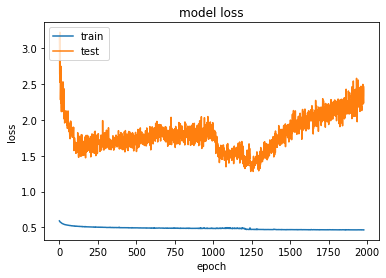

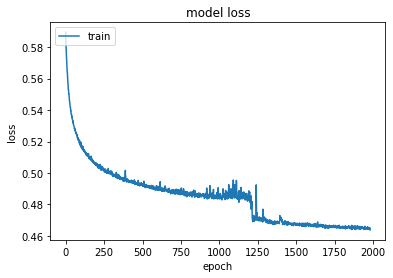

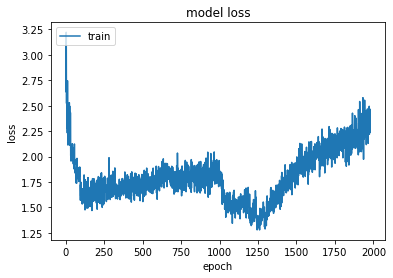

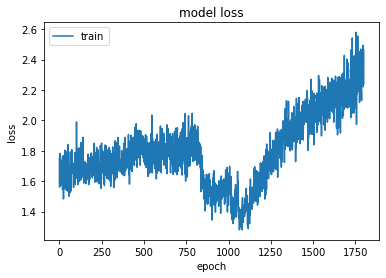

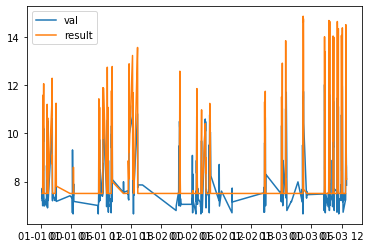

...

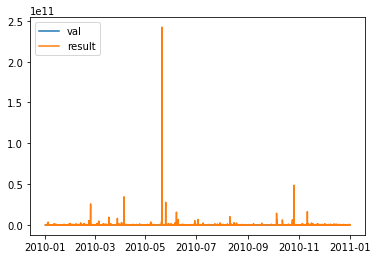

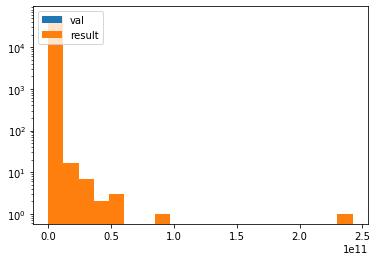

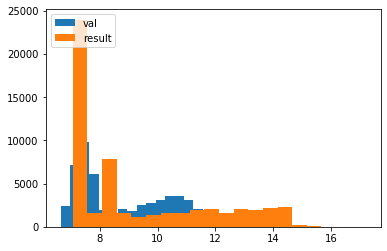

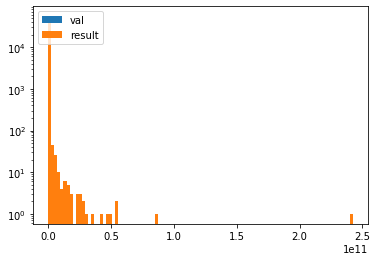

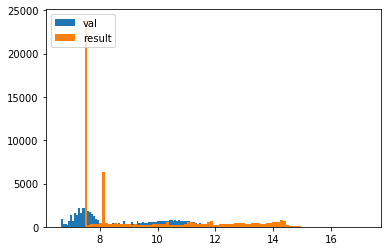

In [20]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model




input2 = Input(shape=(150))
model2 = Dense(256, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(64, kernel_initializer='lecun_normal', activation='selu')(model2)
model2 = AlphaDropout(0.5)(model2)
merged = Dense(16, kernel_initializer='lecun_normal', activation='selu')(model2)
merged = Dense(4, kernel_initializer='lecun_normal', activation='selu')(merged)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=2000)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_19 (InputLayer)        [(None, 150)]             0         
_________________________________________________________________
dense_62 (Dense)             (None, 256)               38656     
_________________________________________________________________
alpha_dropout_10 (AlphaDropo (None, 256)               0         
_________________________________________________________________
dense_63 (Dense)             (None, 64)                16448     
_________________________________________________________________
alpha_dropout_11 (AlphaDropo (None, 64)                0         
_________________________________________________________________
dense_64 (Dense)             (None, 16)                1040      
_________________________________________________________________
dense_65 (Dense)             (None, 1)                 17 

Epoch 52/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5745 - mse: 0.5745 - val_loss: 6.4299 - val_mse: 6.4299
Epoch 53/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5750 - mse: 0.5750 - val_loss: 6.2348 - val_mse: 6.2348
Epoch 54/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5747 - mse: 0.5747 - val_loss: 6.1111 - val_mse: 6.1111
Epoch 55/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5737 - mse: 0.5737 - val_loss: 7.0156 - val_mse: 7.0156
Epoch 56/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5727 - mse: 0.5727 - val_loss: 6.0916 - val_mse: 6.0916
Epoch 57/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5723 - mse: 0.5723 - val_loss: 6.7267 - val_mse: 6.7267
Epoch 58/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5719 - mse: 0.5719 - val_loss: 5.8440 - val_mse: 5.8440
Epoch 59/5000
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.5508 - mse: 0.5508 - val_loss: 4.0797 - val_mse: 4.0797
Epoch 113/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5504 - mse: 0.5504 - val_loss: 4.0670 - val_mse: 4.0670
Epoch 114/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5506 - mse: 0.5506 - val_loss: 3.9930 - val_mse: 3.9930
Epoch 115/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5512 - mse: 0.5512 - val_loss: 4.0378 - val_mse: 4.0378
Epoch 116/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5502 - mse: 0.5502 - val_loss: 4.0522 - val_mse: 4.0522
Epoch 117/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5494 - mse: 0.5494 - val_loss: 3.9533 - val_mse: 3.9533
Epoch 118/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5487 - mse: 0.5487 - val_loss: 3.7678 - val_mse: 3.7678
Epoch 119/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5408 - mse: 0.5408 - val_loss: 3.7649 - val_mse: 3.7649
Epoch 173/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5397 - mse: 0.5397 - val_loss: 3.2138 - val_mse: 3.2138
Epoch 174/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5401 - mse: 0.5401 - val_loss: 3.5811 - val_mse: 3.5811
Epoch 175/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5396 - mse: 0.5396 - val_loss: 3.5694 - val_mse: 3.5694
Epoch 176/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5401 - mse: 0.5401 - val_loss: 3.4386 - val_mse: 3.4386
Epoch 177/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5390 - mse: 0.5390 - val_loss: 3.3091 - val_mse: 3.3091
Epoch 178/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5403 - mse: 0.5403 - val_loss: 3.6230 - val_mse: 3.6230
Epoch 179/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5347 - mse: 0.5347 - val_loss: 3.1962 - val_mse: 3.1962
Epoch 233/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5338 - mse: 0.5338 - val_loss: 3.4168 - val_mse: 3.4168
Epoch 234/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5349 - mse: 0.5349 - val_loss: 3.7060 - val_mse: 3.7060
Epoch 235/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5343 - mse: 0.5343 - val_loss: 3.5535 - val_mse: 3.5535
Epoch 236/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5344 - mse: 0.5344 - val_loss: 3.6732 - val_mse: 3.6732
Epoch 237/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5353 - mse: 0.5353 - val_loss: 3.7031 - val_mse: 3.7031
Epoch 238/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5337 - mse: 0.5337 - val_loss: 3.4684 - val_mse: 3.4684
Epoch 239/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5311 - mse: 0.5311 - val_loss: 3.3956 - val_mse: 3.3956
Epoch 293/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5306 - mse: 0.5306 - val_loss: 3.5345 - val_mse: 3.5345
Epoch 294/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5308 - mse: 0.5308 - val_loss: 3.3049 - val_mse: 3.3049
Epoch 295/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5308 - mse: 0.5308 - val_loss: 3.2933 - val_mse: 3.2933
Epoch 296/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5298 - mse: 0.5298 - val_loss: 3.6969 - val_mse: 3.6969
Epoch 297/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5307 - mse: 0.5307 - val_loss: 3.4424 - val_mse: 3.4424
Epoch 298/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5312 - mse: 0.5312 - val_loss: 3.5352 - val_mse: 3.5352
Epoch 299/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.5280 - mse: 0.5280 - val_loss: 3.7658 - val_mse: 3.7658
Epoch 353/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5290 - mse: 0.5290 - val_loss: 3.4941 - val_mse: 3.4941
Epoch 354/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5276 - mse: 0.5276 - val_loss: 3.7319 - val_mse: 3.7319
Epoch 355/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5272 - mse: 0.5272 - val_loss: 3.6203 - val_mse: 3.6203
Epoch 356/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5267 - mse: 0.5267 - val_loss: 3.4366 - val_mse: 3.4366
Epoch 357/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5271 - mse: 0.5271 - val_loss: 3.4883 - val_mse: 3.4883
Epoch 358/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5268 - mse: 0.5268 - val_loss: 3.8463 - val_mse: 3.8463
Epoch 359/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.5253 - mse: 0.5253 - val_loss: 3.8144 - val_mse: 3.8144
Epoch 413/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5266 - mse: 0.5266 - val_loss: 3.2517 - val_mse: 3.2517
Epoch 414/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5271 - mse: 0.5271 - val_loss: 3.3745 - val_mse: 3.3745
Epoch 415/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5252 - mse: 0.5252 - val_loss: 3.8917 - val_mse: 3.8917
Epoch 416/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5260 - mse: 0.5260 - val_loss: 3.5589 - val_mse: 3.5589
Epoch 417/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5258 - mse: 0.5258 - val_loss: 3.7375 - val_mse: 3.7375
Epoch 418/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5256 - mse: 0.5256 - val_loss: 3.8296 - val_mse: 3.8296
Epoch 419/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5245 - mse: 0.5245 - val_loss: 4.0755 - val_mse: 4.0755
Epoch 473/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5242 - mse: 0.5242 - val_loss: 3.8361 - val_mse: 3.8361
Epoch 474/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5235 - mse: 0.5235 - val_loss: 4.2079 - val_mse: 4.2079
Epoch 475/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5255 - mse: 0.5255 - val_loss: 3.4622 - val_mse: 3.4622
Epoch 476/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5257 - mse: 0.5257 - val_loss: 3.5897 - val_mse: 3.5897
Epoch 477/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5240 - mse: 0.5240 - val_loss: 3.6087 - val_mse: 3.6087
Epoch 478/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5234 - mse: 0.5234 - val_loss: 3.9780 - val_mse: 3.9780
Epoch 479/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5265 - mse: 0.5265 - val_loss: 4.0347 - val_mse: 4.0347
Epoch 533/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5256 - mse: 0.5256 - val_loss: 3.6827 - val_mse: 3.6827
Epoch 534/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5264 - mse: 0.5264 - val_loss: 3.6524 - val_mse: 3.6524
Epoch 535/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5252 - mse: 0.5252 - val_loss: 3.8983 - val_mse: 3.8983
Epoch 536/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5254 - mse: 0.5254 - val_loss: 3.6755 - val_mse: 3.6755
Epoch 537/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5253 - mse: 0.5253 - val_loss: 3.5654 - val_mse: 3.5654
Epoch 538/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5260 - mse: 0.5260 - val_loss: 4.2359 - val_mse: 4.2359
Epoch 539/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5235 - mse: 0.5235 - val_loss: 3.9929 - val_mse: 3.9929
Epoch 593/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5238 - mse: 0.5238 - val_loss: 4.1954 - val_mse: 4.1954
Epoch 594/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5245 - mse: 0.5245 - val_loss: 4.7461 - val_mse: 4.7461
Epoch 595/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5244 - mse: 0.5244 - val_loss: 4.2762 - val_mse: 4.2762
Epoch 596/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5247 - mse: 0.5247 - val_loss: 4.3927 - val_mse: 4.3927
Epoch 597/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5247 - mse: 0.5247 - val_loss: 4.2637 - val_mse: 4.2637
Epoch 598/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5234 - mse: 0.5234 - val_loss: 4.5888 - val_mse: 4.5888
Epoch 599/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5227 - mse: 0.5227 - val_loss: 4.3472 - val_mse: 4.3472
Epoch 653/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5226 - mse: 0.5226 - val_loss: 4.3369 - val_mse: 4.3369
Epoch 654/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5229 - mse: 0.5229 - val_loss: 4.9652 - val_mse: 4.9652
Epoch 655/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5232 - mse: 0.5232 - val_loss: 4.8856 - val_mse: 4.8856
Epoch 656/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5225 - mse: 0.5225 - val_loss: 4.2553 - val_mse: 4.2553
Epoch 657/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5226 - mse: 0.5226 - val_loss: 4.4878 - val_mse: 4.4878
Epoch 658/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5225 - mse: 0.5225 - val_loss: 4.8910 - val_mse: 4.8910
Epoch 659/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 3ms/step - loss: 0.5216 - mse: 0.5216 - val_loss: 5.1097 - val_mse: 5.1097
Epoch 713/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5215 - mse: 0.5215 - val_loss: 4.6777 - val_mse: 4.6777
Epoch 714/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5215 - mse: 0.5215 - val_loss: 5.0093 - val_mse: 5.0093
Epoch 715/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5221 - mse: 0.5221 - val_loss: 4.9332 - val_mse: 4.9332
Epoch 716/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5236 - mse: 0.5236 - val_loss: 5.1079 - val_mse: 5.1079
Epoch 717/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5227 - mse: 0.5227 - val_loss: 4.7177 - val_mse: 4.7177
Epoch 718/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5227 - mse: 0.5227 - val_loss: 4.7911 - val_mse: 4.7911
Epoch 719/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.5227 - mse: 0.5227 - val_loss: 5.3667 - val_mse: 5.3667
Epoch 773/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5215 - mse: 0.5215 - val_loss: 5.3044 - val_mse: 5.3044
Epoch 774/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5204 - mse: 0.5204 - val_loss: 5.1763 - val_mse: 5.1763
Epoch 775/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5221 - mse: 0.5221 - val_loss: 5.3865 - val_mse: 5.3865
Epoch 776/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5214 - mse: 0.5214 - val_loss: 4.9931 - val_mse: 4.9931
Epoch 777/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5211 - mse: 0.5211 - val_loss: 5.0848 - val_mse: 5.0848
Epoch 778/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5213 - mse: 0.5213 - val_loss: 5.3528 - val_mse: 5.3528
Epoch 779/5000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5203 - mse: 0.5203 - val_loss: 6.0928 - val_mse: 6.0928
Epoch 833/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5215 - mse: 0.5215 - val_loss: 5.8522 - val_mse: 5.8522
Epoch 834/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5205 - mse: 0.5205 - val_loss: 6.0883 - val_mse: 6.0883
Epoch 835/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5209 - mse: 0.5209 - val_loss: 5.6660 - val_mse: 5.6660
Epoch 836/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5203 - mse: 0.5203 - val_loss: 5.3973 - val_mse: 5.3973
Epoch 837/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5215 - mse: 0.5215 - val_loss: 5.3377 - val_mse: 5.3377
Epoch 838/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5207 - mse: 0.5207 - val_loss: 6.1707 - val_mse: 6.1707
Epoch 839/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5210 - mse: 0.5210 - val_loss: 5.9937 - val_mse: 5.9937
Epoch 893/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5200 - mse: 0.5200 - val_loss: 5.9662 - val_mse: 5.9662
Epoch 894/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5202 - mse: 0.5202 - val_loss: 6.1858 - val_mse: 6.1858
Epoch 895/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5205 - mse: 0.5205 - val_loss: 5.1938 - val_mse: 5.1938
Epoch 896/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5192 - mse: 0.5192 - val_loss: 6.0856 - val_mse: 6.0856
Epoch 897/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5207 - mse: 0.5207 - val_loss: 4.8920 - val_mse: 4.8920
Epoch 898/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5196 - mse: 0.5196 - val_loss: 5.9350 - val_mse: 5.9350
Epoch 899/5000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 1s 2ms/step - loss: 0.5191 - mse: 0.5191 - val_loss: 6.0007 - val_mse: 6.0007
Epoch 953/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5205 - mse: 0.5205 - val_loss: 6.1029 - val_mse: 6.1029
Epoch 954/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5204 - mse: 0.5204 - val_loss: 6.0363 - val_mse: 6.0363
Epoch 955/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5195 - mse: 0.5195 - val_loss: 6.1480 - val_mse: 6.1480
Epoch 956/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 5.5817 - val_mse: 5.5817
Epoch 957/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5204 - mse: 0.5204 - val_loss: 6.0816 - val_mse: 6.0816
Epoch 958/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5202 - mse: 0.5202 - val_loss: 5.7015 - val_mse: 5.7015
Epoch 959/5000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.5196 - mse: 0.5196 - val_loss: 6.0054 - val_mse: 6.0054
Epoch 1013/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5189 - mse: 0.5189 - val_loss: 5.4227 - val_mse: 5.4227
Epoch 1014/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5191 - mse: 0.5191 - val_loss: 5.4759 - val_mse: 5.4759
Epoch 1015/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5192 - mse: 0.5192 - val_loss: 6.3871 - val_mse: 6.3871
Epoch 1016/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5206 - mse: 0.5206 - val_loss: 6.4444 - val_mse: 6.4444
Epoch 1017/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5196 - mse: 0.5196 - val_loss: 6.0099 - val_mse: 6.0099
Epoch 1018/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5185 - mse: 0.5185 - val_loss: 5.7871 - val_mse: 5.7871
Epoch 1019/5000
705/705 [==============================] 

Epoch 1072/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5197 - mse: 0.5197 - val_loss: 5.5350 - val_mse: 5.5350
Epoch 1073/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.1263 - val_mse: 6.1263
Epoch 1074/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5181 - mse: 0.5181 - val_loss: 5.8685 - val_mse: 5.8685
Epoch 1075/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5186 - mse: 0.5186 - val_loss: 5.0915 - val_mse: 5.0915
Epoch 1076/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 6.0108 - val_mse: 6.0108
Epoch 1077/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5197 - mse: 0.5197 - val_loss: 6.1026 - val_mse: 6.1026
Epoch 1078/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5199 - mse: 0.5199 - val_loss: 6.7864 - val_mse: 6.7864
Epoch 1079/5000
705/705 [================

Epoch 1132/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5190 - mse: 0.5190 - val_loss: 5.7966 - val_mse: 5.7966
Epoch 1133/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5191 - mse: 0.5191 - val_loss: 6.6153 - val_mse: 6.6153
Epoch 1134/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 6.7421 - val_mse: 6.7421
Epoch 1135/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.1209 - val_mse: 6.1209
Epoch 1136/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5189 - mse: 0.5189 - val_loss: 5.6098 - val_mse: 5.6098
Epoch 1137/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5188 - mse: 0.5188 - val_loss: 5.8539 - val_mse: 5.8539
Epoch 1138/5000
705/705 [==============================] - 2s 3ms/step - loss: 0.5190 - mse: 0.5190 - val_loss: 5.6599 - val_mse: 5.6599
Epoch 1139/5000
705/705 [================

Epoch 1192/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5183 - mse: 0.5183 - val_loss: 6.9647 - val_mse: 6.9647
Epoch 1193/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 6.1519 - val_mse: 6.1519
Epoch 1194/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5192 - mse: 0.5192 - val_loss: 5.9613 - val_mse: 5.9613
Epoch 1195/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 6.1450 - val_mse: 6.1450
Epoch 1196/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5184 - mse: 0.5184 - val_loss: 6.3955 - val_mse: 6.3955
Epoch 1197/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 5.5083 - val_mse: 5.5083
Epoch 1198/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5179 - mse: 0.5179 - val_loss: 5.7836 - val_mse: 5.7836
Epoch 1199/5000
705/705 [================

Epoch 1252/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5176 - mse: 0.5176 - val_loss: 5.2063 - val_mse: 5.2063
Epoch 1253/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5194 - mse: 0.5194 - val_loss: 5.5954 - val_mse: 5.5954
Epoch 1254/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5171 - mse: 0.5171 - val_loss: 6.5382 - val_mse: 6.5382
Epoch 1255/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 6.5608 - val_mse: 6.5608
Epoch 1256/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 5.6698 - val_mse: 5.6698
Epoch 1257/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 5.8169 - val_mse: 5.8169
Epoch 1258/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 6.4510 - val_mse: 6.4510
Epoch 1259/5000
705/705 [================

Epoch 1312/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.9088 - val_mse: 5.9088
Epoch 1313/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 5.7219 - val_mse: 5.7219
Epoch 1314/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 5.3691 - val_mse: 5.3691
Epoch 1315/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5177 - mse: 0.5177 - val_loss: 6.0962 - val_mse: 6.0962
Epoch 1316/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 6.2725 - val_mse: 6.2725
Epoch 1317/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5175 - mse: 0.5175 - val_loss: 6.0605 - val_mse: 6.0605
Epoch 1318/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.3831 - val_mse: 6.3831
Epoch 1319/5000
705/705 [================

Epoch 1372/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 5.3233 - val_mse: 5.3233
Epoch 1373/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 5.3361 - val_mse: 5.3361
Epoch 1374/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 6.0734 - val_mse: 6.0734
Epoch 1375/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5184 - mse: 0.5184 - val_loss: 6.2823 - val_mse: 6.2823
Epoch 1376/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 7.1553 - val_mse: 7.1553
Epoch 1377/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.6020 - val_mse: 6.6020
Epoch 1378/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.0111 - val_mse: 6.0111
Epoch 1379/5000
705/705 [================

Epoch 1432/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5201 - mse: 0.5201 - val_loss: 6.5044 - val_mse: 6.5044
Epoch 1433/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5198 - mse: 0.5198 - val_loss: 5.5188 - val_mse: 5.5188
Epoch 1434/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 5.7593 - val_mse: 5.7593
Epoch 1435/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 6.4076 - val_mse: 6.4076
Epoch 1436/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 5.4934 - val_mse: 5.4934
Epoch 1437/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.8079 - val_mse: 6.8079
Epoch 1438/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 6.3935 - val_mse: 6.3935
Epoch 1439/5000
705/705 [================

Epoch 1492/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 5.4449 - val_mse: 5.4449
Epoch 1493/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.5381 - val_mse: 5.5381
Epoch 1494/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5198 - mse: 0.5198 - val_loss: 6.3793 - val_mse: 6.3793
Epoch 1495/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5179 - mse: 0.5179 - val_loss: 6.5111 - val_mse: 6.5111
Epoch 1496/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5188 - mse: 0.5188 - val_loss: 6.6182 - val_mse: 6.6182
Epoch 1497/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5182 - mse: 0.5182 - val_loss: 5.3146 - val_mse: 5.3146
Epoch 1498/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5175 - mse: 0.5175 - val_loss: 6.1409 - val_mse: 6.1409
Epoch 1499/5000
705/705 [================

Epoch 1552/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.7377 - val_mse: 5.7377
Epoch 1553/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.9847 - val_mse: 5.9847
Epoch 1554/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 6.2674 - val_mse: 6.2674
Epoch 1555/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 6.6163 - val_mse: 6.6163
Epoch 1556/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 6.3046 - val_mse: 6.3046
Epoch 1557/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5175 - mse: 0.5175 - val_loss: 7.0399 - val_mse: 7.0399
Epoch 1558/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5196 - mse: 0.5196 - val_loss: 5.5227 - val_mse: 5.5227
Epoch 1559/5000
705/705 [================

Epoch 1612/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.5045 - val_mse: 5.5045
Epoch 1613/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5181 - mse: 0.5181 - val_loss: 5.8958 - val_mse: 5.8958
Epoch 1614/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5159 - mse: 0.5159 - val_loss: 6.5262 - val_mse: 6.5262
Epoch 1615/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.0691 - val_mse: 5.0691
Epoch 1616/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5161 - mse: 0.5161 - val_loss: 4.9513 - val_mse: 4.9513
Epoch 1617/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 6.7342 - val_mse: 6.7342
Epoch 1618/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5183 - mse: 0.5183 - val_loss: 6.0181 - val_mse: 6.0181
Epoch 1619/5000
705/705 [================

Epoch 1672/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 5.9407 - val_mse: 5.9407
Epoch 1673/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 5.7560 - val_mse: 5.7560
Epoch 1674/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5171 - mse: 0.5171 - val_loss: 5.1939 - val_mse: 5.1939
Epoch 1675/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 5.6290 - val_mse: 5.6290
Epoch 1676/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.6817 - val_mse: 5.6817
Epoch 1677/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5161 - mse: 0.5161 - val_loss: 6.0441 - val_mse: 6.0441
Epoch 1678/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5156 - mse: 0.5156 - val_loss: 6.1031 - val_mse: 6.1031
Epoch 1679/5000
705/705 [================

Epoch 1732/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 5.3149 - val_mse: 5.3149
Epoch 1733/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5196 - mse: 0.5196 - val_loss: 6.2649 - val_mse: 6.2649
Epoch 1734/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5176 - mse: 0.5176 - val_loss: 5.2726 - val_mse: 5.2726
Epoch 1735/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.6326 - val_mse: 5.6326
Epoch 1736/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 5.5009 - val_mse: 5.5009
Epoch 1737/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.4839 - val_mse: 5.4839
Epoch 1738/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 5.7495 - val_mse: 5.7495
Epoch 1739/5000
705/705 [================

Epoch 1792/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5182 - mse: 0.5182 - val_loss: 5.6206 - val_mse: 5.6206
Epoch 1793/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 4.8266 - val_mse: 4.8266
Epoch 1794/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 5.3979 - val_mse: 5.3979
Epoch 1795/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 6.6361 - val_mse: 6.6361
Epoch 1796/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 5.8275 - val_mse: 5.8275
Epoch 1797/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 6.0707 - val_mse: 6.0707
Epoch 1798/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.6805 - val_mse: 5.6805
Epoch 1799/5000
705/705 [================

Epoch 1852/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.3284 - val_mse: 5.3284
Epoch 1853/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.9756 - val_mse: 5.9756
Epoch 1854/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5171 - mse: 0.5171 - val_loss: 6.4366 - val_mse: 6.4366
Epoch 1855/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.8874 - val_mse: 5.8874
Epoch 1856/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5178 - mse: 0.5178 - val_loss: 5.7469 - val_mse: 5.7469
Epoch 1857/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.3513 - val_mse: 5.3513
Epoch 1858/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 4.7840 - val_mse: 4.7840
Epoch 1859/5000
705/705 [================

Epoch 1912/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 4.3365 - val_mse: 4.3365
Epoch 1913/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.0383 - val_mse: 5.0383
Epoch 1914/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 6.5274 - val_mse: 6.5274
Epoch 1915/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5167 - mse: 0.5167 - val_loss: 5.1144 - val_mse: 5.1144
Epoch 1916/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.6992 - val_mse: 5.6992
Epoch 1917/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 6.3106 - val_mse: 6.3106
Epoch 1918/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5159 - mse: 0.5159 - val_loss: 6.2800 - val_mse: 6.2800
Epoch 1919/5000
705/705 [================

Epoch 1972/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5166 - mse: 0.5166 - val_loss: 5.3961 - val_mse: 5.3961
Epoch 1973/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 6.2332 - val_mse: 6.2332
Epoch 1974/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 6.2340 - val_mse: 6.2340
Epoch 1975/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 4.9411 - val_mse: 4.9411
Epoch 1976/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5165 - mse: 0.5165 - val_loss: 4.8286 - val_mse: 4.8286
Epoch 1977/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 6.0364 - val_mse: 6.0364
Epoch 1978/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 5.0803 - val_mse: 5.0803
Epoch 1979/5000
705/705 [================

Epoch 2032/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 4.7833 - val_mse: 4.7833
Epoch 2033/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 4.8873 - val_mse: 4.8873
Epoch 2034/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 4.5372 - val_mse: 4.5372
Epoch 2035/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 6.1047 - val_mse: 6.1047
Epoch 2036/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 6.7710 - val_mse: 6.7710
Epoch 2037/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5159 - mse: 0.5159 - val_loss: 6.0903 - val_mse: 6.0903
Epoch 2038/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 6.6356 - val_mse: 6.6356
Epoch 2039/5000
705/705 [================

Epoch 2092/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5166 - mse: 0.5166 - val_loss: 5.9393 - val_mse: 5.9393
Epoch 2093/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.5051 - val_mse: 5.5051
Epoch 2094/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 6.4236 - val_mse: 6.4236
Epoch 2095/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 4.7410 - val_mse: 4.7410
Epoch 2096/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 5.6583 - val_mse: 5.6583
Epoch 2097/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 6.9734 - val_mse: 6.9734
Epoch 2098/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.6710 - val_mse: 5.6710
Epoch 2099/5000
705/705 [================

Epoch 2152/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 5.9868 - val_mse: 5.9868
Epoch 2153/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 5.5507 - val_mse: 5.5507
Epoch 2154/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 5.2194 - val_mse: 5.2194
Epoch 2155/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 6.2458 - val_mse: 6.2458
Epoch 2156/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 5.7314 - val_mse: 5.7314
Epoch 2157/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 6.0365 - val_mse: 6.0365
Epoch 2158/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 4.2049 - val_mse: 4.2049
Epoch 2159/5000
705/705 [================

Epoch 2212/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 5.1393 - val_mse: 5.1393
Epoch 2213/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.8066 - val_mse: 5.8066
Epoch 2214/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 5.6036 - val_mse: 5.6036
Epoch 2215/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5159 - mse: 0.5159 - val_loss: 4.8965 - val_mse: 4.8965
Epoch 2216/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 4.8382 - val_mse: 4.8382
Epoch 2217/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 5.6165 - val_mse: 5.6165
Epoch 2218/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.9290 - val_mse: 5.9290
Epoch 2219/5000
705/705 [================

Epoch 2272/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.5142 - val_mse: 5.5142
Epoch 2273/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 5.2451 - val_mse: 5.2451
Epoch 2274/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.7438 - val_mse: 5.7438
Epoch 2275/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 5.5452 - val_mse: 5.5452
Epoch 2276/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 5.3486 - val_mse: 5.3486
Epoch 2277/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 6.0713 - val_mse: 6.0713
Epoch 2278/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.4663 - val_mse: 5.4663
Epoch 2279/5000
705/705 [================

Epoch 2332/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 5.8935 - val_mse: 5.8935
Epoch 2333/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.1051 - val_mse: 5.1051
Epoch 2334/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 5.6887 - val_mse: 5.6887
Epoch 2335/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.2103 - val_mse: 5.2103
Epoch 2336/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 6.3474 - val_mse: 6.3474
Epoch 2337/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.4635 - val_mse: 5.4635
Epoch 2338/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.7141 - val_mse: 5.7141
Epoch 2339/5000
705/705 [================

Epoch 2392/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 4.8765 - val_mse: 4.8765
Epoch 2393/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 4.9293 - val_mse: 4.9293
Epoch 2394/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 5.3904 - val_mse: 5.3904
Epoch 2395/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 5.2549 - val_mse: 5.2549
Epoch 2396/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5139 - mse: 0.5139 - val_loss: 4.4559 - val_mse: 4.4559
Epoch 2397/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 4.8670 - val_mse: 4.8670
Epoch 2398/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 5.4649 - val_mse: 5.4649
Epoch 2399/5000
705/705 [================

Epoch 2452/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 5.4706 - val_mse: 5.4706
Epoch 2453/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.4221 - val_mse: 5.4221
Epoch 2454/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.5312 - val_mse: 5.5312
Epoch 2455/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.2752 - val_mse: 5.2752
Epoch 2456/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.4290 - val_mse: 5.4290
Epoch 2457/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 6.6935 - val_mse: 6.6935
Epoch 2458/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 5.0672 - val_mse: 5.0672
Epoch 2459/5000
705/705 [================

Epoch 2512/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 5.2298 - val_mse: 5.2298
Epoch 2513/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5128 - mse: 0.5128 - val_loss: 6.2604 - val_mse: 6.2604
Epoch 2514/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 5.6395 - val_mse: 5.6395
Epoch 2515/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.3553 - val_mse: 5.3553
Epoch 2516/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 5.5439 - val_mse: 5.5439
Epoch 2517/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 5.6343 - val_mse: 5.6343
Epoch 2518/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 5.3879 - val_mse: 5.3879
Epoch 2519/5000
705/705 [================

Epoch 2572/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5126 - mse: 0.5126 - val_loss: 5.7170 - val_mse: 5.7170
Epoch 2573/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 5.7688 - val_mse: 5.7688
Epoch 2574/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5130 - mse: 0.5130 - val_loss: 5.3944 - val_mse: 5.3944
Epoch 2575/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5124 - mse: 0.5124 - val_loss: 4.2590 - val_mse: 4.2590
Epoch 2576/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5125 - mse: 0.5125 - val_loss: 5.7881 - val_mse: 5.7881
Epoch 2577/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5130 - mse: 0.5130 - val_loss: 5.5129 - val_mse: 5.5129
Epoch 2578/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 5.3741 - val_mse: 5.3741
Epoch 2579/5000
705/705 [================

Epoch 2632/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5121 - mse: 0.5121 - val_loss: 4.8892 - val_mse: 4.8892
Epoch 2633/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 5.8214 - val_mse: 5.8214
Epoch 2634/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5172 - mse: 0.5172 - val_loss: 5.1804 - val_mse: 5.1804
Epoch 2635/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.3737 - val_mse: 5.3737
Epoch 2636/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.5083 - val_mse: 5.5083
Epoch 2637/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.3196 - val_mse: 5.3196
Epoch 2638/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 6.2474 - val_mse: 6.2474
Epoch 2639/5000
705/705 [================

Epoch 2692/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5211 - mse: 0.5211 - val_loss: 6.1717 - val_mse: 6.1717
Epoch 2693/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5190 - mse: 0.5190 - val_loss: 5.5887 - val_mse: 5.5887
Epoch 2694/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5171 - mse: 0.5171 - val_loss: 5.5130 - val_mse: 5.5130
Epoch 2695/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5166 - mse: 0.5166 - val_loss: 4.6792 - val_mse: 4.6792
Epoch 2696/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 5.1426 - val_mse: 5.1426
Epoch 2697/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.0872 - val_mse: 5.0872
Epoch 2698/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5171 - mse: 0.5171 - val_loss: 5.8251 - val_mse: 5.8251
Epoch 2699/5000
705/705 [================

Epoch 2752/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 4.9194 - val_mse: 4.9194
Epoch 2753/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.3602 - val_mse: 5.3602
Epoch 2754/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5166 - mse: 0.5166 - val_loss: 6.1817 - val_mse: 6.1817
Epoch 2755/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.0704 - val_mse: 5.0704
Epoch 2756/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 4.9018 - val_mse: 4.9018
Epoch 2757/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 4.8528 - val_mse: 4.8528
Epoch 2758/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 4.8646 - val_mse: 4.8646
Epoch 2759/5000
705/705 [================

Epoch 2812/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.6851 - val_mse: 5.6851
Epoch 2813/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.9094 - val_mse: 5.9094
Epoch 2814/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 4.9496 - val_mse: 4.9496
Epoch 2815/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 5.9993 - val_mse: 5.9993
Epoch 2816/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5165 - mse: 0.5165 - val_loss: 6.8175 - val_mse: 6.8175
Epoch 2817/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 5.7377 - val_mse: 5.7377
Epoch 2818/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 5.0930 - val_mse: 5.0930
Epoch 2819/5000
705/705 [================

Epoch 2872/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.8337 - val_mse: 5.8337
Epoch 2873/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.5281 - val_mse: 5.5281
Epoch 2874/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 6.6414 - val_mse: 6.6414
Epoch 2875/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 6.3630 - val_mse: 6.3630
Epoch 2876/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.1614 - val_mse: 5.1614
Epoch 2877/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.8687 - val_mse: 5.8687
Epoch 2878/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 6.2779 - val_mse: 6.2779
Epoch 2879/5000
705/705 [================

Epoch 2932/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 5.7221 - val_mse: 5.7221
Epoch 2933/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 6.4472 - val_mse: 6.4472
Epoch 2934/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.4896 - val_mse: 5.4896
Epoch 2935/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 6.1738 - val_mse: 6.1738
Epoch 2936/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.6020 - val_mse: 5.6020
Epoch 2937/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 4.6577 - val_mse: 4.6577
Epoch 2938/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 4.1243 - val_mse: 4.1243
Epoch 2939/5000
705/705 [================

Epoch 2992/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5126 - mse: 0.5126 - val_loss: 6.5559 - val_mse: 6.5559
Epoch 2993/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.3904 - val_mse: 5.3904
Epoch 2994/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 4.8086 - val_mse: 4.8086
Epoch 2995/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 4.7242 - val_mse: 4.7242
Epoch 2996/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 5.7961 - val_mse: 5.7961
Epoch 2997/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 6.1584 - val_mse: 6.1584
Epoch 2998/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 4.9423 - val_mse: 4.9423
Epoch 2999/5000
705/705 [================

Epoch 3052/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 6.4263 - val_mse: 6.4263
Epoch 3053/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 5.2434 - val_mse: 5.2434
Epoch 3054/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.1967 - val_mse: 5.1967
Epoch 3055/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 4.7538 - val_mse: 4.7538
Epoch 3056/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 5.8880 - val_mse: 5.8880
Epoch 3057/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 5.5990 - val_mse: 5.5990
Epoch 3058/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5125 - mse: 0.5125 - val_loss: 6.2046 - val_mse: 6.2046
Epoch 3059/5000
705/705 [================

Epoch 3112/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5139 - mse: 0.5139 - val_loss: 6.8095 - val_mse: 6.8095
Epoch 3113/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5201 - mse: 0.5201 - val_loss: 5.4536 - val_mse: 5.4536
Epoch 3114/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.9865 - val_mse: 5.9865
Epoch 3115/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 5.5636 - val_mse: 5.5636
Epoch 3116/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 5.5234 - val_mse: 5.5234
Epoch 3117/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 5.7537 - val_mse: 5.7537
Epoch 3118/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.1946 - val_mse: 5.1946
Epoch 3119/5000
705/705 [================

Epoch 3172/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.0265 - val_mse: 5.0265
Epoch 3173/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 5.1966 - val_mse: 5.1966
Epoch 3174/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 5.4596 - val_mse: 5.4596
Epoch 3175/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5167 - mse: 0.5167 - val_loss: 5.4178 - val_mse: 5.4178
Epoch 3176/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 5.7714 - val_mse: 5.7714
Epoch 3177/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 5.8742 - val_mse: 5.8742
Epoch 3178/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 6.0889 - val_mse: 6.0889
Epoch 3179/5000
705/705 [================

Epoch 3232/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.1315 - val_mse: 5.1315
Epoch 3233/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.2128 - val_mse: 5.2128
Epoch 3234/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 5.2982 - val_mse: 5.2982
Epoch 3235/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 6.4060 - val_mse: 6.4060
Epoch 3236/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5146 - mse: 0.5146 - val_loss: 5.8114 - val_mse: 5.8114
Epoch 3237/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.3173 - val_mse: 5.3173
Epoch 3238/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 5.4252 - val_mse: 5.4252
Epoch 3239/5000
705/705 [================

Epoch 3292/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 5.3173 - val_mse: 5.3173
Epoch 3293/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.2601 - val_mse: 5.2601
Epoch 3294/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 5.8620 - val_mse: 5.8620
Epoch 3295/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5139 - mse: 0.5139 - val_loss: 4.7146 - val_mse: 4.7146
Epoch 3296/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 5.1563 - val_mse: 5.1563
Epoch 3297/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5139 - mse: 0.5139 - val_loss: 5.5907 - val_mse: 5.5907
Epoch 3298/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5161 - mse: 0.5161 - val_loss: 5.3930 - val_mse: 5.3930
Epoch 3299/5000
705/705 [================

Epoch 3352/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 5.8165 - val_mse: 5.8165
Epoch 3353/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.1630 - val_mse: 5.1630
Epoch 3354/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.2541 - val_mse: 5.2541
Epoch 3355/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 6.0971 - val_mse: 6.0971
Epoch 3356/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 5.2946 - val_mse: 5.2946
Epoch 3357/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 6.5137 - val_mse: 6.5137
Epoch 3358/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5123 - mse: 0.5123 - val_loss: 5.5241 - val_mse: 5.5241
Epoch 3359/5000
705/705 [================

Epoch 3412/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5125 - mse: 0.5125 - val_loss: 5.8640 - val_mse: 5.8640
Epoch 3413/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 4.8527 - val_mse: 4.8527
Epoch 3414/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 5.2042 - val_mse: 5.2042
Epoch 3415/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5129 - mse: 0.5129 - val_loss: 5.5809 - val_mse: 5.5809
Epoch 3416/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5118 - mse: 0.5118 - val_loss: 4.1841 - val_mse: 4.1841
Epoch 3417/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5152 - mse: 0.5152 - val_loss: 5.2589 - val_mse: 5.2589
Epoch 3418/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 5.6523 - val_mse: 5.6523
Epoch 3419/5000
705/705 [================

Epoch 3472/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 5.7864 - val_mse: 5.7864
Epoch 3473/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.9316 - val_mse: 5.9316
Epoch 3474/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.3296 - val_mse: 5.3296
Epoch 3475/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5220 - mse: 0.5220 - val_loss: 6.2260 - val_mse: 6.2260
Epoch 3476/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 5.5244 - val_mse: 5.5244
Epoch 3477/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.4100 - val_mse: 5.4100
Epoch 3478/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 6.2287 - val_mse: 6.2287
Epoch 3479/5000
705/705 [================

Epoch 3532/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.8734 - val_mse: 5.8734
Epoch 3533/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 5.3824 - val_mse: 5.3824
Epoch 3534/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.6905 - val_mse: 5.6905
Epoch 3535/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5161 - mse: 0.5161 - val_loss: 5.3381 - val_mse: 5.3381
Epoch 3536/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.4954 - val_mse: 5.4954
Epoch 3537/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 5.5967 - val_mse: 5.5967
Epoch 3538/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 5.5439 - val_mse: 5.5439
Epoch 3539/5000
705/705 [================

Epoch 3592/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5118 - mse: 0.5118 - val_loss: 5.6536 - val_mse: 5.6536
Epoch 3593/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5123 - mse: 0.5123 - val_loss: 5.5363 - val_mse: 5.5363
Epoch 3594/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 6.2324 - val_mse: 6.2324
Epoch 3595/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.8245 - val_mse: 5.8245
Epoch 3596/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 6.2964 - val_mse: 6.2964
Epoch 3597/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5166 - mse: 0.5166 - val_loss: 5.1893 - val_mse: 5.1893
Epoch 3598/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 4.6046 - val_mse: 4.6046
Epoch 3599/5000
705/705 [================

Epoch 3652/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 5.4389 - val_mse: 5.4389
Epoch 3653/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5130 - mse: 0.5130 - val_loss: 5.3480 - val_mse: 5.3480
Epoch 3654/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 5.6582 - val_mse: 5.6582
Epoch 3655/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5161 - mse: 0.5161 - val_loss: 6.4013 - val_mse: 6.4013
Epoch 3656/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 5.5872 - val_mse: 5.5872
Epoch 3657/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5185 - mse: 0.5185 - val_loss: 4.6009 - val_mse: 4.6009
Epoch 3658/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.5602 - val_mse: 5.5602
Epoch 3659/5000
705/705 [================

Epoch 3712/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 5.9266 - val_mse: 5.9266
Epoch 3713/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5126 - mse: 0.5126 - val_loss: 4.6652 - val_mse: 4.6652
Epoch 3714/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 5.4941 - val_mse: 5.4941
Epoch 3715/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5122 - mse: 0.5122 - val_loss: 5.3039 - val_mse: 5.3039
Epoch 3716/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5118 - mse: 0.5118 - val_loss: 5.7952 - val_mse: 5.7952
Epoch 3717/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5115 - mse: 0.5115 - val_loss: 5.4465 - val_mse: 5.4465
Epoch 3718/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 6.1845 - val_mse: 6.1845
Epoch 3719/5000
705/705 [================

Epoch 3772/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.6784 - val_mse: 5.6784
Epoch 3773/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 5.5088 - val_mse: 5.5088
Epoch 3774/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5140 - mse: 0.5140 - val_loss: 6.1227 - val_mse: 6.1227
Epoch 3775/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.1644 - val_mse: 5.1644
Epoch 3776/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 6.4640 - val_mse: 6.4640
Epoch 3777/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.5254 - val_mse: 5.5254
Epoch 3778/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.5848 - val_mse: 5.5848
Epoch 3779/5000
705/705 [================

Epoch 3832/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5156 - mse: 0.5156 - val_loss: 4.7765 - val_mse: 4.7765
Epoch 3833/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 4.5997 - val_mse: 4.5997
Epoch 3834/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5197 - mse: 0.5197 - val_loss: 5.5331 - val_mse: 5.5331
Epoch 3835/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5208 - mse: 0.5208 - val_loss: 4.8824 - val_mse: 4.8824
Epoch 3836/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5207 - mse: 0.5207 - val_loss: 7.2355 - val_mse: 7.2355
Epoch 3837/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5222 - mse: 0.5222 - val_loss: 5.8340 - val_mse: 5.8340
Epoch 3838/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 4.9774 - val_mse: 4.9774
Epoch 3839/5000
705/705 [================

Epoch 3892/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 5.9412 - val_mse: 5.9412
Epoch 3893/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5118 - mse: 0.5118 - val_loss: 6.0682 - val_mse: 6.0682
Epoch 3894/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 6.4421 - val_mse: 6.4421
Epoch 3895/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5156 - mse: 0.5156 - val_loss: 5.2881 - val_mse: 5.2881
Epoch 3896/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 6.3911 - val_mse: 6.3911
Epoch 3897/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 4.9338 - val_mse: 4.9338
Epoch 3898/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 4.7954 - val_mse: 4.7954
Epoch 3899/5000
705/705 [================

Epoch 3952/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5141 - mse: 0.5141 - val_loss: 5.5923 - val_mse: 5.5923
Epoch 3953/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 5.2818 - val_mse: 5.2818
Epoch 3954/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 6.4882 - val_mse: 6.4882
Epoch 3955/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5124 - mse: 0.5124 - val_loss: 5.0406 - val_mse: 5.0406
Epoch 3956/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5161 - mse: 0.5161 - val_loss: 5.6398 - val_mse: 5.6398
Epoch 3957/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.0335 - val_mse: 5.0335
Epoch 3958/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 5.5259 - val_mse: 5.5259
Epoch 3959/5000
705/705 [================

Epoch 4012/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 5.6099 - val_mse: 5.6099
Epoch 4013/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5167 - mse: 0.5167 - val_loss: 6.0004 - val_mse: 6.0004
Epoch 4014/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5137 - mse: 0.5137 - val_loss: 4.5065 - val_mse: 4.5065
Epoch 4015/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5128 - mse: 0.5128 - val_loss: 5.8178 - val_mse: 5.8178
Epoch 4016/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5122 - mse: 0.5122 - val_loss: 4.2739 - val_mse: 4.2739
Epoch 4017/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5128 - mse: 0.5128 - val_loss: 5.8510 - val_mse: 5.8510
Epoch 4018/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5135 - mse: 0.5135 - val_loss: 5.0129 - val_mse: 5.0129
Epoch 4019/5000
705/705 [================

Epoch 4072/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 5.9613 - val_mse: 5.9613
Epoch 4073/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 5.6554 - val_mse: 5.6554
Epoch 4074/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.2964 - val_mse: 5.2964
Epoch 4075/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5126 - mse: 0.5126 - val_loss: 5.5002 - val_mse: 5.5002
Epoch 4076/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 5.8741 - val_mse: 5.8741
Epoch 4077/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 6.0696 - val_mse: 6.0696
Epoch 4078/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 5.2238 - val_mse: 5.2238
Epoch 4079/5000
705/705 [================

Epoch 4132/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 4.8689 - val_mse: 4.8689
Epoch 4133/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 6.0636 - val_mse: 6.0636
Epoch 4134/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5139 - mse: 0.5139 - val_loss: 5.9047 - val_mse: 5.9047
Epoch 4135/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5126 - mse: 0.5126 - val_loss: 5.3979 - val_mse: 5.3979
Epoch 4136/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5184 - mse: 0.5184 - val_loss: 7.3663 - val_mse: 7.3663
Epoch 4137/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.4535 - val_mse: 5.4535
Epoch 4138/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5134 - mse: 0.5134 - val_loss: 6.7936 - val_mse: 6.7936
Epoch 4139/5000
705/705 [================

Epoch 4192/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 4.8826 - val_mse: 4.8826
Epoch 4193/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5124 - mse: 0.5124 - val_loss: 5.7912 - val_mse: 5.7912
Epoch 4194/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 6.3606 - val_mse: 6.3606
Epoch 4195/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5121 - mse: 0.5121 - val_loss: 4.7288 - val_mse: 4.7288
Epoch 4196/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5119 - mse: 0.5119 - val_loss: 5.7750 - val_mse: 5.7750
Epoch 4197/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5112 - mse: 0.5112 - val_loss: 5.7790 - val_mse: 5.7790
Epoch 4198/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 4.9346 - val_mse: 4.9346
Epoch 4199/5000
705/705 [================

Epoch 4252/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 8.0825 - val_mse: 8.0825
Epoch 4253/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5146 - mse: 0.5146 - val_loss: 7.2471 - val_mse: 7.2471
Epoch 4254/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.9739 - val_mse: 5.9739
Epoch 4255/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 5.8913 - val_mse: 5.8913
Epoch 4256/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.1211 - val_mse: 5.1211
Epoch 4257/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5158 - mse: 0.5158 - val_loss: 5.7337 - val_mse: 5.7337
Epoch 4258/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5155 - mse: 0.5155 - val_loss: 5.6041 - val_mse: 5.6041
Epoch 4259/5000
705/705 [================

Epoch 4312/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5111 - mse: 0.5111 - val_loss: 5.8791 - val_mse: 5.8791
Epoch 4313/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5142 - mse: 0.5142 - val_loss: 4.8755 - val_mse: 4.8755
Epoch 4314/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 6.7007 - val_mse: 6.7007
Epoch 4315/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 5.8737 - val_mse: 5.8737
Epoch 4316/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 4.9486 - val_mse: 4.9486
Epoch 4317/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5121 - mse: 0.5121 - val_loss: 5.0589 - val_mse: 5.0589
Epoch 4318/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5124 - mse: 0.5124 - val_loss: 5.2781 - val_mse: 5.2781
Epoch 4319/5000
705/705 [================

Epoch 4372/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5146 - mse: 0.5146 - val_loss: 6.0538 - val_mse: 6.0538
Epoch 4373/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5156 - mse: 0.5156 - val_loss: 5.8902 - val_mse: 5.8902
Epoch 4374/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5167 - mse: 0.5167 - val_loss: 6.0471 - val_mse: 6.0471
Epoch 4375/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 5.4575 - val_mse: 5.4575
Epoch 4376/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5144 - mse: 0.5144 - val_loss: 4.9995 - val_mse: 4.9995
Epoch 4377/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 5.3261 - val_mse: 5.3261
Epoch 4378/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 5.4576 - val_mse: 5.4576
Epoch 4379/5000
705/705 [================

Epoch 4432/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 7.4507 - val_mse: 7.4507
Epoch 4433/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5168 - mse: 0.5168 - val_loss: 5.2836 - val_mse: 5.2836
Epoch 4434/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5162 - mse: 0.5162 - val_loss: 5.1512 - val_mse: 5.1512
Epoch 4435/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.5226 - val_mse: 5.5226
Epoch 4436/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 5.6043 - val_mse: 5.6043
Epoch 4437/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5132 - mse: 0.5132 - val_loss: 5.6879 - val_mse: 5.6879
Epoch 4438/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5133 - mse: 0.5133 - val_loss: 5.3158 - val_mse: 5.3158
Epoch 4439/5000
705/705 [================

Epoch 4492/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 6.5349 - val_mse: 6.5349
Epoch 4493/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5159 - mse: 0.5159 - val_loss: 6.0820 - val_mse: 6.0820
Epoch 4494/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.4301 - val_mse: 5.4301
Epoch 4495/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5165 - mse: 0.5165 - val_loss: 4.4675 - val_mse: 4.4675
Epoch 4496/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5154 - mse: 0.5154 - val_loss: 5.0834 - val_mse: 5.0834
Epoch 4497/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5145 - mse: 0.5145 - val_loss: 7.4273 - val_mse: 7.4273
Epoch 4498/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5207 - mse: 0.5207 - val_loss: 5.5227 - val_mse: 5.5227
Epoch 4499/5000
705/705 [================

Epoch 4552/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5188 - mse: 0.5188 - val_loss: 5.2490 - val_mse: 5.2490
Epoch 4553/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5173 - mse: 0.5173 - val_loss: 6.3651 - val_mse: 6.3651
Epoch 4554/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5167 - mse: 0.5167 - val_loss: 5.3507 - val_mse: 5.3507
Epoch 4555/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5175 - mse: 0.5175 - val_loss: 5.9338 - val_mse: 5.9338
Epoch 4556/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5163 - mse: 0.5163 - val_loss: 6.0151 - val_mse: 6.0151
Epoch 4557/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5171 - mse: 0.5171 - val_loss: 5.0897 - val_mse: 5.0897
Epoch 4558/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 4.7726 - val_mse: 4.7726
Epoch 4559/5000
705/705 [================

Epoch 4612/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5159 - mse: 0.5159 - val_loss: 5.1501 - val_mse: 5.1501
Epoch 4613/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5174 - mse: 0.5174 - val_loss: 6.1252 - val_mse: 6.1252
Epoch 4614/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5151 - mse: 0.5151 - val_loss: 6.7010 - val_mse: 6.7010
Epoch 4615/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5156 - mse: 0.5156 - val_loss: 5.4108 - val_mse: 5.4108
Epoch 4616/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 6.5446 - val_mse: 6.5446
Epoch 4617/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5198 - mse: 0.5198 - val_loss: 5.0277 - val_mse: 5.0277
Epoch 4618/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 6.5595 - val_mse: 6.5595
Epoch 4619/5000
705/705 [================

Epoch 4672/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5169 - mse: 0.5169 - val_loss: 4.6632 - val_mse: 4.6632
Epoch 4673/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 6.5725 - val_mse: 6.5725
Epoch 4674/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5131 - mse: 0.5131 - val_loss: 5.9202 - val_mse: 5.9202
Epoch 4675/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5118 - mse: 0.5118 - val_loss: 5.3083 - val_mse: 5.3083
Epoch 4676/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5127 - mse: 0.5127 - val_loss: 5.6770 - val_mse: 5.6770
Epoch 4677/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5153 - mse: 0.5153 - val_loss: 5.1940 - val_mse: 5.1940
Epoch 4678/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5230 - mse: 0.5230 - val_loss: 5.3250 - val_mse: 5.3250
Epoch 4679/5000
705/705 [================

Epoch 4732/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5183 - mse: 0.5183 - val_loss: 4.8633 - val_mse: 4.8633
Epoch 4733/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 5.8033 - val_mse: 5.8033
Epoch 4734/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5181 - mse: 0.5181 - val_loss: 5.2876 - val_mse: 5.2876
Epoch 4735/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5136 - mse: 0.5136 - val_loss: 4.9715 - val_mse: 4.9715
Epoch 4736/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5128 - mse: 0.5128 - val_loss: 6.5551 - val_mse: 6.5551
Epoch 4737/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5128 - mse: 0.5128 - val_loss: 5.2145 - val_mse: 5.2145
Epoch 4738/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 5.8708 - val_mse: 5.8708
Epoch 4739/5000
705/705 [================

Epoch 4792/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 6.9436 - val_mse: 6.9436
Epoch 4793/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5165 - mse: 0.5165 - val_loss: 6.2724 - val_mse: 6.2724
Epoch 4794/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5164 - mse: 0.5164 - val_loss: 7.2011 - val_mse: 7.2011
Epoch 4795/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5187 - mse: 0.5187 - val_loss: 5.3679 - val_mse: 5.3679
Epoch 4796/5000
705/705 [==============================] - 2s 2ms/step - loss: 0.5191 - mse: 0.5191 - val_loss: 6.2576 - val_mse: 6.2576
Epoch 4797/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5179 - mse: 0.5179 - val_loss: 6.8288 - val_mse: 6.8288
Epoch 4798/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5185 - mse: 0.5185 - val_loss: 7.0010 - val_mse: 7.0010
Epoch 4799/5000
705/705 [================

Epoch 4852/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5198 - mse: 0.5198 - val_loss: 6.1500 - val_mse: 6.1500
Epoch 4853/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5193 - mse: 0.5193 - val_loss: 5.7654 - val_mse: 5.7654
Epoch 4854/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5202 - mse: 0.5202 - val_loss: 6.7372 - val_mse: 6.7372
Epoch 4855/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5177 - mse: 0.5177 - val_loss: 5.5176 - val_mse: 5.5176
Epoch 4856/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5187 - mse: 0.5187 - val_loss: 4.9304 - val_mse: 4.9304
Epoch 4857/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5170 - mse: 0.5170 - val_loss: 4.5324 - val_mse: 4.5324
Epoch 4858/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5183 - mse: 0.5183 - val_loss: 6.2608 - val_mse: 6.2608
Epoch 4859/5000
705/705 [================

Epoch 4912/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5147 - mse: 0.5147 - val_loss: 6.7044 - val_mse: 6.7044
Epoch 4913/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5160 - mse: 0.5160 - val_loss: 5.6303 - val_mse: 5.6303
Epoch 4914/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 7.5771 - val_mse: 7.5771
Epoch 4915/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5138 - mse: 0.5138 - val_loss: 6.0098 - val_mse: 6.0098
Epoch 4916/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5150 - mse: 0.5150 - val_loss: 4.5664 - val_mse: 4.5664
Epoch 4917/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5148 - mse: 0.5148 - val_loss: 6.1273 - val_mse: 6.1273
Epoch 4918/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 6.0749 - val_mse: 6.0749
Epoch 4919/5000
705/705 [================

Epoch 4972/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5189 - mse: 0.5189 - val_loss: 6.2915 - val_mse: 6.2915
Epoch 4973/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5188 - mse: 0.5188 - val_loss: 5.6364 - val_mse: 5.6364
Epoch 4974/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5157 - mse: 0.5157 - val_loss: 5.9612 - val_mse: 5.9612
Epoch 4975/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5149 - mse: 0.5149 - val_loss: 6.3466 - val_mse: 6.3466
Epoch 4976/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5192 - mse: 0.5192 - val_loss: 5.3474 - val_mse: 5.3474
Epoch 4977/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5156 - mse: 0.5156 - val_loss: 6.8836 - val_mse: 6.8836
Epoch 4978/5000
705/705 [==============================] - 1s 2ms/step - loss: 0.5143 - mse: 0.5143 - val_loss: 5.3633 - val_mse: 5.3633
Epoch 4979/5000
705/705 [================

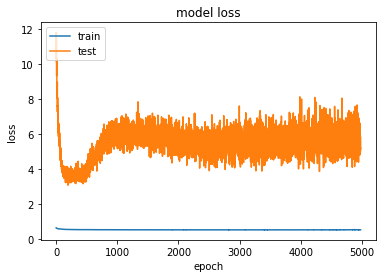

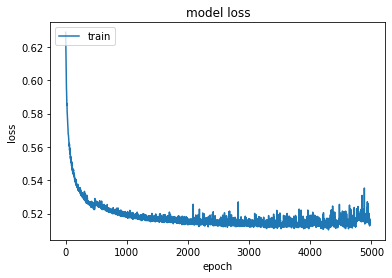

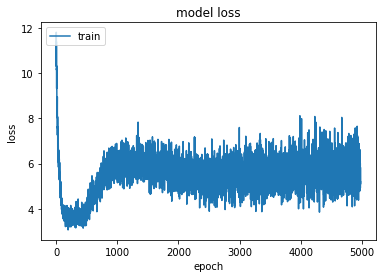

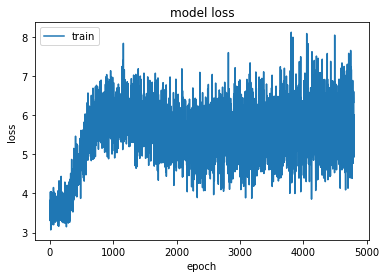

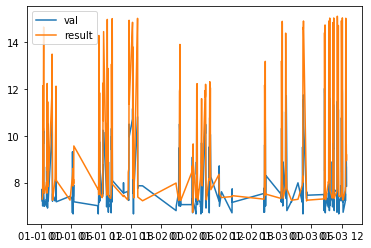

...

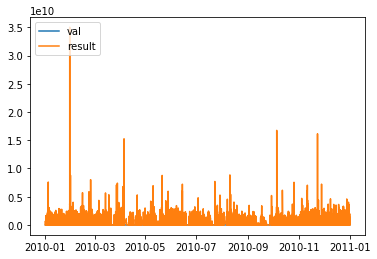

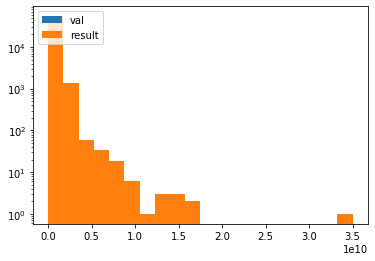

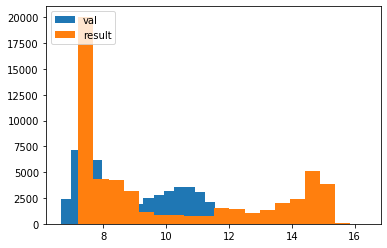

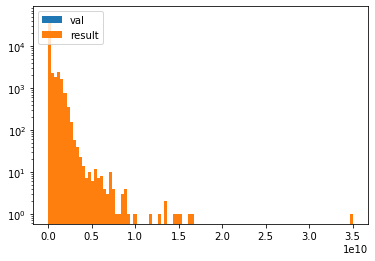

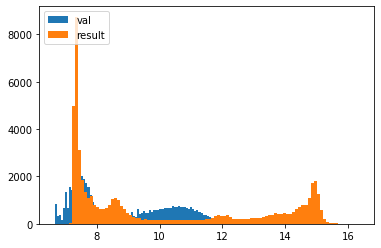

In [21]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model




input2 = Input(shape=(150))
model2 = Dense(256, kernel_initializer='lecun_normal', activation='selu')(input2)
model2 = AlphaDropout(0.5)(model2)
model2 = Dense(64, kernel_initializer='lecun_normal', activation='selu')(model2)
model2 = AlphaDropout(0.5)(model2)
merged = Dense(16, kernel_initializer='lecun_normal', activation='selu')(model2)
model2 = AlphaDropout(0.5)(model2)
merged = Dense(1, kernel_initializer='lecun_normal', activation='selu')(merged)

model = Model(inputs=input2, outputs=merged)


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit(np.reshape(X[:,:,:,:],(X.shape[0],150)), np.array(y_train_log), 
    validation_data=(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)),
                     np.array(y_val_log)), batch_size=1024,epochs=5000)#, sample_weight=sample_weights)

results = model.predict(np.reshape(X_test[:,:,:,:],(X_test.shape[0],150)))#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_23 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 14, 1, 256)   2816        input_22[0][0]                   
__________________________________________________________________________________________________
dense_72 (Dense)                (None, 512)          4608        input_23[0][0]                   
___________________________________________________________________________________________

705/705 [==============================] - 8s 11ms/step - loss: 0.4052 - mse: 0.4052 - val_loss: 0.7885 - val_mse: 0.7885
Epoch 36/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4053 - mse: 0.4053 - val_loss: 0.8165 - val_mse: 0.8165
Epoch 37/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4027 - mse: 0.4027 - val_loss: 0.7932 - val_mse: 0.7932
Epoch 38/100
705/705 [==============================] - 8s 11ms/step - loss: 0.4005 - mse: 0.4005 - val_loss: 0.8043 - val_mse: 0.8043
Epoch 39/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3993 - mse: 0.3993 - val_loss: 0.7747 - val_mse: 0.7747
Epoch 40/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3986 - mse: 0.3986 - val_loss: 0.8237 - val_mse: 0.8237
Epoch 41/100
705/705 [==============================] - 7s 10ms/step - loss: 0.3969 - mse: 0.3969 - val_loss: 0.8076 - val_mse: 0.8076
Epoch 42/100
705/705 [==============================] - 7s 10ms/step

Epoch 96/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3612 - mse: 0.3612 - val_loss: 0.8763 - val_mse: 0.8763
Epoch 97/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3607 - mse: 0.3607 - val_loss: 0.9233 - val_mse: 0.9233
Epoch 98/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3608 - mse: 0.3608 - val_loss: 0.9534 - val_mse: 0.9534
Epoch 99/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3590 - mse: 0.3590 - val_loss: 0.9189 - val_mse: 0.9189
Epoch 100/100
705/705 [==============================] - 8s 11ms/step - loss: 0.3586 - mse: 0.3586 - val_loss: 0.9282 - val_mse: 0.9282


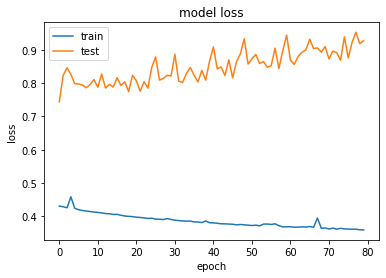

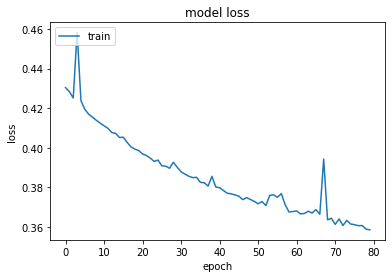

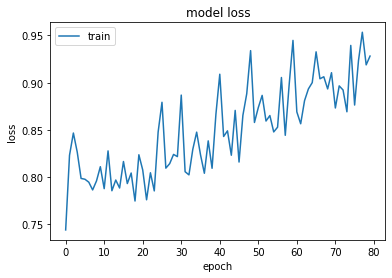

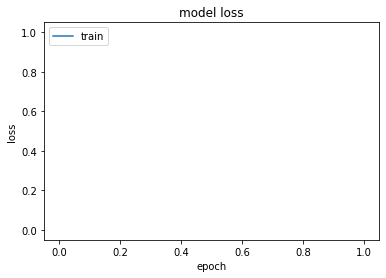

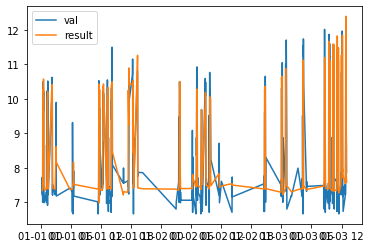

...

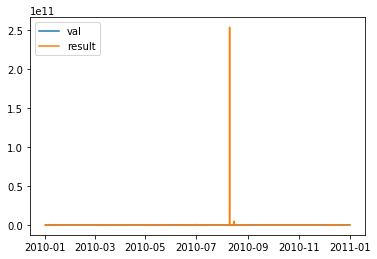

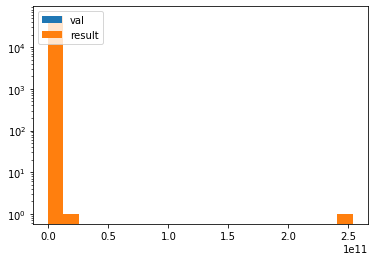

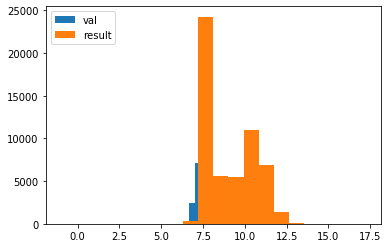

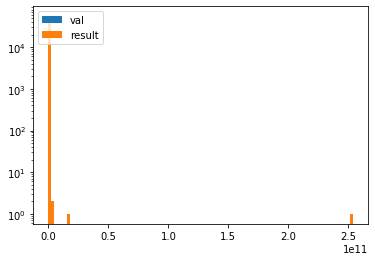

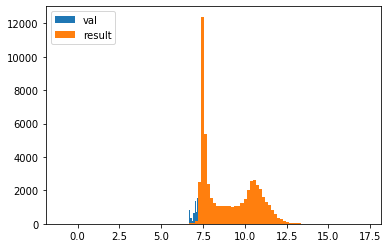

In [23]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
# merged = Dropout(0.5)(merged)

merged = Dense(128, activation='elu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(16, activation='elu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=100)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


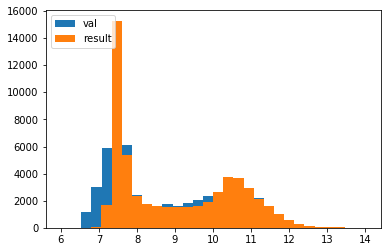

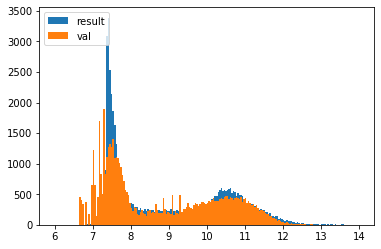

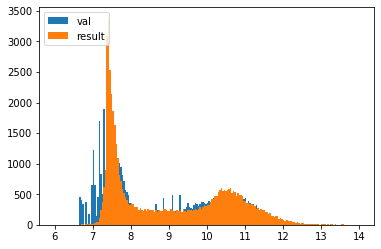

In [38]:
plt.figure()
plt.hist(y_val_log.values,bins=30,range=(6,14))
plt.hist(df_results.values,bins=30,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(df_results.values,bins=200,range=(6,14))
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.hist(df_results.values,bins=200,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_25 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_8 (Conv2D)               (None, 14, 1, 256)   2816        input_24[0][0]                   
__________________________________________________________________________________________________
dense_78 (Dense)                (None, 512)          4608        input_25[0][0]                   
___________________________________________________________________________________________

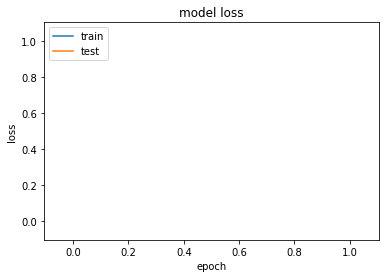

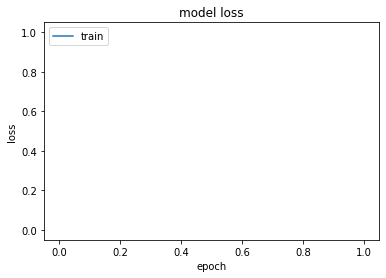

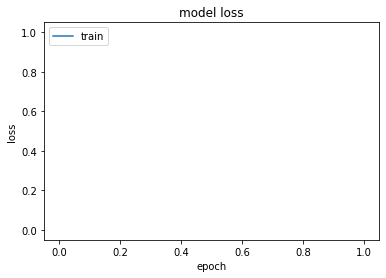

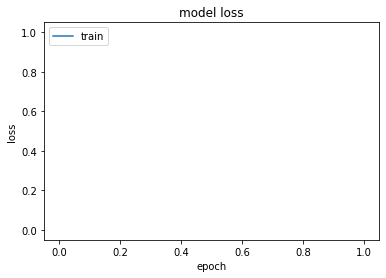

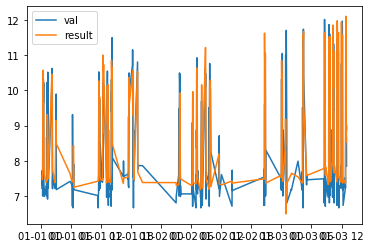

...

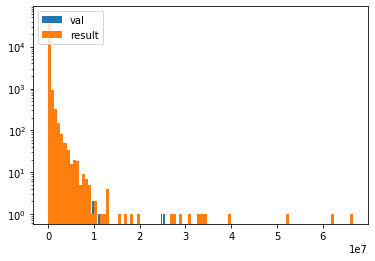

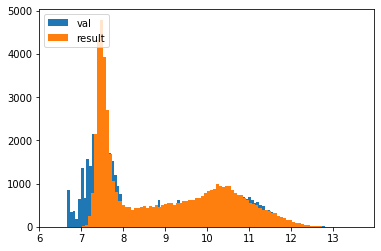

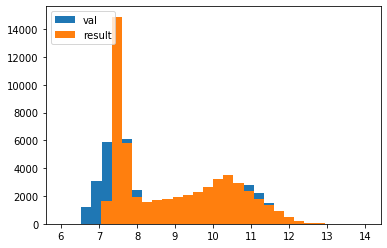

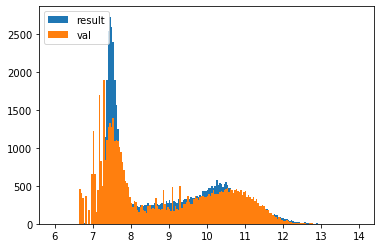

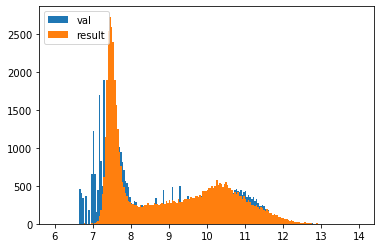

In [39]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='elu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='elu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
# merged = Dropout(0.5)(merged)

merged = Dense(128, activation='elu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(16, activation='elu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(4, activation='elu')(merged)
merged = Dense(1, activation='elu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=20)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=30,range=(6,14))
plt.hist(df_results.values,bins=30,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(df_results.values,bins=200,range=(6,14))
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.hist(df_results.values,bins=200,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_26 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_27 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_10 (Conv2D)              (None, 14, 1, 256)   2816        input_26[0][0]                   
__________________________________________________________________________________________________
dense_84 (Dense)                (None, 512)          4608        input_27[0][0]                   
___________________________________________________________________________________________

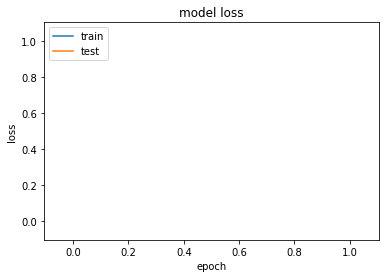

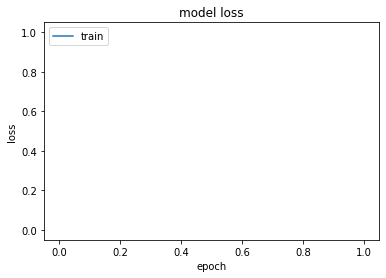

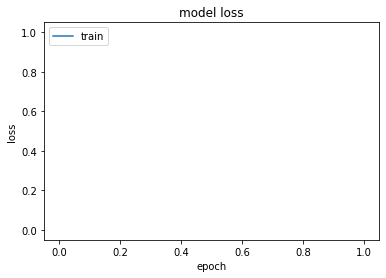

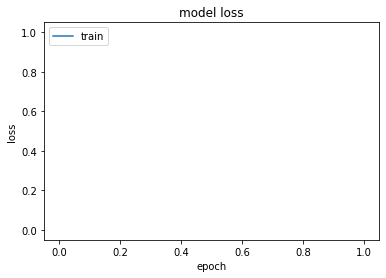

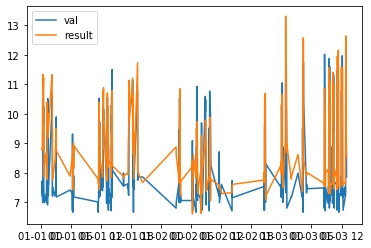

...

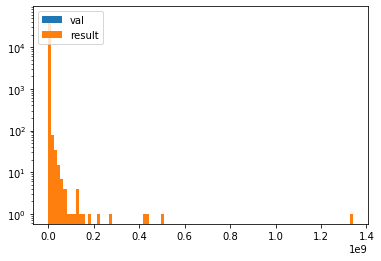

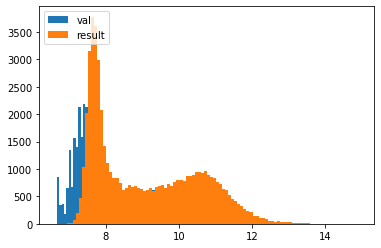

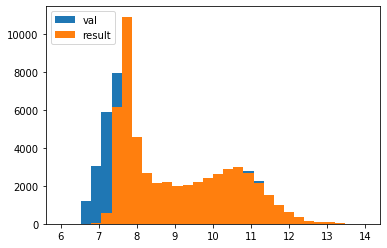

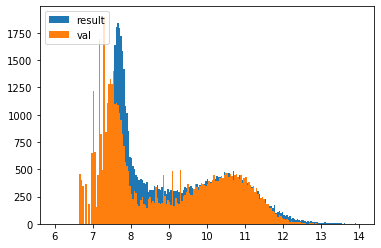

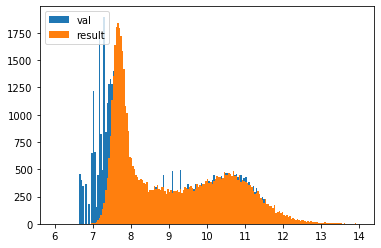

In [40]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal',activation='selu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
# merged = Dropout(0.5)(merged)

merged = Dense(128, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(16, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1, activation='relu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=20)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=30,range=(6,14))
plt.hist(df_results.values,bins=30,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(df_results.values,bins=200,range=(6,14))
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.hist(df_results.values,bins=200,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_28 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_29 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 14, 1, 256)   2816        input_28[0][0]                   
__________________________________________________________________________________________________
dense_90 (Dense)                (None, 512)          4608        input_29[0][0]                   
___________________________________________________________________________________________

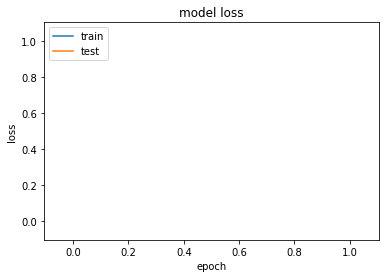

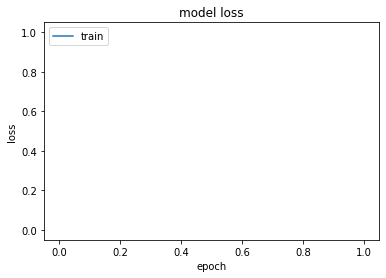

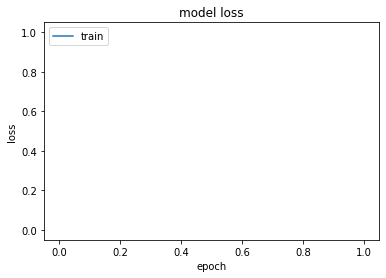

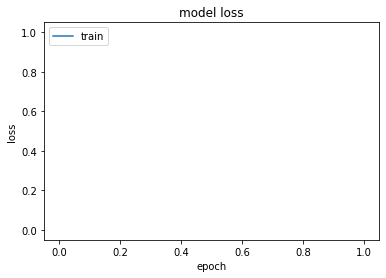

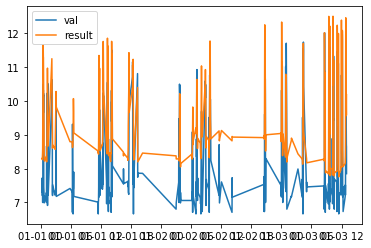

...

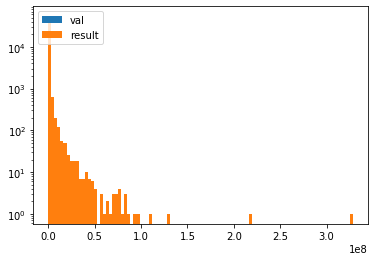

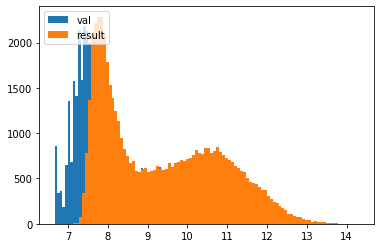

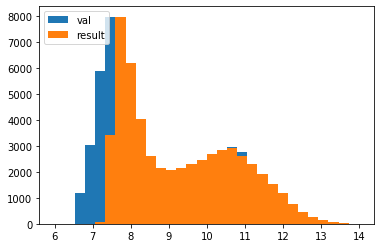

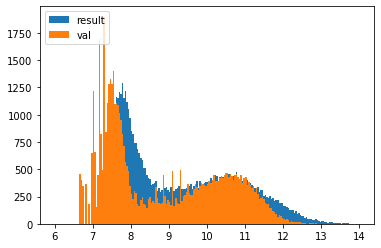

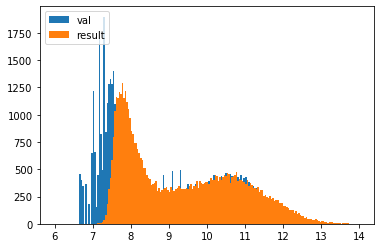

In [41]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
# merged = Dropout(0.5)(merged)

merged = Dense(128, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(16, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1, activation='relu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=20)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=30,range=(6,14))
plt.hist(df_results.values,bins=30,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(df_results.values,bins=200,range=(6,14))
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.hist(df_results.values,bins=200,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_30 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_31 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_14 (Conv2D)              (None, 14, 1, 256)   2816        input_30[0][0]                   
__________________________________________________________________________________________________
dense_96 (Dense)                (None, 512)          4608        input_31[0][0]                   
___________________________________________________________________________________________

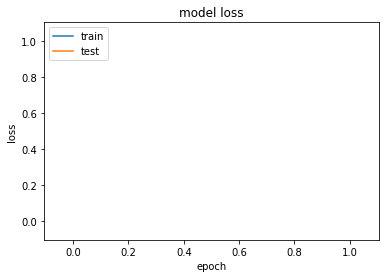

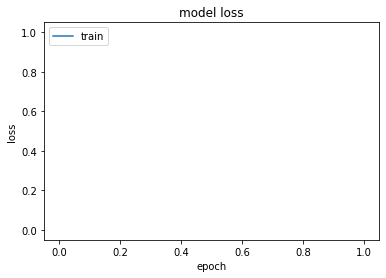

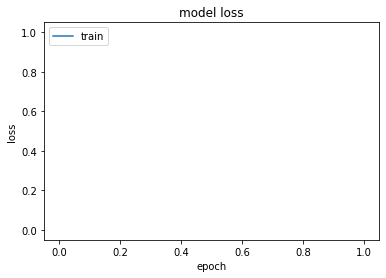

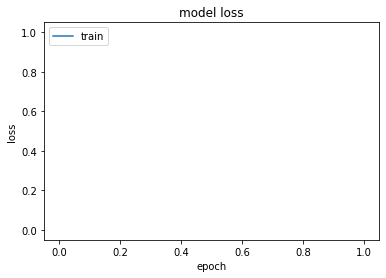

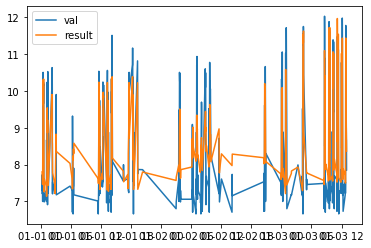

...

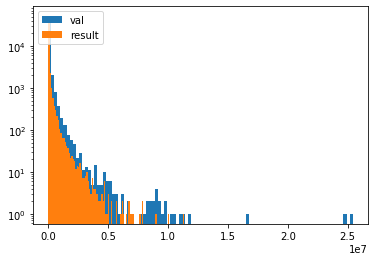

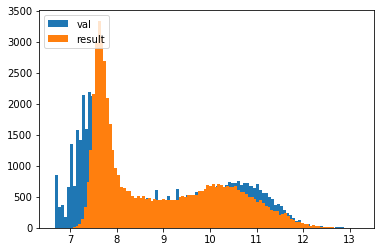

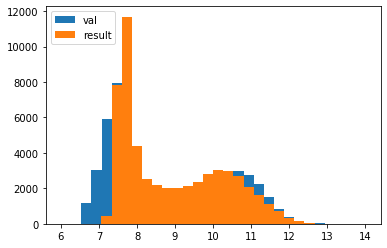

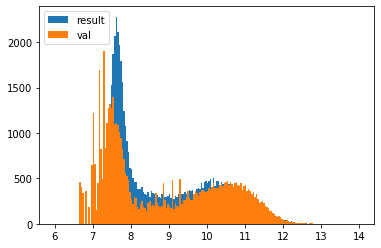

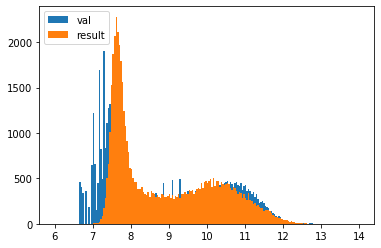

In [42]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10), kernel_initializer='lecun_normal', activation='selu')(input1)
model1 = AlphaDropout(0.25)(model1)
model1 = Conv2D(256, kernel_size=(14,1), activation='relu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
# merged = Dropout(0.5)(merged)

merged = Dense(128, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(16, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1, activation='relu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=20)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=30,range=(6,14))
plt.hist(df_results.values,bins=30,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(df_results.values,bins=200,range=(6,14))
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.hist(df_results.values,bins=200,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

Model: "model_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_32 (InputLayer)           [(None, 14, 10, 1)]  0                                            
__________________________________________________________________________________________________
input_33 (InputLayer)           [(None, 8)]          0                                            
__________________________________________________________________________________________________
conv2d_16 (Conv2D)              (None, 14, 1, 256)   2816        input_32[0][0]                   
__________________________________________________________________________________________________
dense_102 (Dense)               (None, 512)          4608        input_33[0][0]                   
___________________________________________________________________________________________

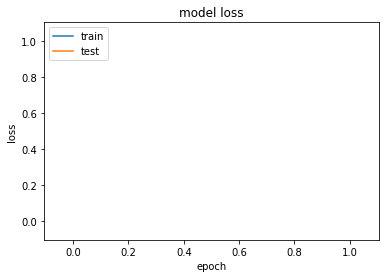

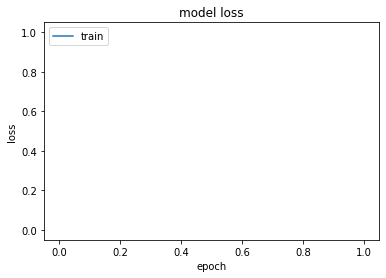

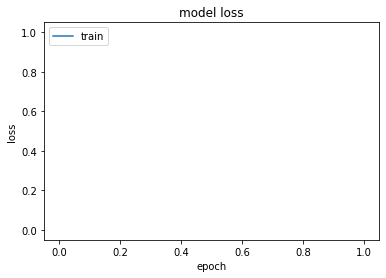

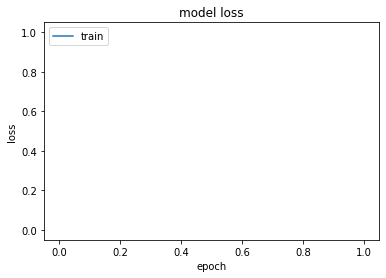

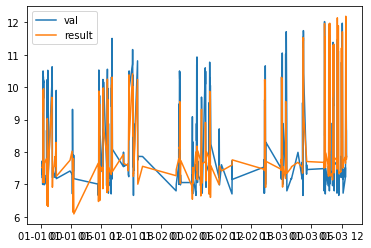

...

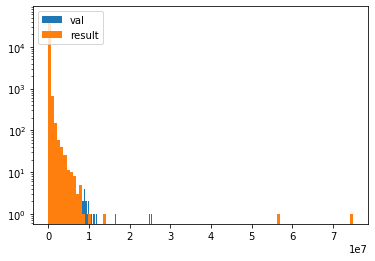

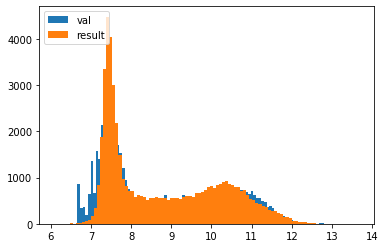

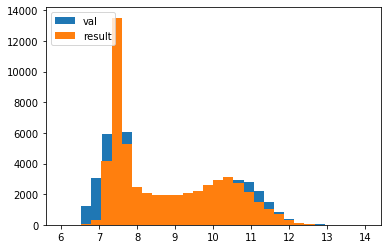

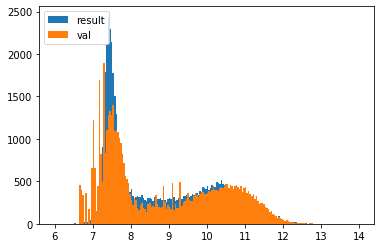

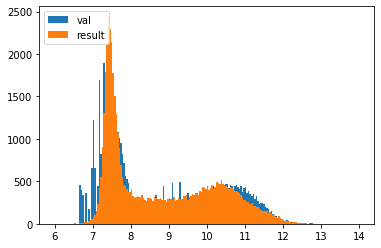

In [43]:
from tensorflow.keras.layers import Input, concatenate, AlphaDropout
from tensorflow.keras.models import Model

input1 = Input(shape=(14,10,1))


model1 = Conv2D(256, kernel_size=(1,10),activation='relu')(input1)
model1 = AlphaDropout(0.5)(model1)
model1 = Conv2D(256, kernel_size=(14,1), kernel_initializer='lecun_normal', activation='selu')(model1)
#model1 = Dropout(0.5)(model1)

model1 = Flatten()(model1)

input2 = Input(shape=(8))

model2 = Dense(512, activation='relu')(input2)
model2 = Dropout(0.5)(model2)
model2 = Dense(128,activation='relu')(model2)


model2 = Flatten()(model2)


merged =concatenate([model1, model2])
# merged = Dropout(0.5)(merged)

merged = Dense(128, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(16, activation='relu')(merged)
# merged = Dropout(0.5)(merged)
merged = Dense(4, activation='relu')(merged)
merged = Dense(1, activation='relu')(merged)

model = Model(inputs=[input1, input2], outputs=merged)

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.summary()

history = model.fit([X[:,1:15,:,:],np.reshape(X[:,0,:8,:],(X.shape[0],8))], np.array(y_train_log), 
    validation_data=([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))],
                     np.array(y_val_log)), batch_size=1024,epochs=20)#, sample_weight=sample_weights)

results = model.predict([X_test[:,1:15,:,:],np.reshape(X_test[:,0,:8,:],(X_test.shape[0],8))])#, y_val_log.values)#, batch_size=128)


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


df_results = pd.DataFrame(data=results, index = df_val.index)

%matplotlib inline

plt.figure()
plt.plot(y_val_log[:500])
plt.plot(df_results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:5000])
plt.plot(df_results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[-500:])
plt.plot(df_results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=20, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=20, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=20)
plt.hist(df_results.values,bins=20)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=100)
plt.hist(df_results.values,bins=100)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=30,range=(6,14))
plt.hist(df_results.values,bins=30,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(df_results.values,bins=200,range=(6,14))
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,range=(6,14))
plt.hist(df_results.values,bins=200,range=(6,14))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

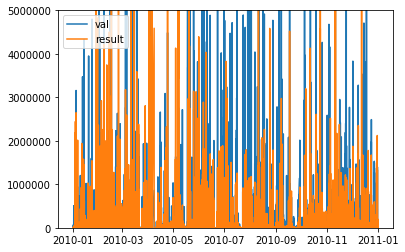

In [53]:
plt.ion()
%matplotlib inline
plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.ylim([0,.5e7])
plt.show()
%matplotlib inline